# Implement several of Nhan's suggestion

In [1]:
#Data processing
import os
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from nptdms import TdmsFile #Process ramping file

#For building ML models
import keras
import keras.models as models
from keras.layers.core import Dense
from keras import regularizers
from sklearn.preprocessing import MinMaxScaler, StandardScaler

np.random.seed(1337) # for reproducibility


Bad key "text.kerning_factor" on line 4 in
/uscms_data/d3/dhoang/miniconda3/lib/python3.7/site-packages/matplotlib/mpl-data/stylelib/_classic_test_patch.mplstyle.
You probably need to get an updated matplotlibrc file from
https://github.com/matplotlib/matplotlib/blob/v3.1.3/matplotlibrc.template
or from the matplotlib source distribution
Using TensorFlow backend.


## 1. Just use the scaler from the immediately previous section

In [2]:
def load_sensor(dir_path, sensor, time_range = None):
    
    data = pd.DataFrame(data = {sensor: np.load(dir_path + sensor + ".npy"),
                                "time": np.load(dir_path + "time.npy")})
    
    start = min(data["time"])
    end = max(data["time"])
    
    if time_range:
        start = time_range[0]
        end = time_range[1]
    
    
    data = data[(data["time"] > start) & (data["time"] < end)]
   
    %reset -f in
    
    return data[sensor]

def load_time_label(dir_path, time_range, window = 2000, step = 10):
    
    time_label =  np.load(dir_path + "time.npy")
    
    start = min(time_label)
    end = max(time_label)
    
    if time_range:
        start = time_range[0]
        end = time_range[1]
    
    
    time_label = time_label[(time_label > start) & (time_label < end)][window-1::step]
    
    %reset -f in
    
    return time_label

#### Mean of abs(signal)
def generate_mean_data(dir_path, time_range, window = 2000, step = 10):
    #Load the data
    ai0 = load_sensor(dir_path, "ai0", time_range = time_range).abs().rolling(window=window).mean().to_numpy()[window-1::step]
    ai1 = load_sensor(dir_path, "ai1", time_range = time_range).abs().rolling(window=window).mean().to_numpy()[window-1::step]
    ai2 = load_sensor(dir_path, "ai2", time_range = time_range).abs().rolling(window=window).mean().to_numpy()[window-1::step]
    ai3 = load_sensor(dir_path, "ai3", time_range = time_range).abs().rolling(window=window).mean().to_numpy()[window-1::step]
    ai4 = load_sensor(dir_path, "ai4", time_range = time_range).abs().rolling(window=window).mean().to_numpy()[window-1::step]
    
    #Calculate the product
    product = ai0*ai1*ai2*ai3*ai4
    
    #Stack them together
    all_mean = np.vstack((ai0,ai1,ai2,ai3,ai4, product)).transpose()
    
    %reset -f in
    
    return all_mean

#### SD of signal
def generate_sd_data(dir_path, time_range, window = 2000, step = 10):
    #Load the data
    ai0 = load_sensor(dir_path, "ai0", time_range = time_range).rolling(window=window).std().to_numpy()[window-1::step]
    ai1 = load_sensor(dir_path, "ai1", time_range = time_range).rolling(window=window).std().to_numpy()[window-1::step]
    ai2 = load_sensor(dir_path, "ai2", time_range = time_range).rolling(window=window).std().to_numpy()[window-1::step]
    ai3 = load_sensor(dir_path, "ai3", time_range = time_range).rolling(window=window).std().to_numpy()[window-1::step]
    ai4 = load_sensor(dir_path, "ai4", time_range = time_range).rolling(window=window).std().to_numpy()[window-1::step]
    
    #Calculate the product
    product = ai0*ai1*ai2*ai3*ai4
    
    #Stack them together
    all_sd = np.vstack((ai0,ai1,ai2,ai3,ai4, product)).transpose()
    
    %reset -f in
    
    return all_sd

#### Thresholded zero crossings
def zero_crossings(array):
    
    #Set values outside of range (0.001, 0.1) = 0
    array[abs(array) > 0.1] = 0
    array[abs(array) < 0.005] = 0
    
    #Calculate number of zero-crossing points, normalized by the window size
    zero_crossings = ((array[:-1] * array[1:]) < 0).sum()/array.size
    
    return zero_crossings


def generate_crossings_data(dir_path, time_range = None, window = 5000, step = 10):
    
    #Load the data
    ai0 = load_sensor(dir_path, "ai0", time_range = time_range).rolling(window=window).apply(zero_crossings, raw = True).to_numpy()[window-1::step]
    ai1 = load_sensor(dir_path, "ai1", time_range = time_range).rolling(window=window).apply(zero_crossings, raw = True).to_numpy()[window-1::step]
    ai2 = load_sensor(dir_path, "ai2", time_range = time_range).rolling(window=window).apply(zero_crossings, raw = True).to_numpy()[window-1::step]
    ai3 = load_sensor(dir_path, "ai3", time_range = time_range).rolling(window=window).apply(zero_crossings, raw = True).to_numpy()[window-1::step]
    ai4 = load_sensor(dir_path, "ai4", time_range = time_range).rolling(window=window).apply(zero_crossings, raw = True).to_numpy()[window-1::step]
    
    product = ai0*ai1*ai2*ai3*ai4
    
    #Stack them together
    all_crossings = np.vstack((ai0,ai1,ai2,ai3,ai4, product)).transpose()
    
    %reset -f in
    
    return all_crossings


def generate_data(dir_path, time_range, window = 2000, thres_win = 25000, step = 10):
    
    #Selection index due to using different window
    selection_index = int((thres_win - window)/step)
    
    moving_mean = generate_mean_data(dir_path, time_range, window = window, step = step)[selection_index:]
    moving_sd = generate_sd_data(dir_path, time_range, window = window, step = step)[selection_index:]
    #moving_thres_crossings = generate_crossings_data(dir_path, time_range, window = thres_win, step = step)
    time_label = load_time_label(dir_path, time_range, window = window, step = step)[selection_index:]
    
    all_data = np.concatenate((moving_mean, moving_sd), axis = 1)
    
    print("All data's shape: ", all_data.shape)
    
    %reset -f in
    
    return all_data, time_label

#####-------INCREMENTAL LEARNING IMPLEMENTATION-------######

def create_model():
    
    #================BUILD THE MODEL====================
    # Simple model
    # Simple model
    model = models.Sequential()

    model.add(Dense(6, activation = 'elu', kernel_initializer='glorot_uniform',
                    kernel_regularizer=regularizers.l2(0.0),
                    input_dim=12))

    model.add(Dense(3,activation='elu',
                    kernel_initializer='glorot_uniform'))

    model.add(Dense(6,activation='elu',
                    kernel_initializer='glorot_uniform'))

    model.add(Dense(12,
                    kernel_initializer='glorot_uniform'))

    model.compile(loss='mse',optimizer='adam')


    return model

def train(current_weights, X, time_axis, time_range):
    """Take a model, train it in the appropritate time range, return the new weights
    and its reconstruction loss distribution"""
    
    print("Training for section: ", time_range)
    #Select the appropriate time
    start_index = None
    
    if time_range[0] is not None:
        start_index = np.argmax(time_axis > time_range[0])
    else:
        start_index = 0
    
    if time_range[1] == 0:
        end_index = None
    else:
        end_index = np.argmax(time_axis > time_range[1])
    
    X_train = np.copy(X[start_index:end_index])
    time_train = time_axis[start_index:end_index]
    
    #Create model
    model = create_model()
    
    if current_weights:
        model.set_weights(current_weights)
    
    #Scaler initiation
    scaler = MinMaxScaler()
    scaler.fit(X_train)
    X_train = scaler.transform(X_train)
    
    #Train the model and extract new weights
    model.fit(X_train, X_train,
              batch_size=2000,
              epochs=30, verbose = 0)
    
    new_weights = model.get_weights()
    
    #Evaluate the losses and update the distribution
    X_pred = model.predict(X_train)
    loss = np.mean(np.abs(X_pred-X_train), axis = 1)
    
    #Plot the reconstruction loss
    plt.figure(figsize=(20,2))
    plt.plot(time_train, loss)
    plt.title("TRAINING reconstruction loss on {}".format(time_range))
    plt.xlabel("Time [s]")
    plt.show()
    
    #Take the mean of the log loss and update the mean threshold
    current_median = np.median(np.log10(loss))
    
    print("Finished training, median of the log(loss) is: ", current_median)
    
    return new_weights, current_median, scaler

def trigger(current_weights, X, time_axis, time_range, prev_median, scaler):
    
    print("Triggering for section: ", time_range)
    print("Using this median for triggering:", prev_median)
    
    #Select the appropriate time
    start_index = None
    
    if time_range[0] is not None:
        start_index = np.argmax(time_axis > time_range[0])
    else:
        start_index = 0
    
    if time_range[1] == 0:
        end_index = None
    else:
        end_index = np.argmax(time_axis > time_range[1])
    
    time_test = time_axis[start_index:end_index]
    X_test = np.copy(X[start_index:end_index])
    
    X_test = scaler.transform(X_test) #Scale the current data
    
    #Create model
    model = create_model()
    model.set_weights(current_weights)
        
    #Find the test loss (doing this in parallel for the sake of simulation), but in a practical system
    #Ideally we need to do inference every single data point come in
    X_pred_test = model.predict(X_test)
    test_loss = np.mean(np.abs(X_pred_test-X_test), axis = 1)
    
    
    #Plot the reconstruction loss just to check
    plt.figure(figsize=(20,2))
    plt.plot(time_test, test_loss)
    plt.title("Reconstruction loss on {}".format(time_range))
    plt.xlabel("Time [s]")
    plt.show()
    
    #Quantify how much each data point is far away from the distribution
    log_test_loss = np.log10(test_loss) - prev_median
    
    #Find the trigger time
    trigger_index = np.argmax(log_test_loss > 2.7)
    
    if  trigger_index != 0:
        #Plot the triggered time
        plt.figure(figsize=(20,2))
        plt.plot(time_test, log_test_loss, color = "firebrick")
        plt.title("Log reconstruction loss on {}".format(time_range))
        plt.xlabel("Time [s]")
        
        #Trigger time
        plt.vlines(time_test[trigger_index], log_test_loss.min(), log_test_loss.max(), color = "blue", linestyles = "dashed", label = "Trigger time")
        plt.legend(loc = "upper left")
        plt.show()
        
        return time_test[trigger_index]
    
    else:
        return None
    

def simulation(dir_path, section_size, time_range):
    
    #Load data and create the model
    X, time_axis = generate_data(dir_path, time_range = time_range, window = 2000, step = 10)
    
    #For updating model
    current_weights = None
    new_weights = None
    
    #For keeping track of distribution history
    prev_median = None
    updated_median = None
    
    #Keeping track of scaler after training
    past_scaler = None
    
    #Calculate number of sections
    num_section = int(abs(time_range[0])/section_size)
    print("Number of sections:", num_section)
    
    #Keeping log of all the trigger time
    trigger_log = []
    
    #Sequentially go through the data
    for i in range(num_section):
        
        print("Entering sections: ", (-section_size*(num_section - i), -section_size*(num_section - i - 1)))
        print("-------->")
        
        if i == 0:
            continue
        elif i == 1:
            #Train on the first segment
            time_range = (None, -section_size*(num_section - i))
            new_weights, updated_median, new_scaler = train(current_weights, X, time_axis, time_range)
        else:
            
            #Set previous distrubution to the newly trained disttribution
            prev_median = updated_median
            current_scaler = new_scaler
            current_weights = new_weights
            
            #Selecting appropriate time range for training and triggering
            train_time_range = (-section_size*(num_section - i + 1), -section_size*(num_section - i))
            trigger_time_range = (-section_size*(num_section - i), -section_size*(num_section - i - 1))
            
            #Train and predict simutaneously
            new_weights, updated_median, new_scaler = train(current_weights, X, time_axis, train_time_range)
            trigger_time = trigger(current_weights, X, time_axis, trigger_time_range, prev_median, current_scaler)
            
            if trigger_time:
                print("Triggered at: ", trigger_time)
                trigger_log.append(trigger_time)
        
        print("<--------")
        
    print("Finished simulation, all the triggered times are: ", trigger_log)

--------------

## 2. Start training when reached 9/10 of previous current.

Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
All data's shape:  (897500, 12)
Flushing input history
Number of sections: 18
Entering sections:  (-90, -85)
-------->
Entering sections:  (-85, -80)
-------->
Training for section:  (None, -85)


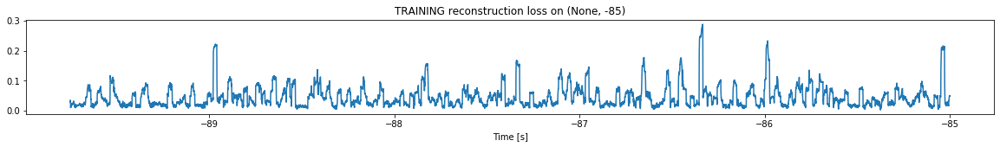

Finished training, median of the log(loss) is:  -1.4434958028970335
<--------
Entering sections:  (-80, -75)
-------->
Training for section:  (-85, -80)


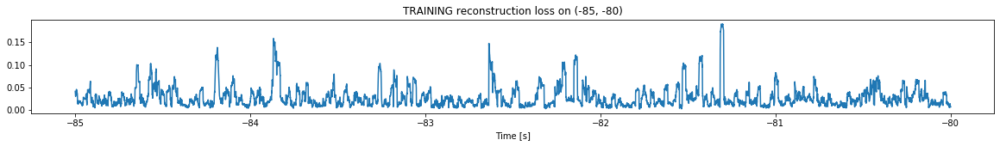

Finished training, median of the log(loss) is:  -1.6654631425057849
Triggering for section:  (-80, -75)
Using this median for triggering: -1.4434958028970335


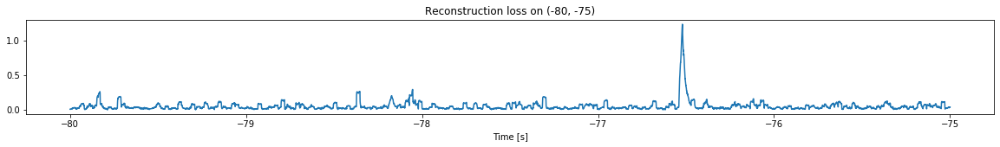

<--------
Entering sections:  (-75, -70)
-------->
Training for section:  (-80, -75)


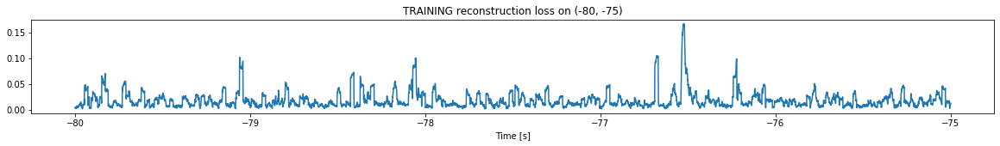

Finished training, median of the log(loss) is:  -1.8516247165202695
Triggering for section:  (-75, -70)
Using this median for triggering: -1.6654631425057849


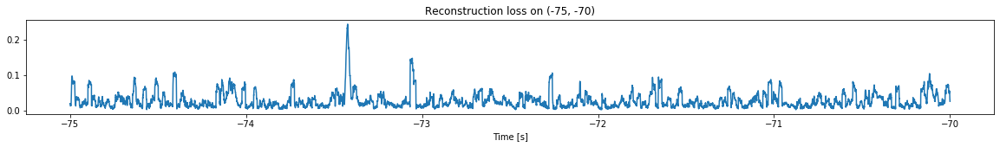

<--------
Entering sections:  (-70, -65)
-------->
Training for section:  (-75, -70)


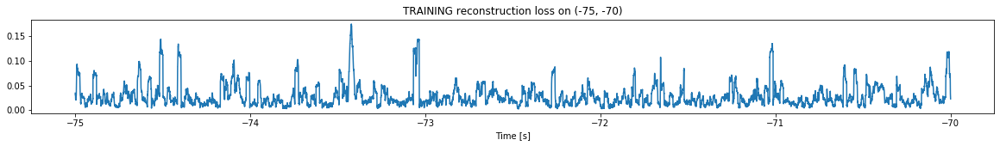

Finished training, median of the log(loss) is:  -1.6504130628245985
Triggering for section:  (-70, -65)
Using this median for triggering: -1.8516247165202695


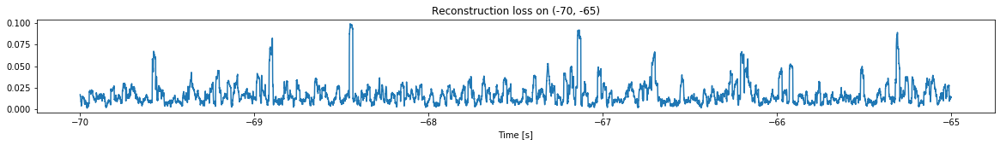

<--------
Entering sections:  (-65, -60)
-------->
Training for section:  (-70, -65)


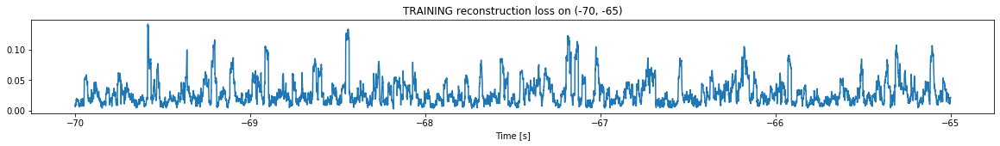

Finished training, median of the log(loss) is:  -1.6273447812940836
Triggering for section:  (-65, -60)
Using this median for triggering: -1.6504130628245985


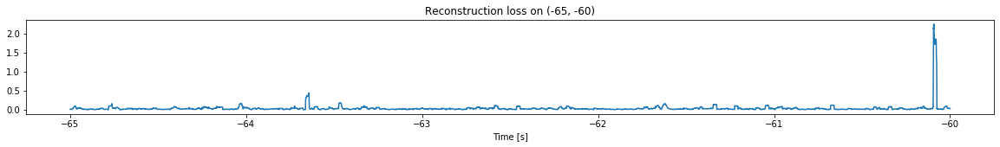

<--------
Entering sections:  (-60, -55)
-------->
Training for section:  (-65, -60)


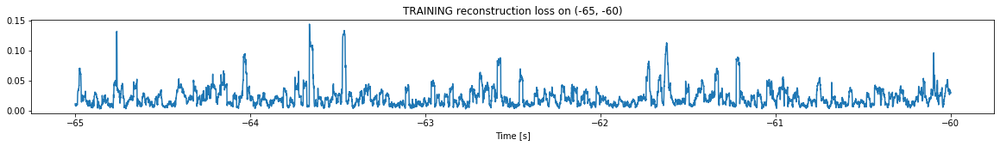

Finished training, median of the log(loss) is:  -1.7492202637079064
Triggering for section:  (-60, -55)
Using this median for triggering: -1.6273447812940836


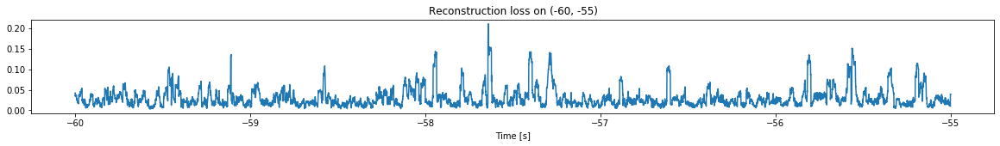

<--------
Entering sections:  (-55, -50)
-------->
Training for section:  (-60, -55)


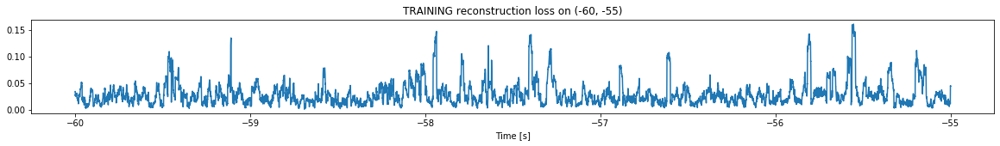

Finished training, median of the log(loss) is:  -1.6154969746196048
Triggering for section:  (-55, -50)
Using this median for triggering: -1.7492202637079064


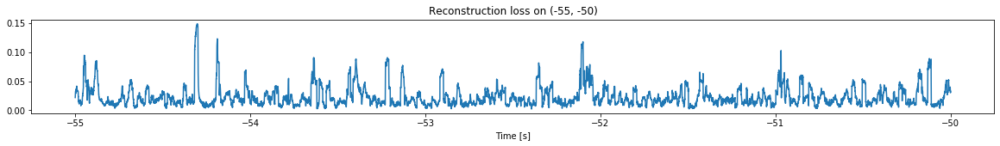

<--------
Entering sections:  (-50, -45)
-------->
Training for section:  (-55, -50)


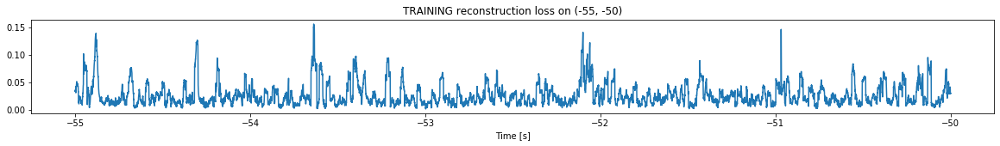

Finished training, median of the log(loss) is:  -1.6660623745221912
Triggering for section:  (-50, -45)
Using this median for triggering: -1.6154969746196048


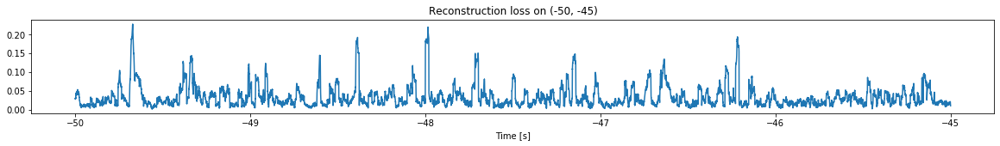

<--------
Entering sections:  (-45, -40)
-------->
Training for section:  (-50, -45)


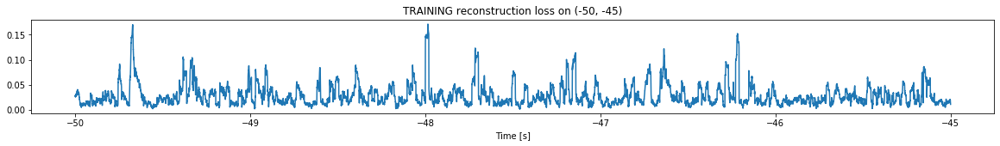

Finished training, median of the log(loss) is:  -1.654391117889456
Triggering for section:  (-45, -40)
Using this median for triggering: -1.6660623745221912


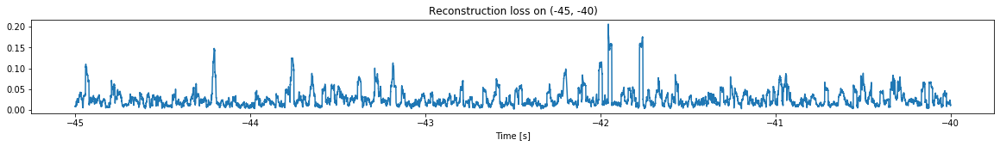

<--------
Entering sections:  (-40, -35)
-------->
Training for section:  (-45, -40)


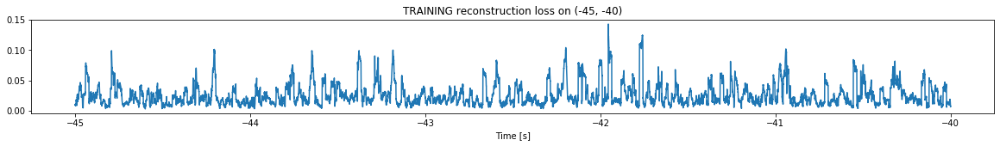

Finished training, median of the log(loss) is:  -1.683631163270904
Triggering for section:  (-40, -35)
Using this median for triggering: -1.654391117889456


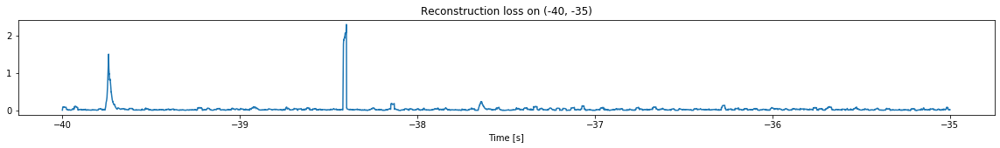

<--------
Entering sections:  (-35, -30)
-------->
Training for section:  (-40, -35)


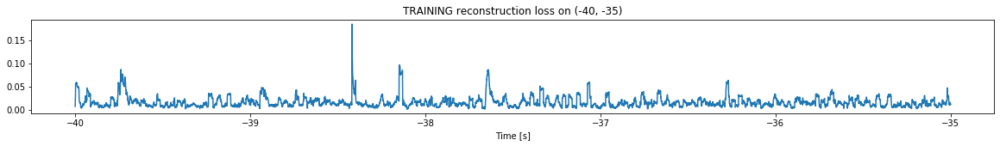

Finished training, median of the log(loss) is:  -1.8796228622574724
Triggering for section:  (-35, -30)
Using this median for triggering: -1.683631163270904


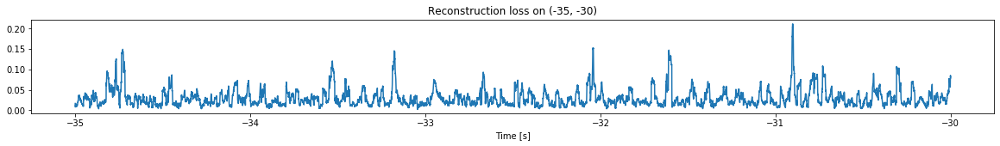

<--------
Entering sections:  (-30, -25)
-------->
Training for section:  (-35, -30)


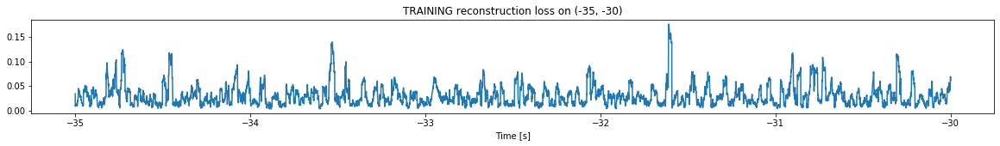

Finished training, median of the log(loss) is:  -1.5890847766984677
Triggering for section:  (-30, -25)
Using this median for triggering: -1.8796228622574724


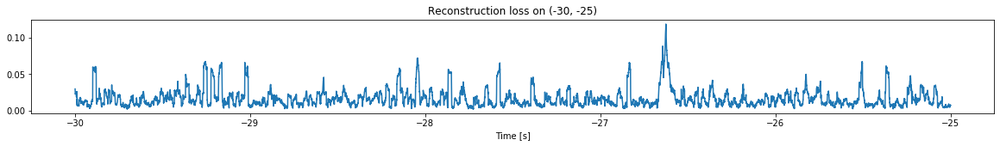

<--------
Entering sections:  (-25, -20)
-------->
Training for section:  (-30, -25)


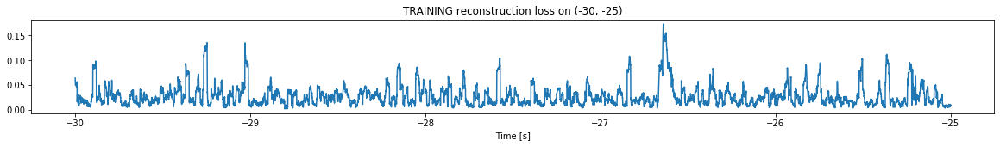

Finished training, median of the log(loss) is:  -1.6435979539420225
Triggering for section:  (-25, -20)
Using this median for triggering: -1.5890847766984677


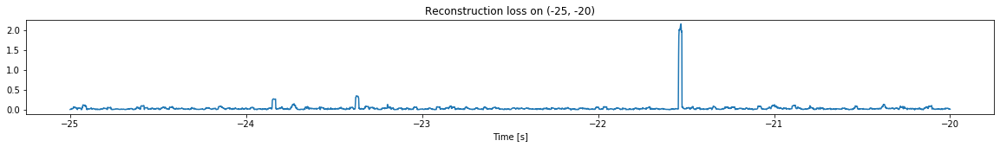

<--------
Entering sections:  (-20, -15)
-------->
Training for section:  (-25, -20)


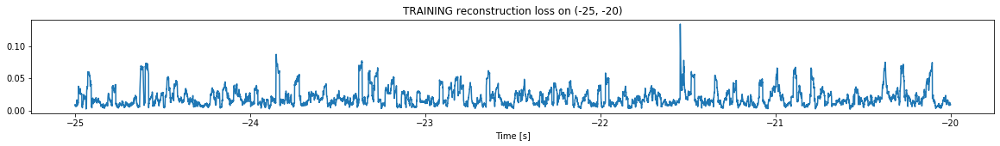

Finished training, median of the log(loss) is:  -1.7831307486233656
Triggering for section:  (-20, -15)
Using this median for triggering: -1.6435979539420225


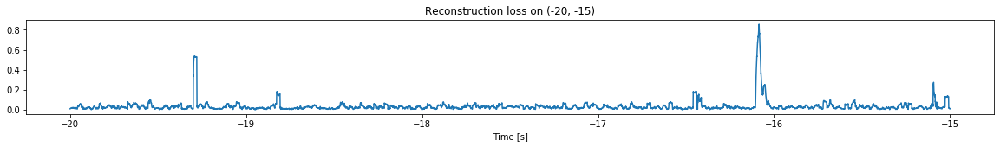

<--------
Entering sections:  (-15, -10)
-------->
Training for section:  (-20, -15)


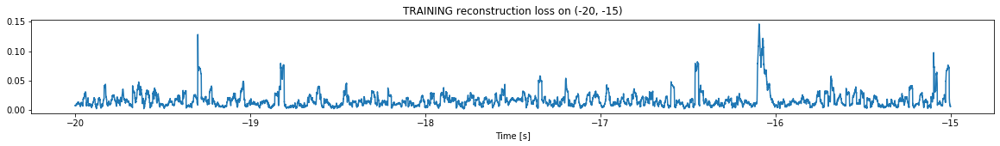

Finished training, median of the log(loss) is:  -1.8616775580181495
Triggering for section:  (-15, -10)
Using this median for triggering: -1.7831307486233656


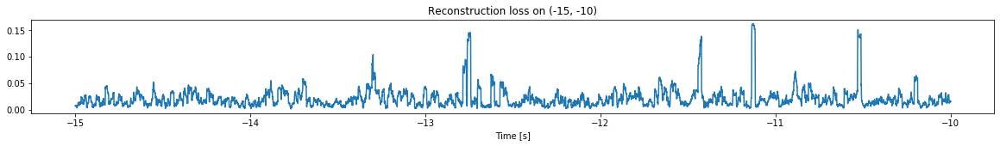

<--------
Entering sections:  (-10, -5)
-------->
Training for section:  (-15, -10)


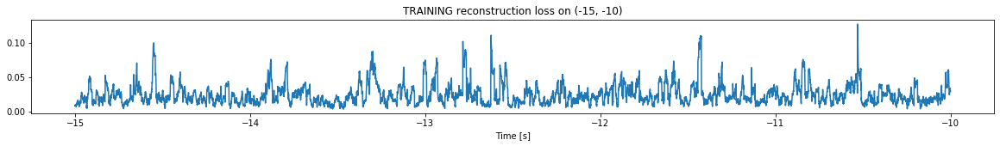

Finished training, median of the log(loss) is:  -1.6762177011280868
Triggering for section:  (-10, -5)
Using this median for triggering: -1.8616775580181495


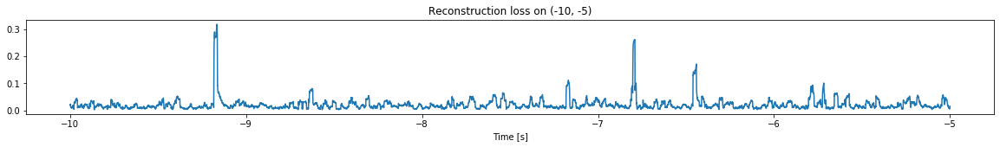

<--------
Entering sections:  (-5, 0)
-------->
Training for section:  (-10, -5)


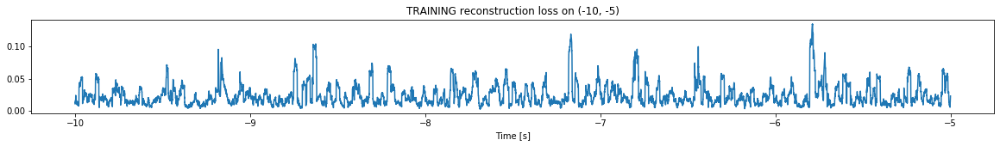

Finished training, median of the log(loss) is:  -1.7180986747457472
Triggering for section:  (-5, 0)
Using this median for triggering: -1.6762177011280868


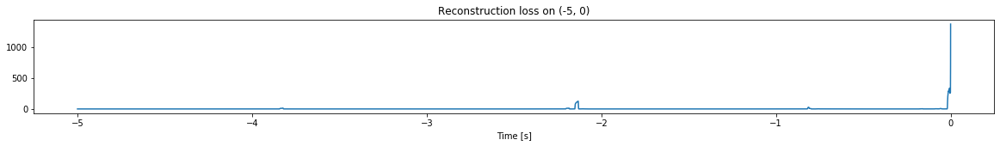

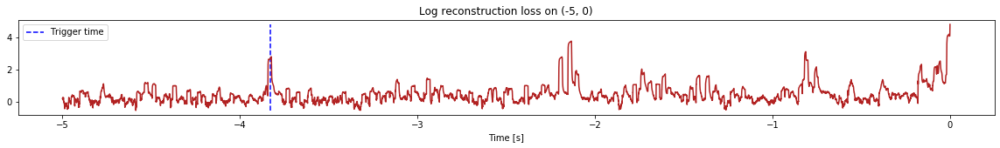

Triggered at:  -3.8288999
<--------
Finished simulation, all the triggered times are:  [-3.8288999]


In [4]:
simulation("./data/Ramp4/", 5, (-90,0))

Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
All data's shape:  (897500, 12)
Flushing input history
Number of sections: 18
Entering sections:  (-90, -85)
-------->
Entering sections:  (-85, -80)
-------->
Training for section:  (None, -85)


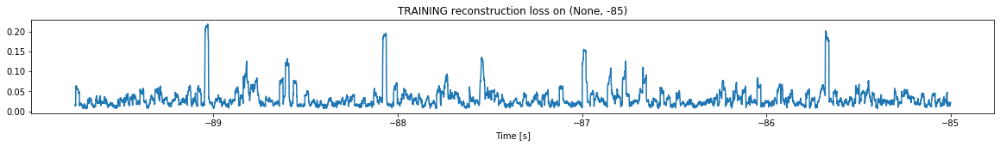

Finished training, median of the log(loss) is:  -1.58285373427359
<--------
Entering sections:  (-80, -75)
-------->
Training for section:  (-85, -80)


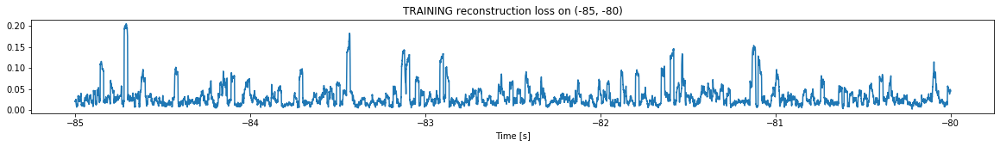

Finished training, median of the log(loss) is:  -1.6072086215646972
Triggering for section:  (-80, -75)
Using this median for triggering: -1.58285373427359


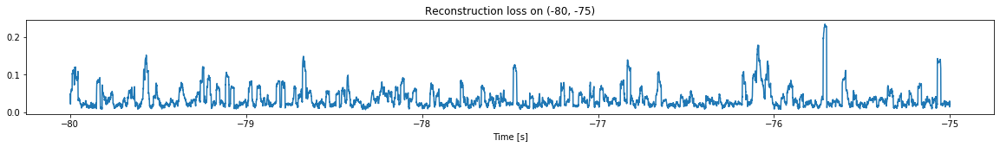

<--------
Entering sections:  (-75, -70)
-------->
Training for section:  (-80, -75)


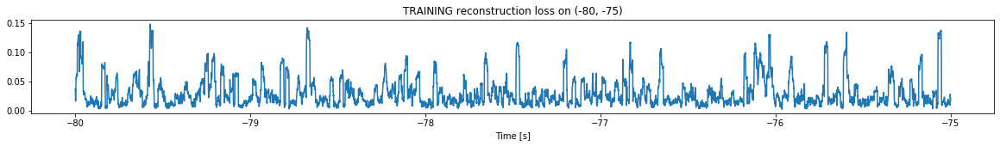

Finished training, median of the log(loss) is:  -1.6278970494753213
Triggering for section:  (-75, -70)
Using this median for triggering: -1.6072086215646972


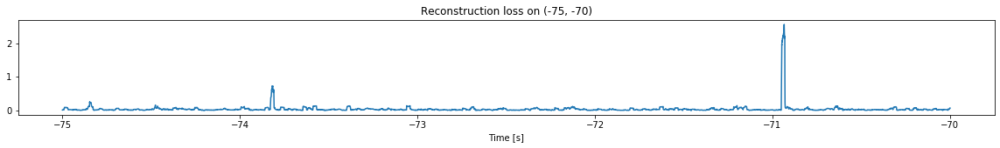

<--------
Entering sections:  (-70, -65)
-------->
Training for section:  (-75, -70)


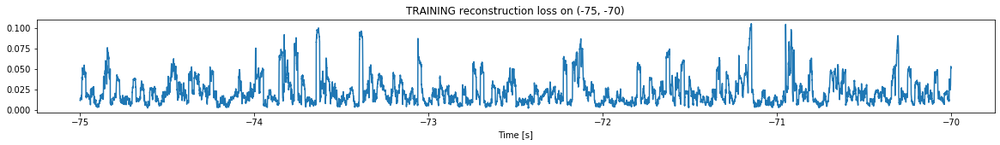

Finished training, median of the log(loss) is:  -1.7509975971054121
Triggering for section:  (-70, -65)
Using this median for triggering: -1.6278970494753213


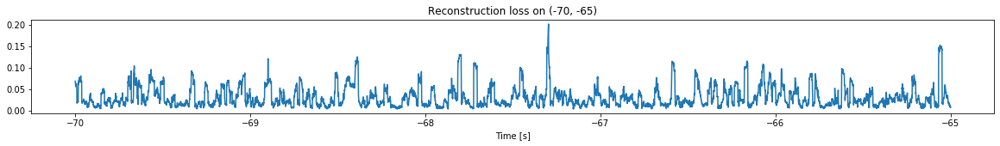

<--------
Entering sections:  (-65, -60)
-------->
Training for section:  (-70, -65)


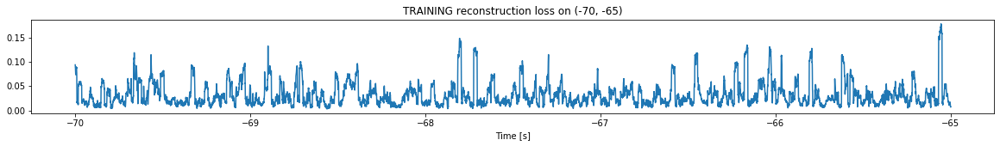

Finished training, median of the log(loss) is:  -1.5964444048223356
Triggering for section:  (-65, -60)
Using this median for triggering: -1.7509975971054121


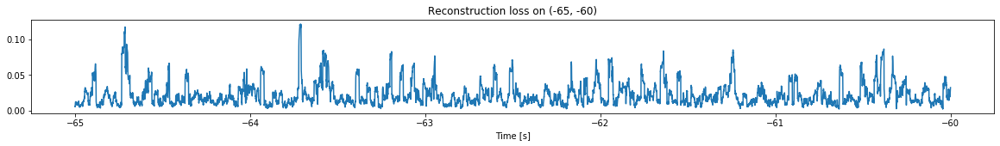

<--------
Entering sections:  (-60, -55)
-------->
Training for section:  (-65, -60)


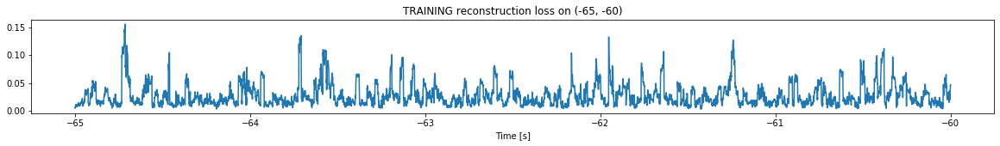

Finished training, median of the log(loss) is:  -1.6594480035833115
Triggering for section:  (-60, -55)
Using this median for triggering: -1.5964444048223356


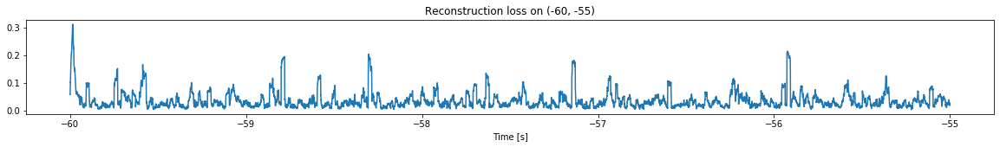

<--------
Entering sections:  (-55, -50)
-------->
Training for section:  (-60, -55)


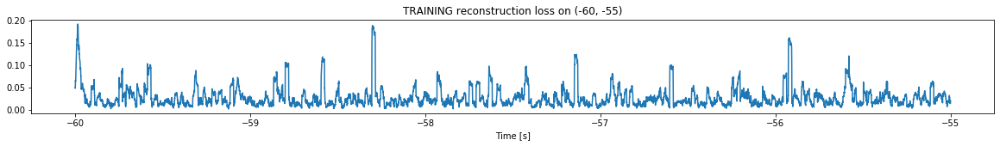

Finished training, median of the log(loss) is:  -1.6592972902927219
Triggering for section:  (-55, -50)
Using this median for triggering: -1.6594480035833115


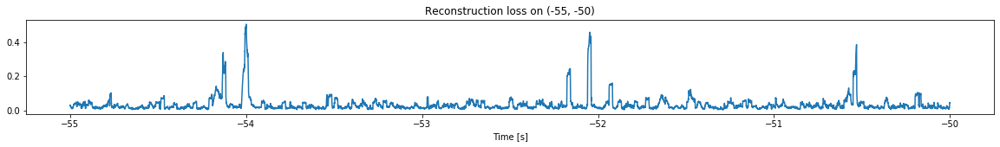

<--------
Entering sections:  (-50, -45)
-------->
Training for section:  (-55, -50)


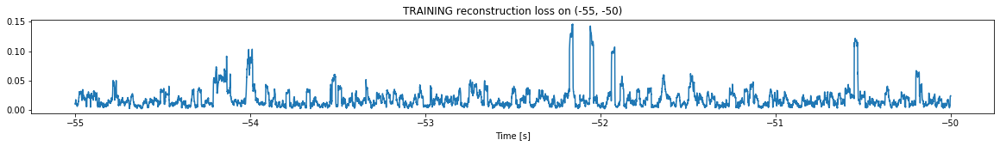

Finished training, median of the log(loss) is:  -1.8499834187109752
Triggering for section:  (-50, -45)
Using this median for triggering: -1.6592972902927219


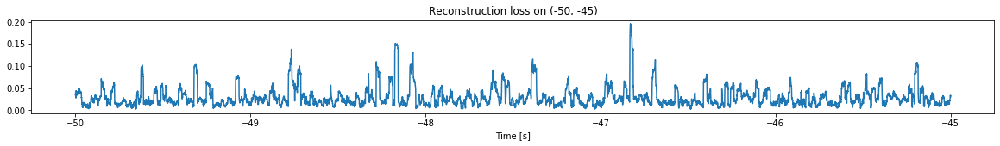

<--------
Entering sections:  (-45, -40)
-------->
Training for section:  (-50, -45)


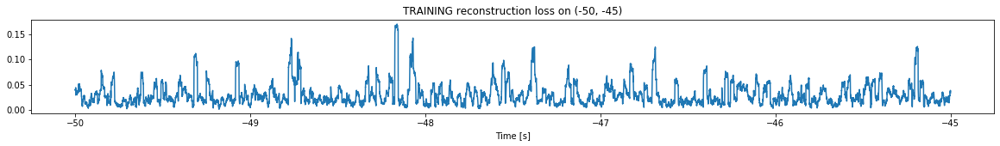

Finished training, median of the log(loss) is:  -1.609509033646272
Triggering for section:  (-45, -40)
Using this median for triggering: -1.8499834187109752


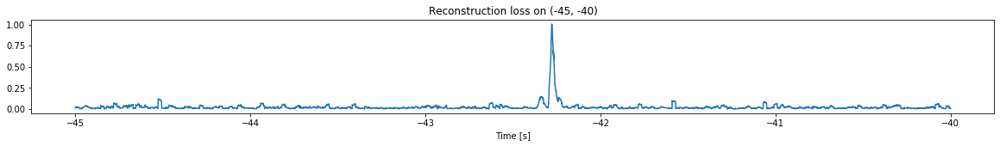

<--------
Entering sections:  (-40, -35)
-------->
Training for section:  (-45, -40)


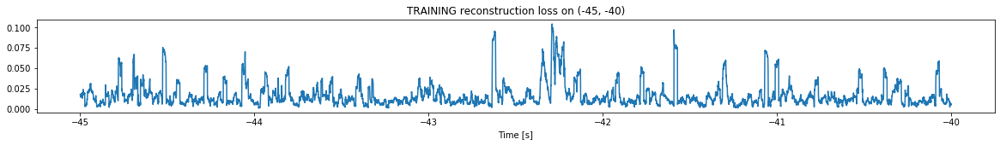

Finished training, median of the log(loss) is:  -1.8905852273272306
Triggering for section:  (-40, -35)
Using this median for triggering: -1.609509033646272


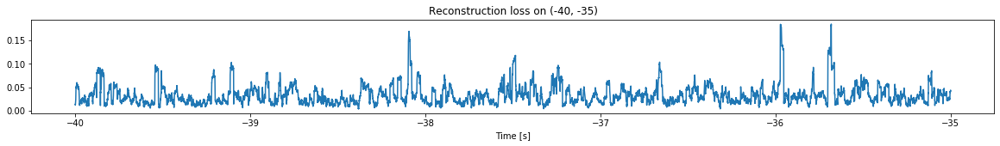

<--------
Entering sections:  (-35, -30)
-------->
Training for section:  (-40, -35)


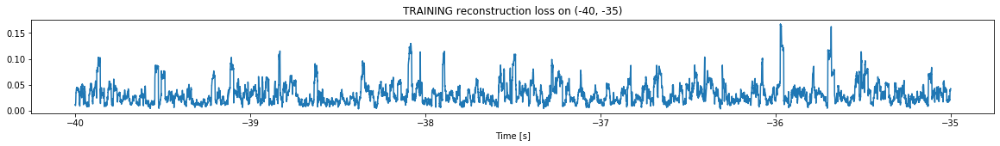

Finished training, median of the log(loss) is:  -1.5615821073002412
Triggering for section:  (-35, -30)
Using this median for triggering: -1.8905852273272306


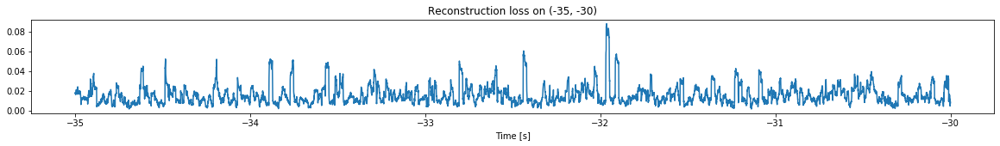

<--------
Entering sections:  (-30, -25)
-------->
Training for section:  (-35, -30)


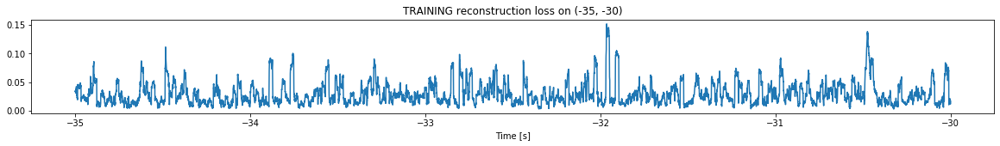

Finished training, median of the log(loss) is:  -1.6068008015250566
Triggering for section:  (-30, -25)
Using this median for triggering: -1.5615821073002412


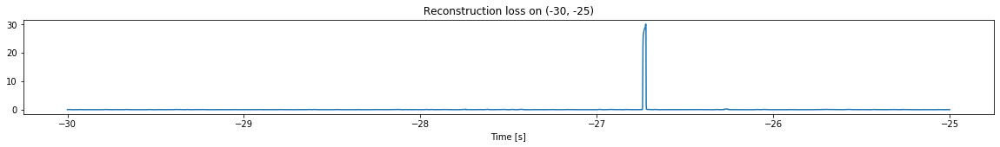

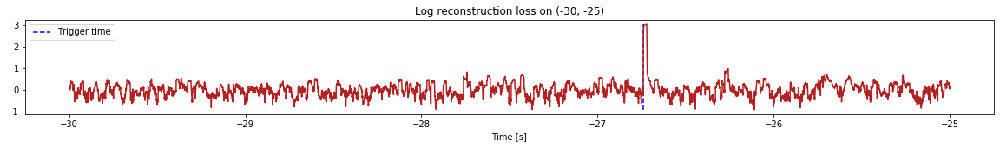

Triggered at:  -26.739199
<--------
Entering sections:  (-25, -20)
-------->
Training for section:  (-30, -25)


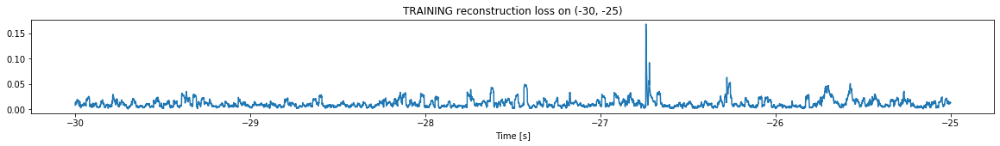

Finished training, median of the log(loss) is:  -2.01350447799121
Triggering for section:  (-25, -20)
Using this median for triggering: -1.6068008015250566


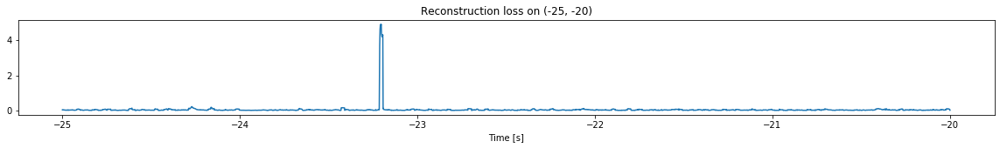

<--------
Entering sections:  (-20, -15)
-------->
Training for section:  (-25, -20)


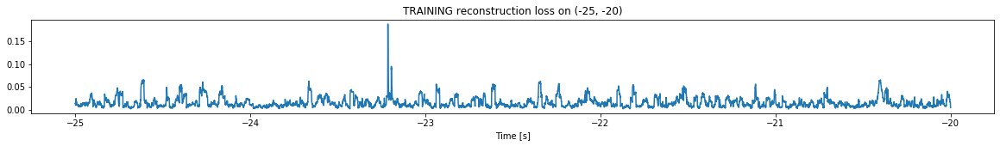

Finished training, median of the log(loss) is:  -1.9060980259911027
Triggering for section:  (-20, -15)
Using this median for triggering: -2.01350447799121


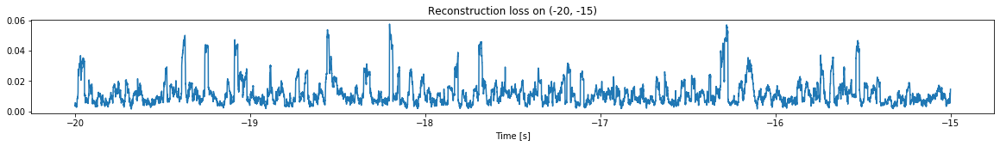

<--------
Entering sections:  (-15, -10)
-------->
Training for section:  (-20, -15)


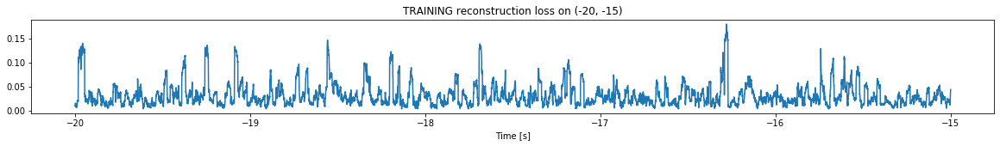

Finished training, median of the log(loss) is:  -1.5843864027938444
Triggering for section:  (-15, -10)
Using this median for triggering: -1.9060980259911027


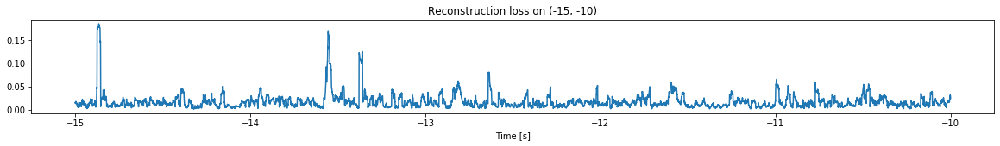

<--------
Entering sections:  (-10, -5)
-------->
Training for section:  (-15, -10)


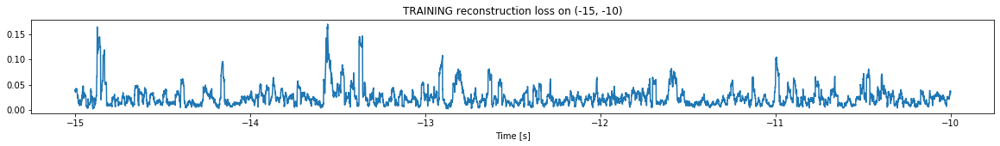

Finished training, median of the log(loss) is:  -1.668947677469244
Triggering for section:  (-10, -5)
Using this median for triggering: -1.5843864027938444


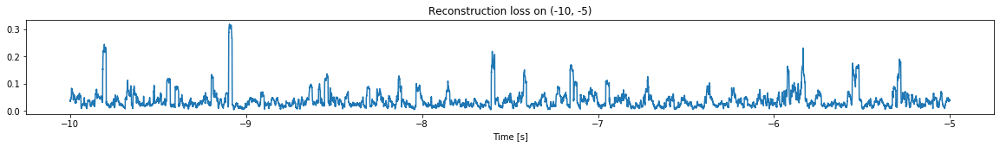

<--------
Entering sections:  (-5, 0)
-------->
Training for section:  (-10, -5)


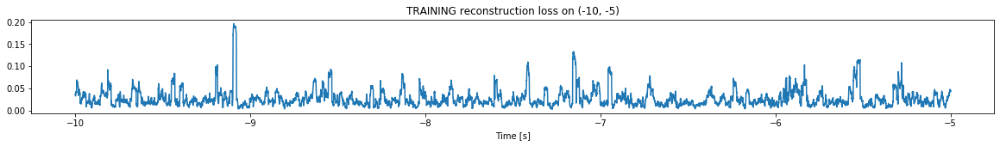

Finished training, median of the log(loss) is:  -1.6543735363196792
Triggering for section:  (-5, 0)
Using this median for triggering: -1.668947677469244


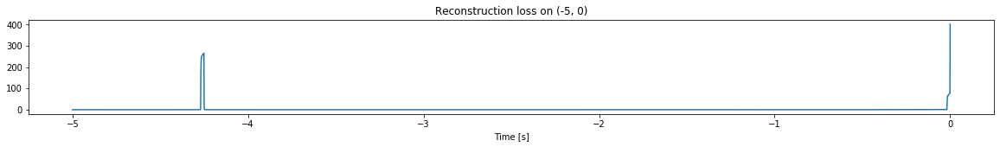

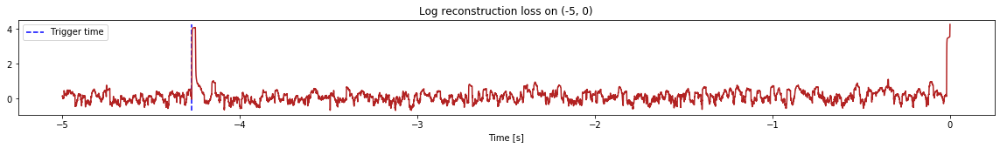

Triggered at:  -4.2701
<--------
Finished simulation, all the triggered times are:  [-26.739199, -4.2701]


In [5]:
simulation("./data/Ramp5/", 5, (-90,0))

Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
All data's shape:  (997500, 12)
Flushing input history
Number of sections: 20
Entering sections:  (-100, -95)
-------->
Entering sections:  (-95, -90)
-------->
Training for section:  (None, -95)


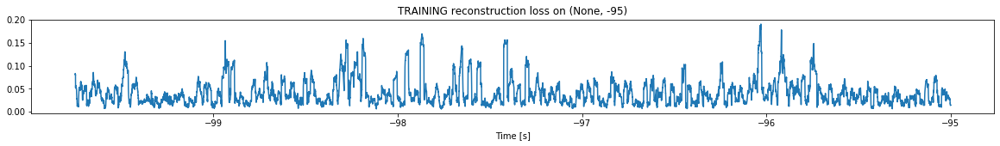

Finished training, median of the log(loss) is:  -1.4634339333663853
<--------
Entering sections:  (-90, -85)
-------->
Training for section:  (-95, -90)


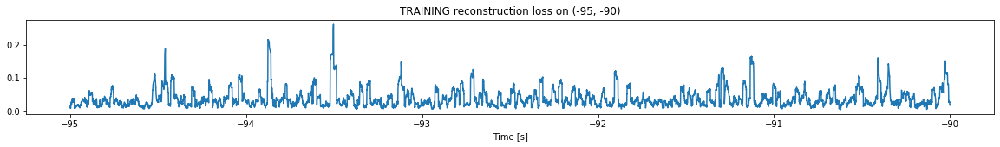

Finished training, median of the log(loss) is:  -1.5120732114292048
Triggering for section:  (-90, -85)
Using this median for triggering: -1.4634339333663853


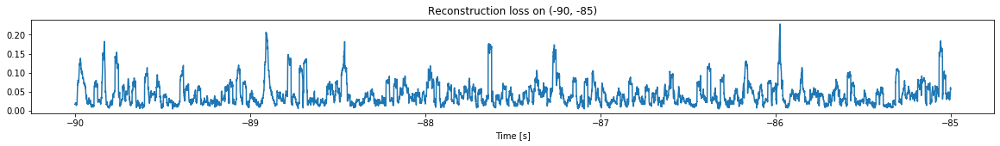

<--------
Entering sections:  (-85, -80)
-------->
Training for section:  (-90, -85)


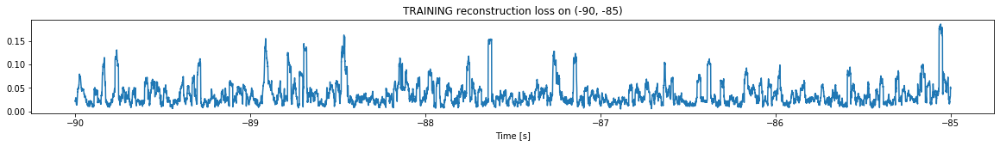

Finished training, median of the log(loss) is:  -1.5270301597968285
Triggering for section:  (-85, -80)
Using this median for triggering: -1.5120732114292048


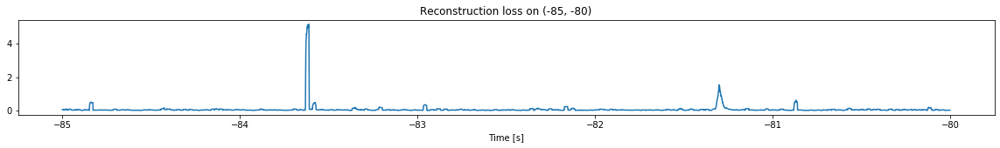

<--------
Entering sections:  (-80, -75)
-------->
Training for section:  (-85, -80)


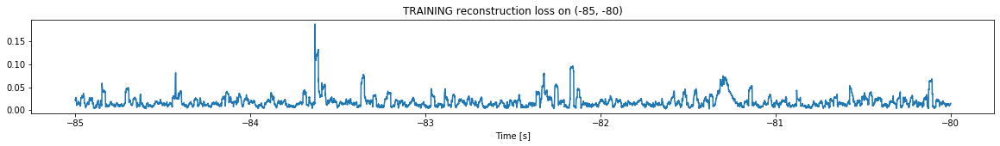

Finished training, median of the log(loss) is:  -1.8231570965514892
Triggering for section:  (-80, -75)
Using this median for triggering: -1.5270301597968285


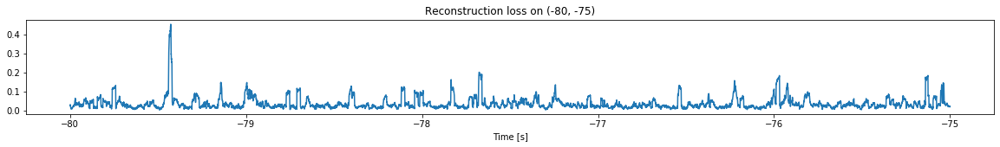

<--------
Entering sections:  (-75, -70)
-------->
Training for section:  (-80, -75)


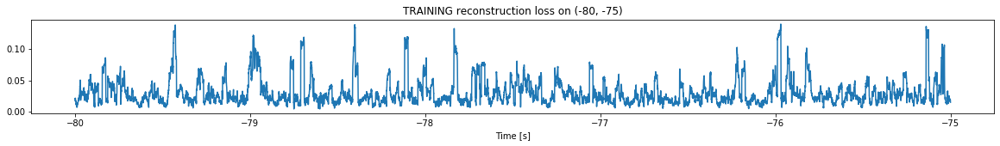

Finished training, median of the log(loss) is:  -1.619068070173872
Triggering for section:  (-75, -70)
Using this median for triggering: -1.8231570965514892


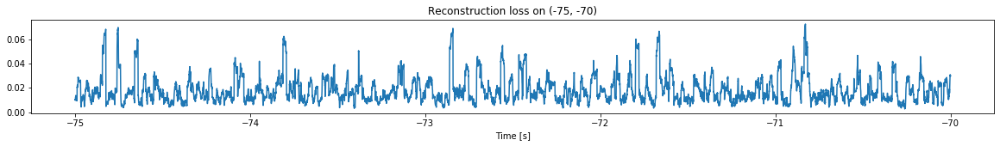

<--------
Entering sections:  (-70, -65)
-------->
Training for section:  (-75, -70)


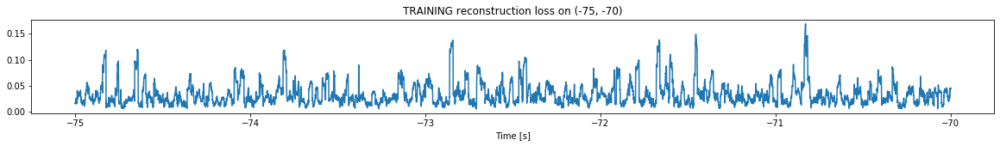

Finished training, median of the log(loss) is:  -1.5619482198420431
Triggering for section:  (-70, -65)
Using this median for triggering: -1.619068070173872


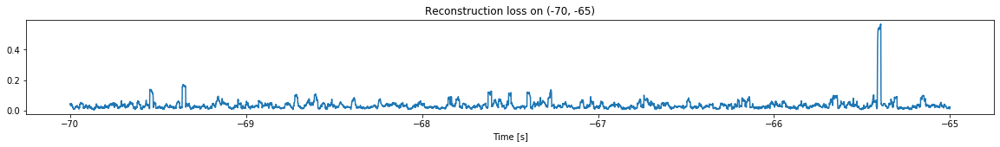

<--------
Entering sections:  (-65, -60)
-------->
Training for section:  (-70, -65)


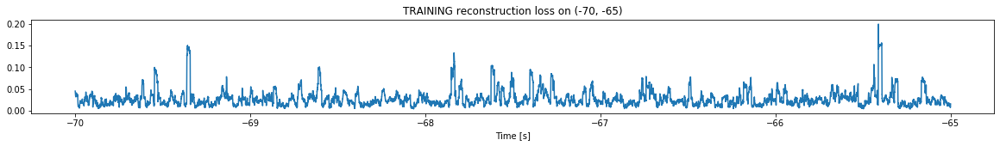

Finished training, median of the log(loss) is:  -1.6285217253764483
Triggering for section:  (-65, -60)
Using this median for triggering: -1.5619482198420431


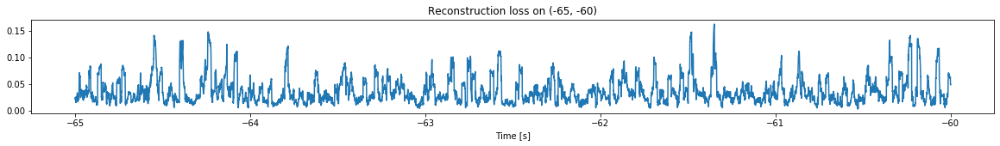

<--------
Entering sections:  (-60, -55)
-------->
Training for section:  (-65, -60)


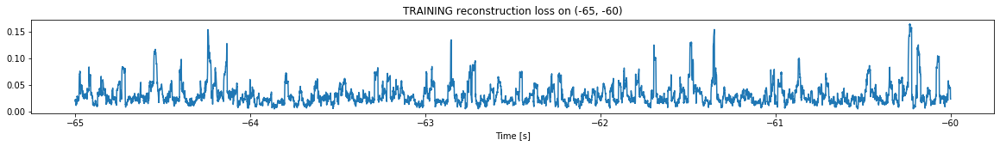

Finished training, median of the log(loss) is:  -1.5715140761313053
Triggering for section:  (-60, -55)
Using this median for triggering: -1.6285217253764483


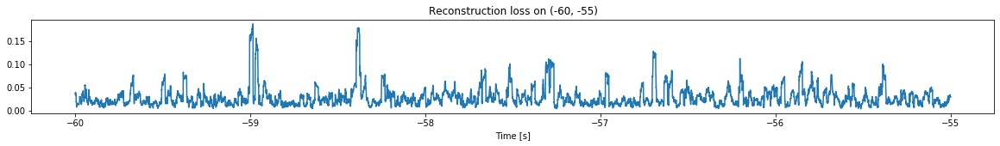

<--------
Entering sections:  (-55, -50)
-------->
Training for section:  (-60, -55)


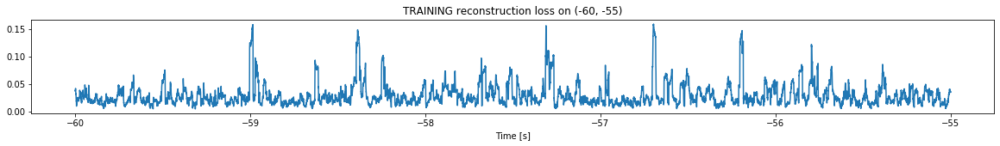

Finished training, median of the log(loss) is:  -1.6185546698472062
Triggering for section:  (-55, -50)
Using this median for triggering: -1.5715140761313053


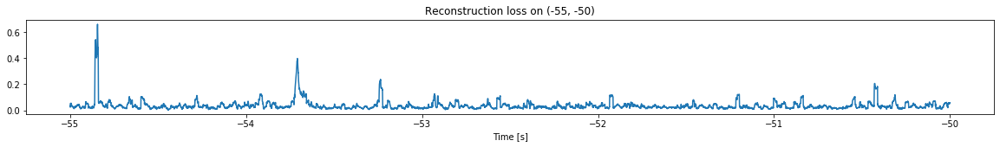

<--------
Entering sections:  (-50, -45)
-------->
Training for section:  (-55, -50)


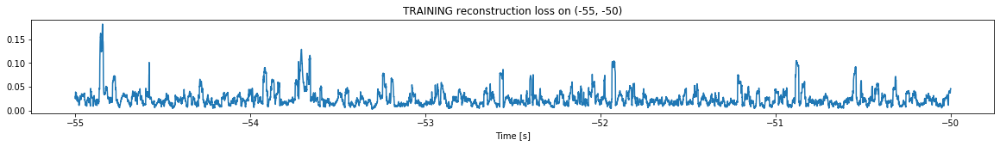

Finished training, median of the log(loss) is:  -1.688527827644026
Triggering for section:  (-50, -45)
Using this median for triggering: -1.6185546698472062


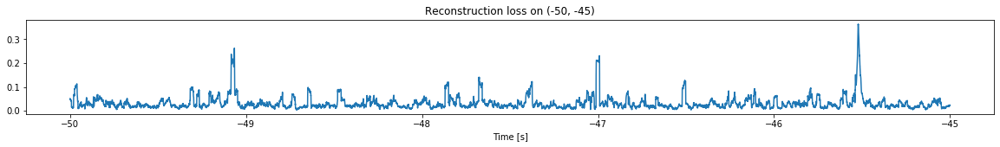

<--------
Entering sections:  (-45, -40)
-------->
Training for section:  (-50, -45)


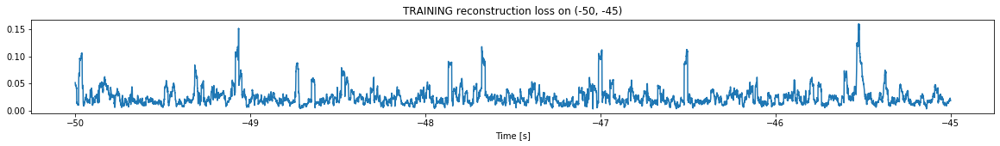

Finished training, median of the log(loss) is:  -1.6707672368925213
Triggering for section:  (-45, -40)
Using this median for triggering: -1.688527827644026


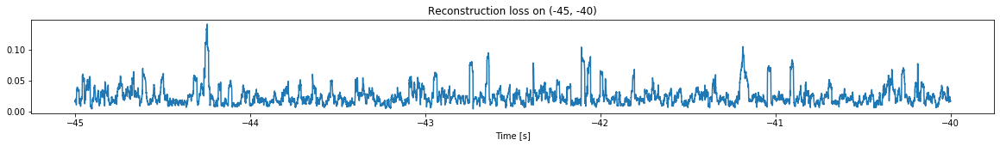

<--------
Entering sections:  (-40, -35)
-------->
Training for section:  (-45, -40)


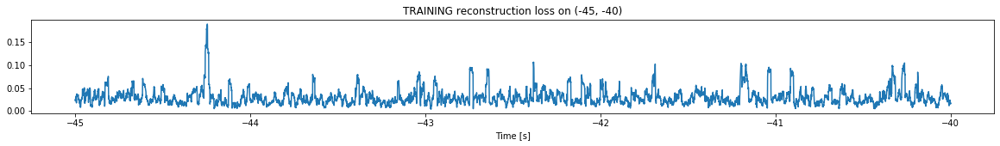

Finished training, median of the log(loss) is:  -1.5752844435638336
Triggering for section:  (-40, -35)
Using this median for triggering: -1.6707672368925213


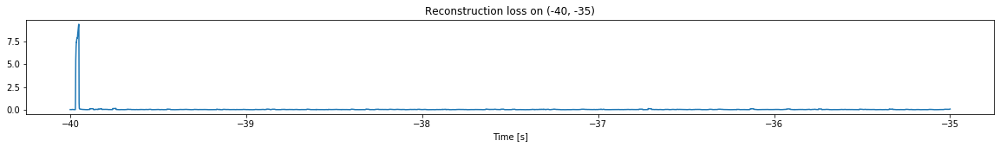

<--------
Entering sections:  (-35, -30)
-------->
Training for section:  (-40, -35)


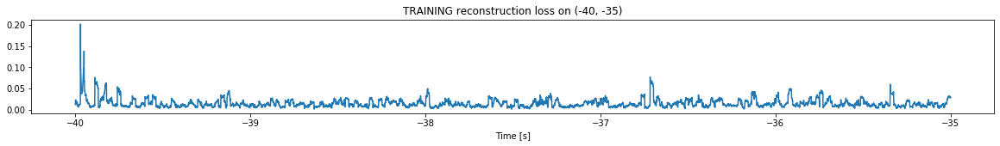

Finished training, median of the log(loss) is:  -1.8906785621113529
Triggering for section:  (-35, -30)
Using this median for triggering: -1.5752844435638336


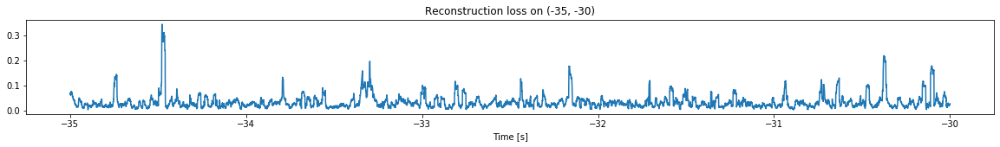

<--------
Entering sections:  (-30, -25)
-------->
Training for section:  (-35, -30)


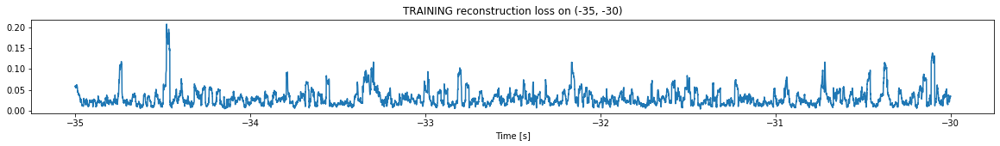

Finished training, median of the log(loss) is:  -1.6066218144771154
Triggering for section:  (-30, -25)
Using this median for triggering: -1.8906785621113529


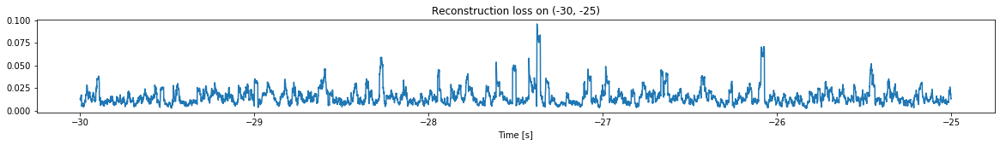

<--------
Entering sections:  (-25, -20)
-------->
Training for section:  (-30, -25)


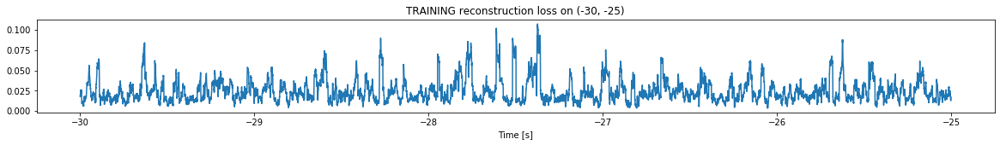

Finished training, median of the log(loss) is:  -1.6766748906635556
Triggering for section:  (-25, -20)
Using this median for triggering: -1.6066218144771154


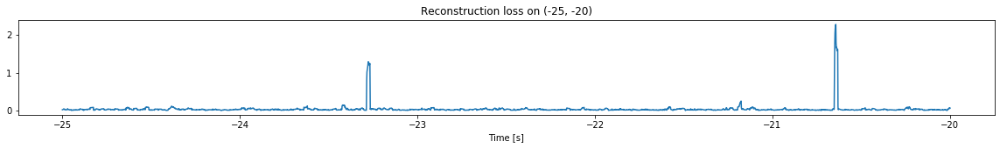

<--------
Entering sections:  (-20, -15)
-------->
Training for section:  (-25, -20)


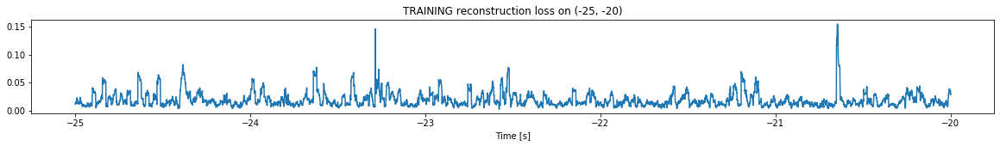

Finished training, median of the log(loss) is:  -1.813722599721089
Triggering for section:  (-20, -15)
Using this median for triggering: -1.6766748906635556


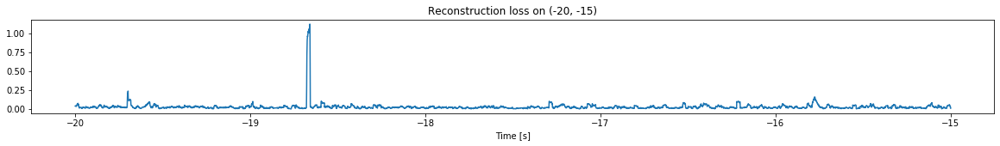

<--------
Entering sections:  (-15, -10)
-------->
Training for section:  (-20, -15)


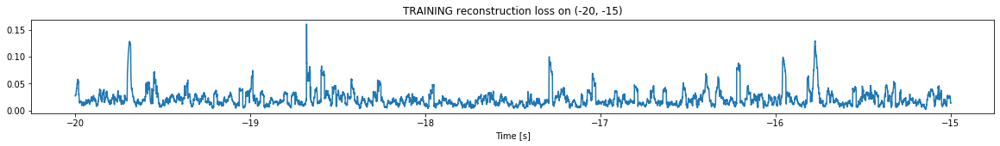

Finished training, median of the log(loss) is:  -1.7402477977023803
Triggering for section:  (-15, -10)
Using this median for triggering: -1.813722599721089


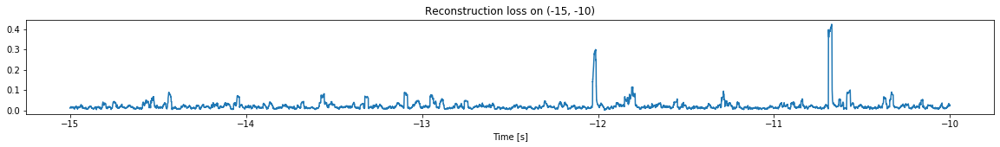

<--------
Entering sections:  (-10, -5)
-------->
Training for section:  (-15, -10)


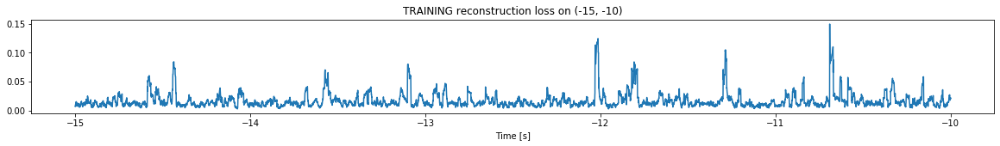

Finished training, median of the log(loss) is:  -1.8658518577396066
Triggering for section:  (-10, -5)
Using this median for triggering: -1.7402477977023803


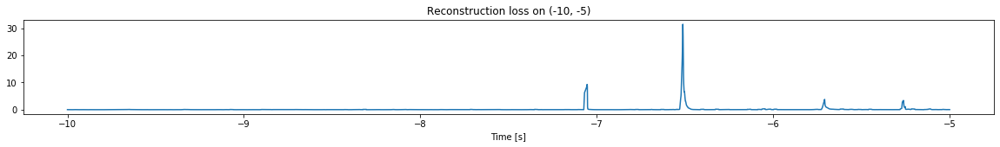

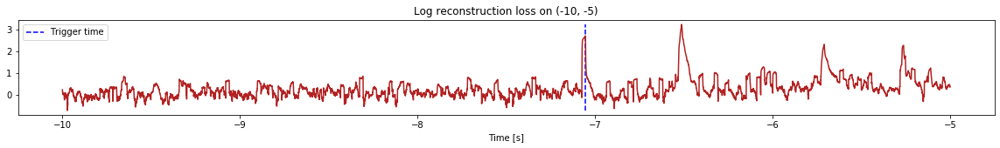

Triggered at:  -7.0554
<--------
Entering sections:  (-5, 0)
-------->
Training for section:  (-10, -5)


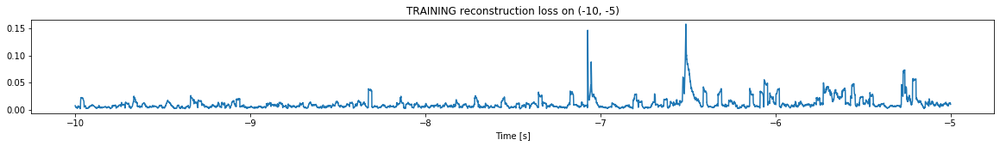

Finished training, median of the log(loss) is:  -2.0954280742714455
Triggering for section:  (-5, 0)
Using this median for triggering: -1.8658518577396066


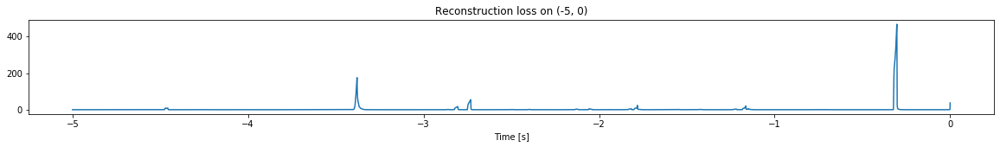

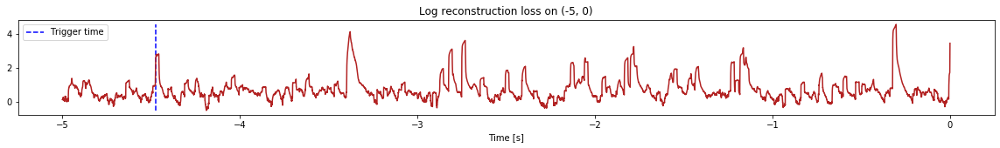

Triggered at:  -4.4726
<--------
Finished simulation, all the triggered times are:  [-7.0554, -4.4726]


In [6]:
simulation("./data/Ramp12d/", 5, (-100,0))

In [7]:
#simulation("./data/Ramp19/", 5, (-300,0))

Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
All data's shape:  (2117500, 12)
Flushing input history
Number of sections: 42
Entering sections:  (-210, -205)
-------->
Entering sections:  (-205, -200)
-------->
Training for section:  (None, -205)


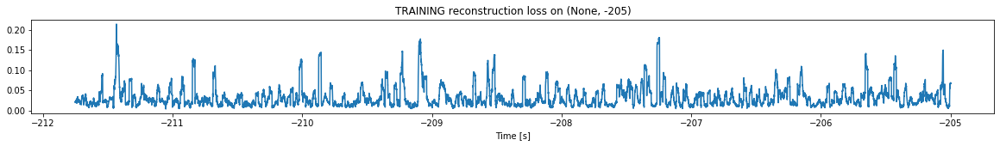

Finished training, median of the log(loss) is:  -1.6035710798965574
<--------
Entering sections:  (-200, -195)
-------->
Training for section:  (-205, -200)


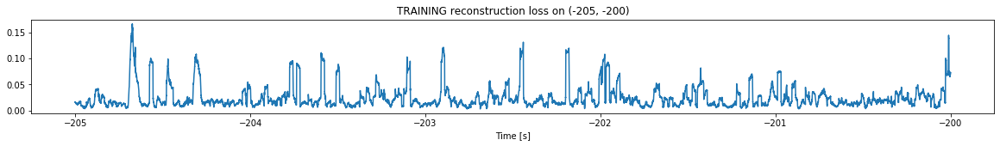

Finished training, median of the log(loss) is:  -1.7468733022892518
Triggering for section:  (-200, -195)
Using this median for triggering: -1.6035710798965574


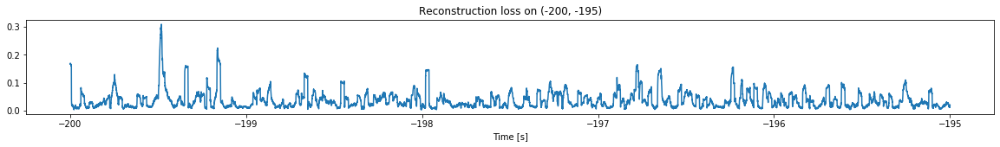

<--------
Entering sections:  (-195, -190)
-------->
Training for section:  (-200, -195)


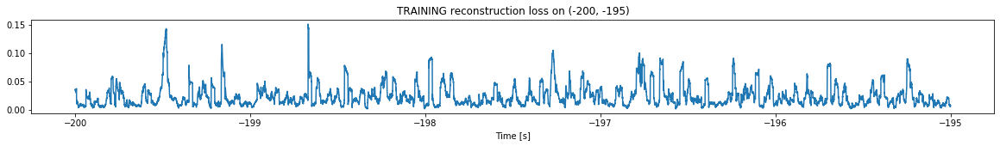

Finished training, median of the log(loss) is:  -1.7114503169336128
Triggering for section:  (-195, -190)
Using this median for triggering: -1.7468733022892518


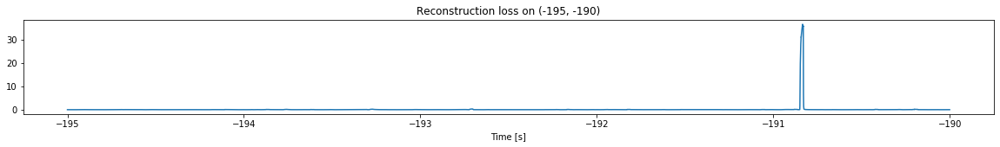

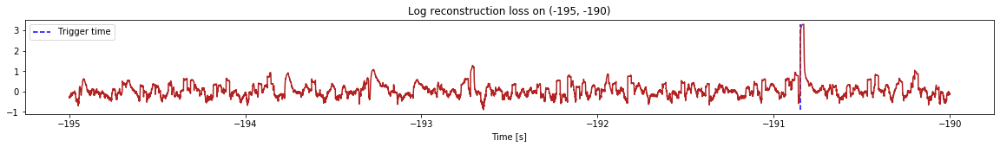

Triggered at:  -190.84787
<--------
Entering sections:  (-190, -185)
-------->
Training for section:  (-195, -190)


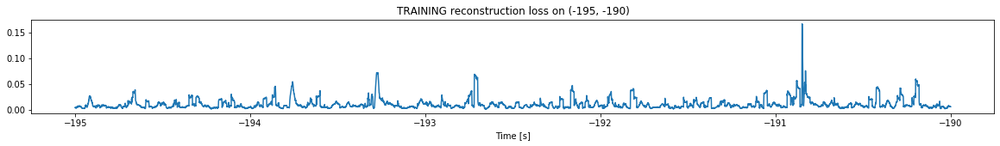

Finished training, median of the log(loss) is:  -2.12268703943364
Triggering for section:  (-190, -185)
Using this median for triggering: -1.7114503169336128


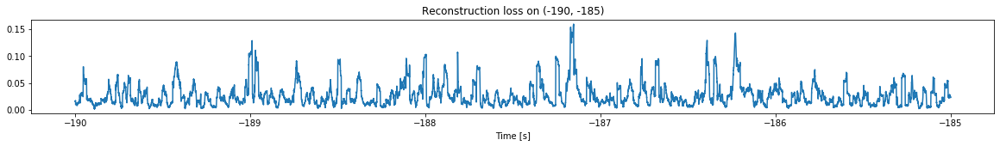

<--------
Entering sections:  (-185, -180)
-------->
Training for section:  (-190, -185)


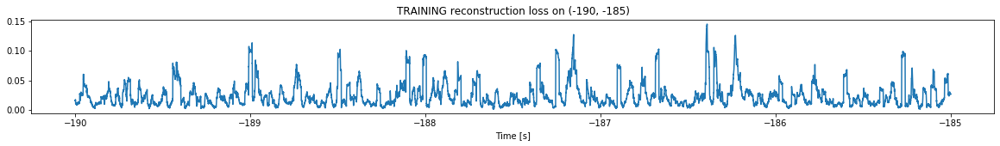

Finished training, median of the log(loss) is:  -1.7132195421969156
Triggering for section:  (-185, -180)
Using this median for triggering: -2.12268703943364


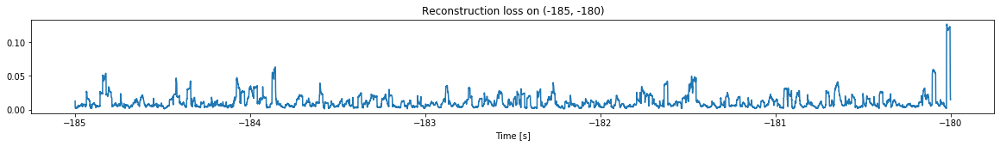

<--------
Entering sections:  (-180, -175)
-------->
Training for section:  (-185, -180)


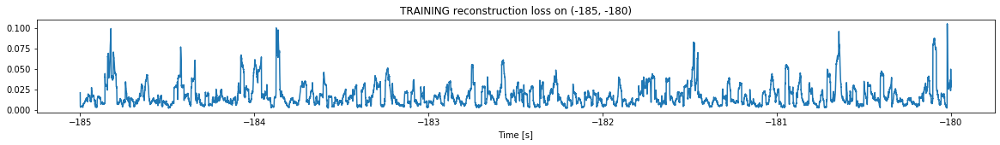

Finished training, median of the log(loss) is:  -1.8572478109141994
Triggering for section:  (-180, -175)
Using this median for triggering: -1.7132195421969156


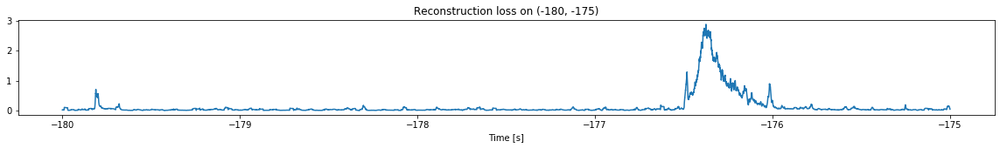

<--------
Entering sections:  (-175, -170)
-------->
Training for section:  (-180, -175)


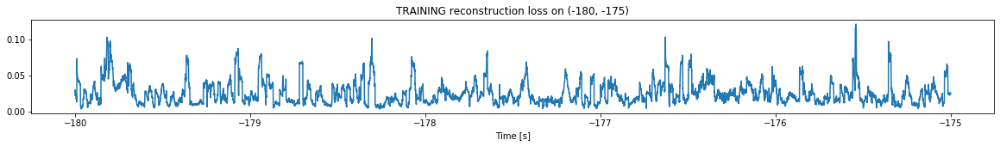

Finished training, median of the log(loss) is:  -1.6750254481983582
Triggering for section:  (-175, -170)
Using this median for triggering: -1.8572478109141994


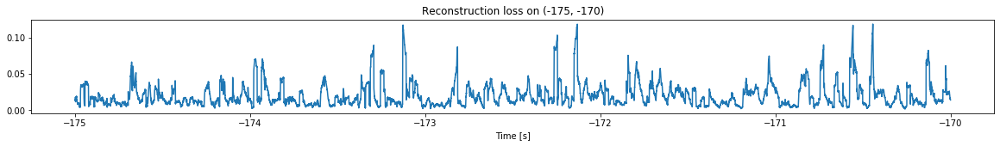

<--------
Entering sections:  (-170, -165)
-------->
Training for section:  (-175, -170)


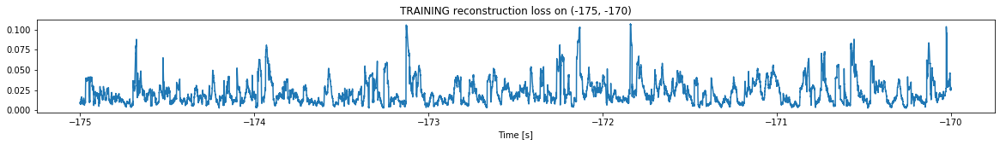

Finished training, median of the log(loss) is:  -1.7394939992413225
Triggering for section:  (-170, -165)
Using this median for triggering: -1.6750254481983582


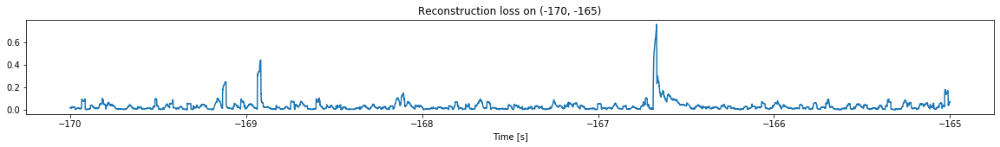

<--------
Entering sections:  (-165, -160)
-------->
Training for section:  (-170, -165)


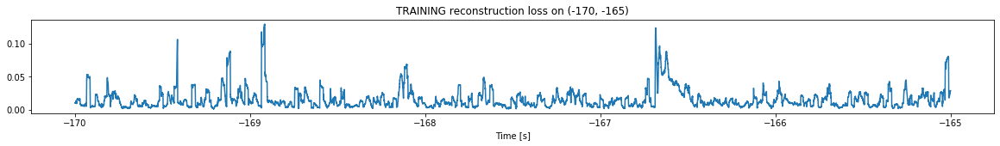

Finished training, median of the log(loss) is:  -1.9270760357867391
Triggering for section:  (-165, -160)
Using this median for triggering: -1.7394939992413225


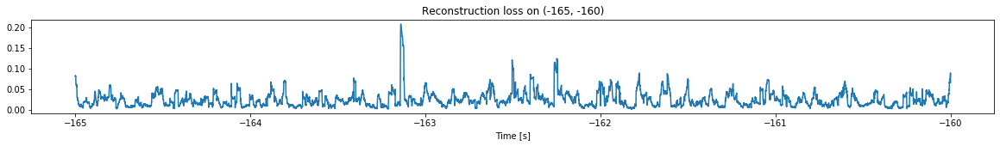

<--------
Entering sections:  (-160, -155)
-------->
Training for section:  (-165, -160)


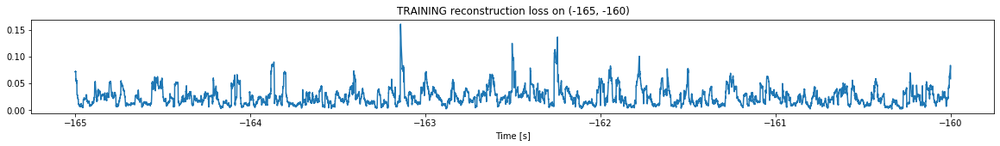

Finished training, median of the log(loss) is:  -1.6638752895626583
Triggering for section:  (-160, -155)
Using this median for triggering: -1.9270760357867391


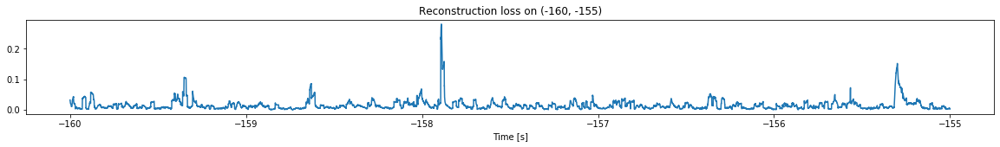

<--------
Entering sections:  (-155, -150)
-------->
Training for section:  (-160, -155)


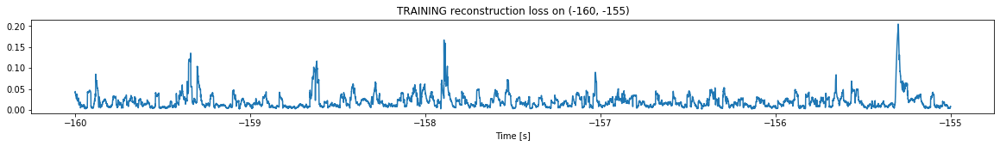

Finished training, median of the log(loss) is:  -1.797355461558433
Triggering for section:  (-155, -150)
Using this median for triggering: -1.6638752895626583


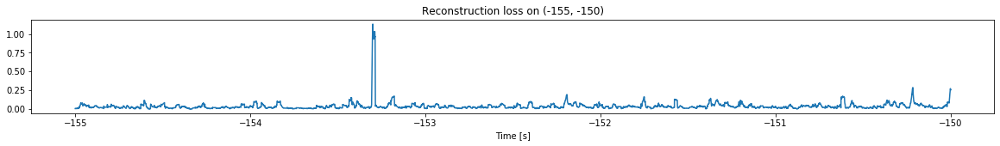

<--------
Entering sections:  (-150, -145)
-------->
Training for section:  (-155, -150)


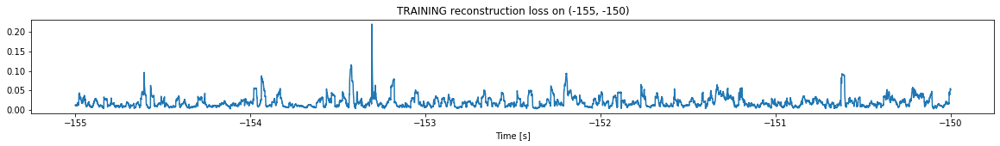

Finished training, median of the log(loss) is:  -1.797229319751756
Triggering for section:  (-150, -145)
Using this median for triggering: -1.797355461558433


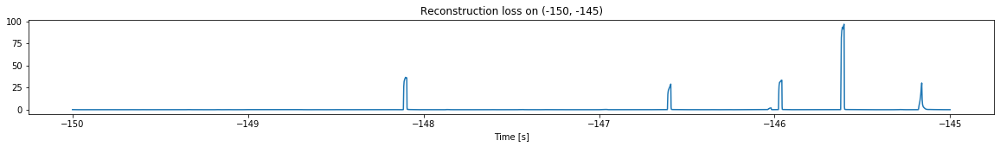

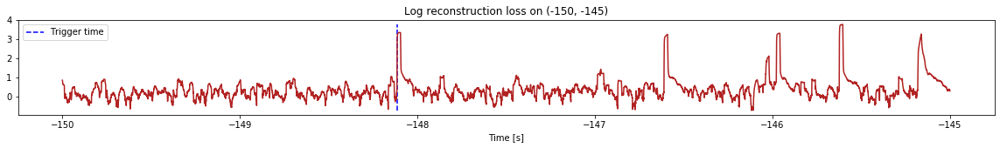

Triggered at:  -148.11438
<--------
Entering sections:  (-145, -140)
-------->
Training for section:  (-150, -145)


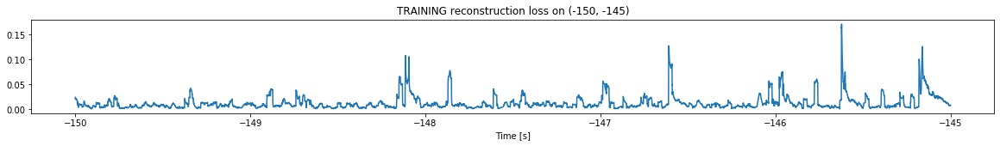

Finished training, median of the log(loss) is:  -2.0701822279875115
Triggering for section:  (-145, -140)
Using this median for triggering: -1.797229319751756


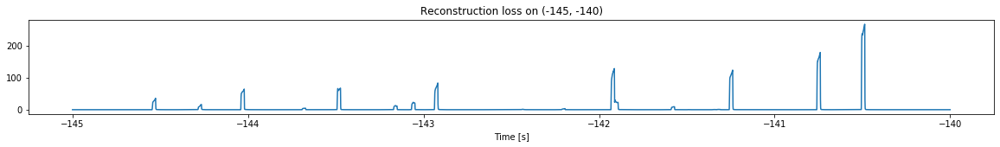

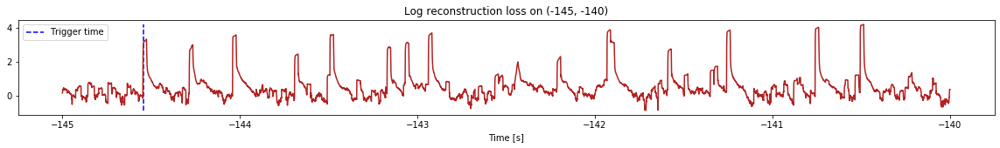

Triggered at:  -144.54518
<--------
Entering sections:  (-140, -135)
-------->
Training for section:  (-145, -140)


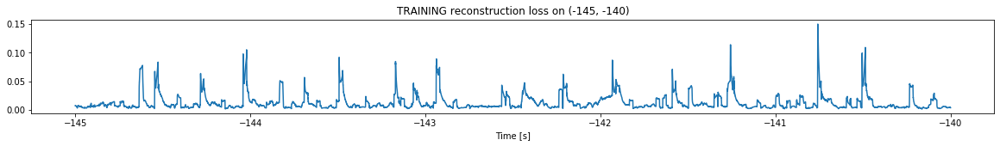

Finished training, median of the log(loss) is:  -2.1093198969005043
Triggering for section:  (-140, -135)
Using this median for triggering: -2.0701822279875115


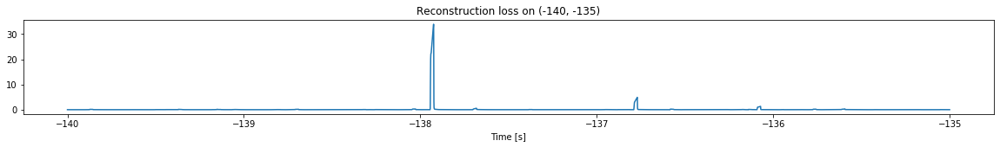

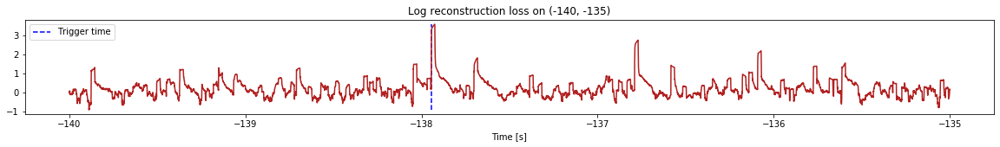

Triggered at:  -137.94328
<--------
Entering sections:  (-135, -130)
-------->
Training for section:  (-140, -135)


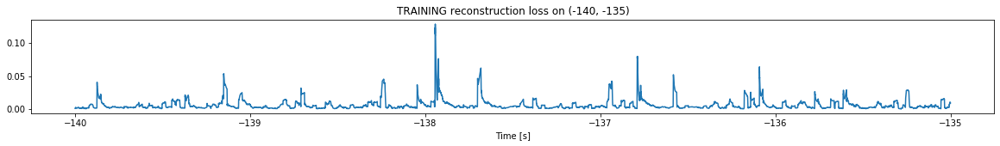

Finished training, median of the log(loss) is:  -2.396518827434716
Triggering for section:  (-135, -130)
Using this median for triggering: -2.1093198969005043


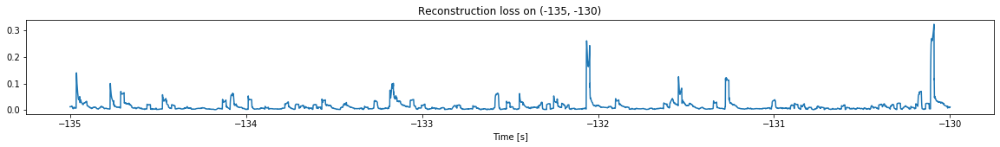

<--------
Entering sections:  (-130, -125)
-------->
Training for section:  (-135, -130)


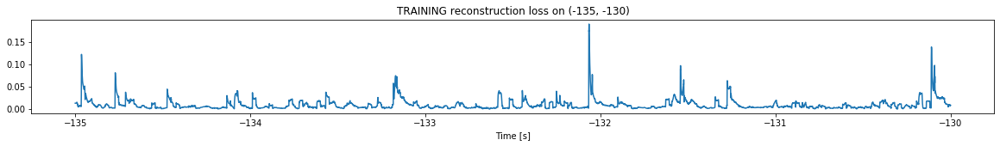

Finished training, median of the log(loss) is:  -2.181532573087745
Triggering for section:  (-130, -125)
Using this median for triggering: -2.396518827434716


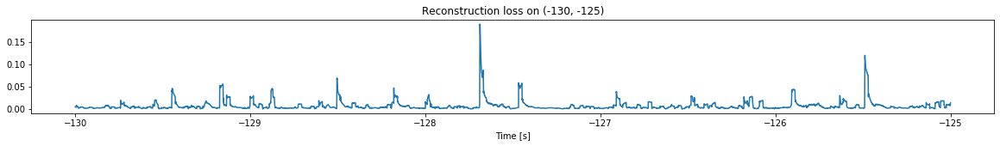

<--------
Entering sections:  (-125, -120)
-------->
Training for section:  (-130, -125)


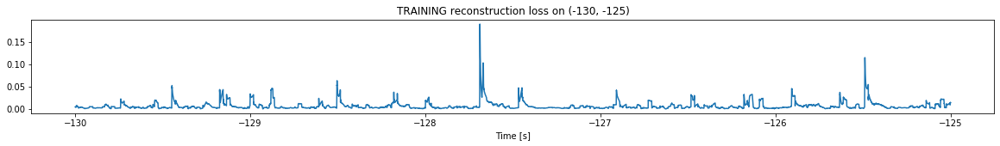

Finished training, median of the log(loss) is:  -2.3386966954449813
Triggering for section:  (-125, -120)
Using this median for triggering: -2.181532573087745


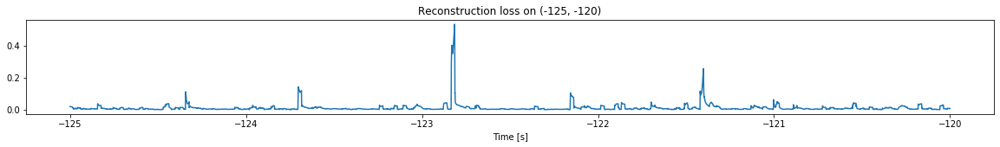

<--------
Entering sections:  (-120, -115)
-------->
Training for section:  (-125, -120)


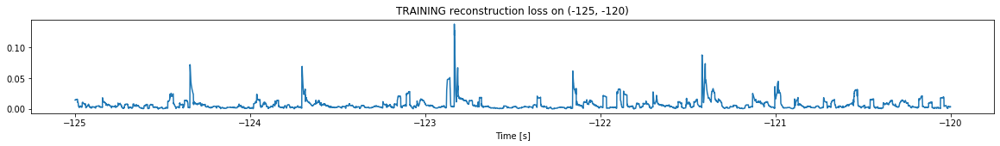

Finished training, median of the log(loss) is:  -2.3028269871519695
Triggering for section:  (-120, -115)
Using this median for triggering: -2.3386966954449813


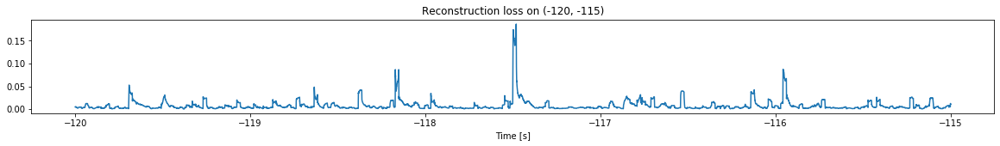

<--------
Entering sections:  (-115, -110)
-------->
Training for section:  (-120, -115)


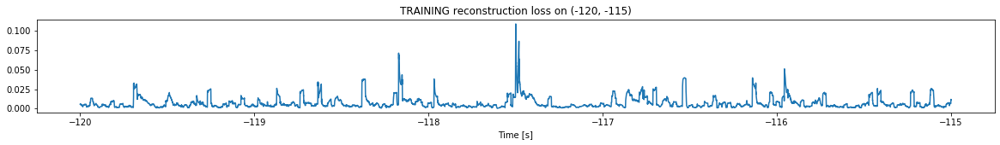

Finished training, median of the log(loss) is:  -2.3247098856330686
Triggering for section:  (-115, -110)
Using this median for triggering: -2.3028269871519695


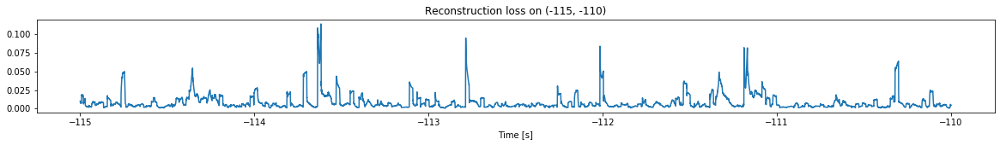

<--------
Entering sections:  (-110, -105)
-------->
Training for section:  (-115, -110)


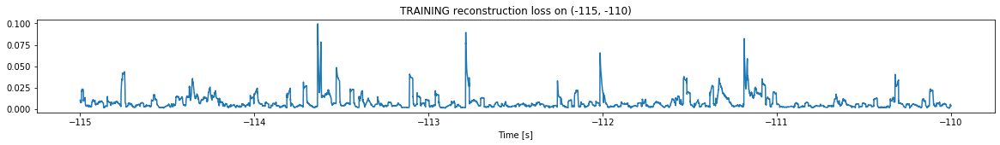

Finished training, median of the log(loss) is:  -2.297114354491016
Triggering for section:  (-110, -105)
Using this median for triggering: -2.3247098856330686


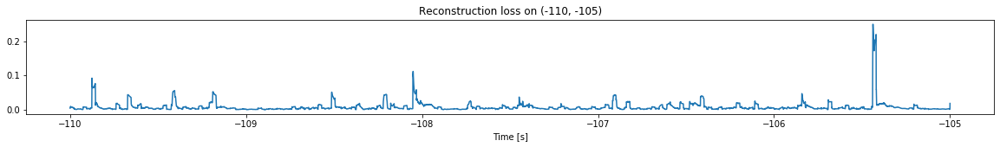

<--------
Entering sections:  (-105, -100)
-------->
Training for section:  (-110, -105)


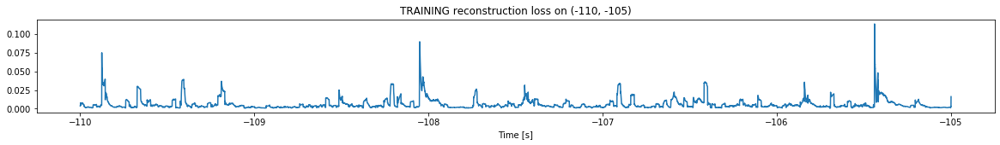

Finished training, median of the log(loss) is:  -2.4149277260765727
Triggering for section:  (-105, -100)
Using this median for triggering: -2.297114354491016


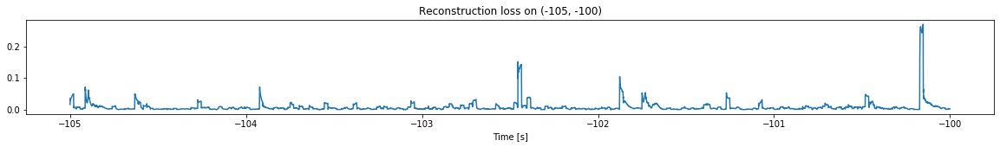

<--------
Entering sections:  (-100, -95)
-------->
Training for section:  (-105, -100)


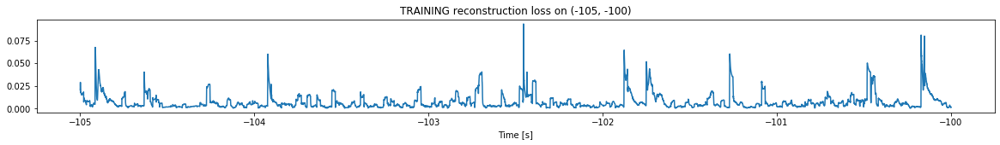

Finished training, median of the log(loss) is:  -2.3055264535193523
Triggering for section:  (-100, -95)
Using this median for triggering: -2.4149277260765727


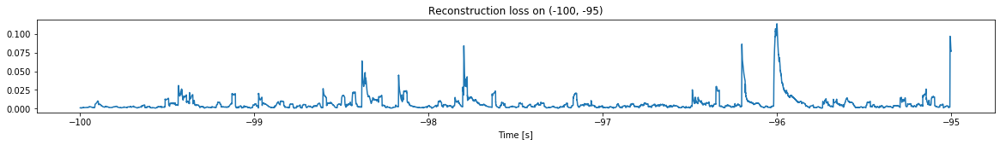

<--------
Entering sections:  (-95, -90)
-------->
Training for section:  (-100, -95)


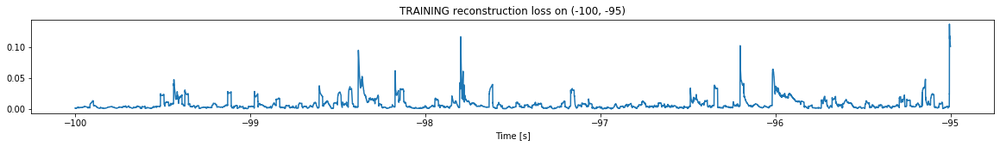

Finished training, median of the log(loss) is:  -2.30295856878384
Triggering for section:  (-95, -90)
Using this median for triggering: -2.3055264535193523


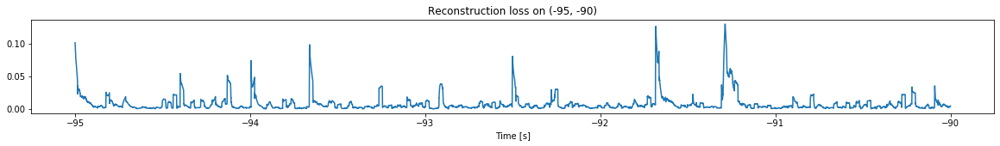

<--------
Entering sections:  (-90, -85)
-------->
Training for section:  (-95, -90)


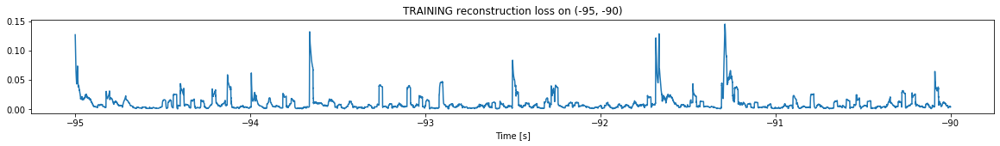

Finished training, median of the log(loss) is:  -2.2021794151794847
Triggering for section:  (-90, -85)
Using this median for triggering: -2.30295856878384


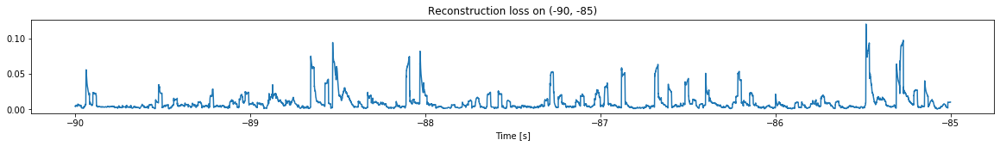

<--------
Entering sections:  (-85, -80)
-------->
Training for section:  (-90, -85)


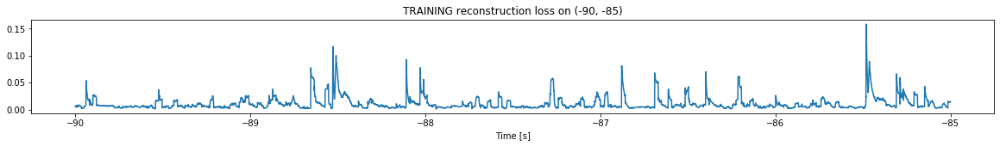

Finished training, median of the log(loss) is:  -2.157762658420694
Triggering for section:  (-85, -80)
Using this median for triggering: -2.2021794151794847


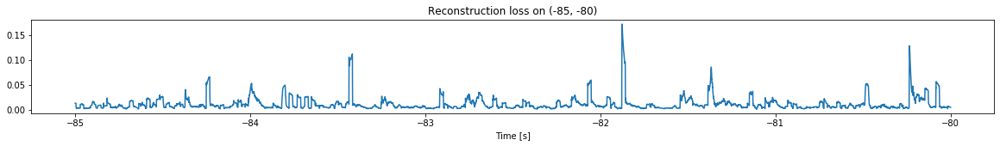

<--------
Entering sections:  (-80, -75)
-------->
Training for section:  (-85, -80)


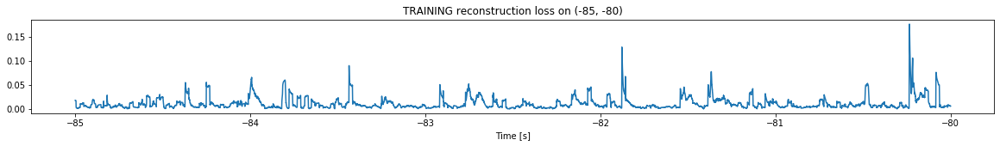

Finished training, median of the log(loss) is:  -2.0930698464085755
Triggering for section:  (-80, -75)
Using this median for triggering: -2.157762658420694


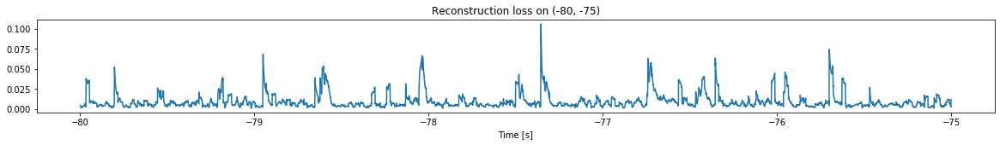

<--------
Entering sections:  (-75, -70)
-------->
Training for section:  (-80, -75)


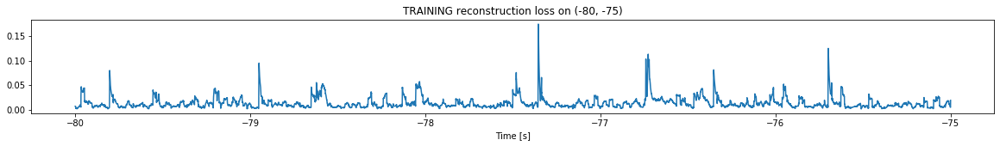

Finished training, median of the log(loss) is:  -2.000465843229319
Triggering for section:  (-75, -70)
Using this median for triggering: -2.0930698464085755


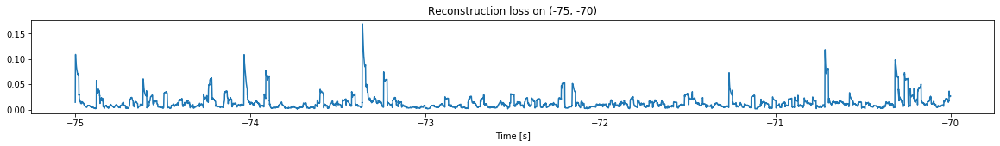

<--------
Entering sections:  (-70, -65)
-------->
Training for section:  (-75, -70)


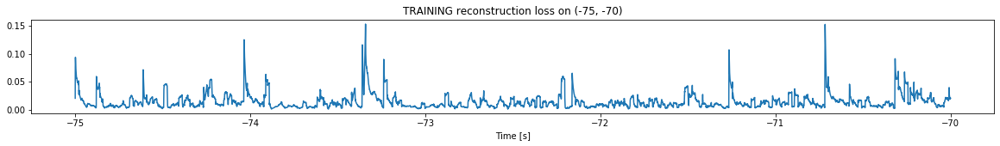

Finished training, median of the log(loss) is:  -1.962929035990653
Triggering for section:  (-70, -65)
Using this median for triggering: -2.000465843229319


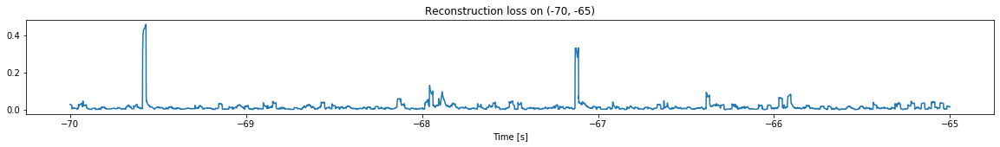

<--------
Entering sections:  (-65, -60)
-------->
Training for section:  (-70, -65)


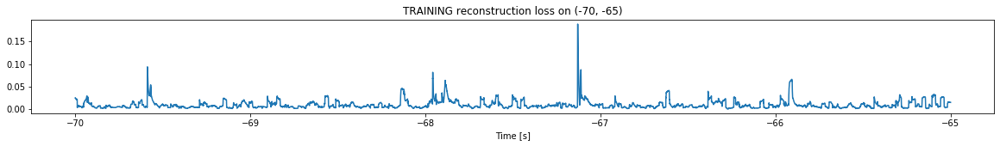

Finished training, median of the log(loss) is:  -2.140458834475915
Triggering for section:  (-65, -60)
Using this median for triggering: -1.962929035990653


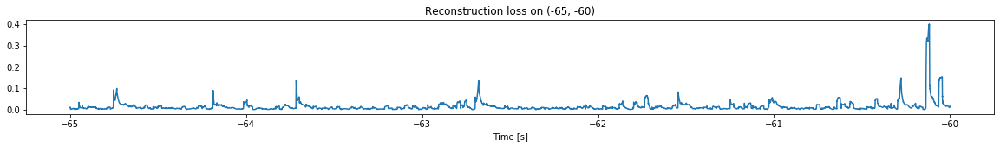

<--------
Entering sections:  (-60, -55)
-------->
Training for section:  (-65, -60)


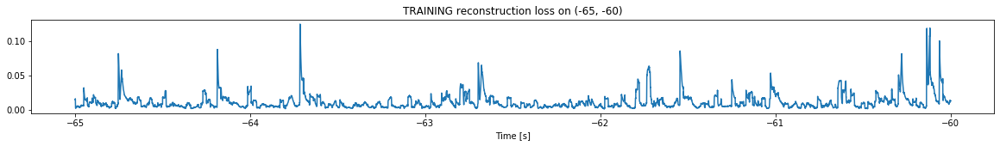

Finished training, median of the log(loss) is:  -2.1061457442700027
Triggering for section:  (-60, -55)
Using this median for triggering: -2.140458834475915


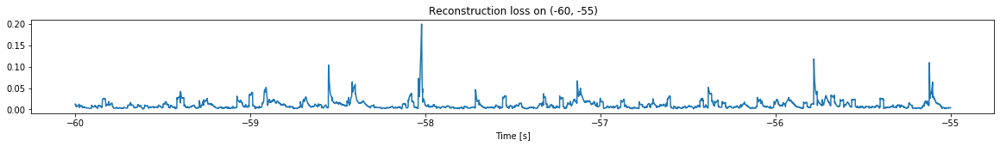

<--------
Entering sections:  (-55, -50)
-------->
Training for section:  (-60, -55)


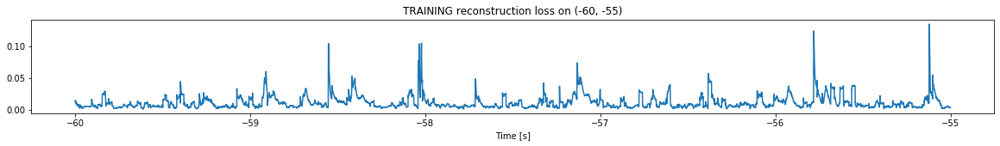

Finished training, median of the log(loss) is:  -2.08000095730065
Triggering for section:  (-55, -50)
Using this median for triggering: -2.1061457442700027


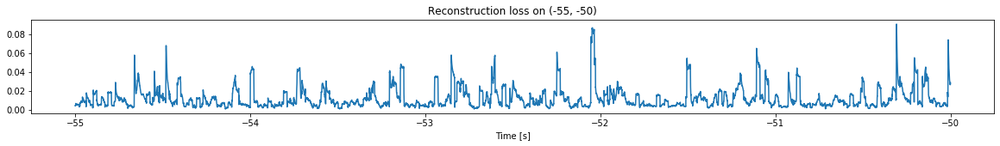

<--------
Entering sections:  (-50, -45)
-------->
Training for section:  (-55, -50)


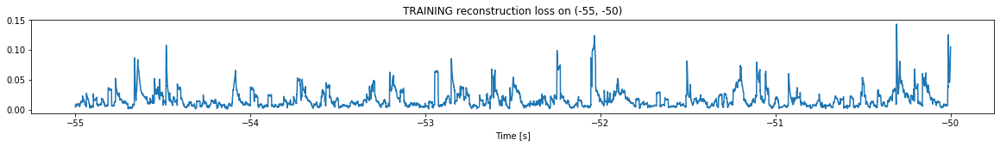

Finished training, median of the log(loss) is:  -1.8740860044670777
Triggering for section:  (-50, -45)
Using this median for triggering: -2.08000095730065


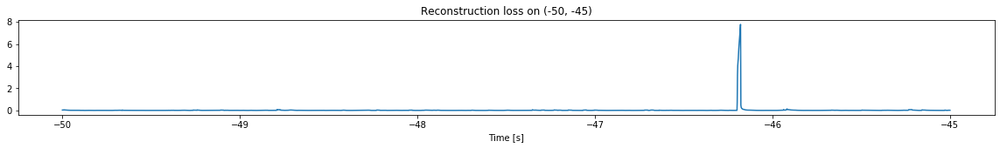

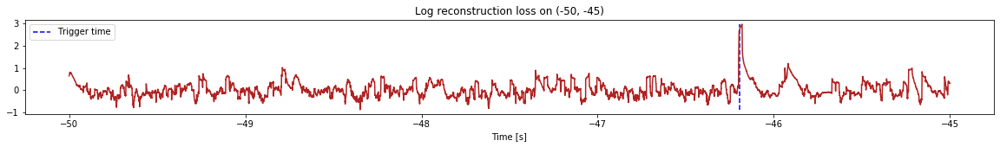

Triggered at:  -46.19519
<--------
Entering sections:  (-45, -40)
-------->
Training for section:  (-50, -45)


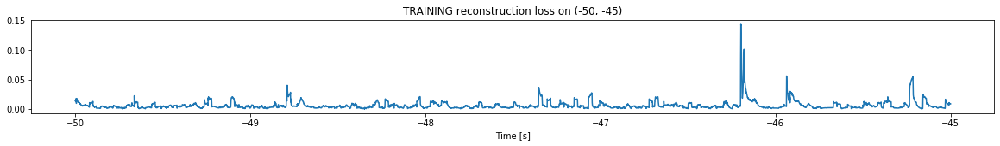

Finished training, median of the log(loss) is:  -2.3520474640467377
Triggering for section:  (-45, -40)
Using this median for triggering: -1.8740860044670777


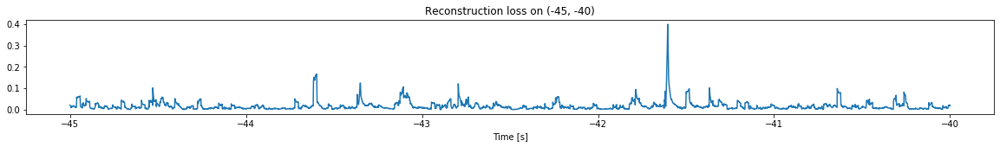

<--------
Entering sections:  (-40, -35)
-------->
Training for section:  (-45, -40)


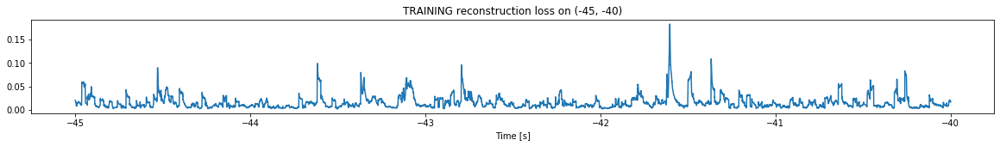

Finished training, median of the log(loss) is:  -1.930168446454191
Triggering for section:  (-40, -35)
Using this median for triggering: -2.3520474640467377


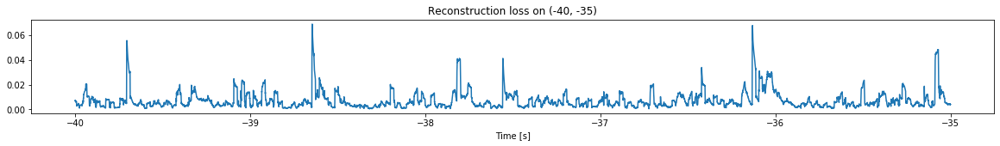

<--------
Entering sections:  (-35, -30)
-------->
Training for section:  (-40, -35)


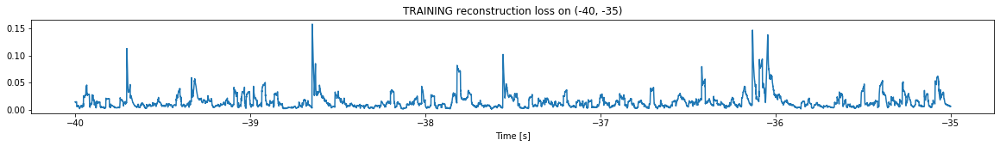

Finished training, median of the log(loss) is:  -1.9709615024515248
Triggering for section:  (-35, -30)
Using this median for triggering: -1.930168446454191


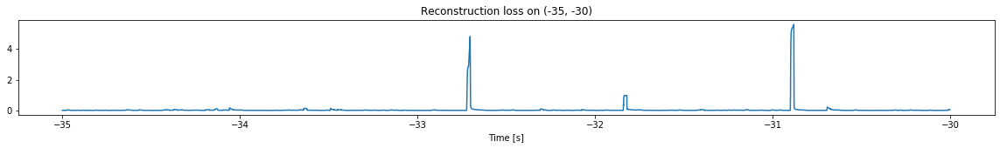

<--------
Entering sections:  (-30, -25)
-------->
Training for section:  (-35, -30)


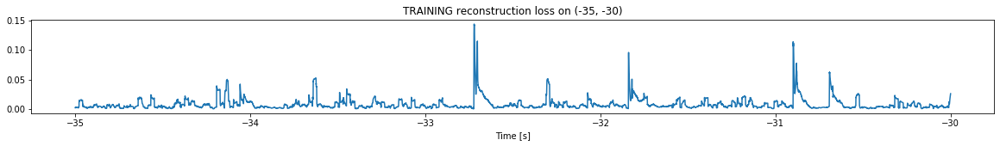

Finished training, median of the log(loss) is:  -2.2421540931060235
Triggering for section:  (-30, -25)
Using this median for triggering: -1.9709615024515248


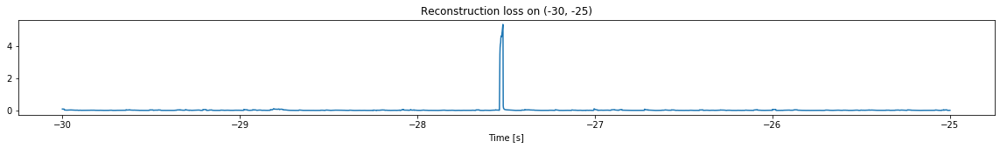

<--------
Entering sections:  (-25, -20)
-------->
Training for section:  (-30, -25)


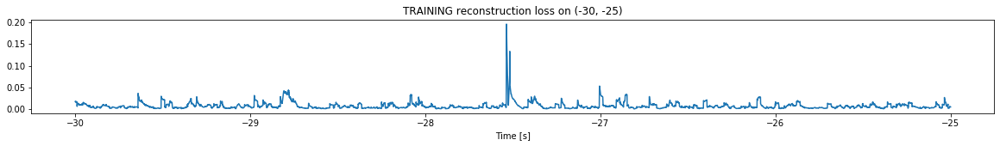

Finished training, median of the log(loss) is:  -2.257143938328805
Triggering for section:  (-25, -20)
Using this median for triggering: -2.2421540931060235


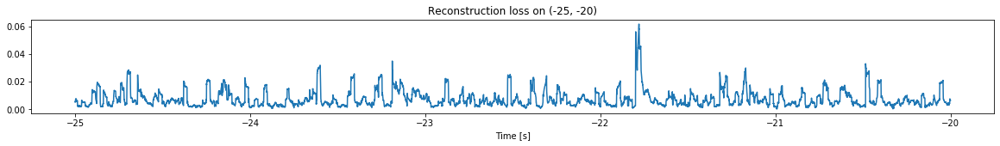

<--------
Entering sections:  (-20, -15)
-------->
Training for section:  (-25, -20)


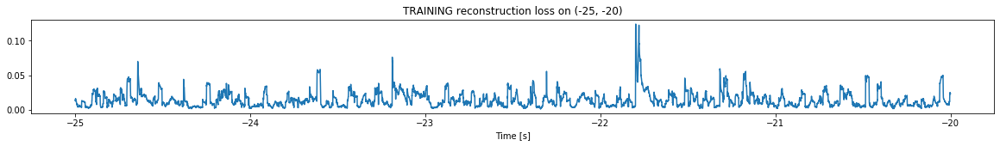

Finished training, median of the log(loss) is:  -1.9149104157280135
Triggering for section:  (-20, -15)
Using this median for triggering: -2.257143938328805


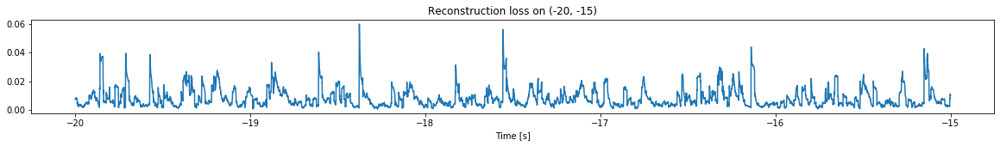

<--------
Entering sections:  (-15, -10)
-------->
Training for section:  (-20, -15)


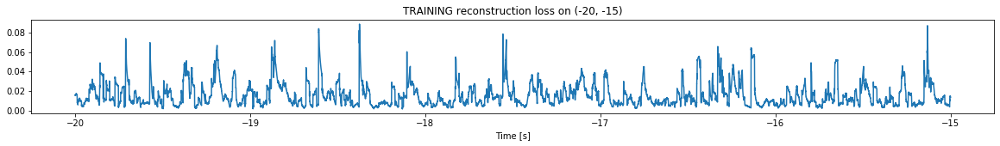

Finished training, median of the log(loss) is:  -1.9163175443885467
Triggering for section:  (-15, -10)
Using this median for triggering: -1.9149104157280135


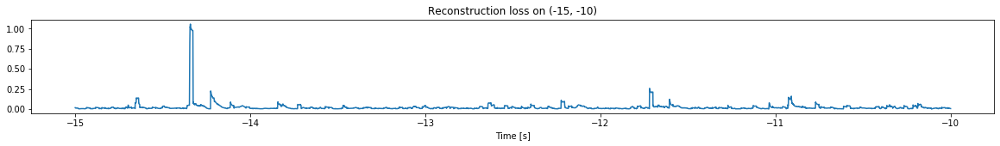

<--------
Entering sections:  (-10, -5)
-------->
Training for section:  (-15, -10)


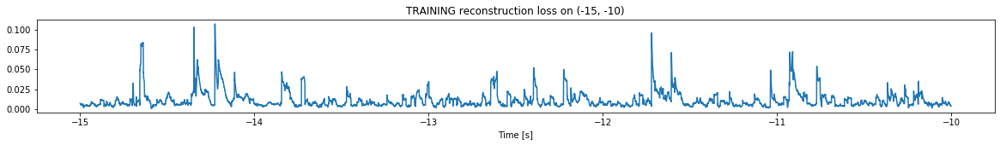

Finished training, median of the log(loss) is:  -2.1086066982332516
Triggering for section:  (-10, -5)
Using this median for triggering: -1.9163175443885467


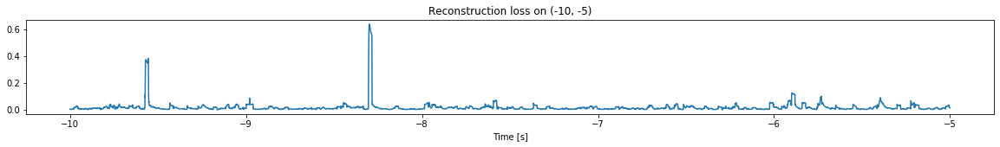

<--------
Entering sections:  (-5, 0)
-------->
Training for section:  (-10, -5)


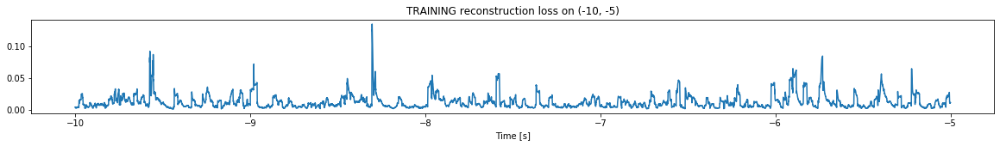

Finished training, median of the log(loss) is:  -2.0360309242766665
Triggering for section:  (-5, 0)
Using this median for triggering: -2.1086066982332516


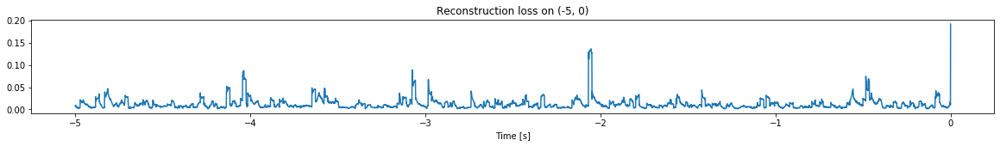

<--------
Finished simulation, all the triggered times are:  [-190.84787, -148.11438, -144.54518, -137.94328, -46.19519]


In [8]:
simulation("./data/Ramp20/", 5, (-212,0))

Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
All data's shape:  (1197500, 12)
Flushing input history
Number of sections: 24
Entering sections:  (-120, -115)
-------->
Entering sections:  (-115, -110)
-------->
Training for section:  (None, -115)


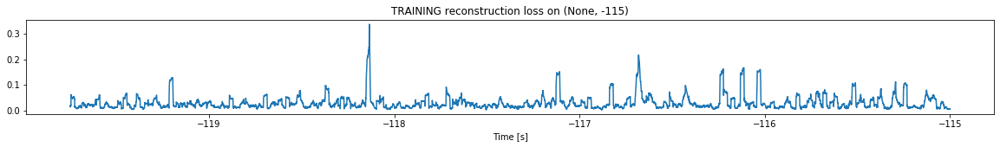

Finished training, median of the log(loss) is:  -1.6271579637670728
<--------
Entering sections:  (-110, -105)
-------->
Training for section:  (-115, -110)


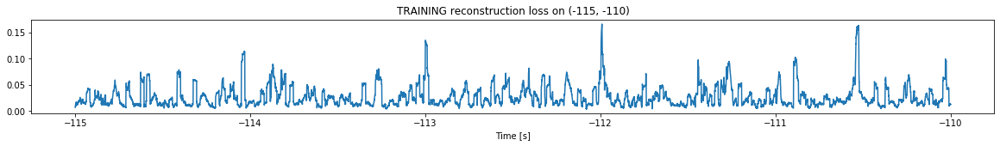

Finished training, median of the log(loss) is:  -1.6715620342662318
Triggering for section:  (-110, -105)
Using this median for triggering: -1.6271579637670728


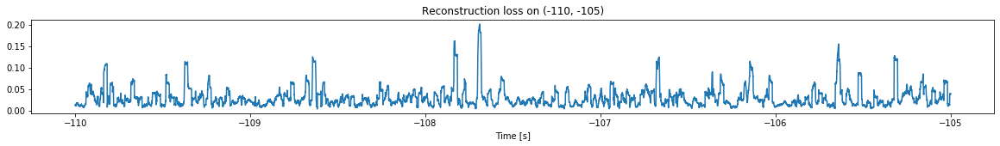

<--------
Entering sections:  (-105, -100)
-------->
Training for section:  (-110, -105)


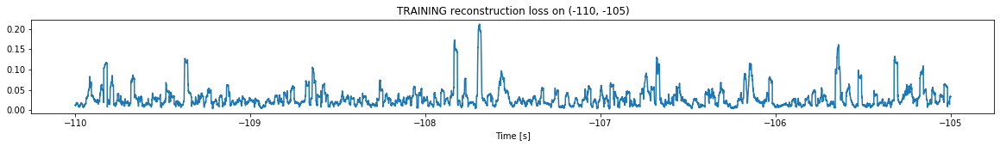

Finished training, median of the log(loss) is:  -1.6409227416069445
Triggering for section:  (-105, -100)
Using this median for triggering: -1.6715620342662318


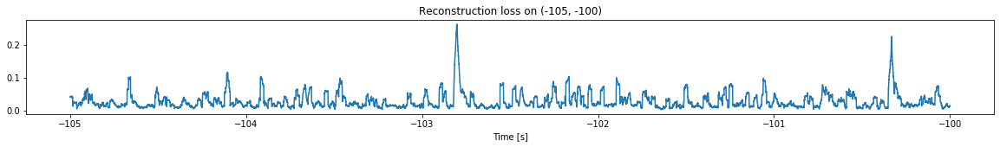

<--------
Entering sections:  (-100, -95)
-------->
Training for section:  (-105, -100)


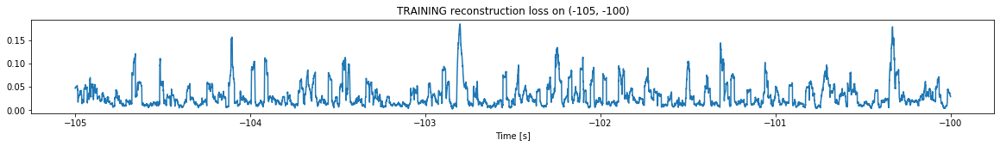

Finished training, median of the log(loss) is:  -1.64898464376915
Triggering for section:  (-100, -95)
Using this median for triggering: -1.6409227416069445


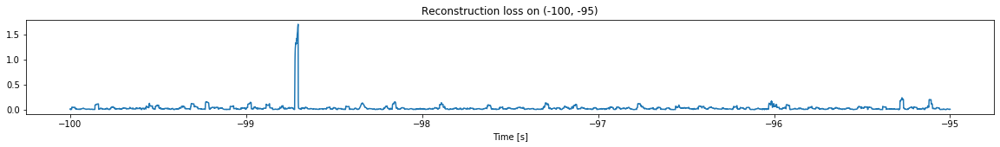

<--------
Entering sections:  (-95, -90)
-------->
Training for section:  (-100, -95)


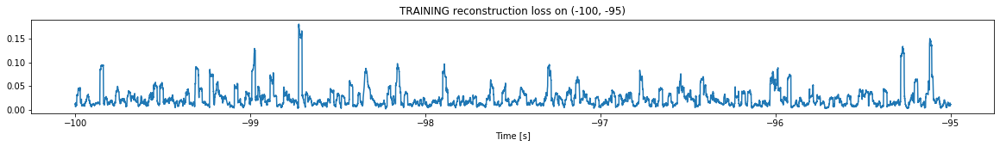

Finished training, median of the log(loss) is:  -1.729430454380695
Triggering for section:  (-95, -90)
Using this median for triggering: -1.64898464376915


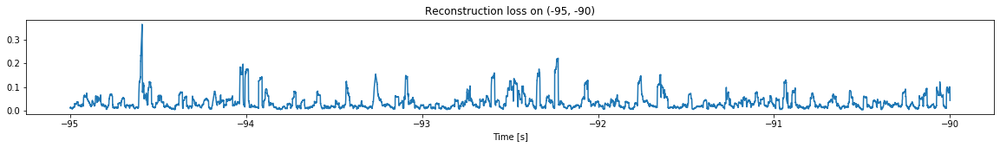

<--------
Entering sections:  (-90, -85)
-------->
Training for section:  (-95, -90)


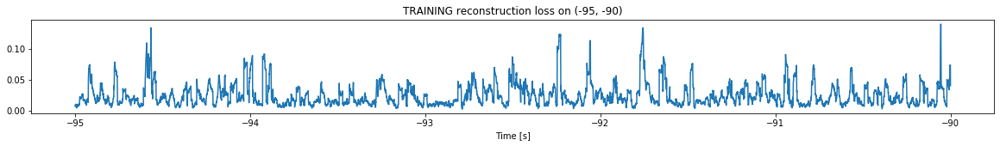

Finished training, median of the log(loss) is:  -1.717352869395018
Triggering for section:  (-90, -85)
Using this median for triggering: -1.729430454380695


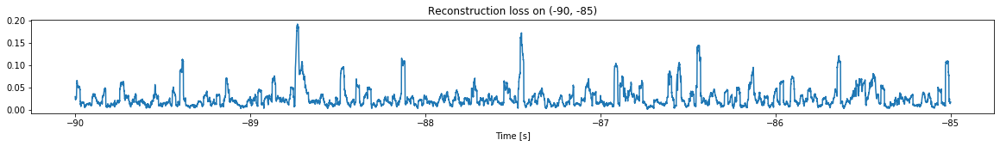

<--------
Entering sections:  (-85, -80)
-------->
Training for section:  (-90, -85)


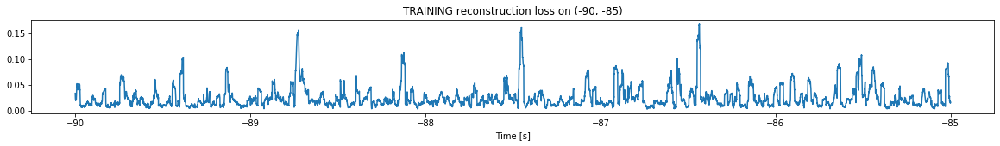

Finished training, median of the log(loss) is:  -1.7346668783390133
Triggering for section:  (-85, -80)
Using this median for triggering: -1.717352869395018


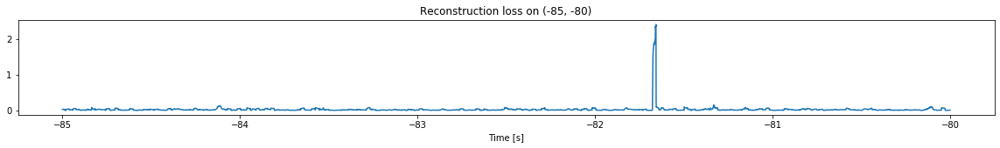

<--------
Entering sections:  (-80, -75)
-------->
Training for section:  (-85, -80)


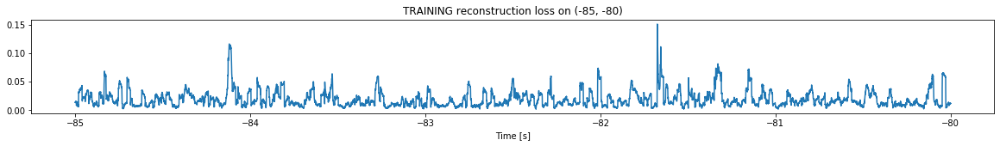

Finished training, median of the log(loss) is:  -1.8010398102655483
Triggering for section:  (-80, -75)
Using this median for triggering: -1.7346668783390133


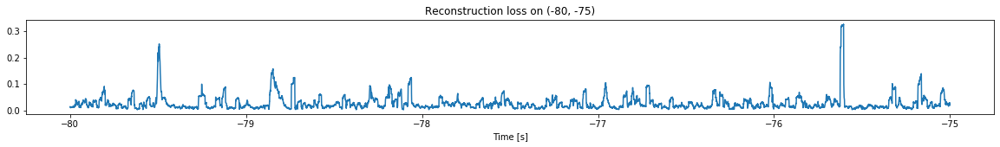

<--------
Entering sections:  (-75, -70)
-------->
Training for section:  (-80, -75)


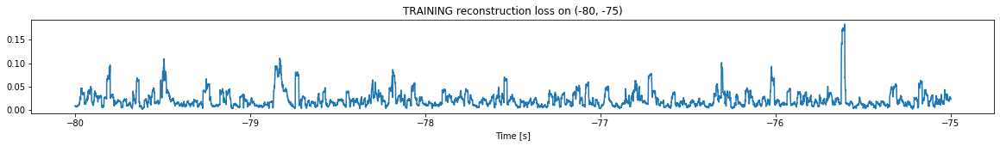

Finished training, median of the log(loss) is:  -1.762002561050478
Triggering for section:  (-75, -70)
Using this median for triggering: -1.8010398102655483


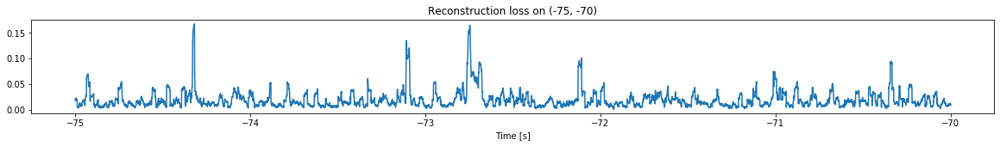

<--------
Entering sections:  (-70, -65)
-------->
Training for section:  (-75, -70)


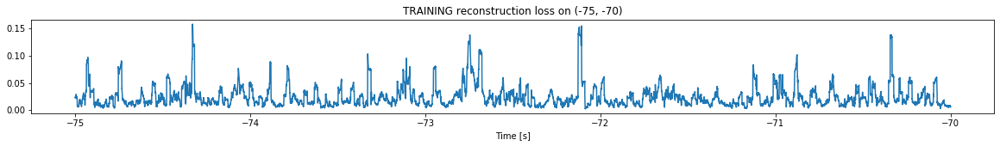

Finished training, median of the log(loss) is:  -1.7050133382537456
Triggering for section:  (-70, -65)
Using this median for triggering: -1.762002561050478


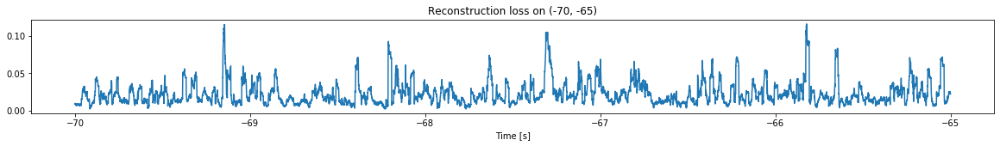

<--------
Entering sections:  (-65, -60)
-------->
Training for section:  (-70, -65)


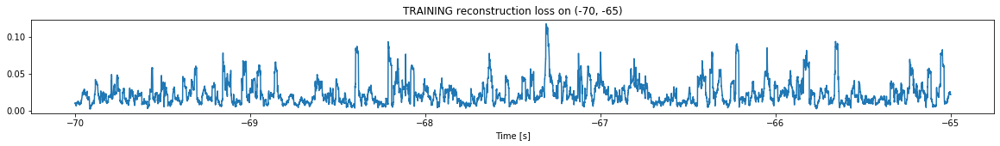

Finished training, median of the log(loss) is:  -1.7080295906739602
Triggering for section:  (-65, -60)
Using this median for triggering: -1.7050133382537456


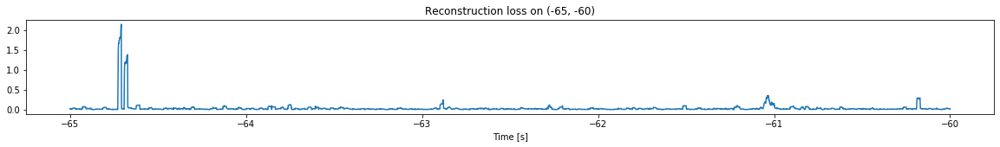

<--------
Entering sections:  (-60, -55)
-------->
Training for section:  (-65, -60)


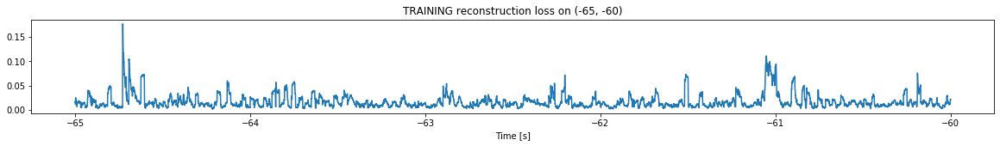

Finished training, median of the log(loss) is:  -1.8768350225171795
Triggering for section:  (-60, -55)
Using this median for triggering: -1.7080295906739602


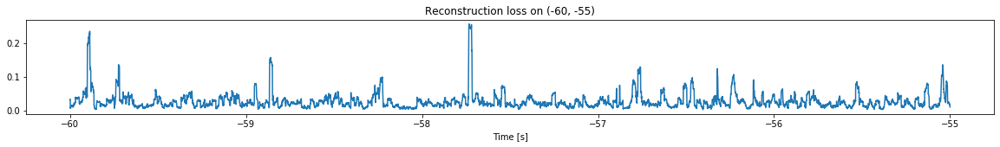

<--------
Entering sections:  (-55, -50)
-------->
Training for section:  (-60, -55)


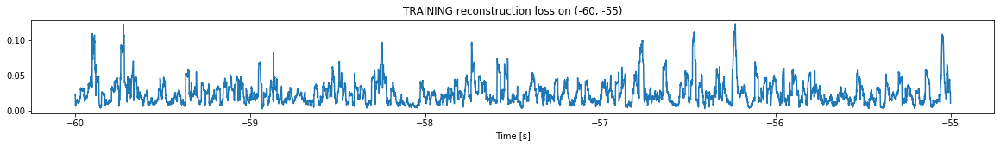

Finished training, median of the log(loss) is:  -1.670103178892702
Triggering for section:  (-55, -50)
Using this median for triggering: -1.8768350225171795


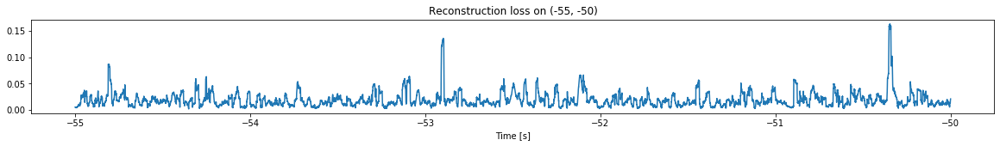

<--------
Entering sections:  (-50, -45)
-------->
Training for section:  (-55, -50)


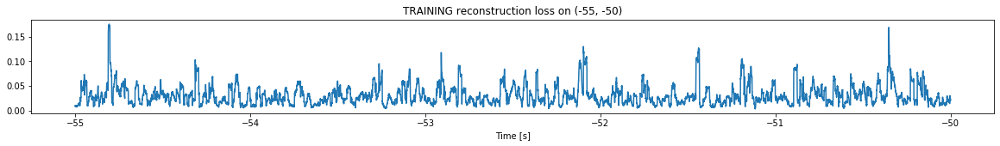

Finished training, median of the log(loss) is:  -1.5840802974629735
Triggering for section:  (-50, -45)
Using this median for triggering: -1.670103178892702


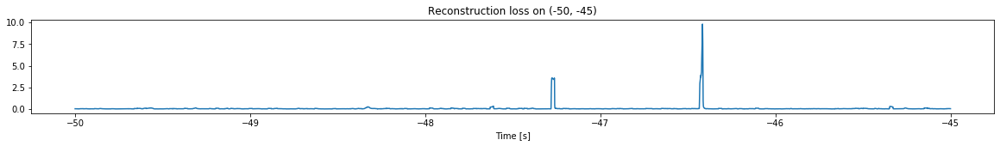

<--------
Entering sections:  (-45, -40)
-------->
Training for section:  (-50, -45)


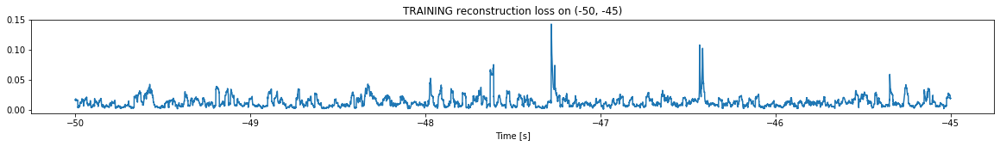

Finished training, median of the log(loss) is:  -1.9725673512712043
Triggering for section:  (-45, -40)
Using this median for triggering: -1.5840802974629735


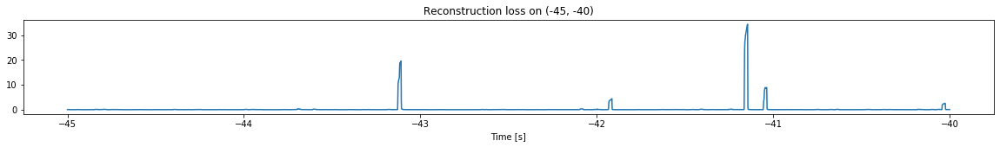

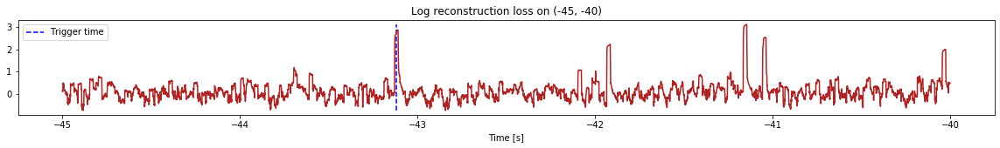

Triggered at:  -43.119
<--------
Entering sections:  (-40, -35)
-------->
Training for section:  (-45, -40)


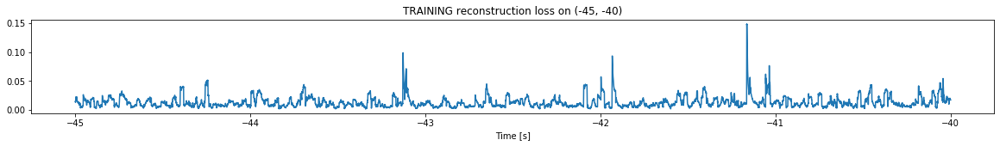

Finished training, median of the log(loss) is:  -1.9650691597163878
Triggering for section:  (-40, -35)
Using this median for triggering: -1.9725673512712043


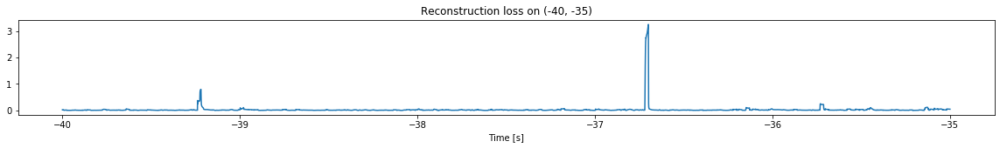

<--------
Entering sections:  (-35, -30)
-------->
Training for section:  (-40, -35)


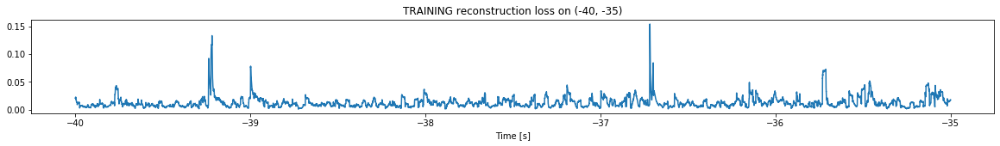

Finished training, median of the log(loss) is:  -1.9787861691891524
Triggering for section:  (-35, -30)
Using this median for triggering: -1.9650691597163878


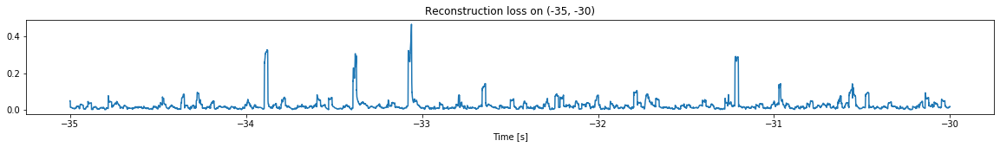

<--------
Entering sections:  (-30, -25)
-------->
Training for section:  (-35, -30)


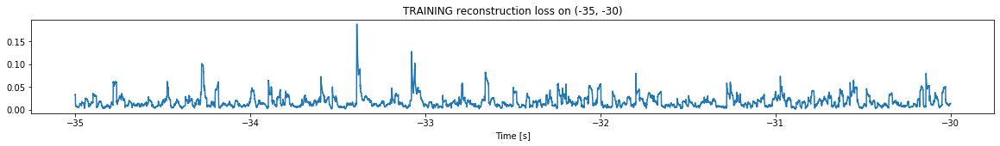

Finished training, median of the log(loss) is:  -1.8480014798205926
Triggering for section:  (-30, -25)
Using this median for triggering: -1.9787861691891524


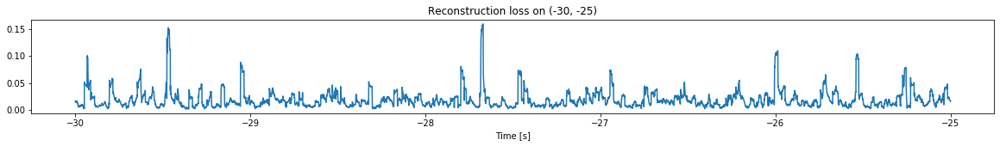

<--------
Entering sections:  (-25, -20)
-------->
Training for section:  (-30, -25)


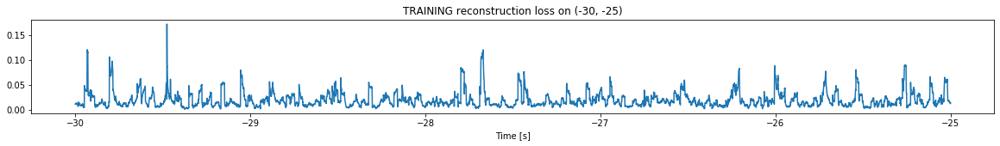

Finished training, median of the log(loss) is:  -1.7853185310335886
Triggering for section:  (-25, -20)
Using this median for triggering: -1.8480014798205926


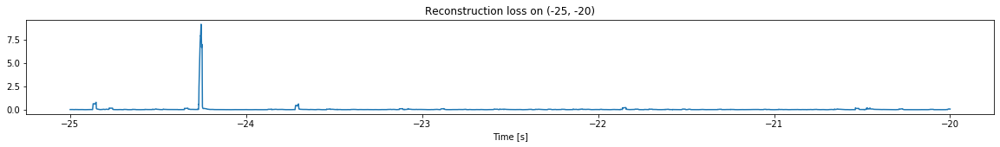

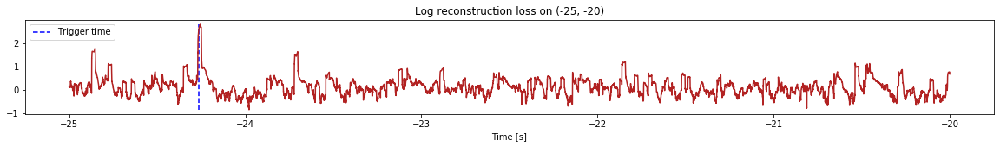

Triggered at:  -24.261599
<--------
Entering sections:  (-20, -15)
-------->
Training for section:  (-25, -20)


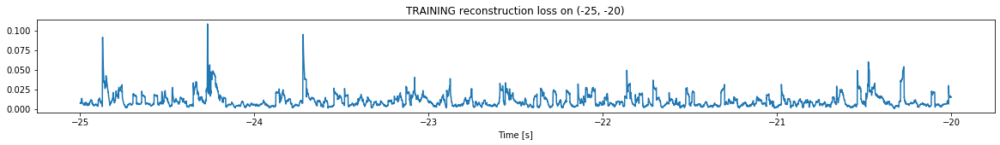

Finished training, median of the log(loss) is:  -2.1031259664255186
Triggering for section:  (-20, -15)
Using this median for triggering: -1.7853185310335886


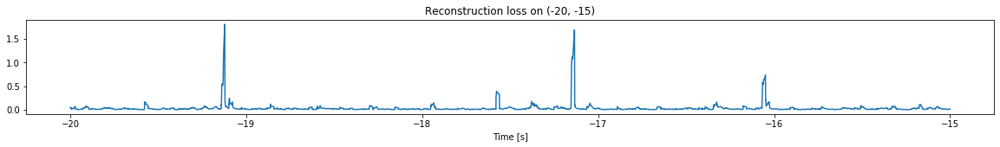

<--------
Entering sections:  (-15, -10)
-------->
Training for section:  (-20, -15)


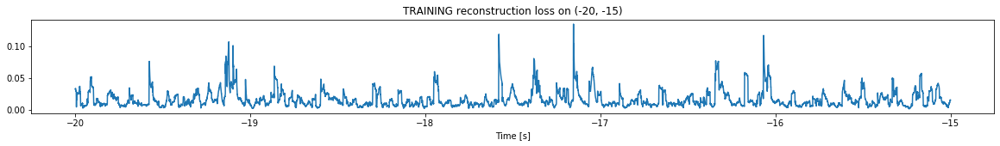

Finished training, median of the log(loss) is:  -1.9079445000396653
Triggering for section:  (-15, -10)
Using this median for triggering: -2.1031259664255186


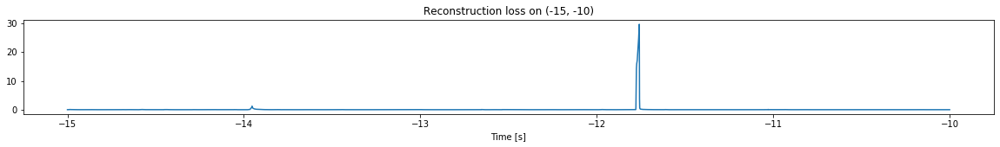

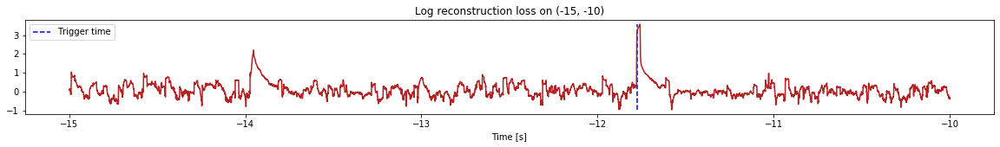

Triggered at:  -11.777599
<--------
Entering sections:  (-10, -5)
-------->
Training for section:  (-15, -10)


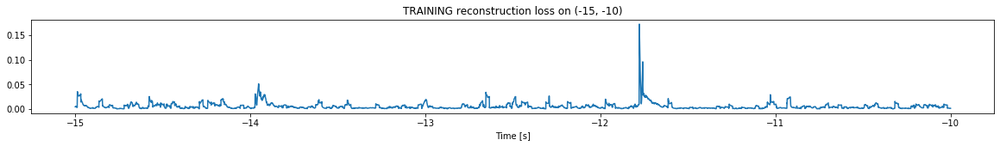

Finished training, median of the log(loss) is:  -2.382317113228205
Triggering for section:  (-10, -5)
Using this median for triggering: -1.9079445000396653


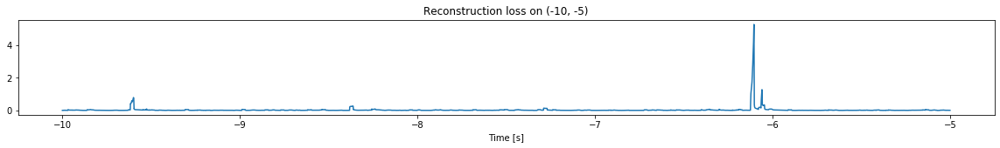

<--------
Entering sections:  (-5, 0)
-------->
Training for section:  (-10, -5)


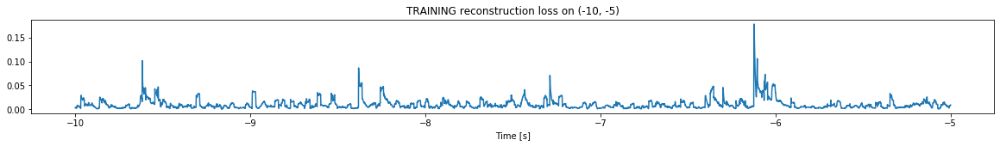

Finished training, median of the log(loss) is:  -2.1125460425530145
Triggering for section:  (-5, 0)
Using this median for triggering: -2.382317113228205


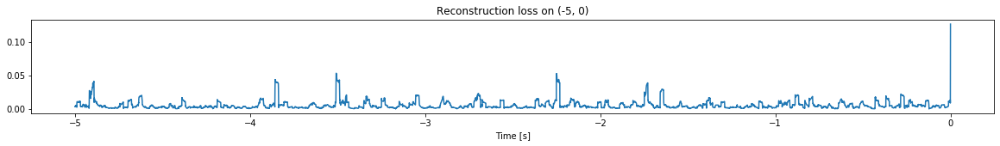

<--------
Finished simulation, all the triggered times are:  [-43.119, -24.261599, -11.777599]


In [9]:
simulation("./data/Ramp21/", 5, (-120,0))

Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
All data's shape:  (797500, 12)
Flushing input history
Number of sections: 16
Entering sections:  (-80, -75)
-------->
Entering sections:  (-75, -70)
-------->
Training for section:  (None, -75)


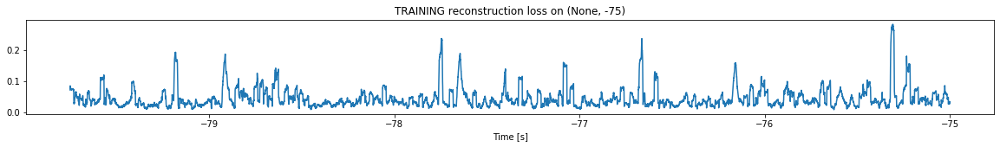

Finished training, median of the log(loss) is:  -1.4520039784179806
<--------
Entering sections:  (-70, -65)
-------->
Training for section:  (-75, -70)


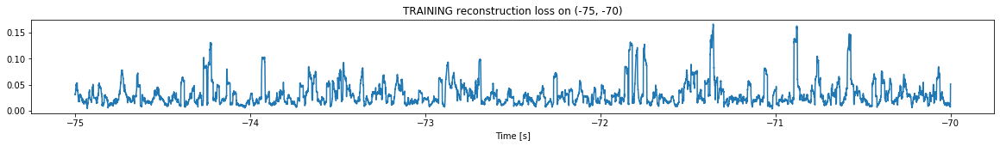

Finished training, median of the log(loss) is:  -1.6053322745570493
Triggering for section:  (-70, -65)
Using this median for triggering: -1.4520039784179806


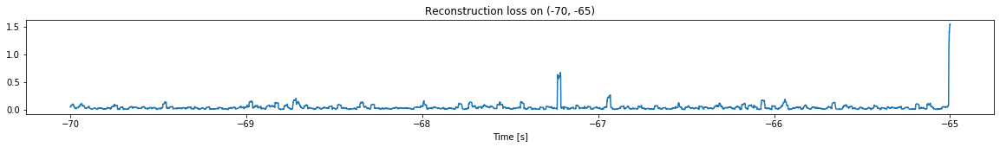

<--------
Entering sections:  (-65, -60)
-------->
Training for section:  (-70, -65)


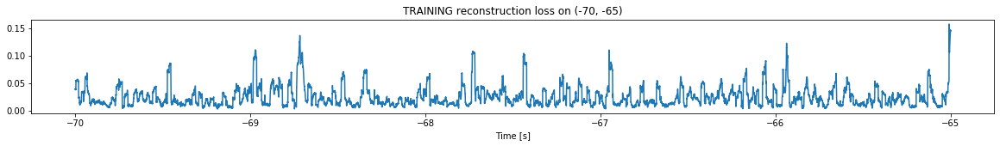

Finished training, median of the log(loss) is:  -1.6945294251645406
Triggering for section:  (-65, -60)
Using this median for triggering: -1.6053322745570493


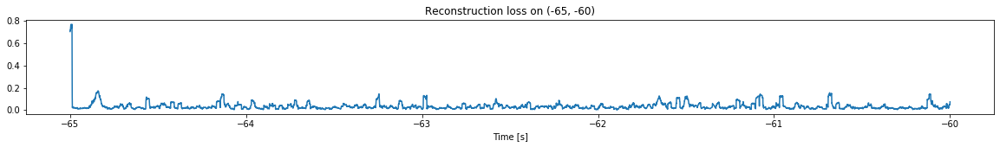

<--------
Entering sections:  (-60, -55)
-------->
Training for section:  (-65, -60)


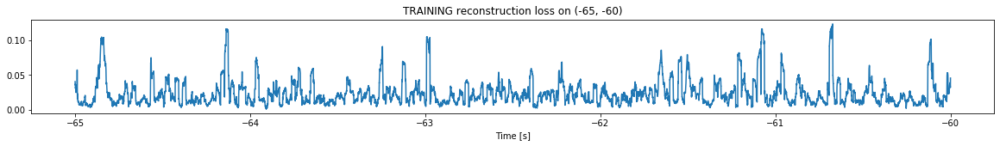

Finished training, median of the log(loss) is:  -1.7114181510409598
Triggering for section:  (-60, -55)
Using this median for triggering: -1.6945294251645406


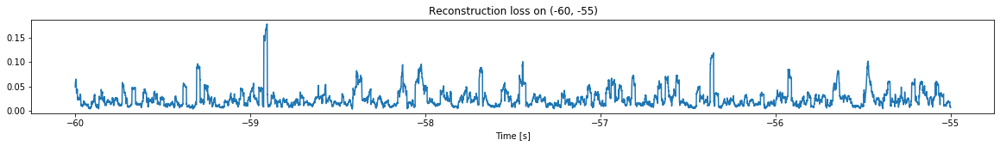

<--------
Entering sections:  (-55, -50)
-------->
Training for section:  (-60, -55)


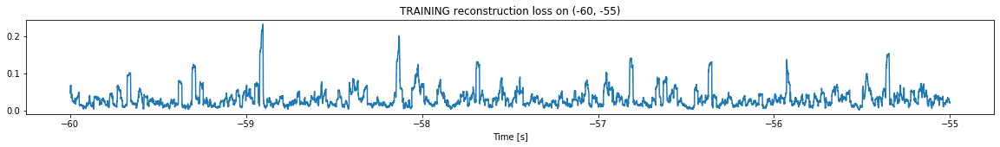

Finished training, median of the log(loss) is:  -1.5970230162054244
Triggering for section:  (-55, -50)
Using this median for triggering: -1.7114181510409598


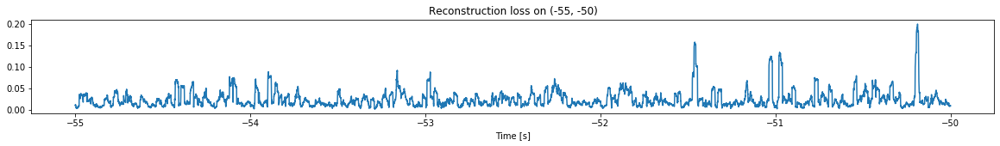

<--------
Entering sections:  (-50, -45)
-------->
Training for section:  (-55, -50)


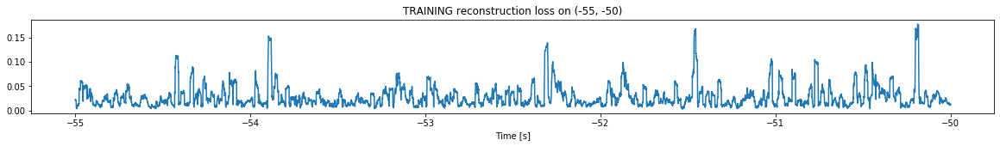

Finished training, median of the log(loss) is:  -1.6699195032202234
Triggering for section:  (-50, -45)
Using this median for triggering: -1.5970230162054244


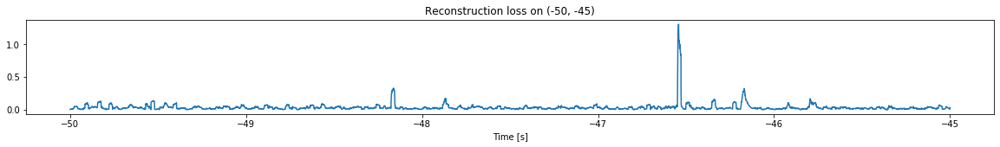

<--------
Entering sections:  (-45, -40)
-------->
Training for section:  (-50, -45)


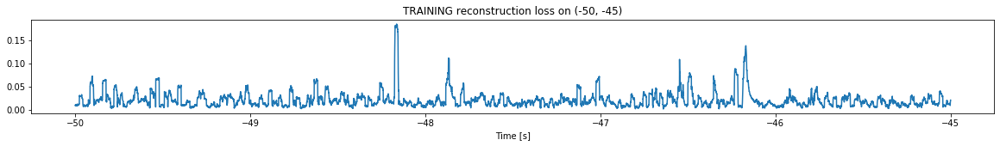

Finished training, median of the log(loss) is:  -1.7550003777897765
Triggering for section:  (-45, -40)
Using this median for triggering: -1.6699195032202234


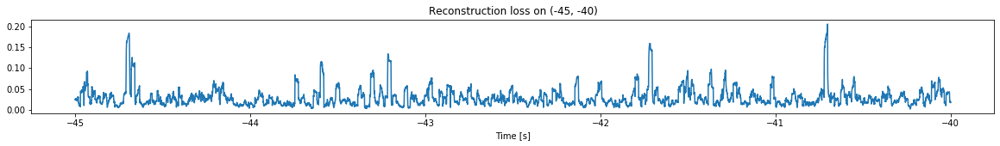

<--------
Entering sections:  (-40, -35)
-------->
Training for section:  (-45, -40)


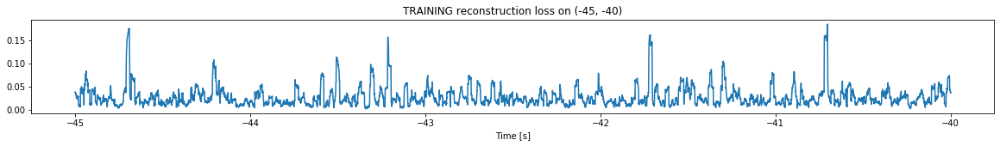

Finished training, median of the log(loss) is:  -1.6600308504861976
Triggering for section:  (-40, -35)
Using this median for triggering: -1.7550003777897765


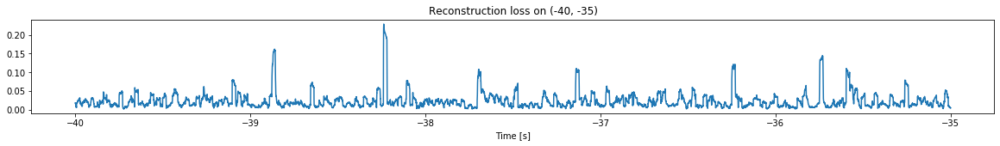

<--------
Entering sections:  (-35, -30)
-------->
Training for section:  (-40, -35)


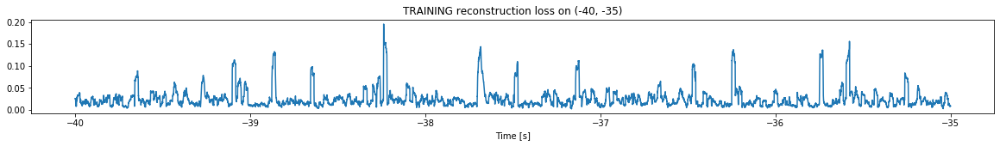

Finished training, median of the log(loss) is:  -1.7032096711311453
Triggering for section:  (-35, -30)
Using this median for triggering: -1.6600308504861976


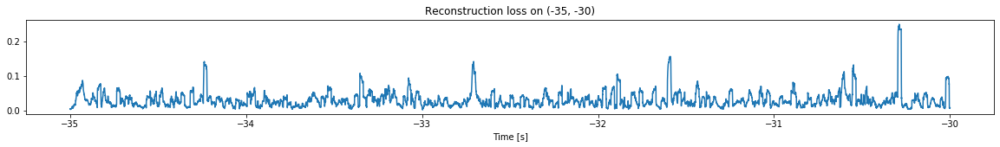

<--------
Entering sections:  (-30, -25)
-------->
Training for section:  (-35, -30)


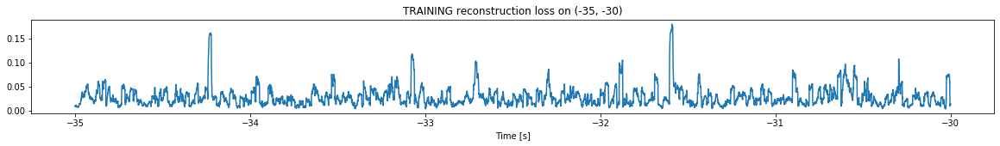

Finished training, median of the log(loss) is:  -1.6254689127093884
Triggering for section:  (-30, -25)
Using this median for triggering: -1.7032096711311453


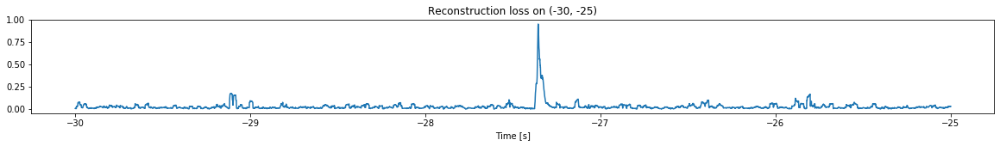

<--------
Entering sections:  (-25, -20)
-------->
Training for section:  (-30, -25)


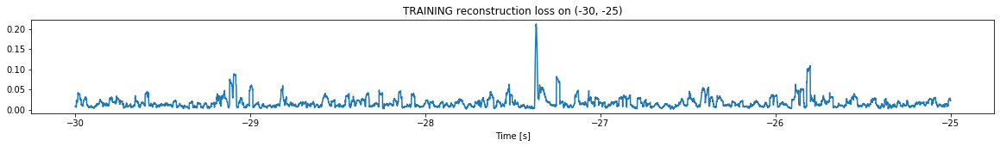

Finished training, median of the log(loss) is:  -1.8661860350417179
Triggering for section:  (-25, -20)
Using this median for triggering: -1.6254689127093884


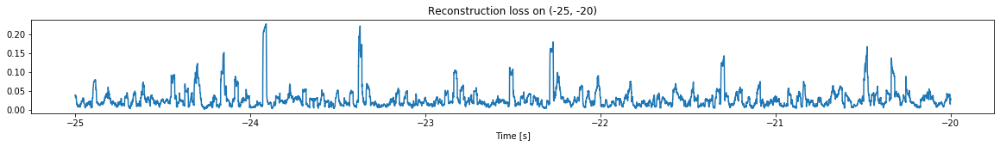

<--------
Entering sections:  (-20, -15)
-------->
Training for section:  (-25, -20)


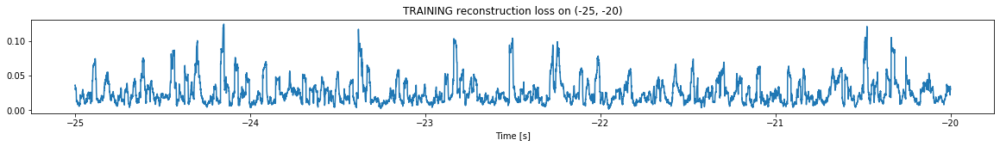

Finished training, median of the log(loss) is:  -1.6701018702173962
Triggering for section:  (-20, -15)
Using this median for triggering: -1.8661860350417179


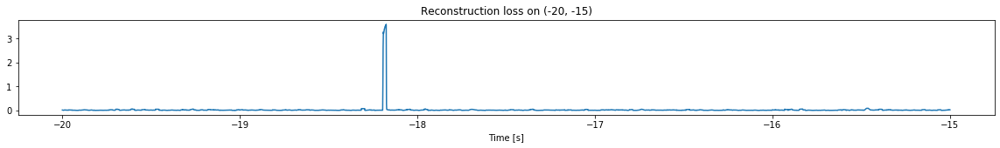

<--------
Entering sections:  (-15, -10)
-------->
Training for section:  (-20, -15)


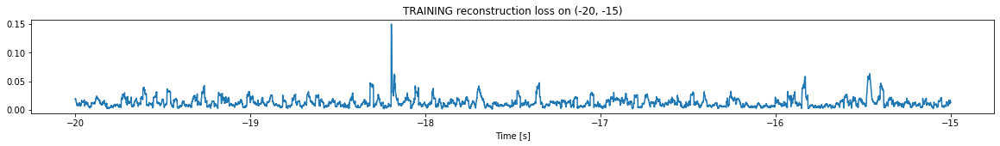

Finished training, median of the log(loss) is:  -1.9548354150627683
Triggering for section:  (-15, -10)
Using this median for triggering: -1.6701018702173962


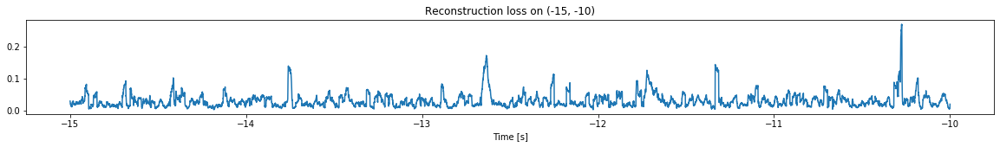

<--------
Entering sections:  (-10, -5)
-------->
Training for section:  (-15, -10)


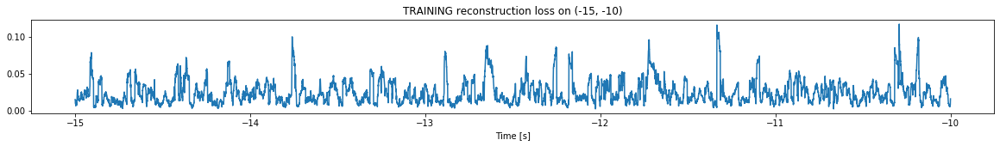

Finished training, median of the log(loss) is:  -1.6822768714967071
Triggering for section:  (-10, -5)
Using this median for triggering: -1.9548354150627683


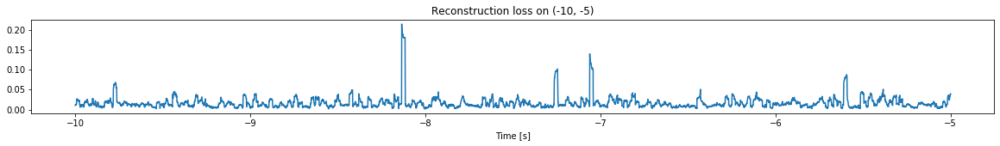

<--------
Entering sections:  (-5, 0)
-------->
Training for section:  (-10, -5)


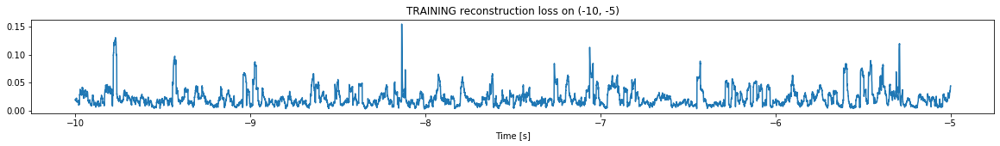

Finished training, median of the log(loss) is:  -1.7319782398891044
Triggering for section:  (-5, 0)
Using this median for triggering: -1.6822768714967071


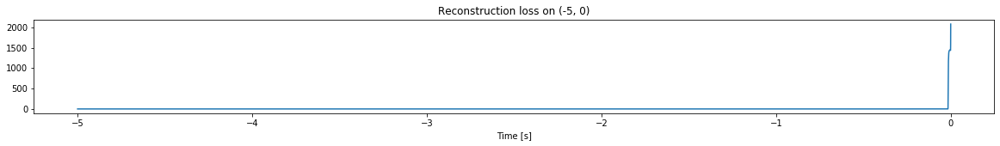

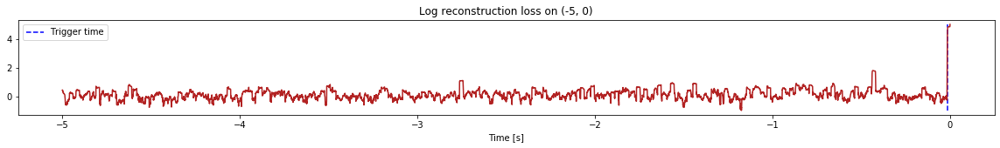

Triggered at:  -0.0155
<--------
Finished simulation, all the triggered times are:  [-0.0155]


In [10]:
simulation("./data/Ramp22/", 5, (-80,0))

Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
All data's shape:  (1297500, 12)
Flushing input history
Number of sections: 26
Entering sections:  (-130, -125)
-------->
Entering sections:  (-125, -120)
-------->
Training for section:  (None, -125)


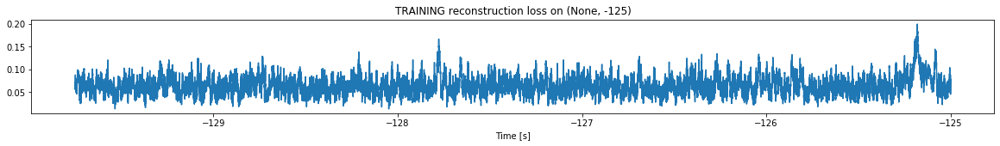

Finished training, median of the log(loss) is:  -1.2088608200458204
<--------
Entering sections:  (-120, -115)
-------->
Training for section:  (-125, -120)


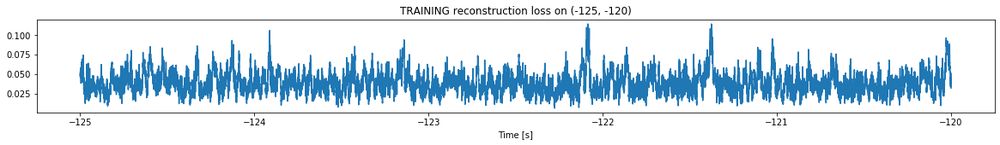

Finished training, median of the log(loss) is:  -1.4401887356396015
Triggering for section:  (-120, -115)
Using this median for triggering: -1.2088608200458204


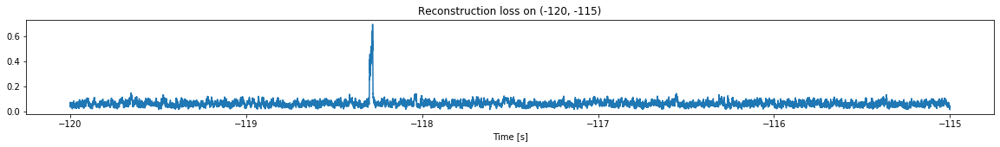

<--------
Entering sections:  (-115, -110)
-------->
Training for section:  (-120, -115)


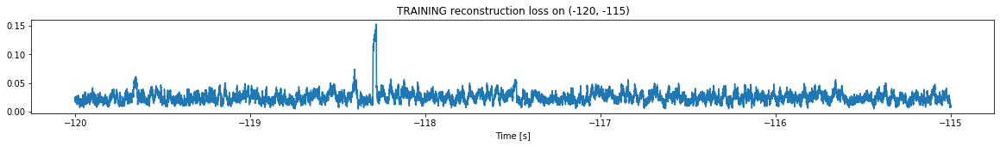

Finished training, median of the log(loss) is:  -1.6190769138983367
Triggering for section:  (-115, -110)
Using this median for triggering: -1.4401887356396015


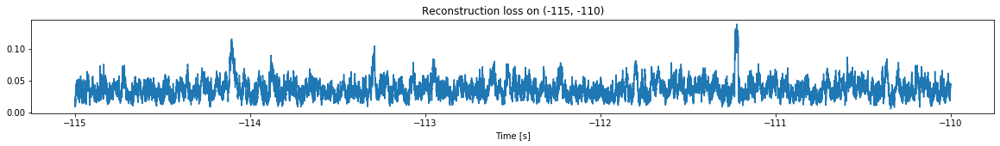

<--------
Entering sections:  (-110, -105)
-------->
Training for section:  (-115, -110)


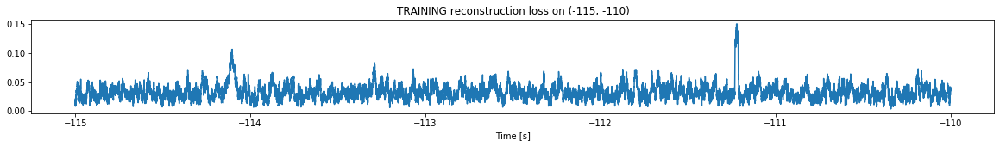

Finished training, median of the log(loss) is:  -1.5149013869946633
Triggering for section:  (-110, -105)
Using this median for triggering: -1.6190769138983367


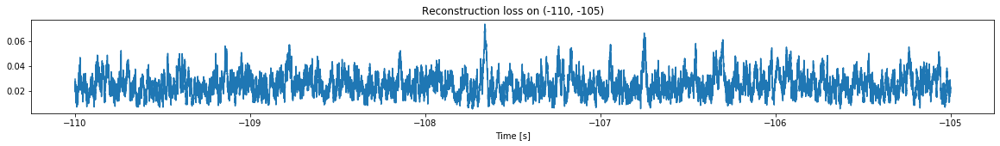

<--------
Entering sections:  (-105, -100)
-------->
Training for section:  (-110, -105)


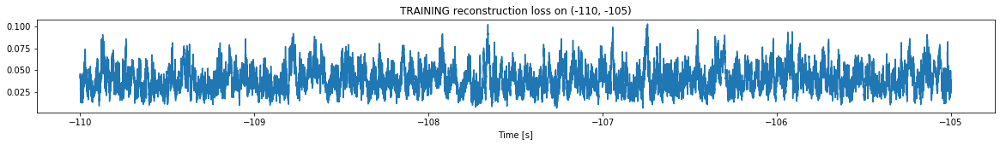

Finished training, median of the log(loss) is:  -1.4298114909542514
Triggering for section:  (-105, -100)
Using this median for triggering: -1.5149013869946633


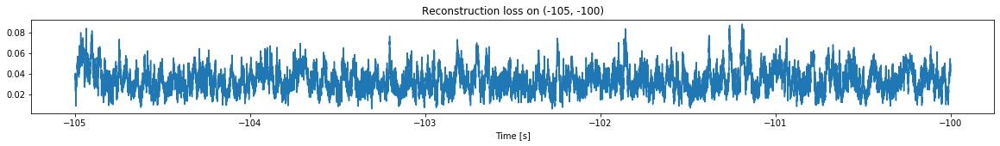

<--------
Entering sections:  (-100, -95)
-------->
Training for section:  (-105, -100)


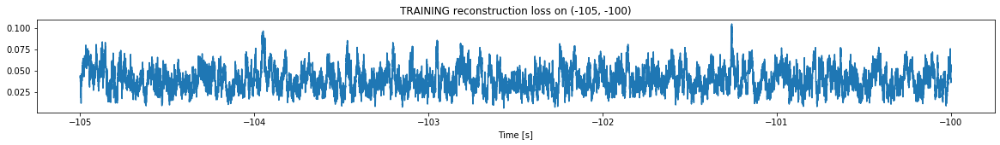

Finished training, median of the log(loss) is:  -1.4216671333941284
Triggering for section:  (-100, -95)
Using this median for triggering: -1.4298114909542514


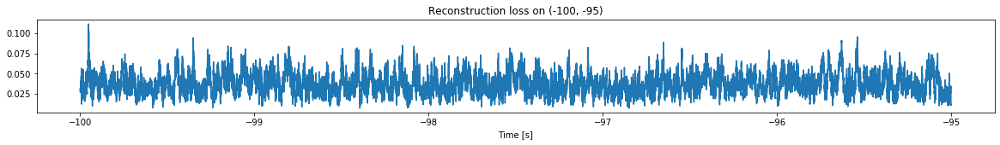

<--------
Entering sections:  (-95, -90)
-------->
Training for section:  (-100, -95)


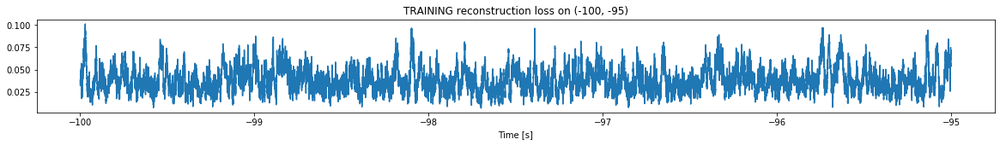

Finished training, median of the log(loss) is:  -1.4469993009307842
Triggering for section:  (-95, -90)
Using this median for triggering: -1.4216671333941284


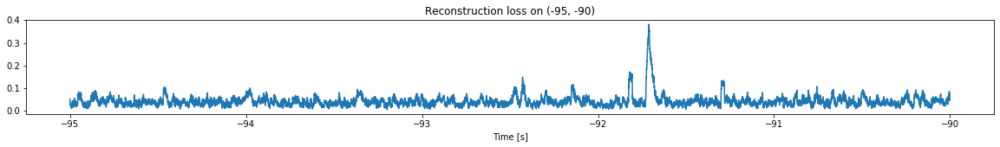

<--------
Entering sections:  (-90, -85)
-------->
Training for section:  (-95, -90)


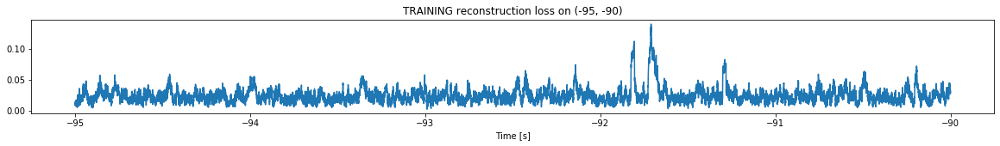

Finished training, median of the log(loss) is:  -1.6430205806189706
Triggering for section:  (-90, -85)
Using this median for triggering: -1.4469993009307842


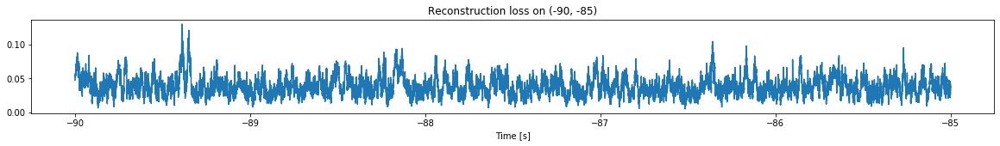

<--------
Entering sections:  (-85, -80)
-------->
Training for section:  (-90, -85)


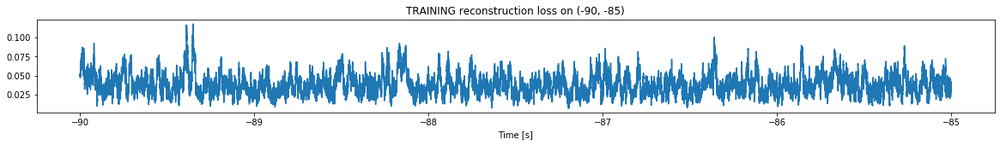

Finished training, median of the log(loss) is:  -1.4416138461259795
Triggering for section:  (-85, -80)
Using this median for triggering: -1.6430205806189706


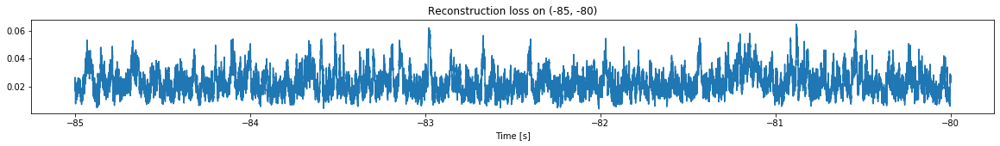

<--------
Entering sections:  (-80, -75)
-------->
Training for section:  (-85, -80)


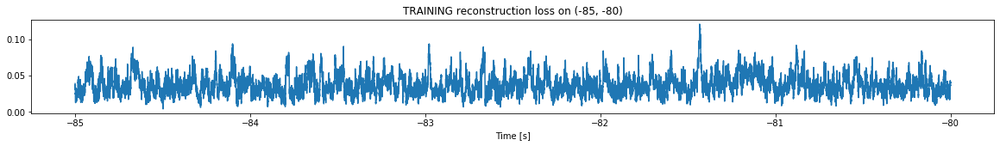

Finished training, median of the log(loss) is:  -1.4504838727936455
Triggering for section:  (-80, -75)
Using this median for triggering: -1.4416138461259795


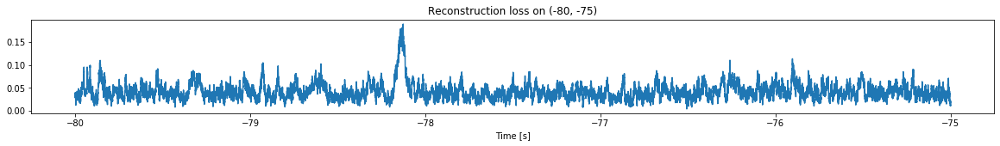

<--------
Entering sections:  (-75, -70)
-------->
Training for section:  (-80, -75)


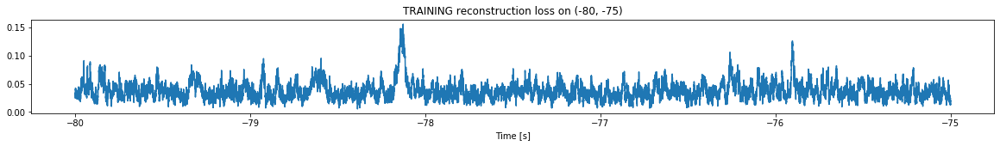

Finished training, median of the log(loss) is:  -1.4532569892652853
Triggering for section:  (-75, -70)
Using this median for triggering: -1.4504838727936455


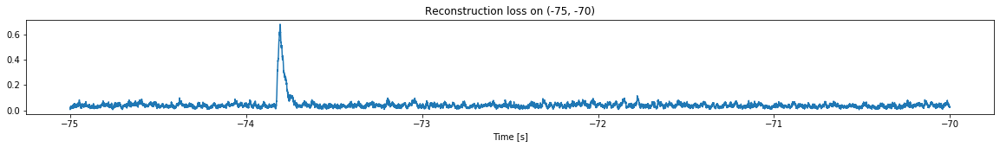

<--------
Entering sections:  (-70, -65)
-------->
Training for section:  (-75, -70)


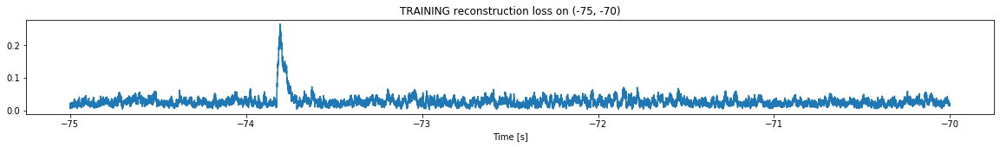

Finished training, median of the log(loss) is:  -1.5880955548441191
Triggering for section:  (-70, -65)
Using this median for triggering: -1.4532569892652853


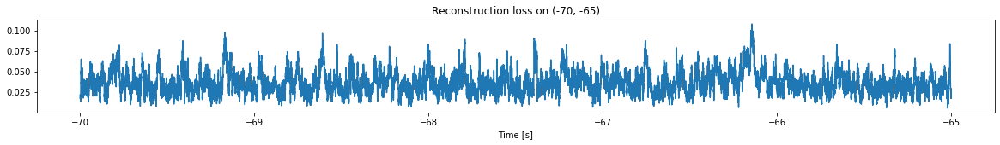

<--------
Entering sections:  (-65, -60)
-------->
Training for section:  (-70, -65)


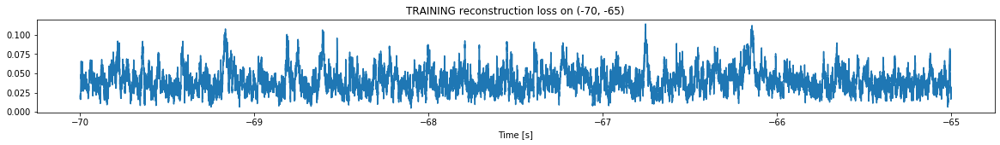

Finished training, median of the log(loss) is:  -1.4192314551518197
Triggering for section:  (-65, -60)
Using this median for triggering: -1.5880955548441191


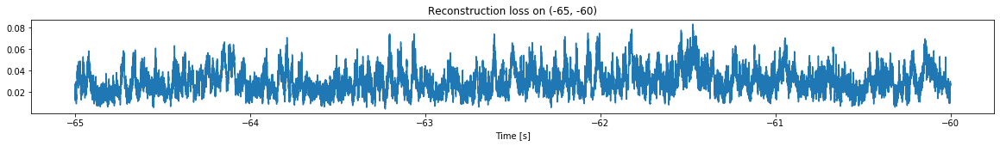

<--------
Entering sections:  (-60, -55)
-------->
Training for section:  (-65, -60)


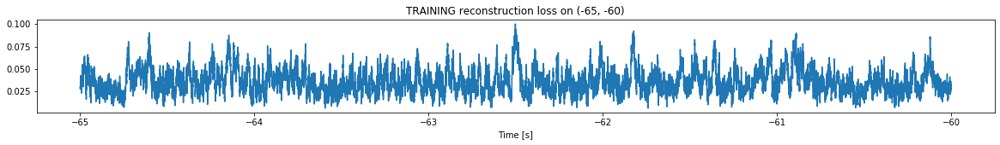

Finished training, median of the log(loss) is:  -1.471430864223317
Triggering for section:  (-60, -55)
Using this median for triggering: -1.4192314551518197


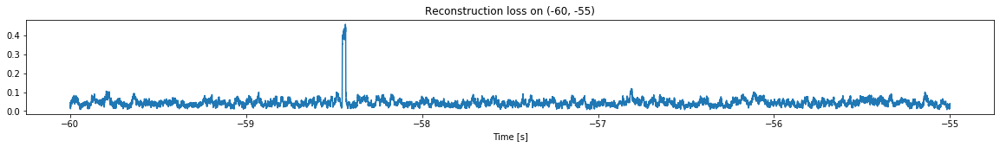

<--------
Entering sections:  (-55, -50)
-------->
Training for section:  (-60, -55)


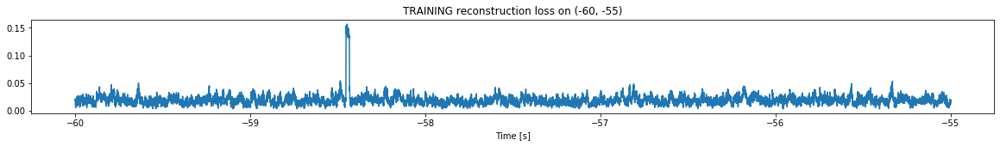

Finished training, median of the log(loss) is:  -1.7299997584274345
Triggering for section:  (-55, -50)
Using this median for triggering: -1.471430864223317


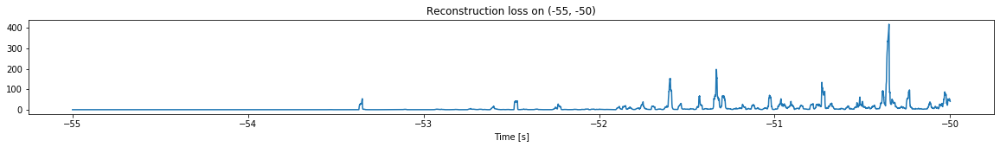

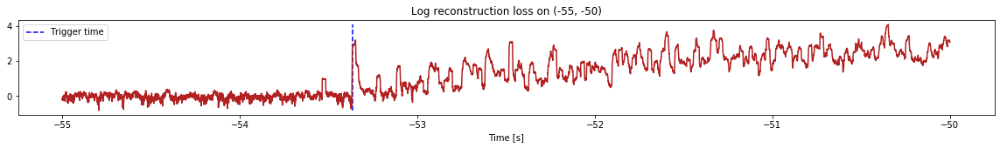

Triggered at:  -53.3661
<--------
Entering sections:  (-50, -45)
-------->
Training for section:  (-55, -50)


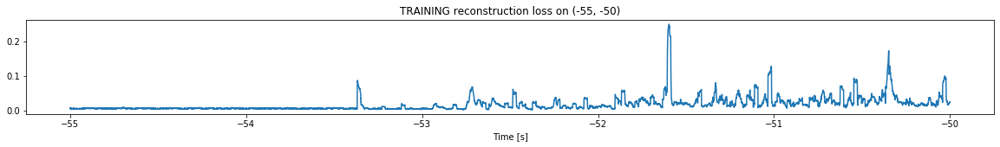

Finished training, median of the log(loss) is:  -2.004726015842353
Triggering for section:  (-50, -45)
Using this median for triggering: -1.7299997584274345


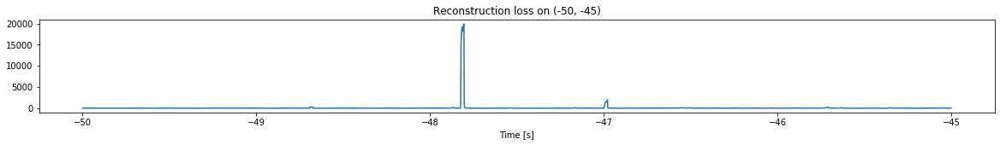

<--------
Entering sections:  (-45, -40)
-------->
Training for section:  (-50, -45)


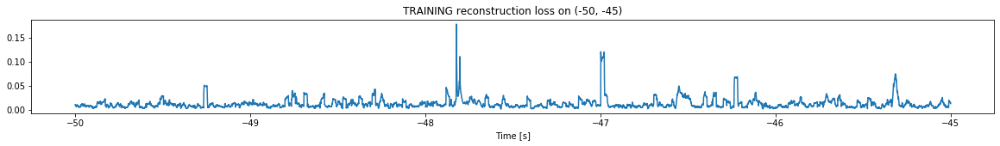

Finished training, median of the log(loss) is:  -1.9754636368261833
Triggering for section:  (-45, -40)
Using this median for triggering: -2.004726015842353


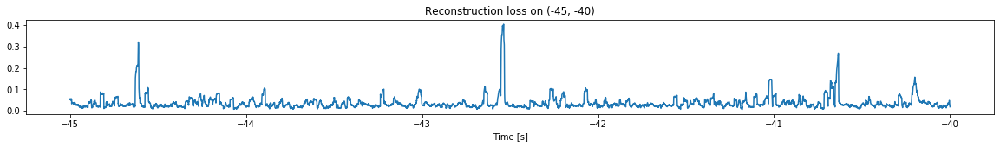

<--------
Entering sections:  (-40, -35)
-------->
Training for section:  (-45, -40)


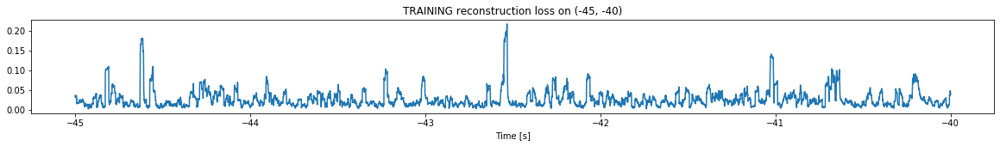

Finished training, median of the log(loss) is:  -1.6634096823707436
Triggering for section:  (-40, -35)
Using this median for triggering: -1.9754636368261833


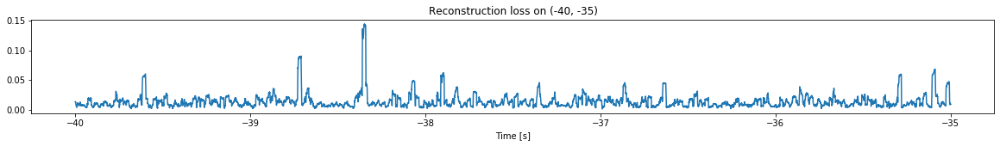

<--------
Entering sections:  (-35, -30)
-------->
Training for section:  (-40, -35)


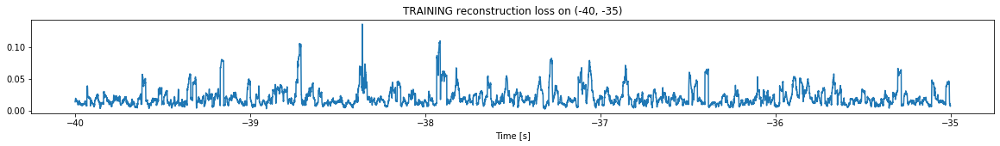

Finished training, median of the log(loss) is:  -1.7750184112439864
Triggering for section:  (-35, -30)
Using this median for triggering: -1.6634096823707436


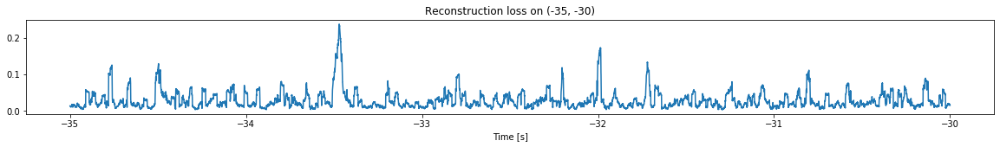

<--------
Entering sections:  (-30, -25)
-------->
Training for section:  (-35, -30)


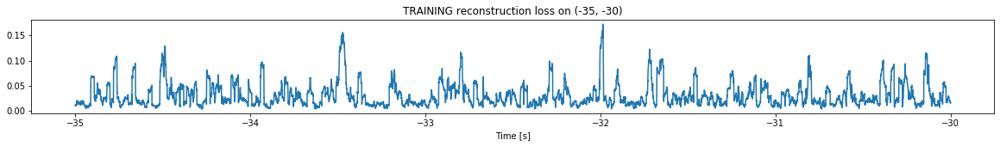

Finished training, median of the log(loss) is:  -1.6196178764525637
Triggering for section:  (-30, -25)
Using this median for triggering: -1.7750184112439864


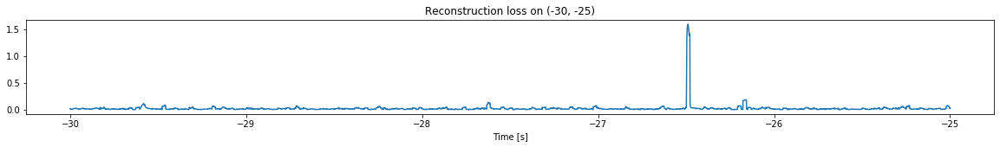

<--------
Entering sections:  (-25, -20)
-------->
Training for section:  (-30, -25)


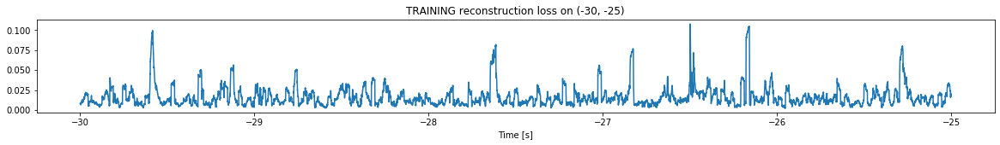

Finished training, median of the log(loss) is:  -1.867570245171199
Triggering for section:  (-25, -20)
Using this median for triggering: -1.6196178764525637


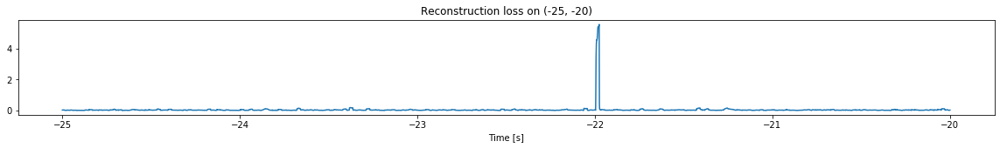

<--------
Entering sections:  (-20, -15)
-------->
Training for section:  (-25, -20)


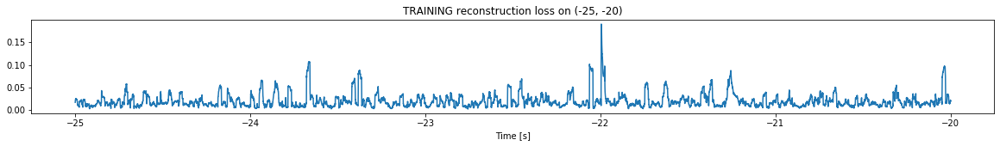

Finished training, median of the log(loss) is:  -1.790910661352335
Triggering for section:  (-20, -15)
Using this median for triggering: -1.867570245171199


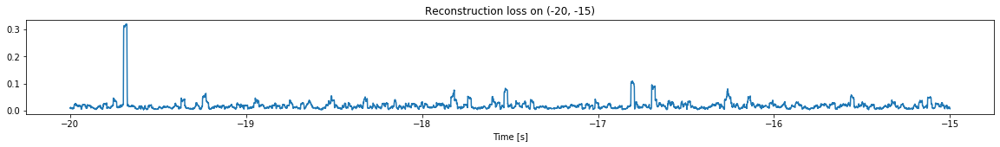

<--------
Entering sections:  (-15, -10)
-------->
Training for section:  (-20, -15)


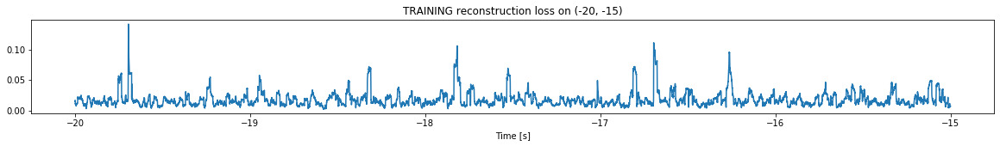

Finished training, median of the log(loss) is:  -1.8242488064269082
Triggering for section:  (-15, -10)
Using this median for triggering: -1.790910661352335


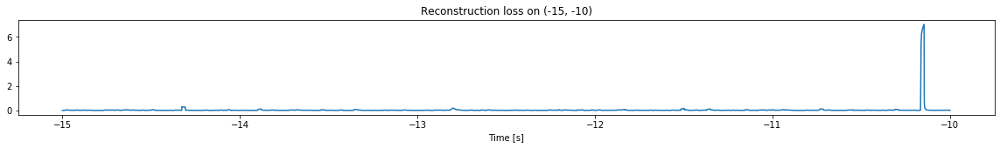

<--------
Entering sections:  (-10, -5)
-------->
Training for section:  (-15, -10)


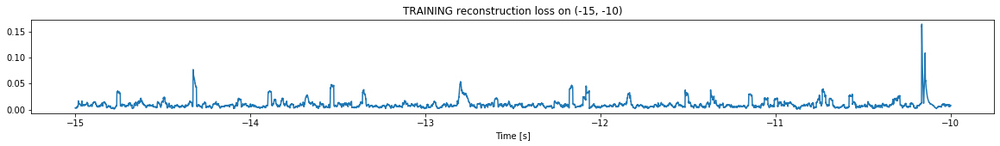

Finished training, median of the log(loss) is:  -2.1052336439101325
Triggering for section:  (-10, -5)
Using this median for triggering: -1.8242488064269082


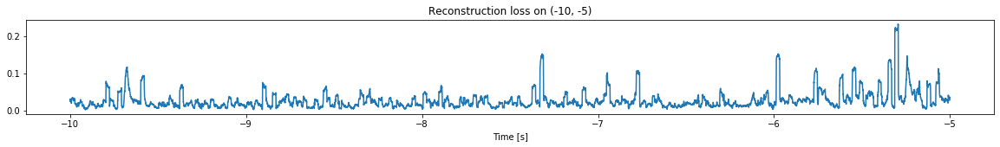

<--------
Entering sections:  (-5, 0)
-------->
Training for section:  (-10, -5)


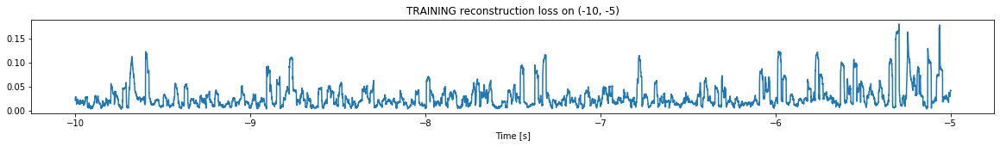

Finished training, median of the log(loss) is:  -1.6685276095362793
Triggering for section:  (-5, 0)
Using this median for triggering: -2.1052336439101325


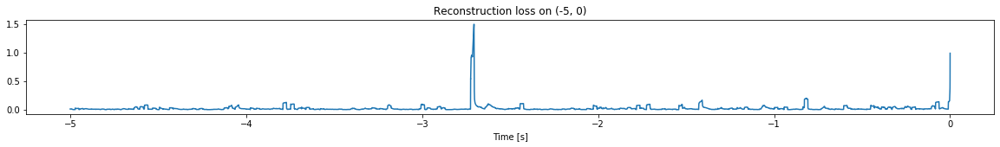

<--------
Finished simulation, all the triggered times are:  [-53.3661]


In [11]:
#simulation("./data/Ramp23/", 5, (-130,0))

Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
All data's shape:  (1097500, 12)
Flushing input history
Number of sections: 22
Entering sections:  (-110, -105)
-------->
Entering sections:  (-105, -100)
-------->
Training for section:  (None, -105)


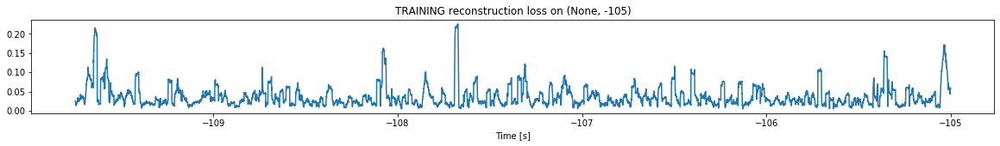

Finished training, median of the log(loss) is:  -1.5342705724421555
<--------
Entering sections:  (-100, -95)
-------->
Training for section:  (-105, -100)


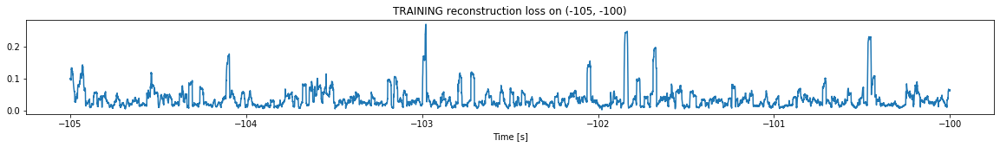

Finished training, median of the log(loss) is:  -1.538617123714881
Triggering for section:  (-100, -95)
Using this median for triggering: -1.5342705724421555


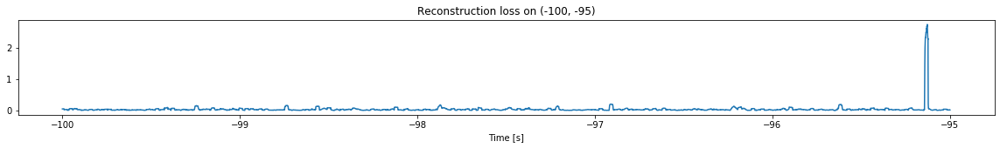

<--------
Entering sections:  (-95, -90)
-------->
Training for section:  (-100, -95)


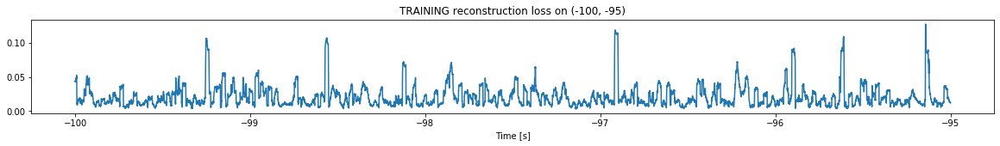

Finished training, median of the log(loss) is:  -1.774903937980708
Triggering for section:  (-95, -90)
Using this median for triggering: -1.538617123714881


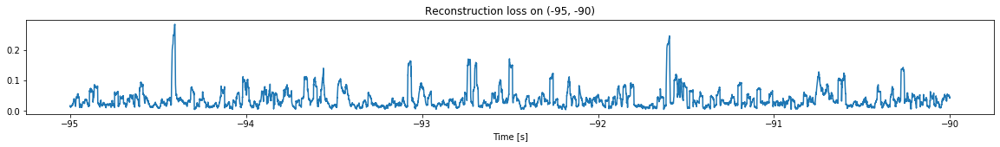

<--------
Entering sections:  (-90, -85)
-------->
Training for section:  (-95, -90)


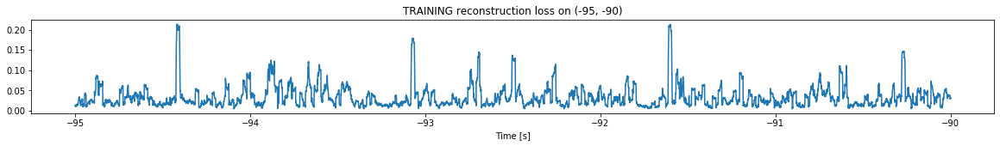

Finished training, median of the log(loss) is:  -1.569200572667199
Triggering for section:  (-90, -85)
Using this median for triggering: -1.774903937980708


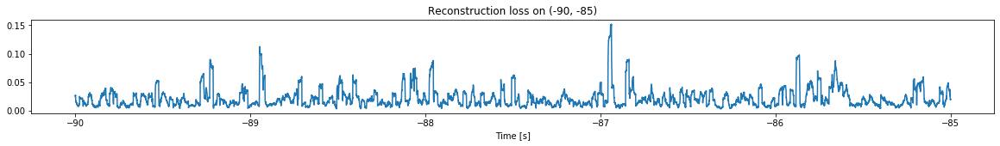

<--------
Entering sections:  (-85, -80)
-------->
Training for section:  (-90, -85)


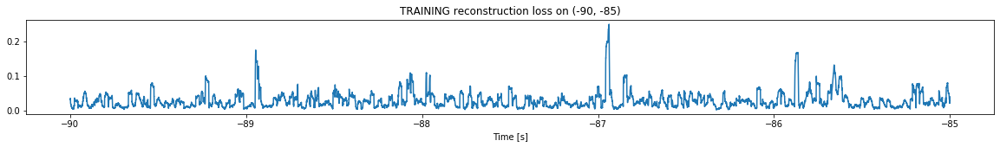

Finished training, median of the log(loss) is:  -1.6202179431540116
Triggering for section:  (-85, -80)
Using this median for triggering: -1.569200572667199


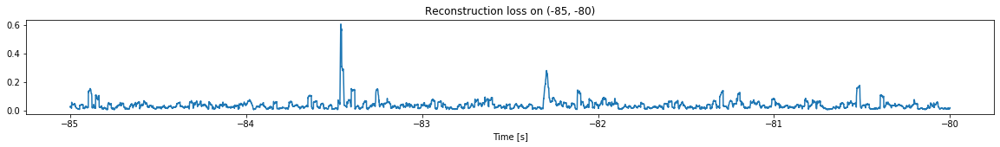

<--------
Entering sections:  (-80, -75)
-------->
Training for section:  (-85, -80)


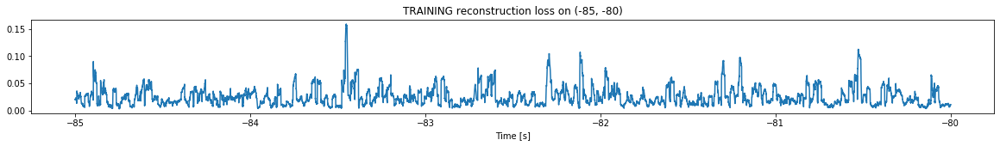

Finished training, median of the log(loss) is:  -1.663121091780574
Triggering for section:  (-80, -75)
Using this median for triggering: -1.6202179431540116


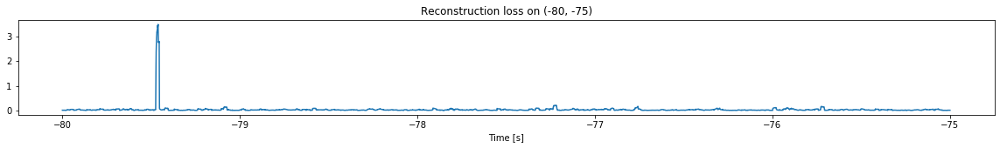

<--------
Entering sections:  (-75, -70)
-------->
Training for section:  (-80, -75)


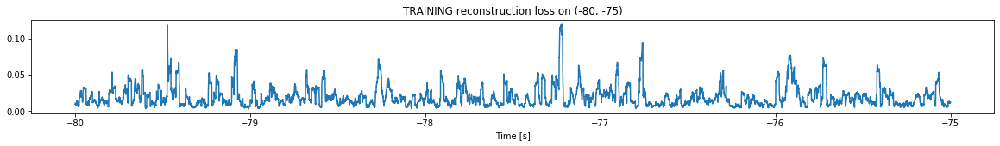

Finished training, median of the log(loss) is:  -1.7995352480571865
Triggering for section:  (-75, -70)
Using this median for triggering: -1.663121091780574


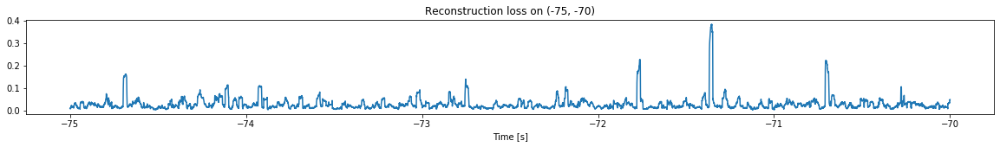

<--------
Entering sections:  (-70, -65)
-------->
Training for section:  (-75, -70)


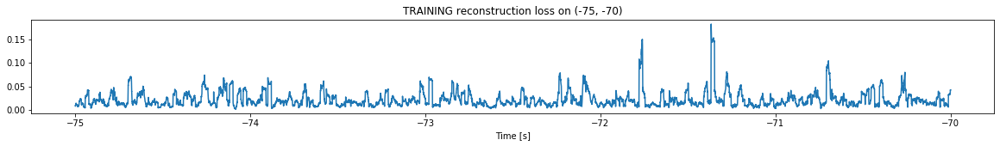

Finished training, median of the log(loss) is:  -1.7523646920704539
Triggering for section:  (-70, -65)
Using this median for triggering: -1.7995352480571865


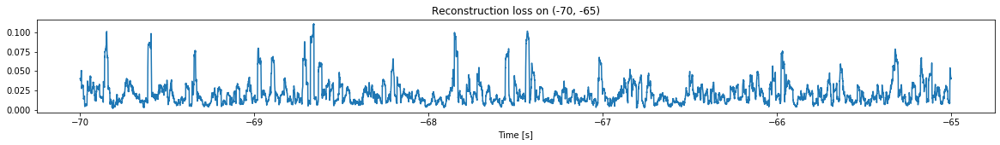

<--------
Entering sections:  (-65, -60)
-------->
Training for section:  (-70, -65)


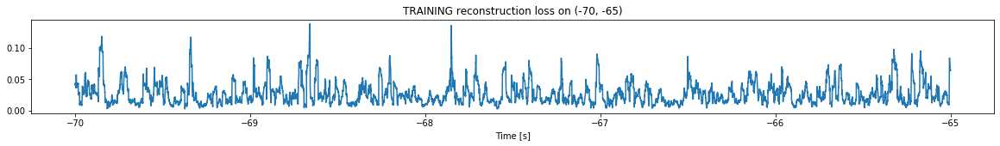

Finished training, median of the log(loss) is:  -1.6369291439753413
Triggering for section:  (-65, -60)
Using this median for triggering: -1.7523646920704539


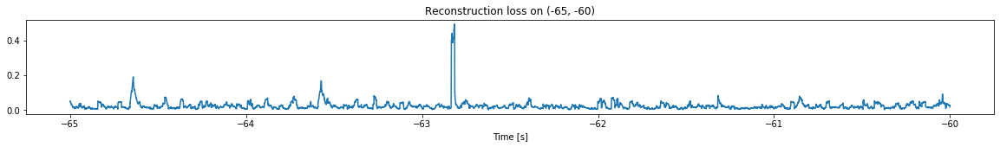

<--------
Entering sections:  (-60, -55)
-------->
Training for section:  (-65, -60)


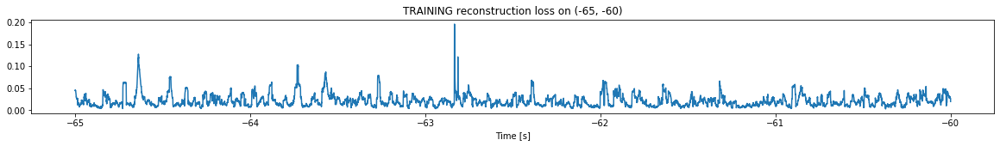

Finished training, median of the log(loss) is:  -1.7429232799828722
Triggering for section:  (-60, -55)
Using this median for triggering: -1.6369291439753413


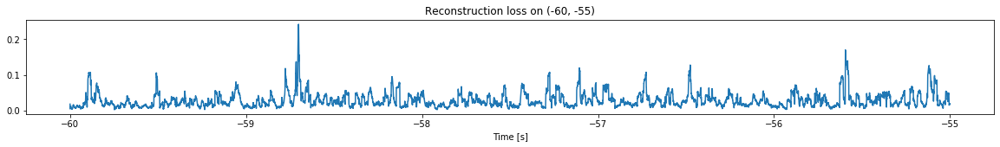

<--------
Entering sections:  (-55, -50)
-------->
Training for section:  (-60, -55)


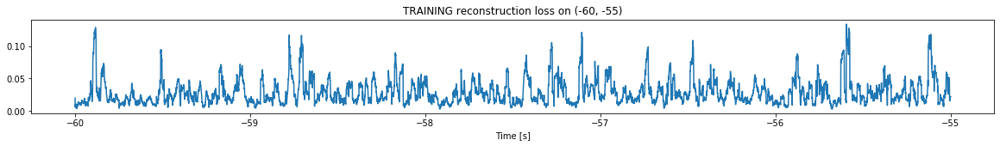

Finished training, median of the log(loss) is:  -1.6241804060470748
Triggering for section:  (-55, -50)
Using this median for triggering: -1.7429232799828722


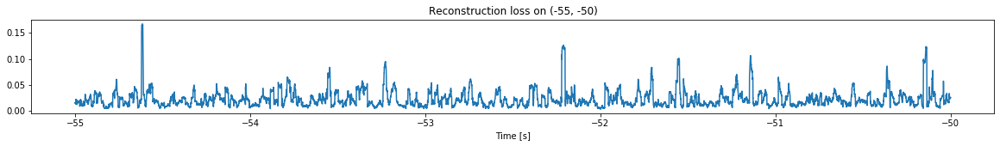

<--------
Entering sections:  (-50, -45)
-------->
Training for section:  (-55, -50)


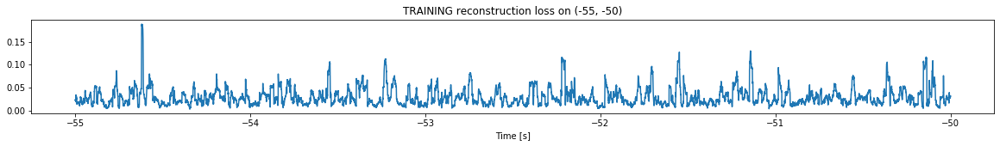

Finished training, median of the log(loss) is:  -1.604020255543647
Triggering for section:  (-50, -45)
Using this median for triggering: -1.6241804060470748


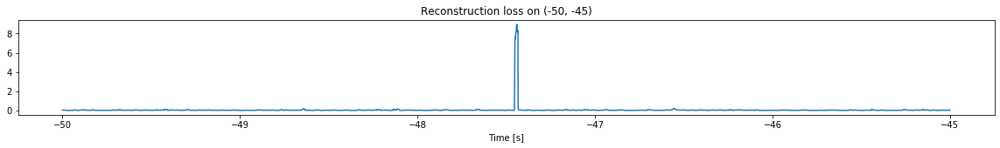

<--------
Entering sections:  (-45, -40)
-------->
Training for section:  (-50, -45)


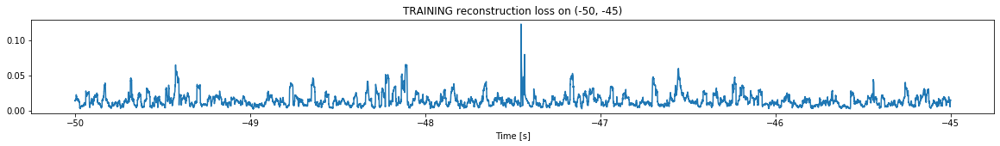

Finished training, median of the log(loss) is:  -1.9244365765765288
Triggering for section:  (-45, -40)
Using this median for triggering: -1.604020255543647


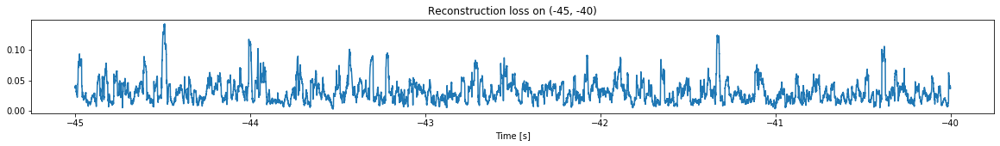

<--------
Entering sections:  (-40, -35)
-------->
Training for section:  (-45, -40)


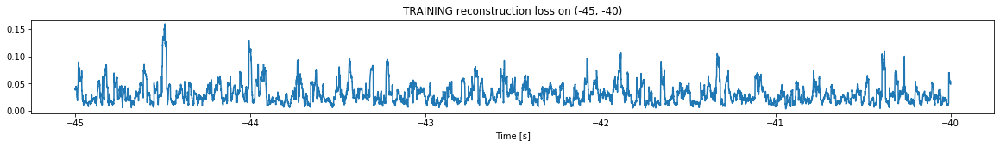

Finished training, median of the log(loss) is:  -1.562793303124363
Triggering for section:  (-40, -35)
Using this median for triggering: -1.9244365765765288


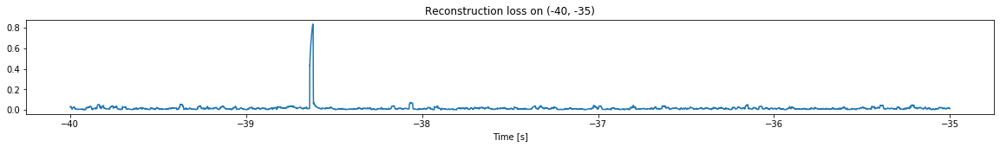

<--------
Entering sections:  (-35, -30)
-------->
Training for section:  (-40, -35)


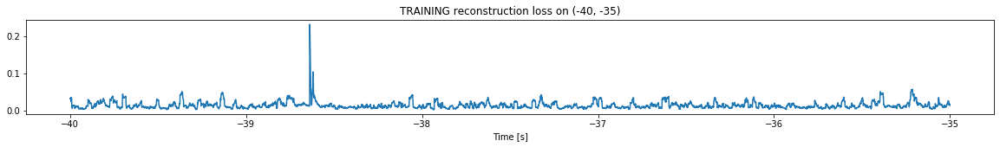

Finished training, median of the log(loss) is:  -1.9551692484566778
Triggering for section:  (-35, -30)
Using this median for triggering: -1.562793303124363


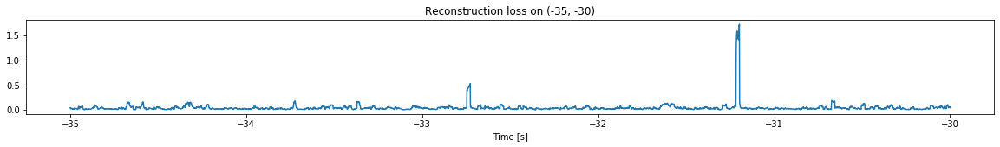

<--------
Entering sections:  (-30, -25)
-------->
Training for section:  (-35, -30)


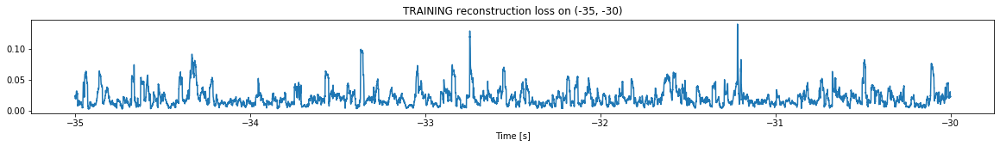

Finished training, median of the log(loss) is:  -1.7505970779611542
Triggering for section:  (-30, -25)
Using this median for triggering: -1.9551692484566778


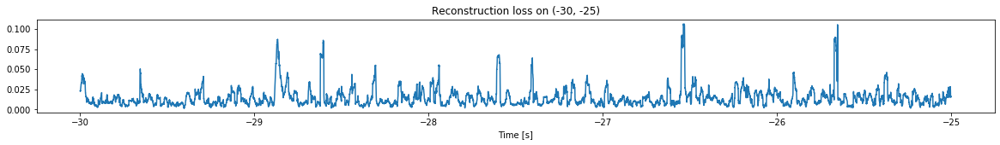

<--------
Entering sections:  (-25, -20)
-------->
Training for section:  (-30, -25)


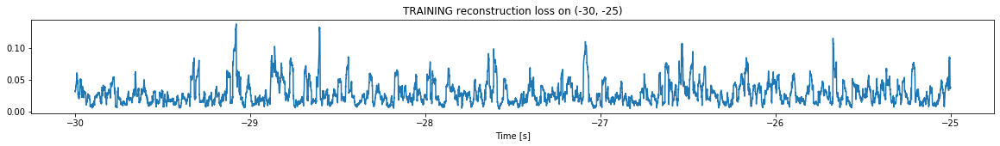

Finished training, median of the log(loss) is:  -1.61011905475638
Triggering for section:  (-25, -20)
Using this median for triggering: -1.7505970779611542


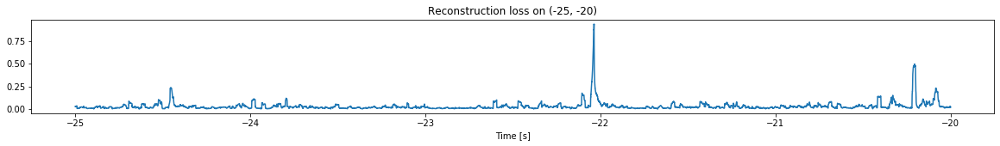

<--------
Entering sections:  (-20, -15)
-------->
Training for section:  (-25, -20)


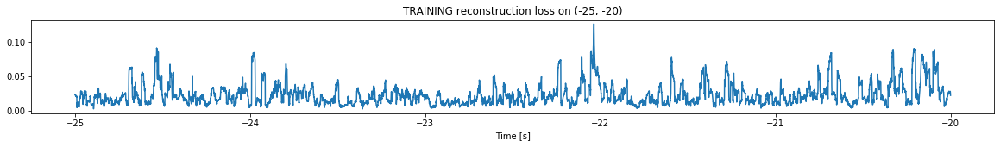

Finished training, median of the log(loss) is:  -1.7161240765454977
Triggering for section:  (-20, -15)
Using this median for triggering: -1.61011905475638


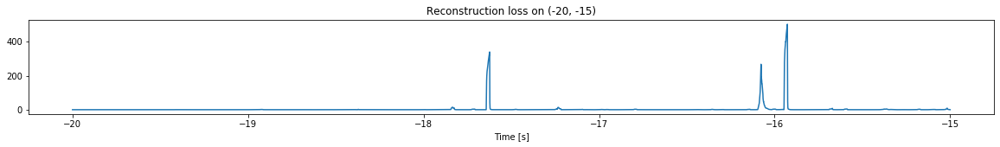

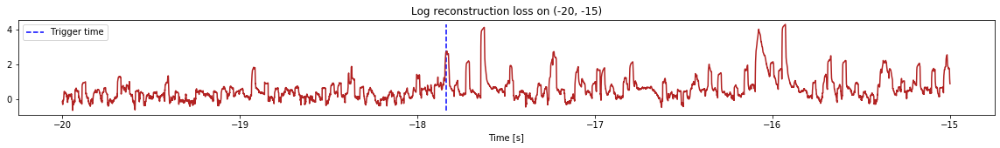

Triggered at:  -17.8396
<--------
Entering sections:  (-15, -10)
-------->
Training for section:  (-20, -15)


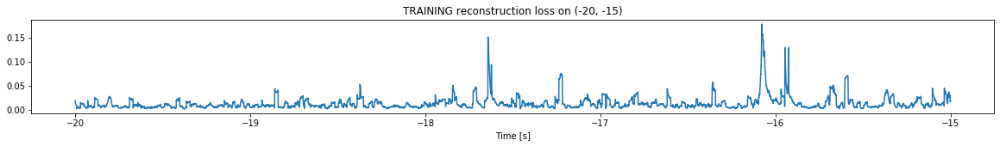

Finished training, median of the log(loss) is:  -2.0033960767953696
Triggering for section:  (-15, -10)
Using this median for triggering: -1.7161240765454977


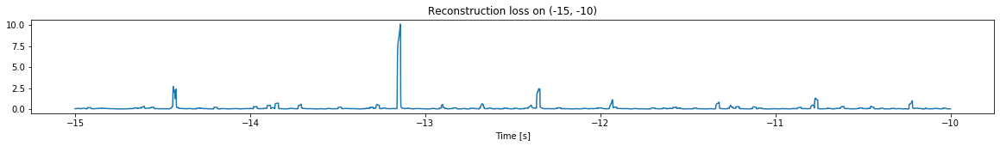

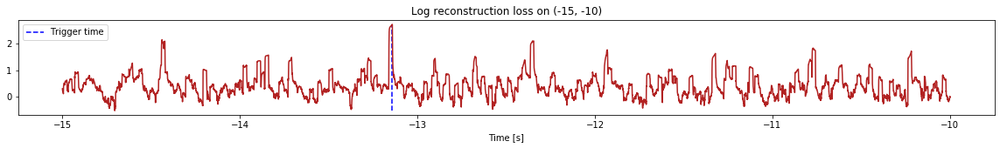

Triggered at:  -13.144799
<--------
Entering sections:  (-10, -5)
-------->
Training for section:  (-15, -10)


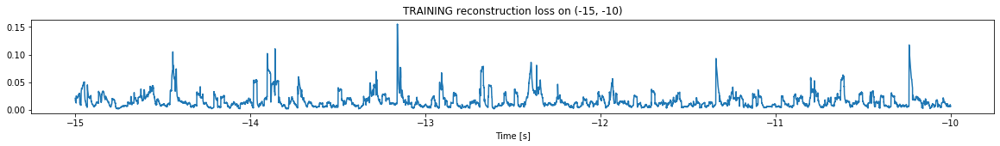

Finished training, median of the log(loss) is:  -1.89516165427945
Triggering for section:  (-10, -5)
Using this median for triggering: -2.0033960767953696


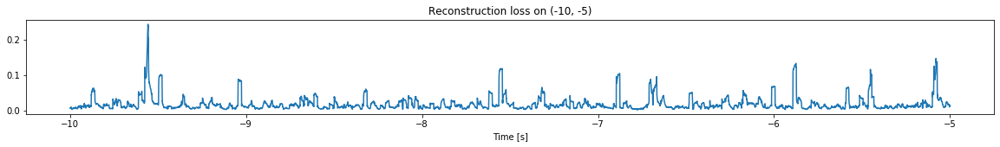

<--------
Entering sections:  (-5, 0)
-------->
Training for section:  (-10, -5)


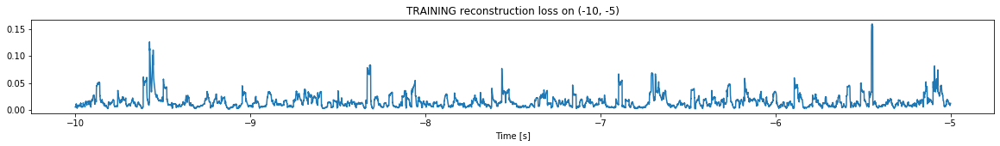

Finished training, median of the log(loss) is:  -1.9014485522500228
Triggering for section:  (-5, 0)
Using this median for triggering: -1.89516165427945


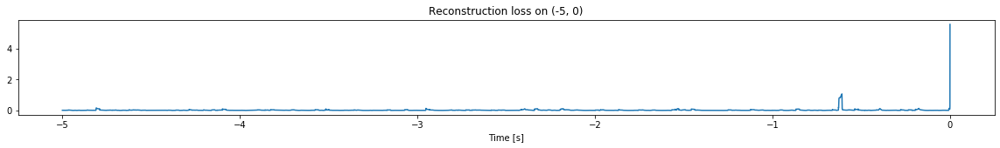

<--------
Finished simulation, all the triggered times are:  [-17.8396, -13.144799]


In [12]:
simulation("./data/Ramp24/", 5, (-110,0))

Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
All data's shape:  (997500, 12)
Flushing input history
Number of sections: 20
Entering sections:  (-100, -95)
-------->
Entering sections:  (-95, -90)
-------->
Training for section:  (None, -95)


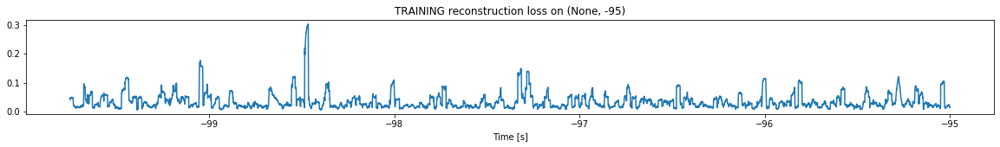

Finished training, median of the log(loss) is:  -1.5762121498045094
<--------
Entering sections:  (-90, -85)
-------->
Training for section:  (-95, -90)


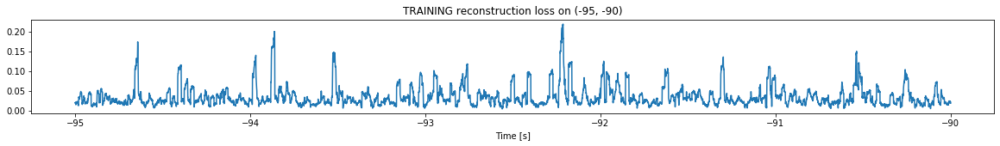

Finished training, median of the log(loss) is:  -1.54057521890816
Triggering for section:  (-90, -85)
Using this median for triggering: -1.5762121498045094


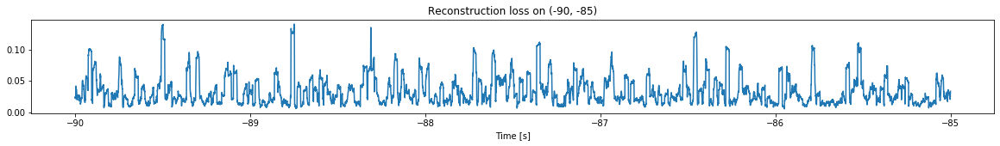

<--------
Entering sections:  (-85, -80)
-------->
Training for section:  (-90, -85)


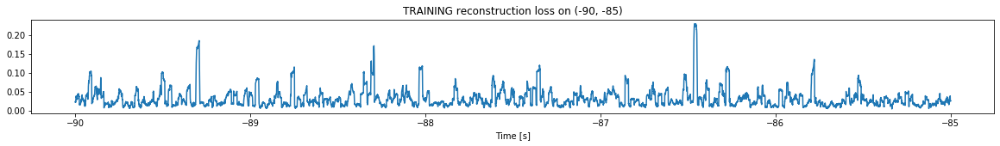

Finished training, median of the log(loss) is:  -1.5885243503314488
Triggering for section:  (-85, -80)
Using this median for triggering: -1.54057521890816


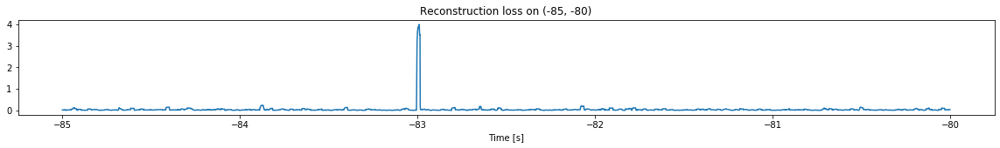

<--------
Entering sections:  (-80, -75)
-------->
Training for section:  (-85, -80)


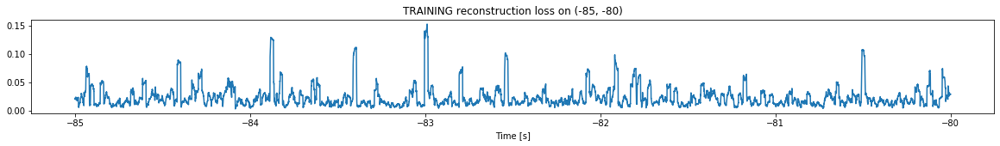

Finished training, median of the log(loss) is:  -1.7315478491828755
Triggering for section:  (-80, -75)
Using this median for triggering: -1.5885243503314488


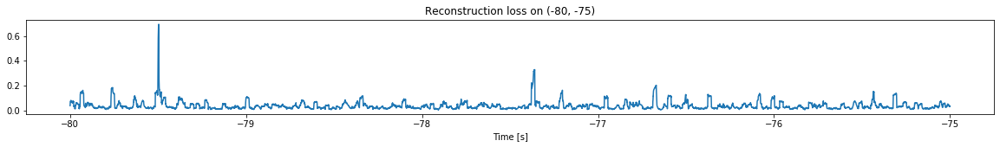

<--------
Entering sections:  (-75, -70)
-------->
Training for section:  (-80, -75)


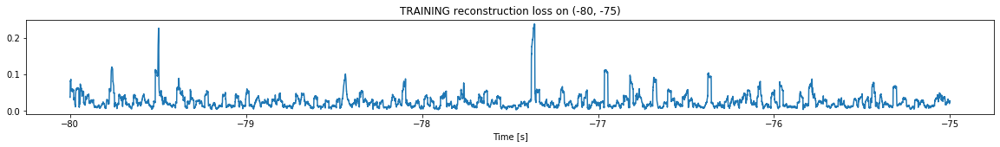

Finished training, median of the log(loss) is:  -1.674042069850429
Triggering for section:  (-75, -70)
Using this median for triggering: -1.7315478491828755


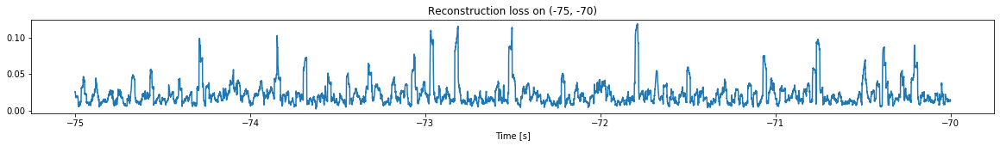

<--------
Entering sections:  (-70, -65)
-------->
Training for section:  (-75, -70)


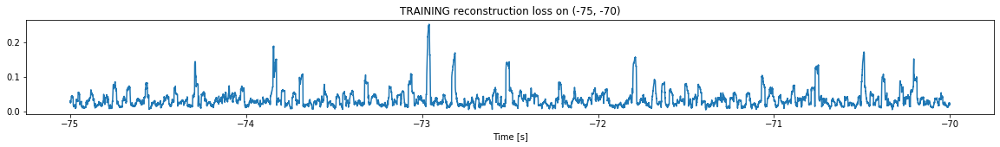

Finished training, median of the log(loss) is:  -1.525716988950091
Triggering for section:  (-70, -65)
Using this median for triggering: -1.674042069850429


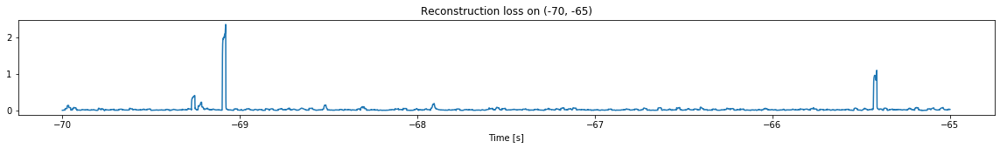

<--------
Entering sections:  (-65, -60)
-------->
Training for section:  (-70, -65)


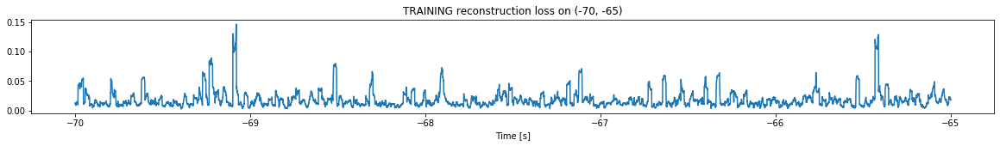

Finished training, median of the log(loss) is:  -1.834458586773967
Triggering for section:  (-65, -60)
Using this median for triggering: -1.525716988950091


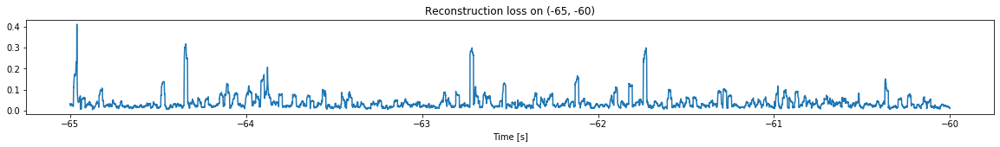

<--------
Entering sections:  (-60, -55)
-------->
Training for section:  (-65, -60)


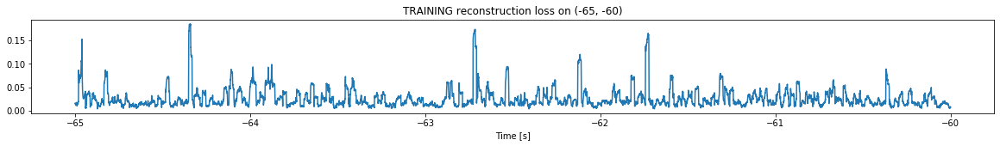

Finished training, median of the log(loss) is:  -1.6824484184414559
Triggering for section:  (-60, -55)
Using this median for triggering: -1.834458586773967


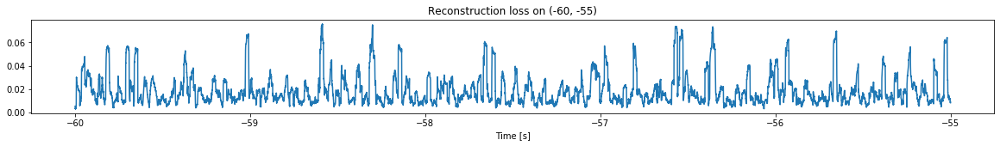

<--------
Entering sections:  (-55, -50)
-------->
Training for section:  (-60, -55)


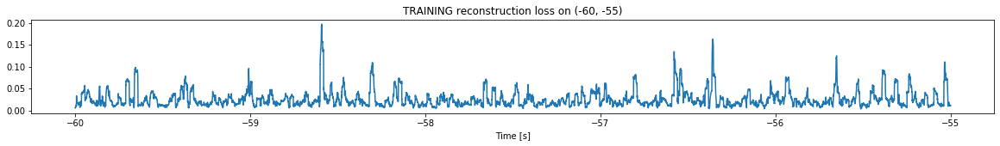

Finished training, median of the log(loss) is:  -1.6791818687507911
Triggering for section:  (-55, -50)
Using this median for triggering: -1.6824484184414559


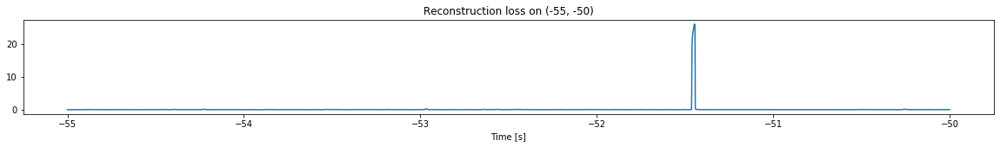

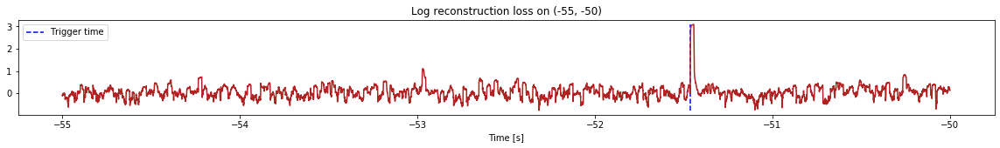

Triggered at:  -51.4615
<--------
Entering sections:  (-50, -45)
-------->
Training for section:  (-55, -50)


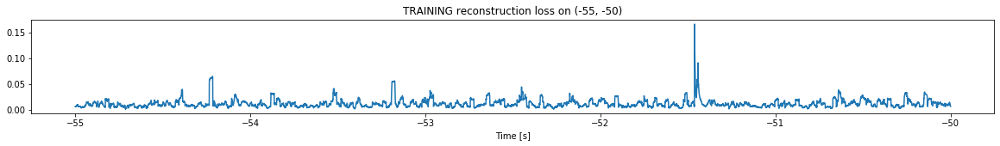

Finished training, median of the log(loss) is:  -1.9778745049181863
Triggering for section:  (-50, -45)
Using this median for triggering: -1.6791818687507911


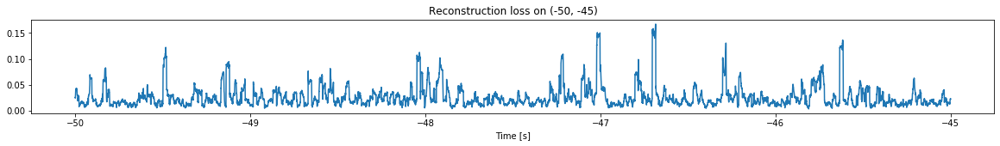

<--------
Entering sections:  (-45, -40)
-------->
Training for section:  (-50, -45)


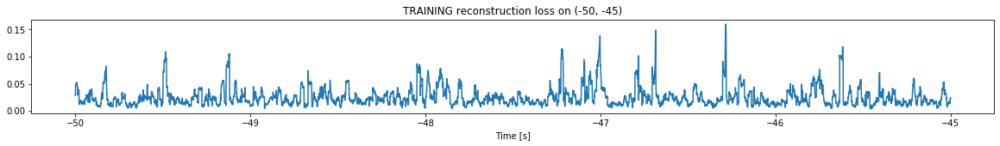

Finished training, median of the log(loss) is:  -1.683785261049921
Triggering for section:  (-45, -40)
Using this median for triggering: -1.9778745049181863


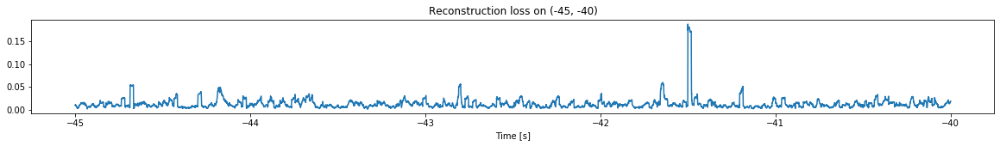

<--------
Entering sections:  (-40, -35)
-------->
Training for section:  (-45, -40)


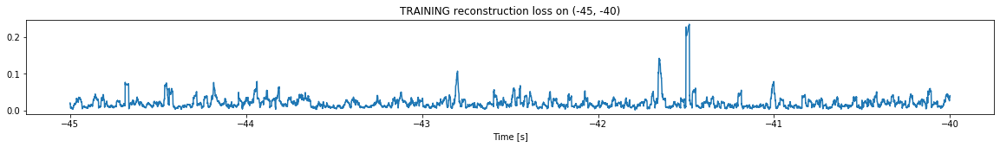

Finished training, median of the log(loss) is:  -1.7509457860527298
Triggering for section:  (-40, -35)
Using this median for triggering: -1.683785261049921


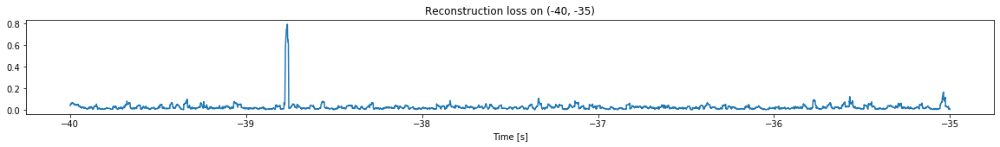

<--------
Entering sections:  (-35, -30)
-------->
Training for section:  (-40, -35)


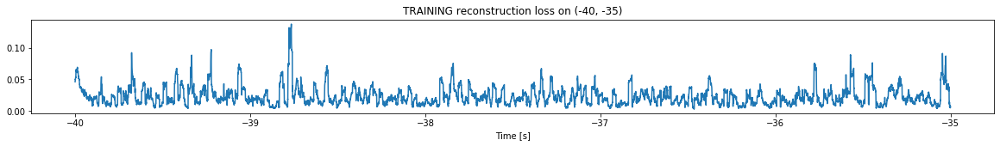

Finished training, median of the log(loss) is:  -1.6914925260463949
Triggering for section:  (-35, -30)
Using this median for triggering: -1.7509457860527298


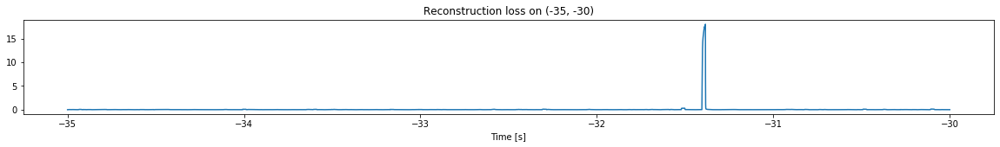

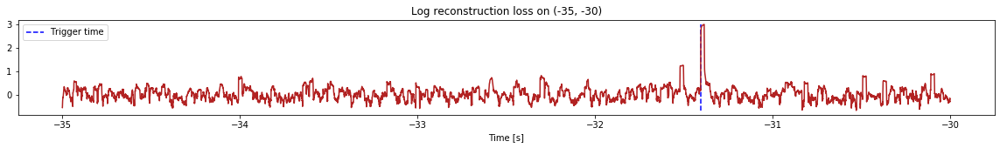

Triggered at:  -31.402699
<--------
Entering sections:  (-30, -25)
-------->
Training for section:  (-35, -30)


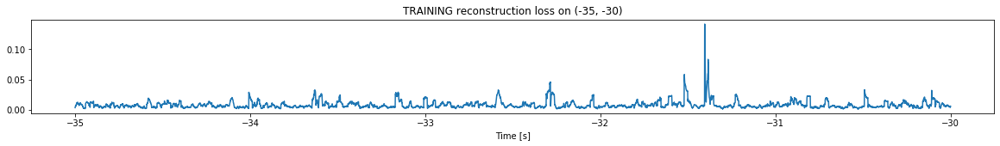

Finished training, median of the log(loss) is:  -2.184811875468332
Triggering for section:  (-30, -25)
Using this median for triggering: -1.6914925260463949


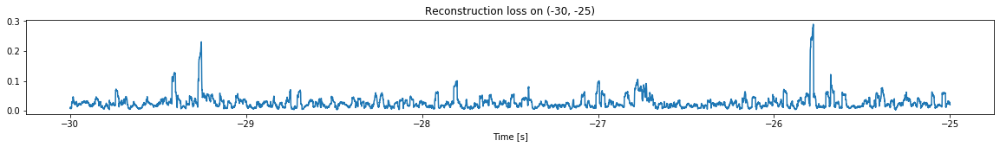

<--------
Entering sections:  (-25, -20)
-------->
Training for section:  (-30, -25)


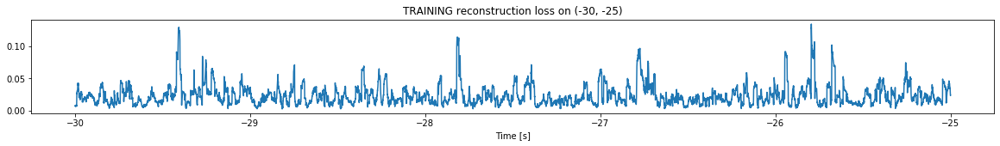

Finished training, median of the log(loss) is:  -1.6973496434179547
Triggering for section:  (-25, -20)
Using this median for triggering: -2.184811875468332


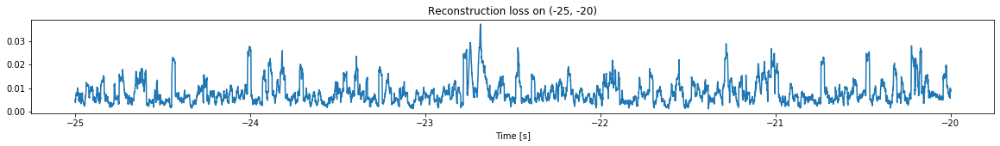

<--------
Entering sections:  (-20, -15)
-------->
Training for section:  (-25, -20)


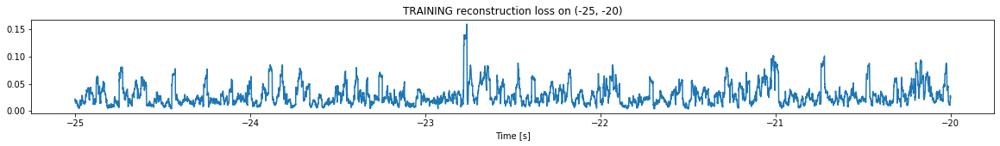

Finished training, median of the log(loss) is:  -1.6280383998377412
Triggering for section:  (-20, -15)
Using this median for triggering: -1.6973496434179547


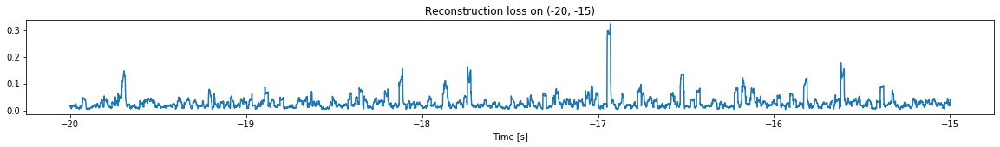

<--------
Entering sections:  (-15, -10)
-------->
Training for section:  (-20, -15)


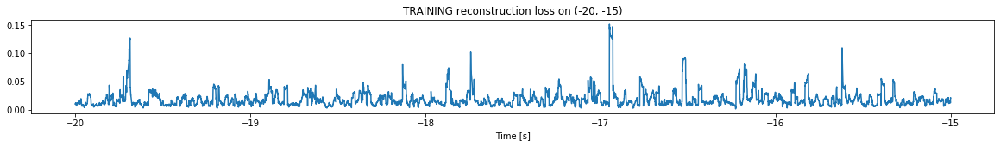

Finished training, median of the log(loss) is:  -1.8229365322046915
Triggering for section:  (-15, -10)
Using this median for triggering: -1.6280383998377412


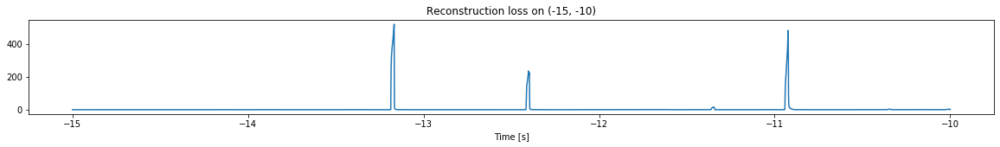

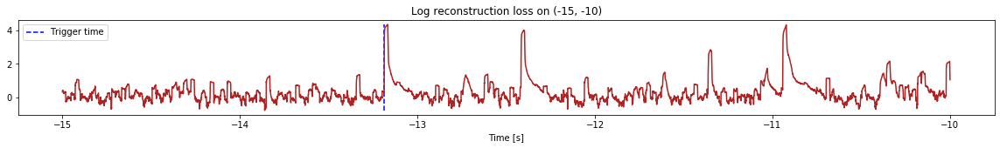

Triggered at:  -13.1866
<--------
Entering sections:  (-10, -5)
-------->
Training for section:  (-15, -10)


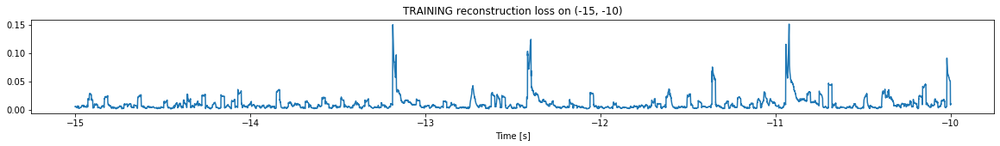

Finished training, median of the log(loss) is:  -2.1806835266424622
Triggering for section:  (-10, -5)
Using this median for triggering: -1.8229365322046915


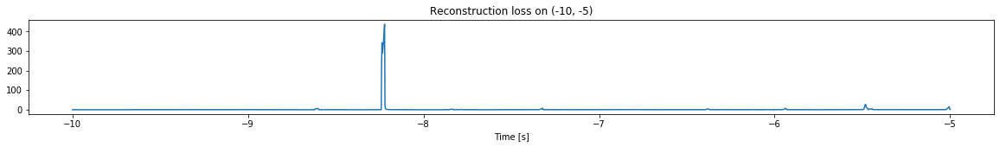

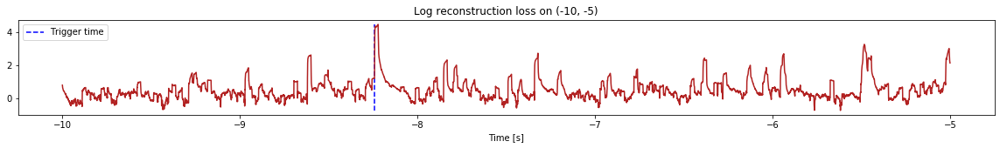

Triggered at:  -8.241
<--------
Entering sections:  (-5, 0)
-------->
Training for section:  (-10, -5)


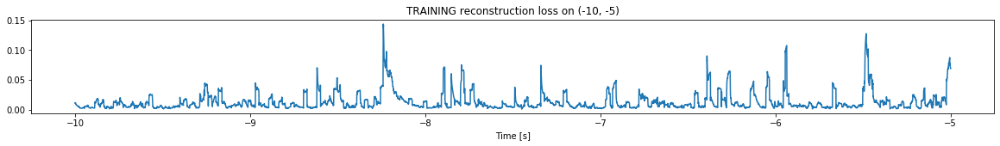

Finished training, median of the log(loss) is:  -2.0708465892160914
Triggering for section:  (-5, 0)
Using this median for triggering: -2.1806835266424622


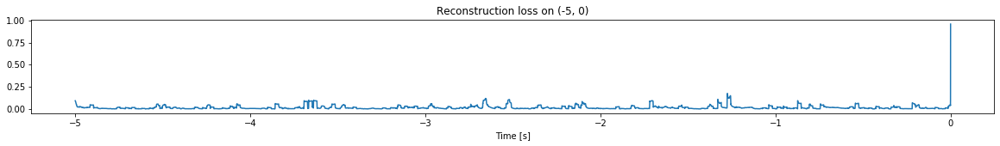

<--------
Finished simulation, all the triggered times are:  [-51.4615, -31.402699, -13.1866, -8.241]


In [13]:
simulation("./data/Ramp25/", 5, (-100,0))

Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
All data's shape:  (1097500, 12)
Flushing input history
Number of sections: 22
Entering sections:  (-110, -105)
-------->
Entering sections:  (-105, -100)
-------->
Training for section:  (None, -105)


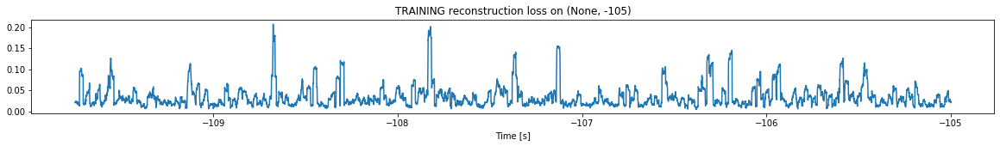

Finished training, median of the log(loss) is:  -1.556103135775285
<--------
Entering sections:  (-100, -95)
-------->
Training for section:  (-105, -100)


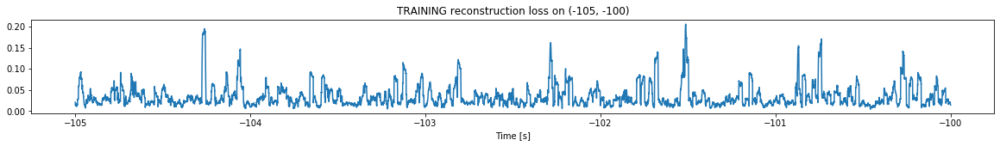

Finished training, median of the log(loss) is:  -1.565630176667457
Triggering for section:  (-100, -95)
Using this median for triggering: -1.556103135775285


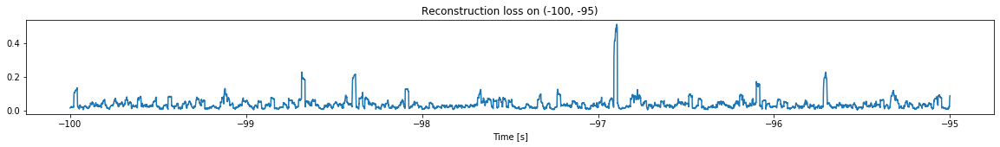

<--------
Entering sections:  (-95, -90)
-------->
Training for section:  (-100, -95)


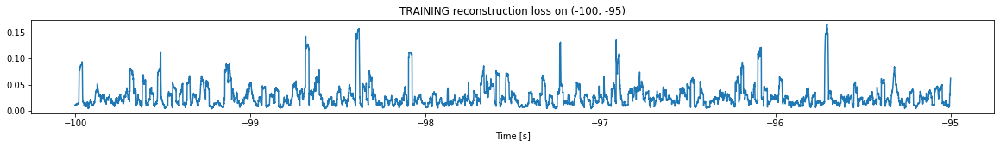

Finished training, median of the log(loss) is:  -1.642540102505357
Triggering for section:  (-95, -90)
Using this median for triggering: -1.565630176667457


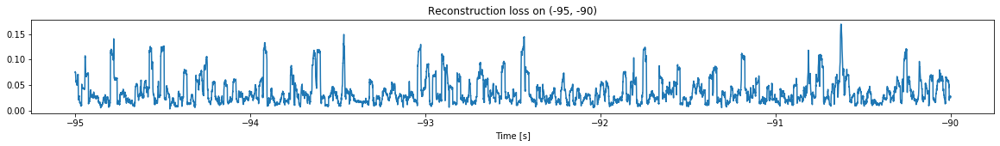

<--------
Entering sections:  (-90, -85)
-------->
Training for section:  (-95, -90)


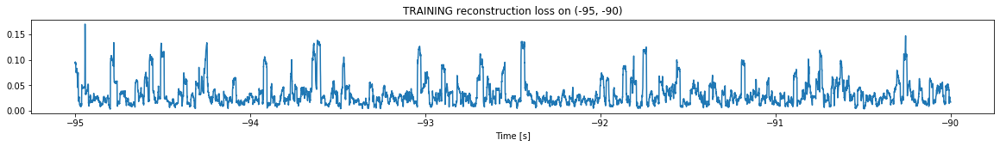

Finished training, median of the log(loss) is:  -1.573625207179701
Triggering for section:  (-90, -85)
Using this median for triggering: -1.642540102505357


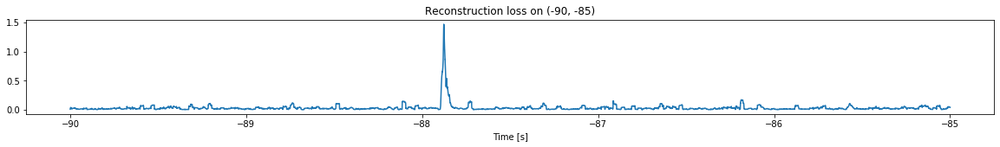

<--------
Entering sections:  (-85, -80)
-------->
Training for section:  (-90, -85)


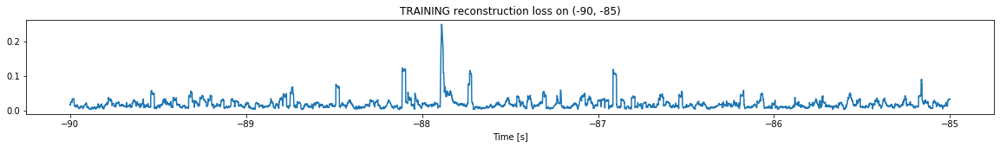

Finished training, median of the log(loss) is:  -1.8216928883471146
Triggering for section:  (-85, -80)
Using this median for triggering: -1.573625207179701


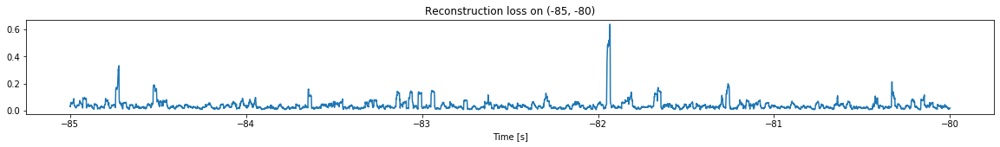

<--------
Entering sections:  (-80, -75)
-------->
Training for section:  (-85, -80)


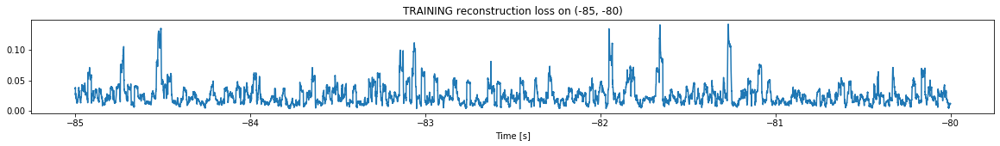

Finished training, median of the log(loss) is:  -1.6616680642650434
Triggering for section:  (-80, -75)
Using this median for triggering: -1.8216928883471146


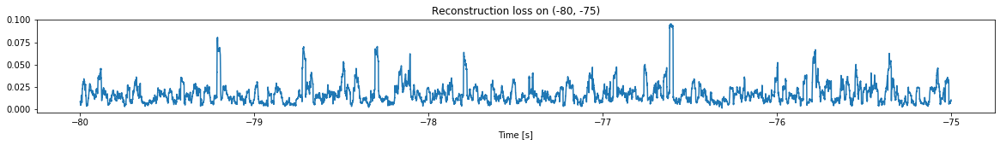

<--------
Entering sections:  (-75, -70)
-------->
Training for section:  (-80, -75)


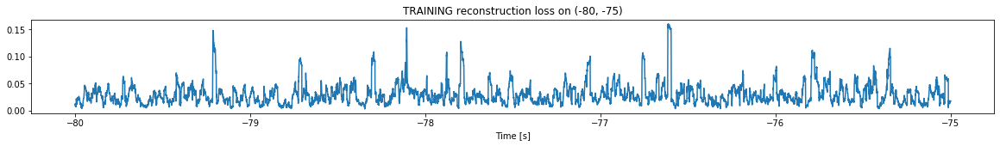

Finished training, median of the log(loss) is:  -1.579073777370568
Triggering for section:  (-75, -70)
Using this median for triggering: -1.6616680642650434


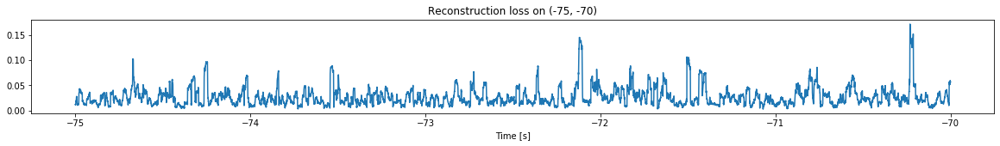

<--------
Entering sections:  (-70, -65)
-------->
Training for section:  (-75, -70)


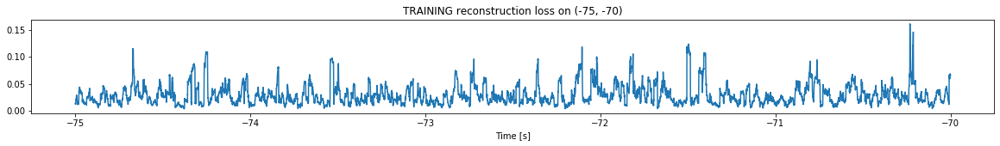

Finished training, median of the log(loss) is:  -1.5987427255625488
Triggering for section:  (-70, -65)
Using this median for triggering: -1.579073777370568


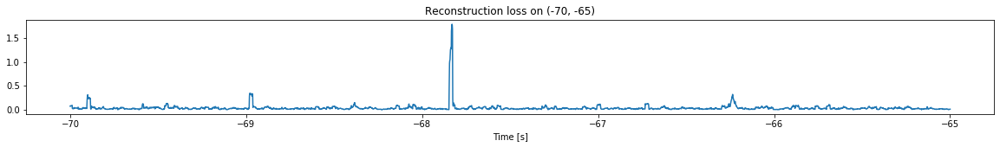

<--------
Entering sections:  (-65, -60)
-------->
Training for section:  (-70, -65)


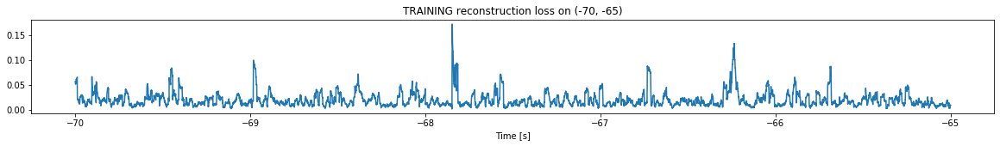

Finished training, median of the log(loss) is:  -1.782326445268046
Triggering for section:  (-65, -60)
Using this median for triggering: -1.5987427255625488


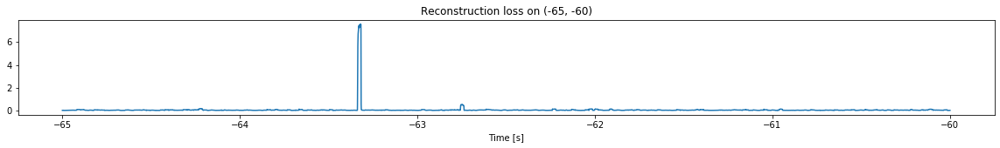

<--------
Entering sections:  (-60, -55)
-------->
Training for section:  (-65, -60)


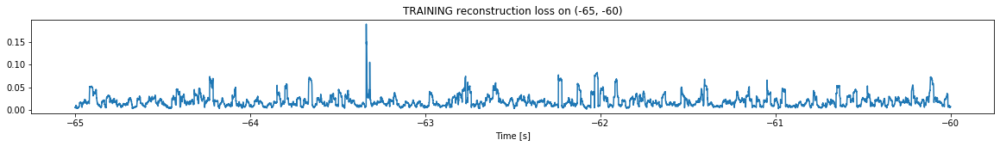

Finished training, median of the log(loss) is:  -1.7832523462227607
Triggering for section:  (-60, -55)
Using this median for triggering: -1.782326445268046


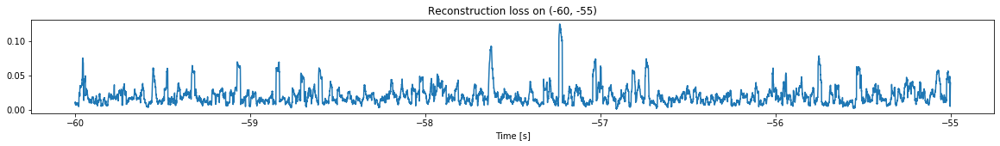

<--------
Entering sections:  (-55, -50)
-------->
Training for section:  (-60, -55)


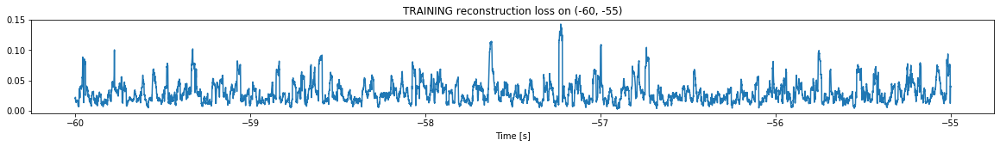

Finished training, median of the log(loss) is:  -1.5818606773075272
Triggering for section:  (-55, -50)
Using this median for triggering: -1.7832523462227607


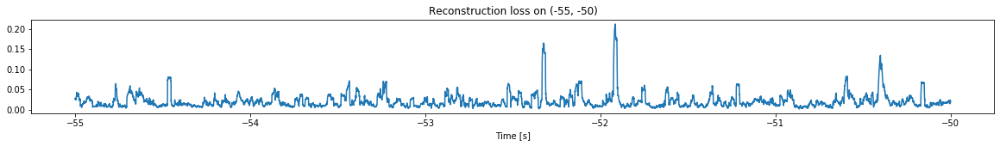

<--------
Entering sections:  (-50, -45)
-------->
Training for section:  (-55, -50)


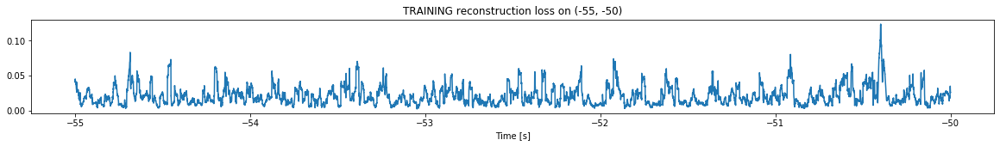

Finished training, median of the log(loss) is:  -1.7343134425666273
Triggering for section:  (-50, -45)
Using this median for triggering: -1.5818606773075272


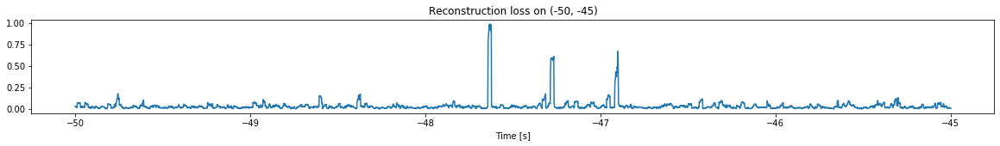

<--------
Entering sections:  (-45, -40)
-------->
Training for section:  (-50, -45)


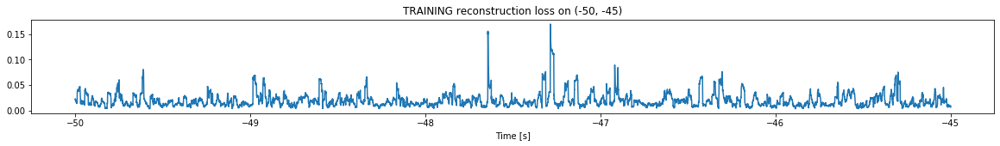

Finished training, median of the log(loss) is:  -1.7939318410826997
Triggering for section:  (-45, -40)
Using this median for triggering: -1.7343134425666273


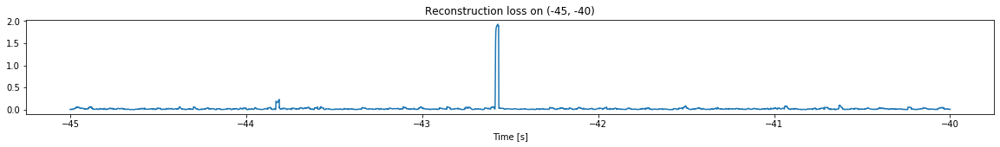

<--------
Entering sections:  (-40, -35)
-------->
Training for section:  (-45, -40)


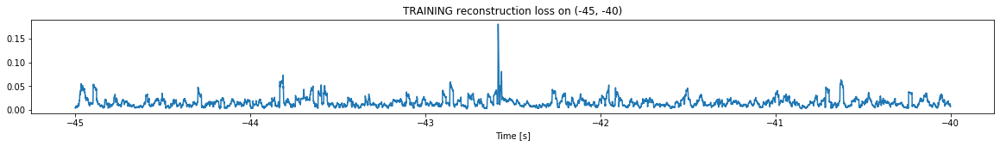

Finished training, median of the log(loss) is:  -1.8652969984201304
Triggering for section:  (-40, -35)
Using this median for triggering: -1.7939318410826997


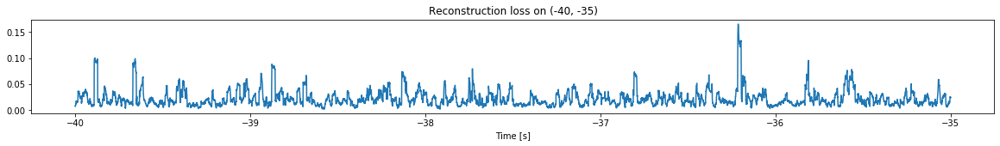

<--------
Entering sections:  (-35, -30)
-------->
Training for section:  (-40, -35)


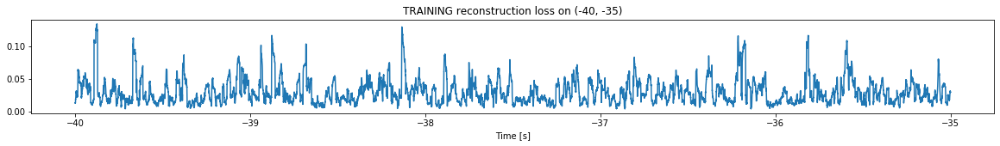

Finished training, median of the log(loss) is:  -1.5942299964323057
Triggering for section:  (-35, -30)
Using this median for triggering: -1.8652969984201304


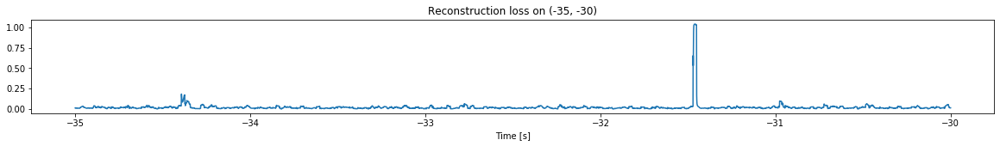

<--------
Entering sections:  (-30, -25)
-------->
Training for section:  (-35, -30)


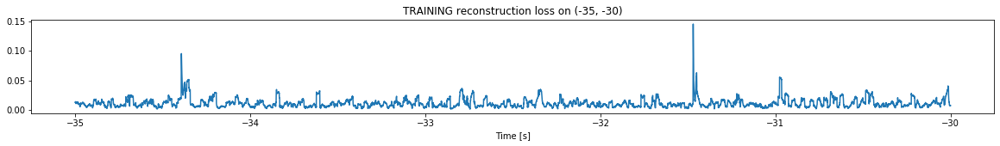

Finished training, median of the log(loss) is:  -2.0063953111306416
Triggering for section:  (-30, -25)
Using this median for triggering: -1.5942299964323057


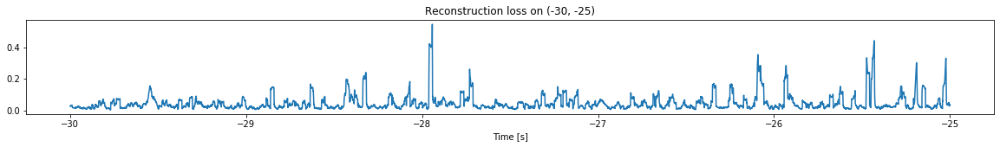

<--------
Entering sections:  (-25, -20)
-------->
Training for section:  (-30, -25)


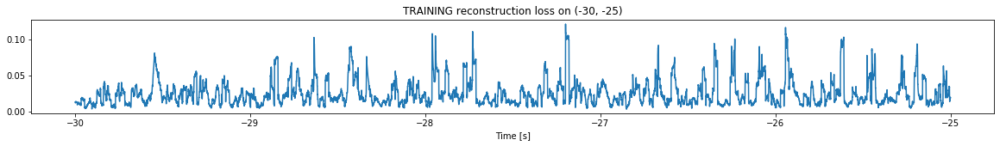

Finished training, median of the log(loss) is:  -1.6880339038207823
Triggering for section:  (-25, -20)
Using this median for triggering: -2.0063953111306416


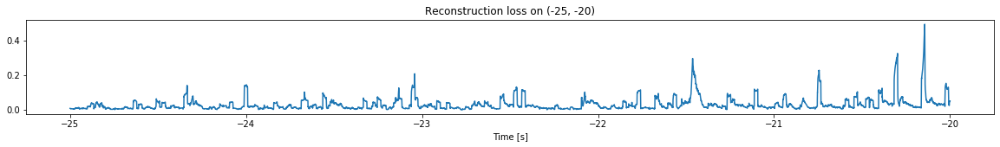

<--------
Entering sections:  (-20, -15)
-------->
Training for section:  (-25, -20)


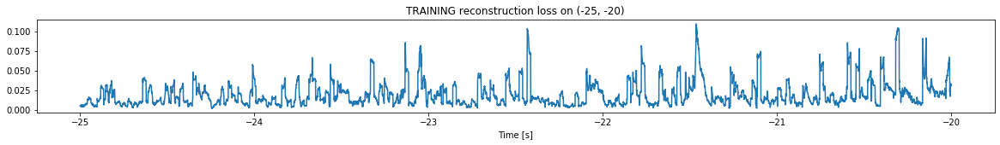

Finished training, median of the log(loss) is:  -1.8304549488414694
Triggering for section:  (-20, -15)
Using this median for triggering: -1.6880339038207823


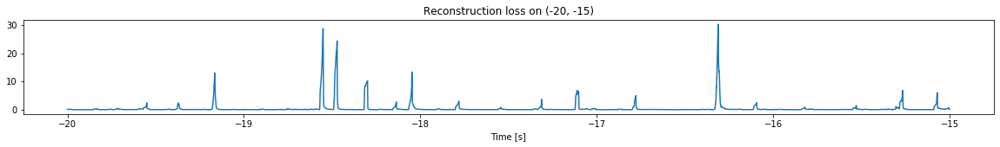

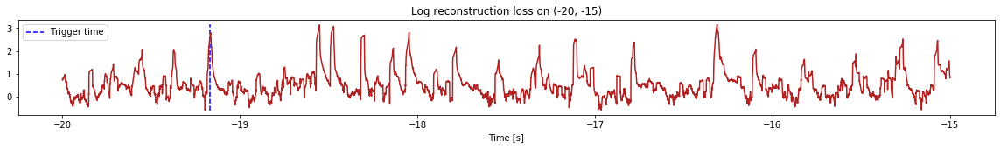

Triggered at:  -19.1673
<--------
Entering sections:  (-15, -10)
-------->
Training for section:  (-20, -15)


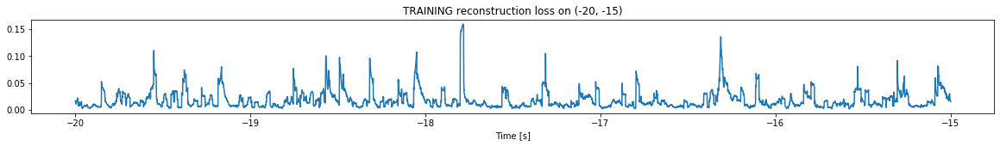

Finished training, median of the log(loss) is:  -1.8909762904972933
Triggering for section:  (-15, -10)
Using this median for triggering: -1.8304549488414694


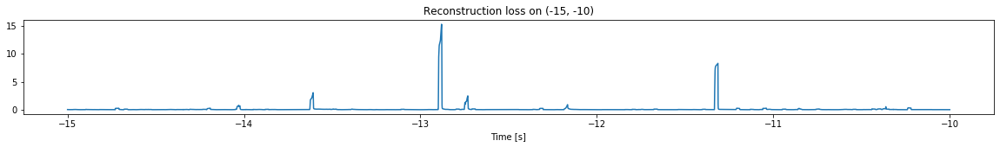

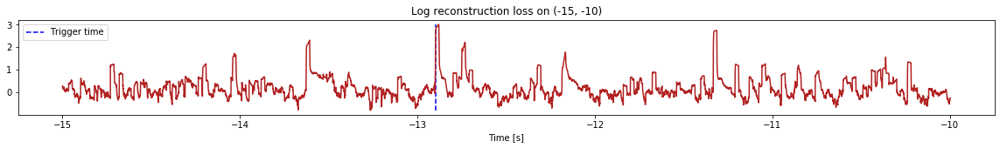

Triggered at:  -12.896999
<--------
Entering sections:  (-10, -5)
-------->
Training for section:  (-15, -10)


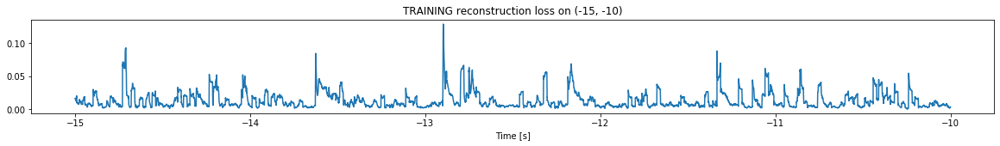

Finished training, median of the log(loss) is:  -2.04212496298418
Triggering for section:  (-10, -5)
Using this median for triggering: -1.8909762904972933


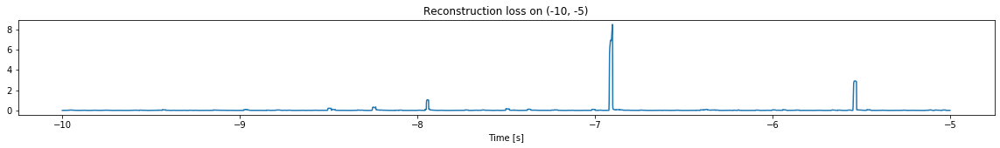

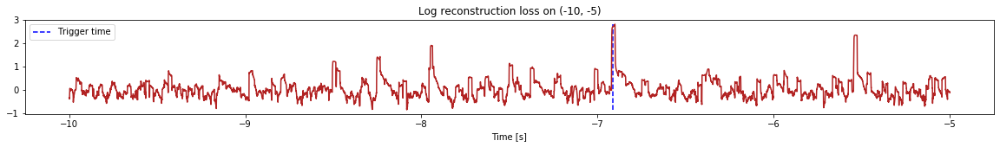

Triggered at:  -6.9147997
<--------
Entering sections:  (-5, 0)
-------->
Training for section:  (-10, -5)


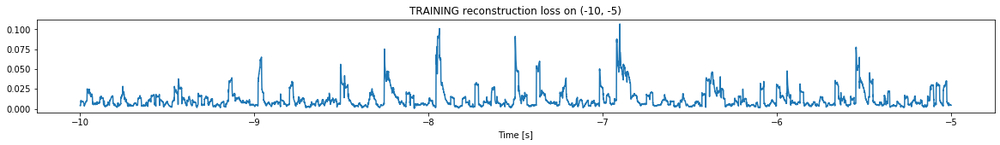

Finished training, median of the log(loss) is:  -2.0843333720407813
Triggering for section:  (-5, 0)
Using this median for triggering: -2.04212496298418


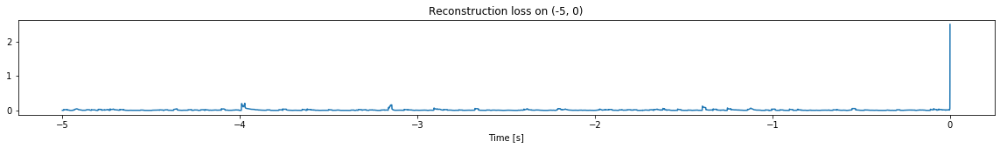

<--------
Finished simulation, all the triggered times are:  [-19.1673, -12.896999, -6.9147997]


In [14]:
simulation("./data/Ramp26/", 5, (-110,0))

Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
All data's shape:  (697500, 12)
Flushing input history
Number of sections: 14
Entering sections:  (-70, -65)
-------->
Entering sections:  (-65, -60)
-------->
Training for section:  (None, -65)


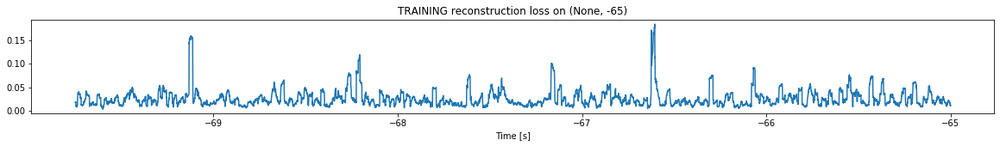

Finished training, median of the log(loss) is:  -1.677492624346742
<--------
Entering sections:  (-60, -55)
-------->
Training for section:  (-65, -60)


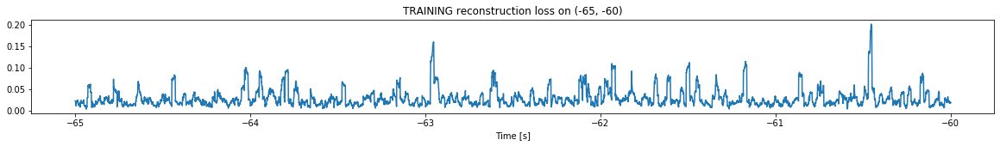

Finished training, median of the log(loss) is:  -1.6258064896841873
Triggering for section:  (-60, -55)
Using this median for triggering: -1.677492624346742


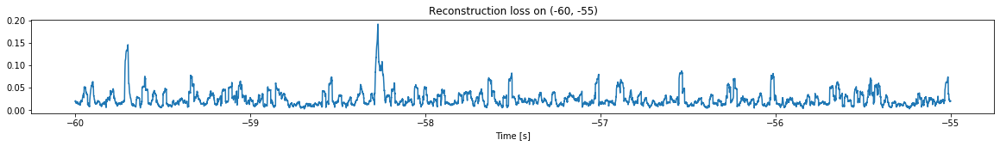

<--------
Entering sections:  (-55, -50)
-------->
Training for section:  (-60, -55)


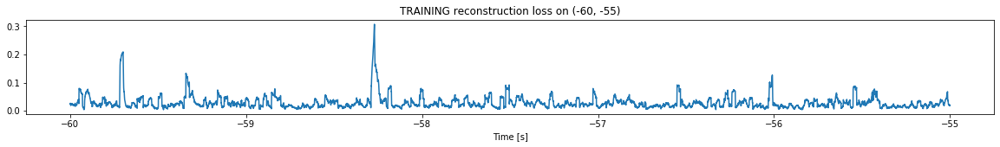

Finished training, median of the log(loss) is:  -1.645733018388128
Triggering for section:  (-55, -50)
Using this median for triggering: -1.6258064896841873


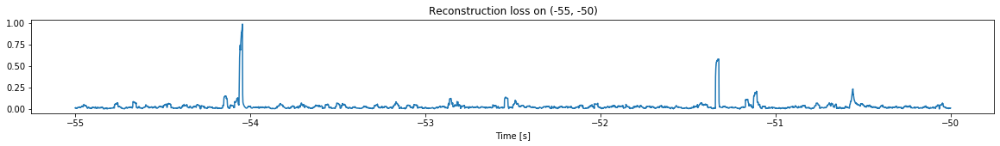

<--------
Entering sections:  (-50, -45)
-------->
Training for section:  (-55, -50)


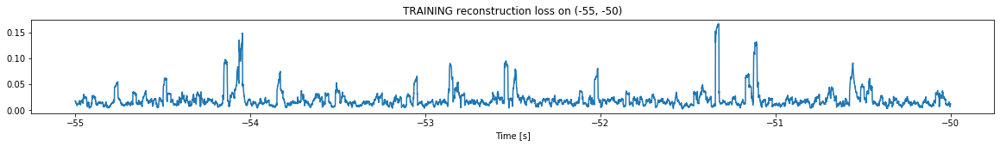

Finished training, median of the log(loss) is:  -1.786103344280265
Triggering for section:  (-50, -45)
Using this median for triggering: -1.645733018388128


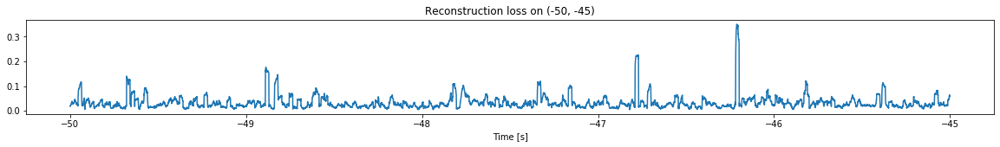

<--------
Entering sections:  (-45, -40)
-------->
Training for section:  (-50, -45)


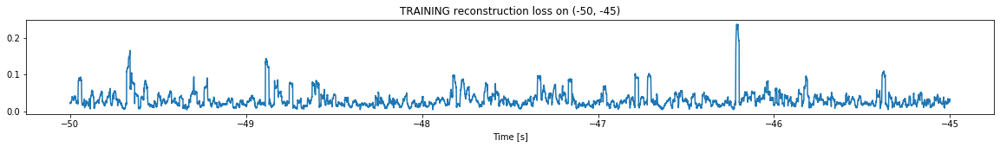

Finished training, median of the log(loss) is:  -1.5828682512831636
Triggering for section:  (-45, -40)
Using this median for triggering: -1.786103344280265


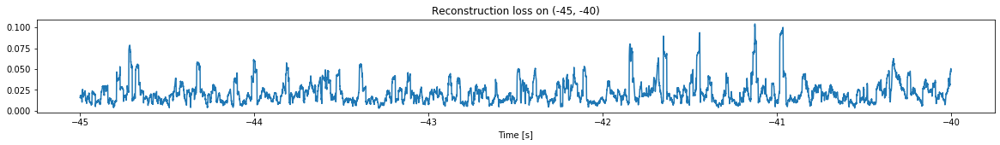

<--------
Entering sections:  (-40, -35)
-------->
Training for section:  (-45, -40)


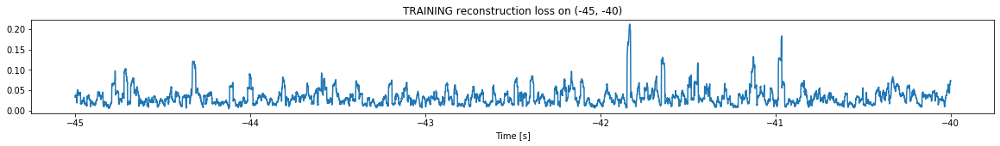

Finished training, median of the log(loss) is:  -1.5396582213932524
Triggering for section:  (-40, -35)
Using this median for triggering: -1.5828682512831636


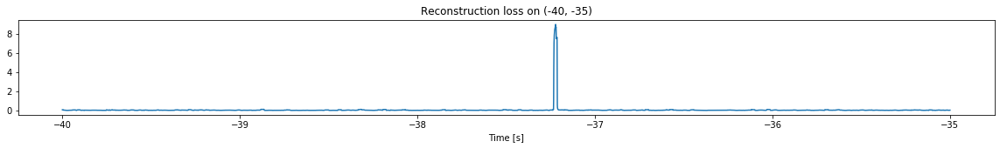

<--------
Entering sections:  (-35, -30)
-------->
Training for section:  (-40, -35)


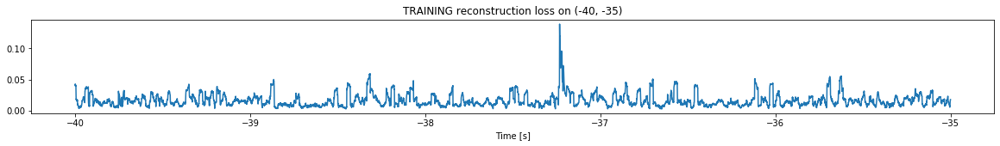

Finished training, median of the log(loss) is:  -1.8507368211966027
Triggering for section:  (-35, -30)
Using this median for triggering: -1.5396582213932524


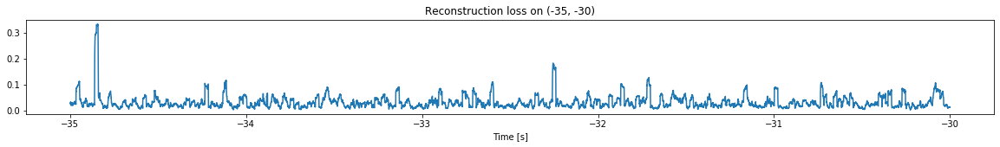

<--------
Entering sections:  (-30, -25)
-------->
Training for section:  (-35, -30)


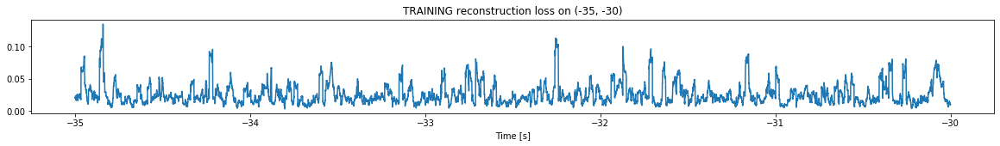

Finished training, median of the log(loss) is:  -1.6632490442793098
Triggering for section:  (-30, -25)
Using this median for triggering: -1.8507368211966027


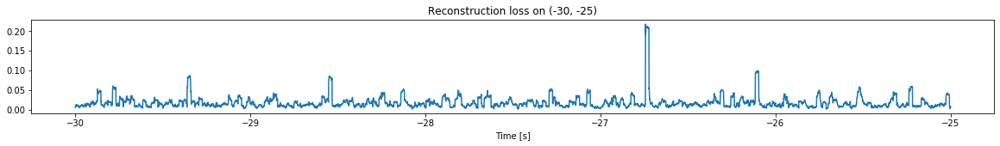

<--------
Entering sections:  (-25, -20)
-------->
Training for section:  (-30, -25)


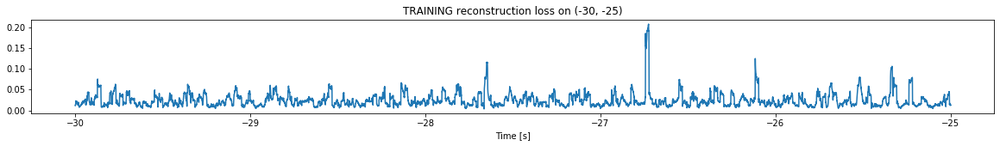

Finished training, median of the log(loss) is:  -1.6913751352419246
Triggering for section:  (-25, -20)
Using this median for triggering: -1.6632490442793098


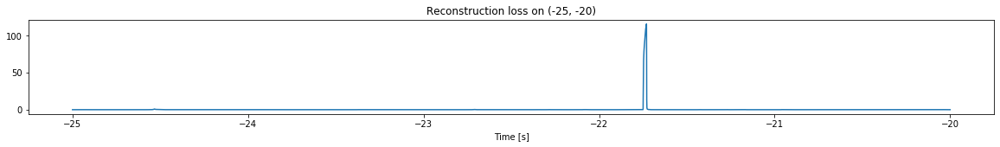

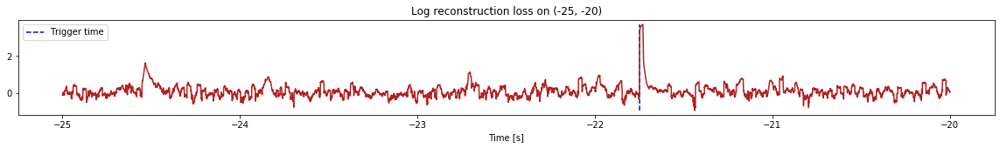

Triggered at:  -21.7486
<--------
Entering sections:  (-20, -15)
-------->
Training for section:  (-25, -20)


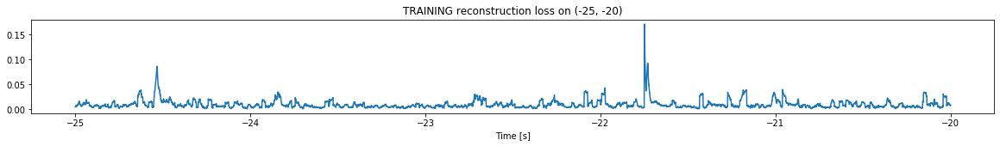

Finished training, median of the log(loss) is:  -2.103200650965263
Triggering for section:  (-20, -15)
Using this median for triggering: -1.6913751352419246


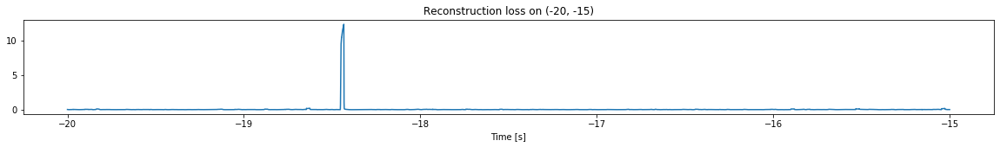

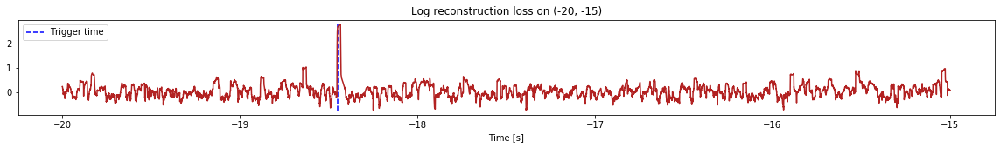

Triggered at:  -18.4475
<--------
Entering sections:  (-15, -10)
-------->
Training for section:  (-20, -15)


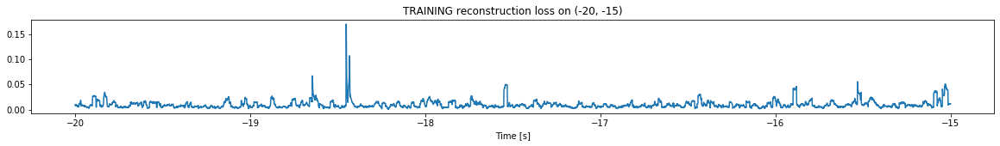

Finished training, median of the log(loss) is:  -2.1016202319034196
Triggering for section:  (-15, -10)
Using this median for triggering: -2.103200650965263


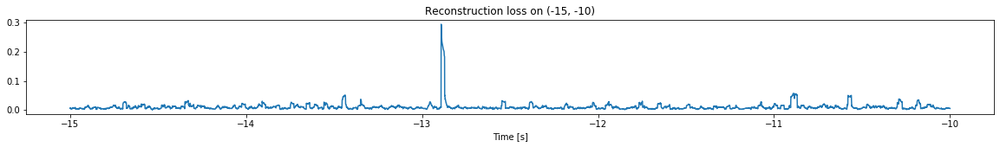

<--------
Entering sections:  (-10, -5)
-------->
Training for section:  (-15, -10)


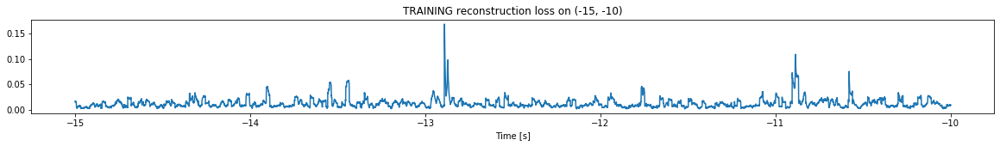

Finished training, median of the log(loss) is:  -1.9931320928884717
Triggering for section:  (-10, -5)
Using this median for triggering: -2.1016202319034196


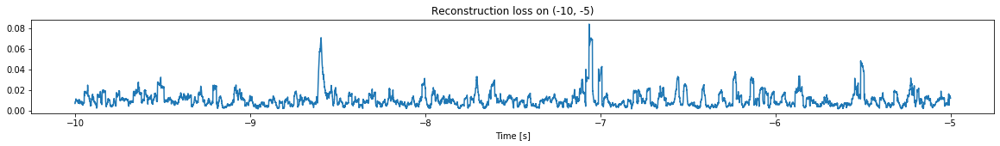

<--------
Entering sections:  (-5, 0)
-------->
Training for section:  (-10, -5)


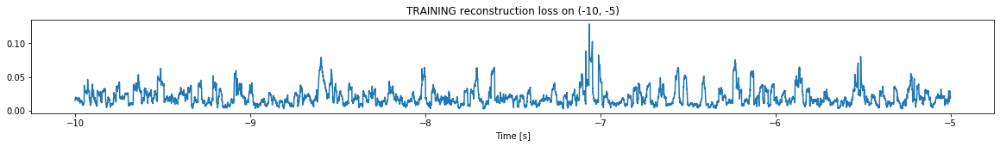

Finished training, median of the log(loss) is:  -1.7764429673200661
Triggering for section:  (-5, 0)
Using this median for triggering: -1.9931320928884717


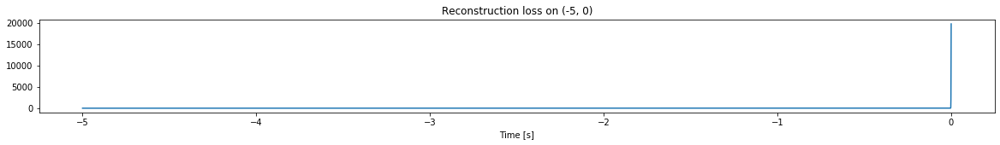

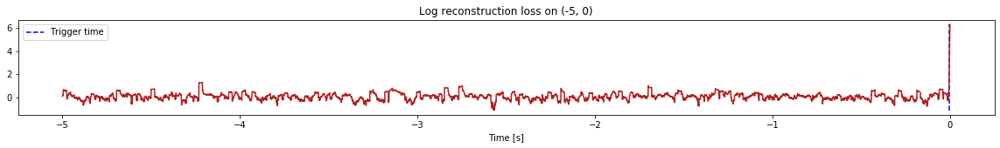

Triggered at:  -0.0042
<--------
Finished simulation, all the triggered times are:  [-21.7486, -18.4475, -0.0042]


In [15]:
simulation("./data/Ramp27/", 5, (-70,0))

Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
All data's shape:  (597500, 12)
Flushing input history
Number of sections: 12
Entering sections:  (-60, -55)
-------->
Entering sections:  (-55, -50)
-------->
Training for section:  (None, -55)


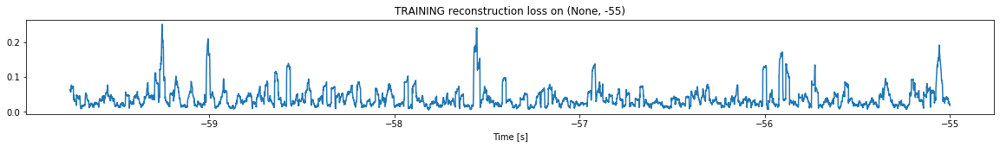

Finished training, median of the log(loss) is:  -1.4926306023162177
<--------
Entering sections:  (-50, -45)
-------->
Training for section:  (-55, -50)


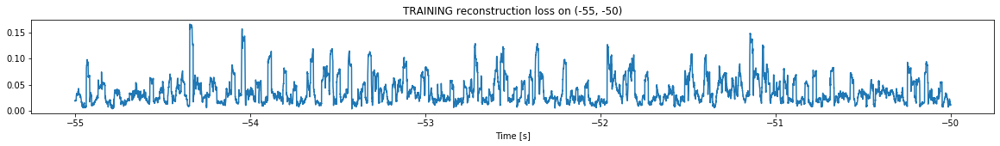

Finished training, median of the log(loss) is:  -1.5050598373999193
Triggering for section:  (-50, -45)
Using this median for triggering: -1.4926306023162177


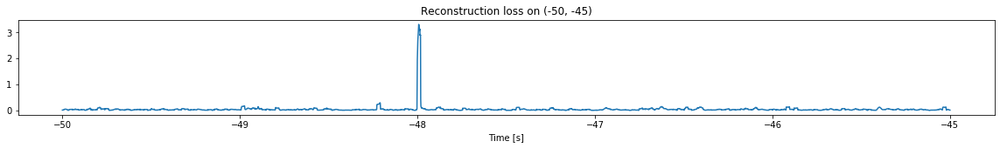

<--------
Entering sections:  (-45, -40)
-------->
Training for section:  (-50, -45)


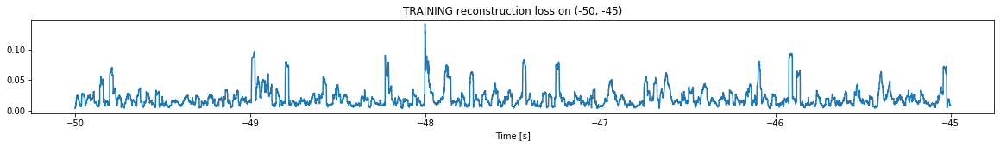

Finished training, median of the log(loss) is:  -1.786946926094611
Triggering for section:  (-45, -40)
Using this median for triggering: -1.5050598373999193


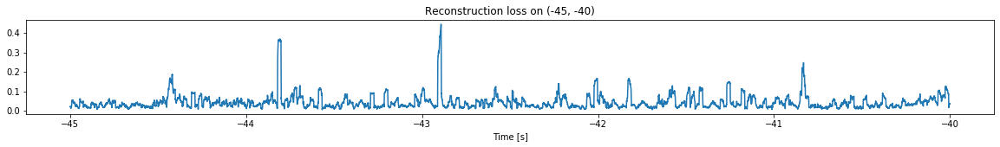

<--------
Entering sections:  (-40, -35)
-------->
Training for section:  (-45, -40)


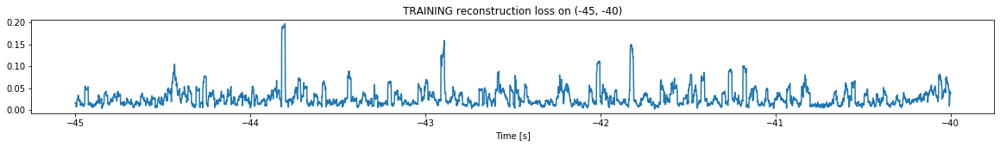

Finished training, median of the log(loss) is:  -1.6406633233728285
Triggering for section:  (-40, -35)
Using this median for triggering: -1.786946926094611


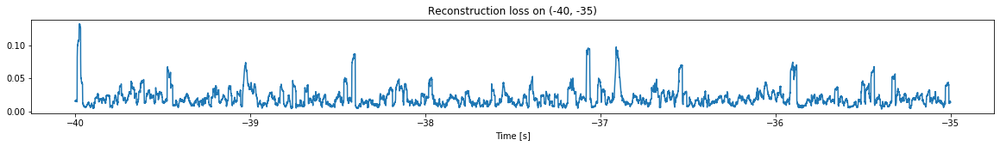

<--------
Entering sections:  (-35, -30)
-------->
Training for section:  (-40, -35)


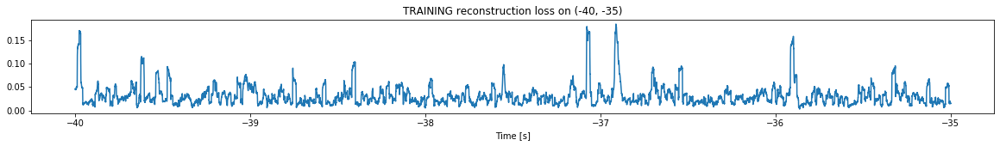

Finished training, median of the log(loss) is:  -1.576046639073275
Triggering for section:  (-35, -30)
Using this median for triggering: -1.6406633233728285


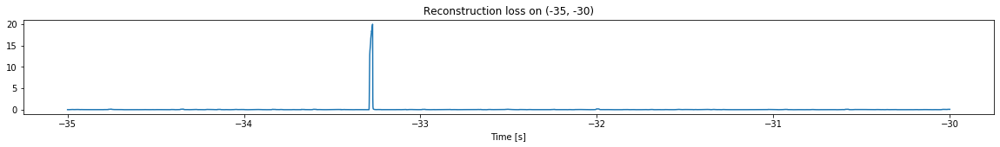

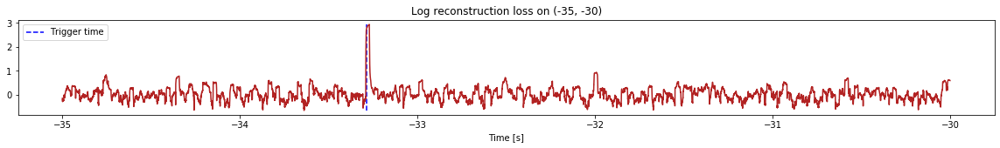

Triggered at:  -33.2879
<--------
Entering sections:  (-30, -25)
-------->
Training for section:  (-35, -30)


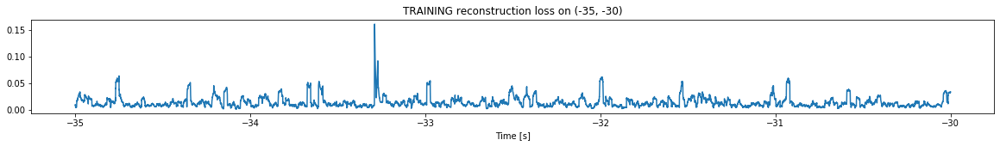

Finished training, median of the log(loss) is:  -1.9570075428567564
Triggering for section:  (-30, -25)
Using this median for triggering: -1.576046639073275


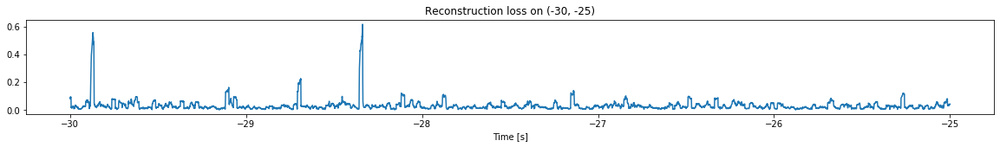

<--------
Entering sections:  (-25, -20)
-------->
Training for section:  (-30, -25)


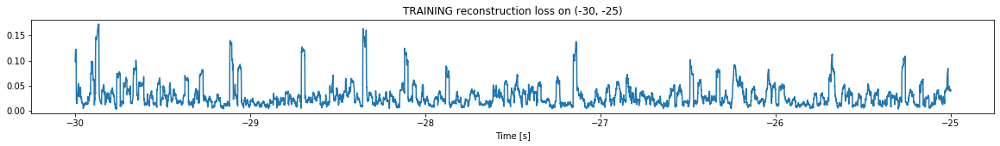

Finished training, median of the log(loss) is:  -1.6328498911828544
Triggering for section:  (-25, -20)
Using this median for triggering: -1.9570075428567564


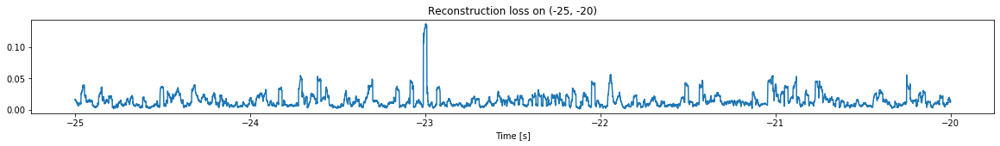

<--------
Entering sections:  (-20, -15)
-------->
Training for section:  (-25, -20)


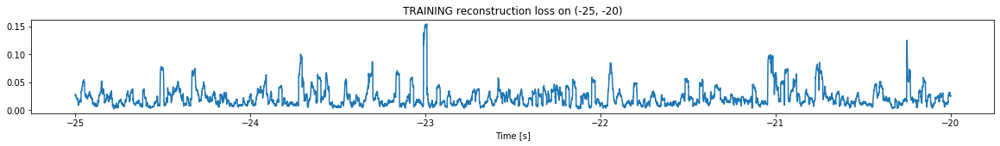

Finished training, median of the log(loss) is:  -1.7354348254831604
Triggering for section:  (-20, -15)
Using this median for triggering: -1.6328498911828544


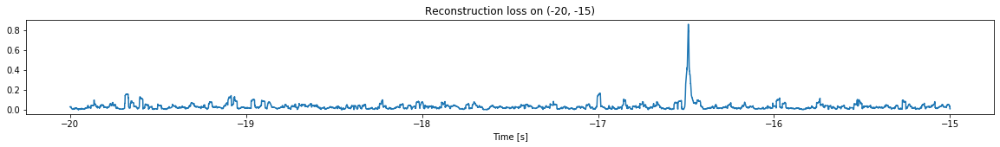

<--------
Entering sections:  (-15, -10)
-------->
Training for section:  (-20, -15)


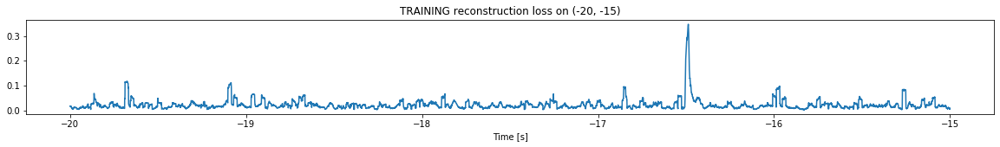

Finished training, median of the log(loss) is:  -1.7419808504640275
Triggering for section:  (-15, -10)
Using this median for triggering: -1.7354348254831604


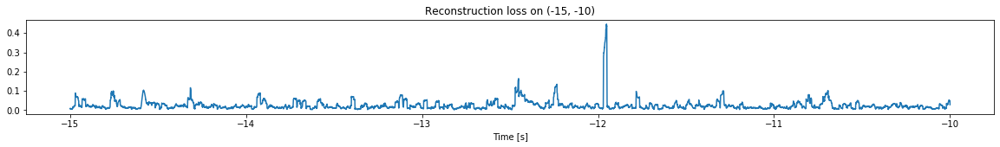

<--------
Entering sections:  (-10, -5)
-------->
Training for section:  (-15, -10)


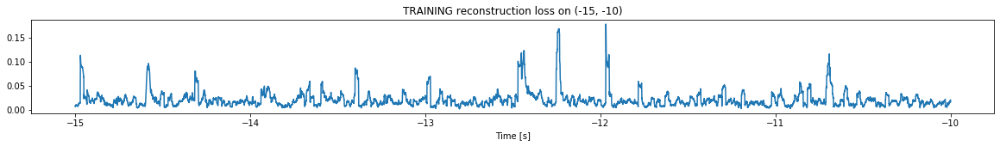

Finished training, median of the log(loss) is:  -1.7621053052474687
Triggering for section:  (-10, -5)
Using this median for triggering: -1.7419808504640275


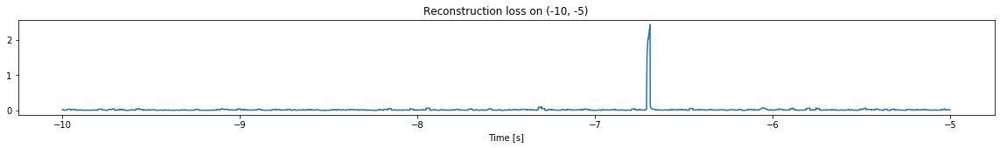

<--------
Entering sections:  (-5, 0)
-------->
Training for section:  (-10, -5)


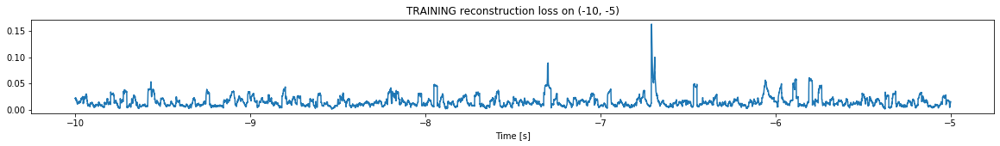

Finished training, median of the log(loss) is:  -1.8896109238577712
Triggering for section:  (-5, 0)
Using this median for triggering: -1.7621053052474687


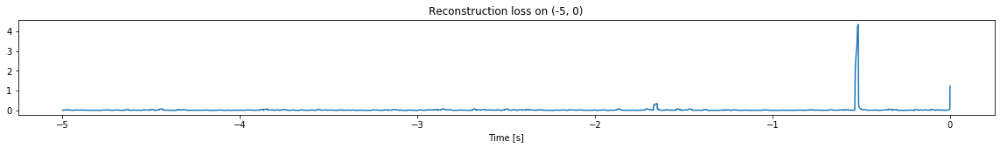

<--------
Finished simulation, all the triggered times are:  [-33.2879]


In [16]:
simulation("./data/Ramp28/", 5, (-60,0))

Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
All data's shape:  (997500, 12)
Flushing input history
Number of sections: 20
Entering sections:  (-100, -95)
-------->
Entering sections:  (-95, -90)
-------->
Training for section:  (None, -95)


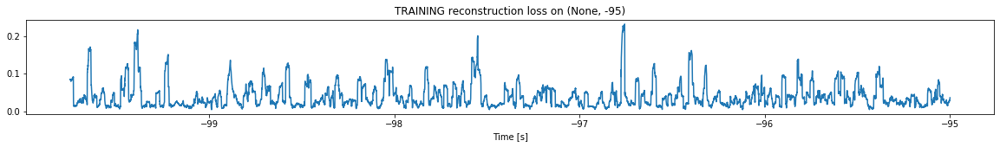

Finished training, median of the log(loss) is:  -1.510954876957477
<--------
Entering sections:  (-90, -85)
-------->
Training for section:  (-95, -90)


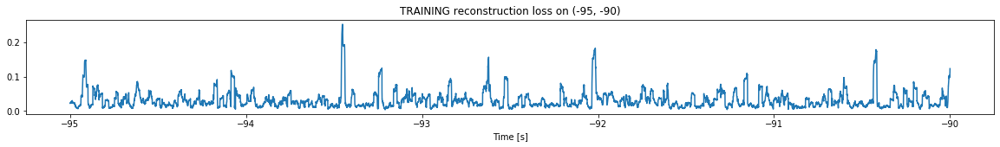

Finished training, median of the log(loss) is:  -1.6019201772654441
Triggering for section:  (-90, -85)
Using this median for triggering: -1.510954876957477


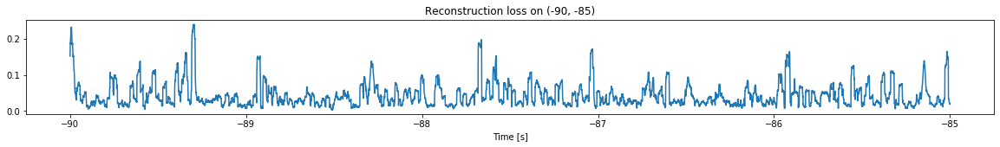

<--------
Entering sections:  (-85, -80)
-------->
Training for section:  (-90, -85)


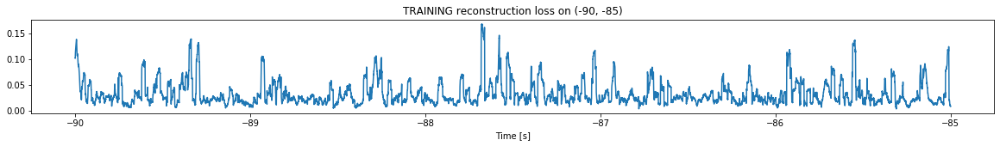

Finished training, median of the log(loss) is:  -1.5938475458759482
Triggering for section:  (-85, -80)
Using this median for triggering: -1.6019201772654441


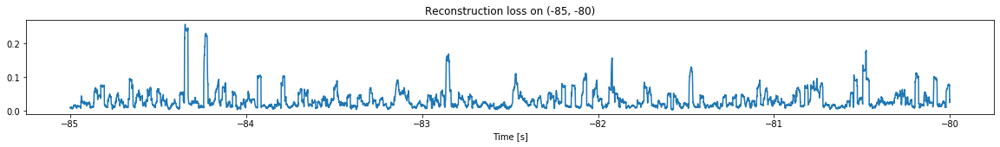

<--------
Entering sections:  (-80, -75)
-------->
Training for section:  (-85, -80)


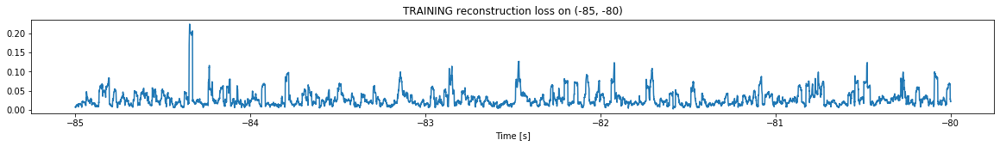

Finished training, median of the log(loss) is:  -1.6378907518404218
Triggering for section:  (-80, -75)
Using this median for triggering: -1.5938475458759482


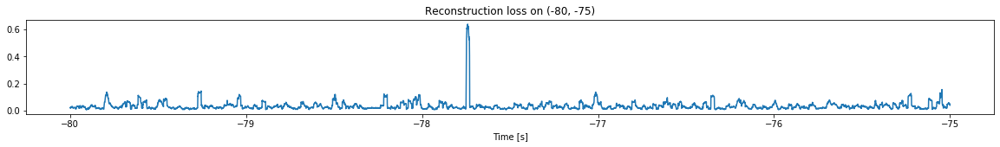

<--------
Entering sections:  (-75, -70)
-------->
Training for section:  (-80, -75)


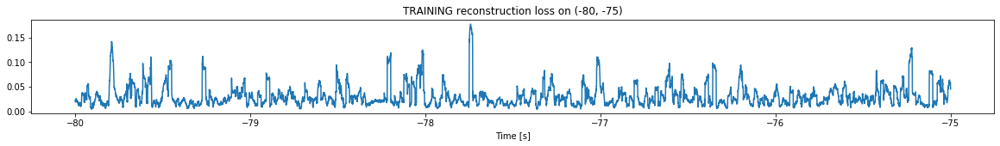

Finished training, median of the log(loss) is:  -1.5848673203529706
Triggering for section:  (-75, -70)
Using this median for triggering: -1.6378907518404218


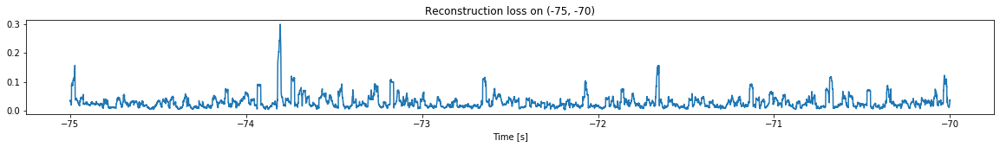

<--------
Entering sections:  (-70, -65)
-------->
Training for section:  (-75, -70)


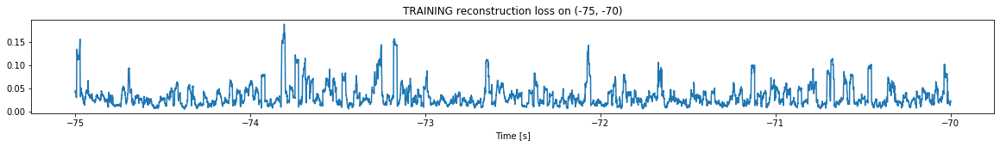

Finished training, median of the log(loss) is:  -1.5863142613438102
Triggering for section:  (-70, -65)
Using this median for triggering: -1.5848673203529706


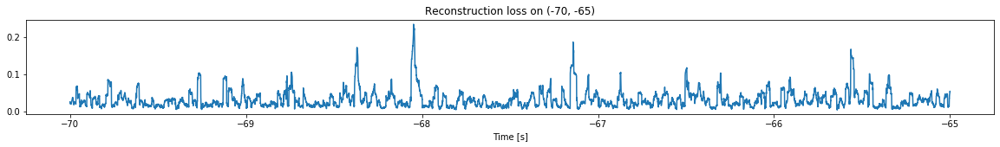

<--------
Entering sections:  (-65, -60)
-------->
Training for section:  (-70, -65)


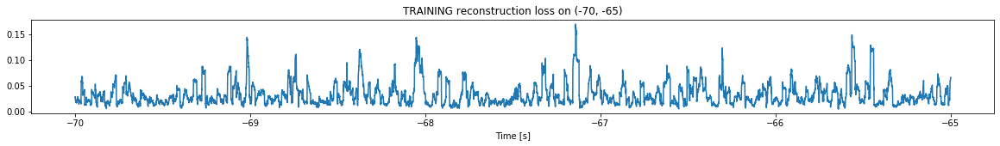

Finished training, median of the log(loss) is:  -1.5657235467023096
Triggering for section:  (-65, -60)
Using this median for triggering: -1.5863142613438102


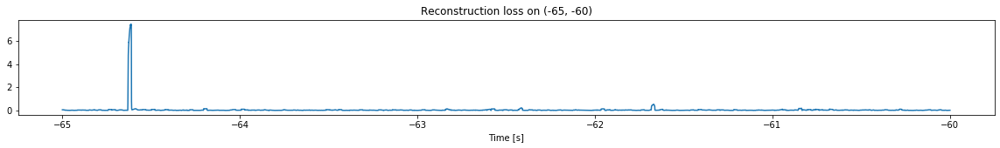

<--------
Entering sections:  (-60, -55)
-------->
Training for section:  (-65, -60)


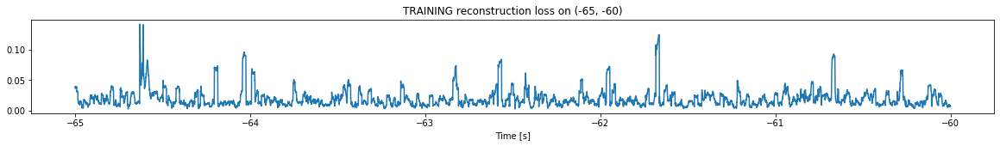

Finished training, median of the log(loss) is:  -1.795687532967976
Triggering for section:  (-60, -55)
Using this median for triggering: -1.5657235467023096


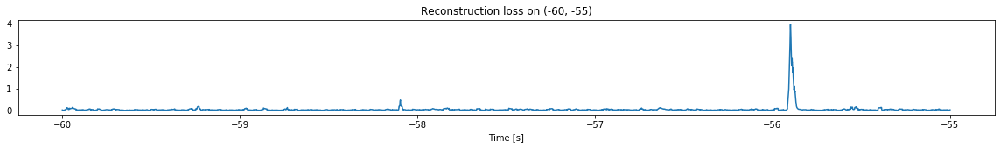

<--------
Entering sections:  (-55, -50)
-------->
Training for section:  (-60, -55)


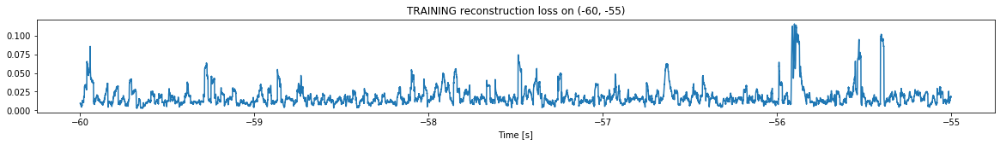

Finished training, median of the log(loss) is:  -1.8231469750236604
Triggering for section:  (-55, -50)
Using this median for triggering: -1.795687532967976


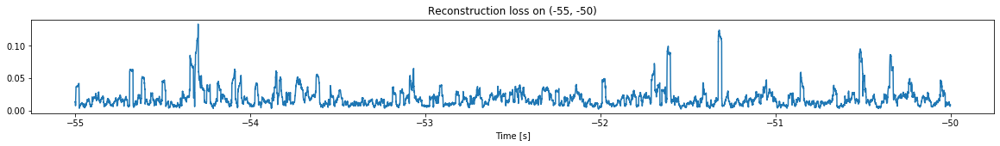

<--------
Entering sections:  (-50, -45)
-------->
Training for section:  (-55, -50)


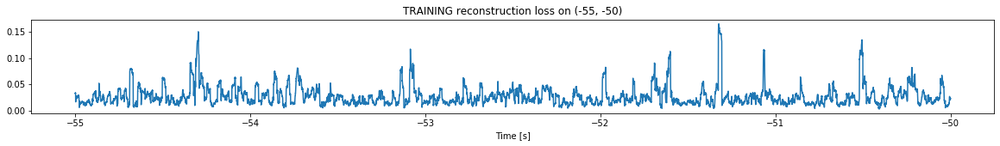

Finished training, median of the log(loss) is:  -1.638156153607742
Triggering for section:  (-50, -45)
Using this median for triggering: -1.8231469750236604


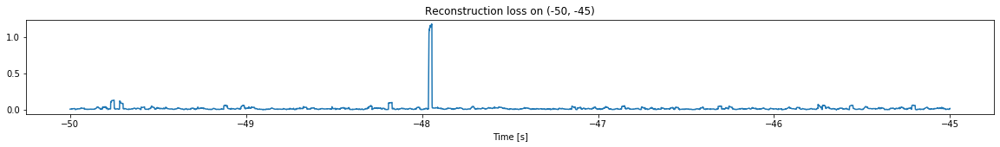

<--------
Entering sections:  (-45, -40)
-------->
Training for section:  (-50, -45)


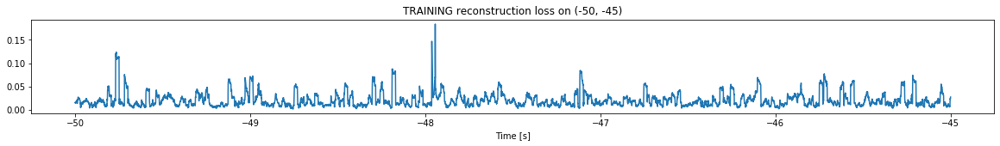

Finished training, median of the log(loss) is:  -1.7717337870845908
Triggering for section:  (-45, -40)
Using this median for triggering: -1.638156153607742


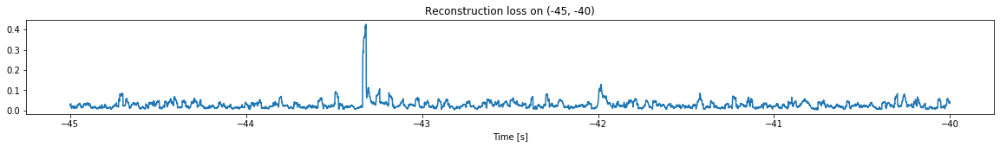

<--------
Entering sections:  (-40, -35)
-------->
Training for section:  (-45, -40)


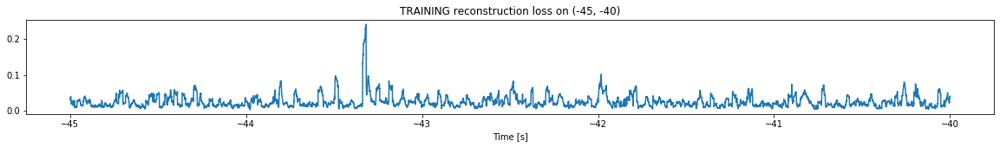

Finished training, median of the log(loss) is:  -1.6732181423620638
Triggering for section:  (-40, -35)
Using this median for triggering: -1.7717337870845908


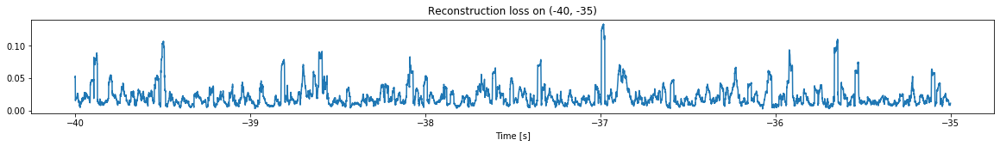

<--------
Entering sections:  (-35, -30)
-------->
Training for section:  (-40, -35)


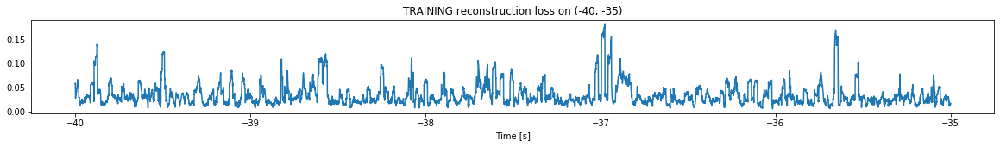

Finished training, median of the log(loss) is:  -1.556176358977321
Triggering for section:  (-35, -30)
Using this median for triggering: -1.6732181423620638


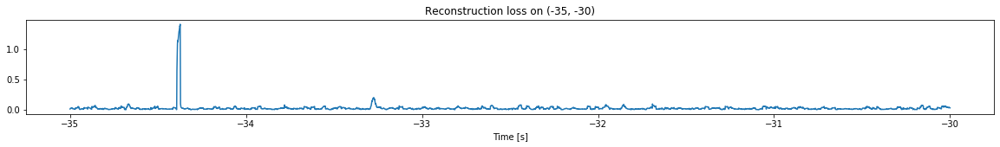

<--------
Entering sections:  (-30, -25)
-------->
Training for section:  (-35, -30)


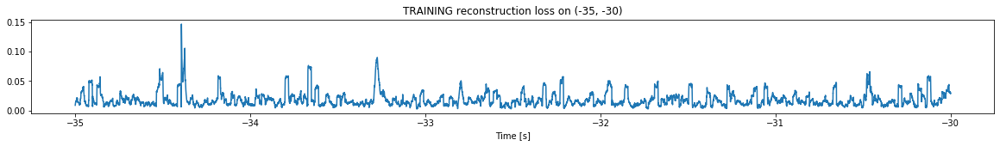

Finished training, median of the log(loss) is:  -1.820167339968337
Triggering for section:  (-30, -25)
Using this median for triggering: -1.556176358977321


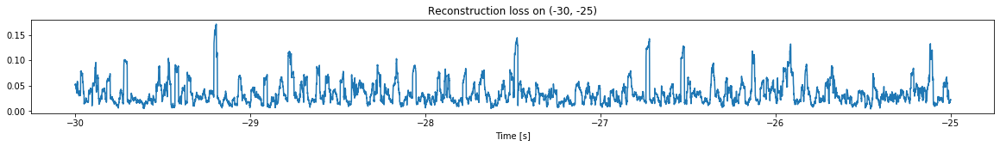

<--------
Entering sections:  (-25, -20)
-------->
Training for section:  (-30, -25)


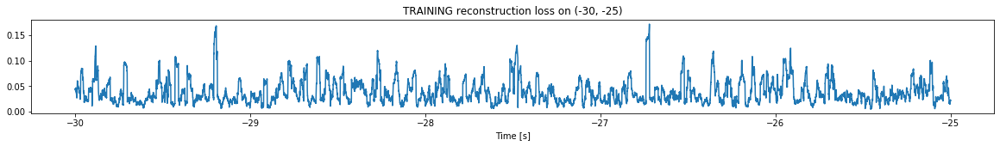

Finished training, median of the log(loss) is:  -1.490624094896831
Triggering for section:  (-25, -20)
Using this median for triggering: -1.820167339968337


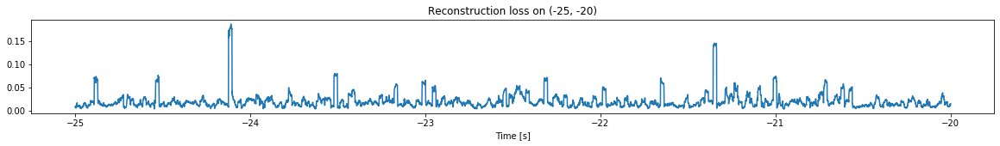

<--------
Entering sections:  (-20, -15)
-------->
Training for section:  (-25, -20)


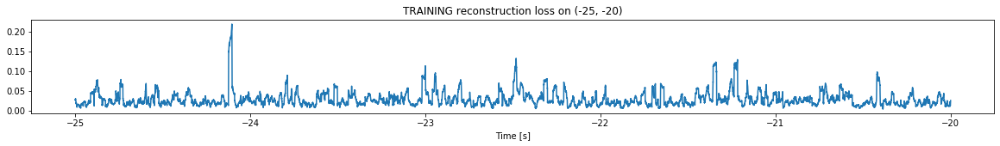

Finished training, median of the log(loss) is:  -1.6229026457832283
Triggering for section:  (-20, -15)
Using this median for triggering: -1.490624094896831


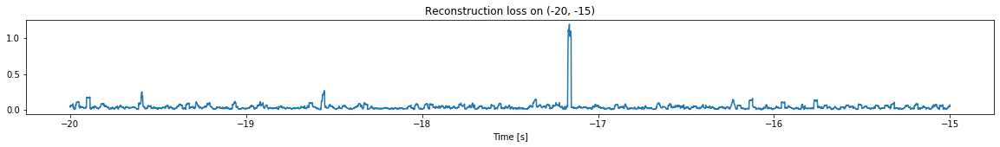

<--------
Entering sections:  (-15, -10)
-------->
Training for section:  (-20, -15)


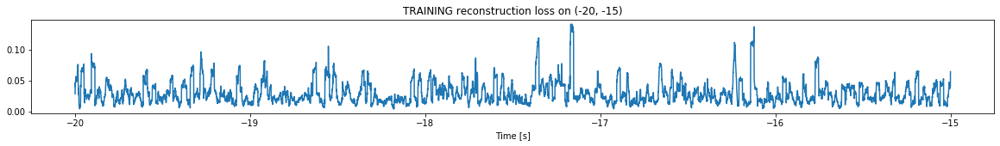

Finished training, median of the log(loss) is:  -1.5905786149559291
Triggering for section:  (-15, -10)
Using this median for triggering: -1.6229026457832283


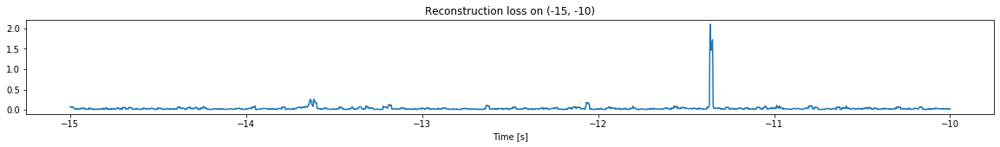

<--------
Entering sections:  (-10, -5)
-------->
Training for section:  (-15, -10)


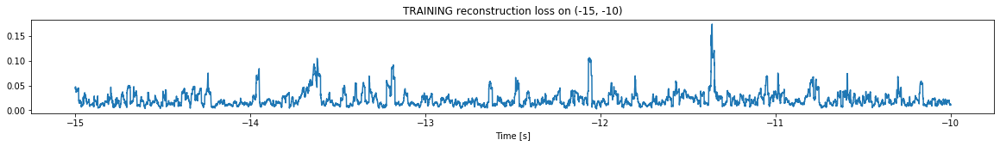

Finished training, median of the log(loss) is:  -1.7485502193425504
Triggering for section:  (-10, -5)
Using this median for triggering: -1.5905786149559291


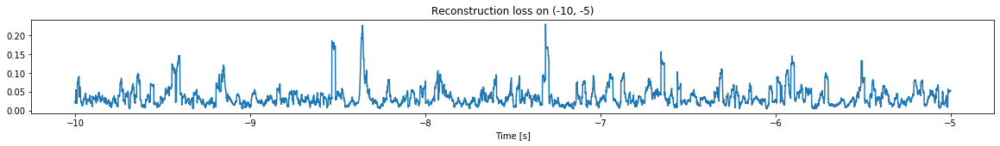

<--------
Entering sections:  (-5, 0)
-------->
Training for section:  (-10, -5)


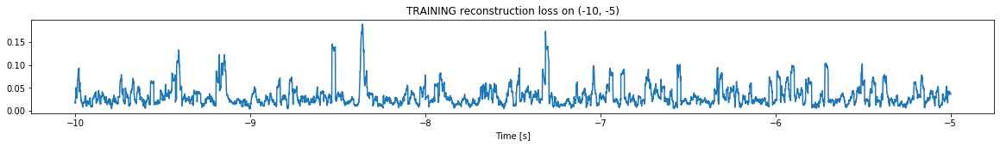

Finished training, median of the log(loss) is:  -1.575689649835343
Triggering for section:  (-5, 0)
Using this median for triggering: -1.7485502193425504


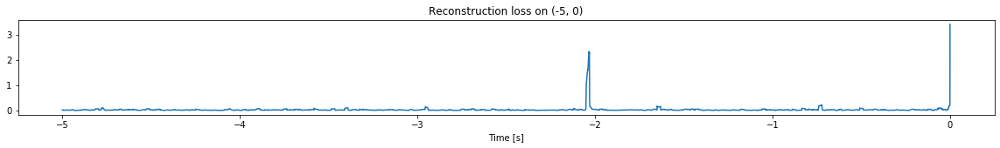

<--------
Finished simulation, all the triggered times are:  []


In [17]:
simulation("./data/Ramp29/", 5, (-100,0))

Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
All data's shape:  (1197500, 12)
Flushing input history
Number of sections: 24
Entering sections:  (-120, -115)
-------->
Entering sections:  (-115, -110)
-------->
Training for section:  (None, -115)


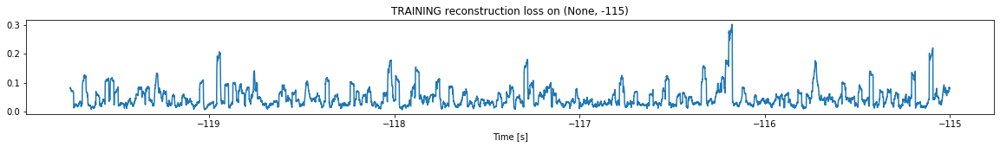

Finished training, median of the log(loss) is:  -1.4114898918141328
<--------
Entering sections:  (-110, -105)
-------->
Training for section:  (-115, -110)


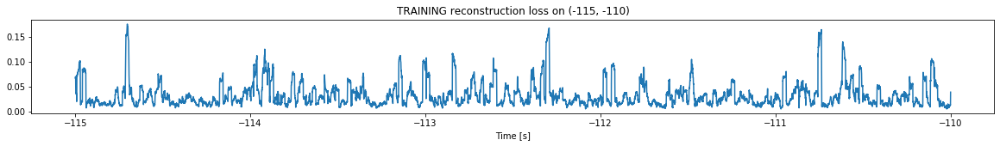

Finished training, median of the log(loss) is:  -1.5968502875358763
Triggering for section:  (-110, -105)
Using this median for triggering: -1.4114898918141328


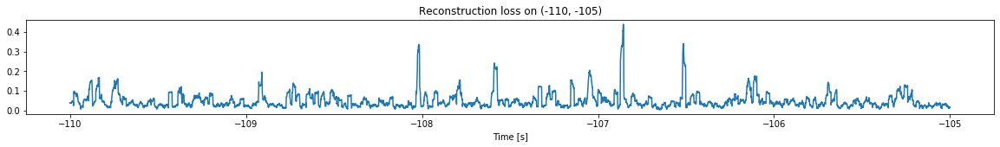

<--------
Entering sections:  (-105, -100)
-------->
Training for section:  (-110, -105)


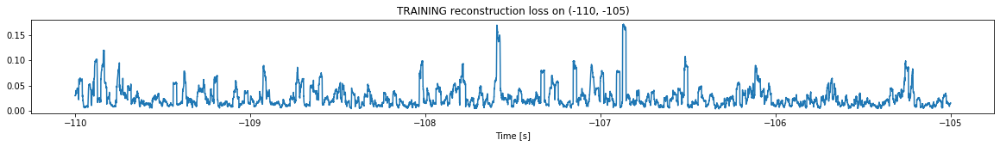

Finished training, median of the log(loss) is:  -1.6949849481593946
Triggering for section:  (-105, -100)
Using this median for triggering: -1.5968502875358763


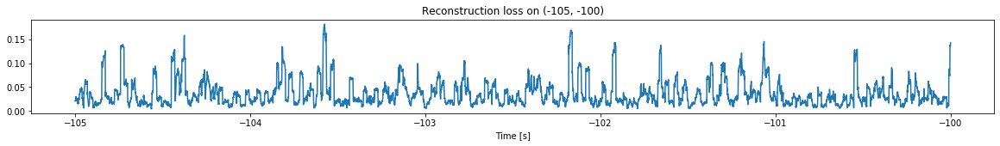

<--------
Entering sections:  (-100, -95)
-------->
Training for section:  (-105, -100)


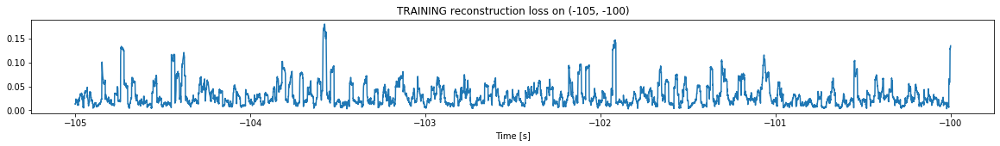

Finished training, median of the log(loss) is:  -1.6211669039181107
Triggering for section:  (-100, -95)
Using this median for triggering: -1.6949849481593946


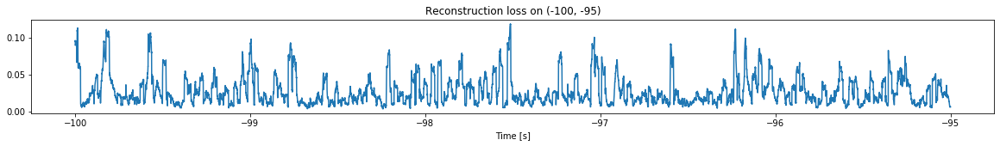

<--------
Entering sections:  (-95, -90)
-------->
Training for section:  (-100, -95)


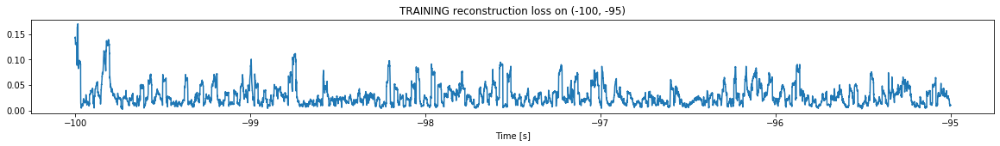

Finished training, median of the log(loss) is:  -1.6234298640513698
Triggering for section:  (-95, -90)
Using this median for triggering: -1.6211669039181107


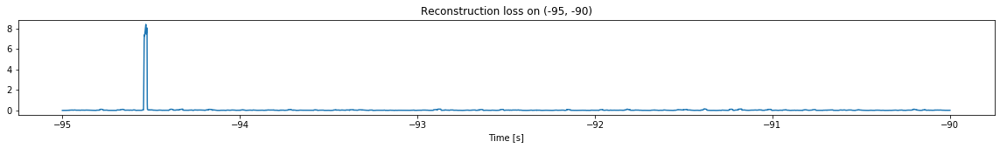

<--------
Entering sections:  (-90, -85)
-------->
Training for section:  (-95, -90)


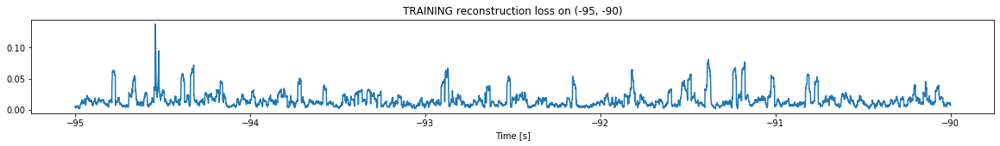

Finished training, median of the log(loss) is:  -1.9023194648372548
Triggering for section:  (-90, -85)
Using this median for triggering: -1.6234298640513698


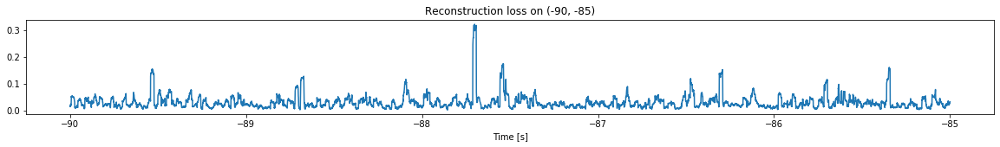

<--------
Entering sections:  (-85, -80)
-------->
Training for section:  (-90, -85)


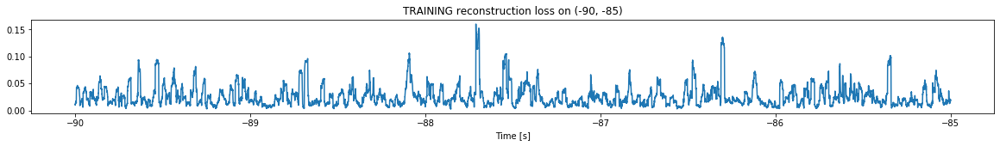

Finished training, median of the log(loss) is:  -1.6722406955927114
Triggering for section:  (-85, -80)
Using this median for triggering: -1.9023194648372548


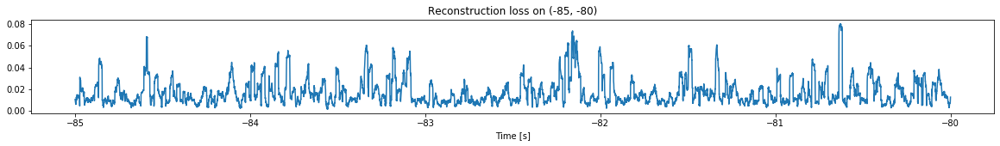

<--------
Entering sections:  (-80, -75)
-------->
Training for section:  (-85, -80)


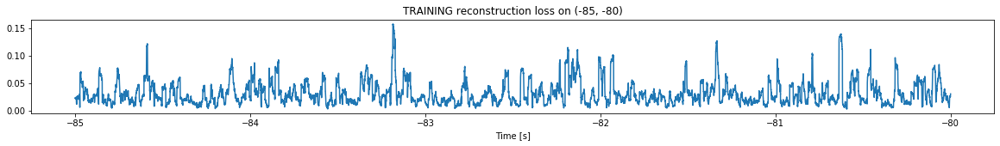

Finished training, median of the log(loss) is:  -1.5738484501664045
Triggering for section:  (-80, -75)
Using this median for triggering: -1.6722406955927114


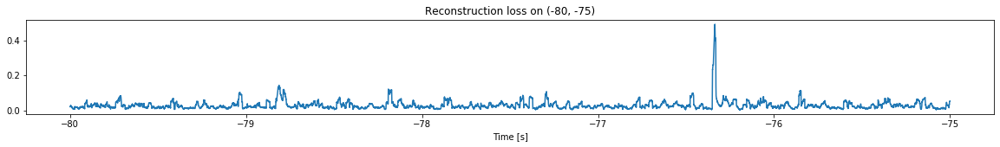

<--------
Entering sections:  (-75, -70)
-------->
Training for section:  (-80, -75)


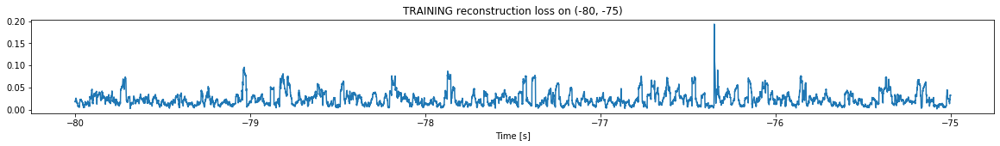

Finished training, median of the log(loss) is:  -1.679081902690099
Triggering for section:  (-75, -70)
Using this median for triggering: -1.5738484501664045


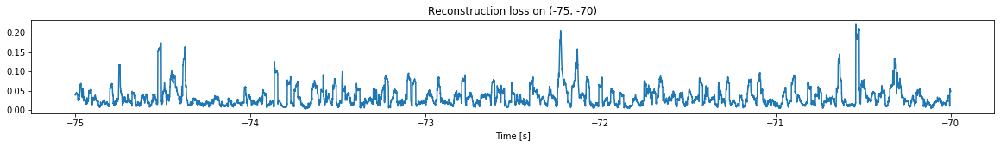

<--------
Entering sections:  (-70, -65)
-------->
Training for section:  (-75, -70)


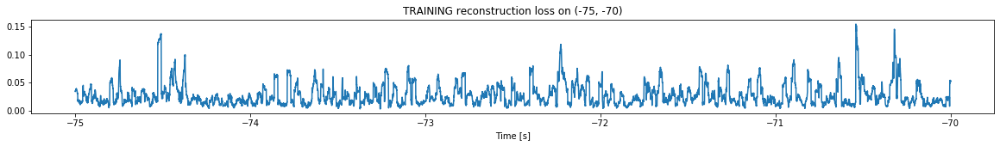

Finished training, median of the log(loss) is:  -1.6565077700986417
Triggering for section:  (-70, -65)
Using this median for triggering: -1.679081902690099


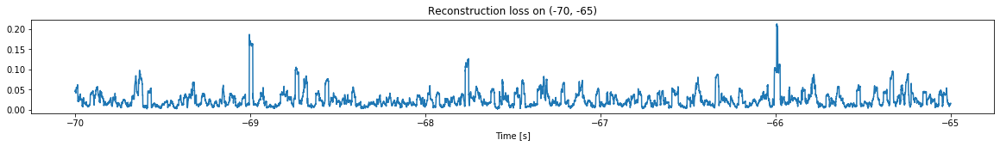

<--------
Entering sections:  (-65, -60)
-------->
Training for section:  (-70, -65)


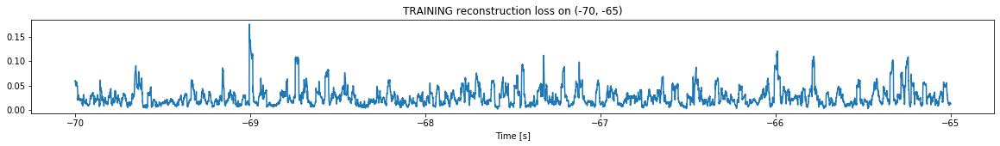

Finished training, median of the log(loss) is:  -1.6579354385959513
Triggering for section:  (-65, -60)
Using this median for triggering: -1.6565077700986417


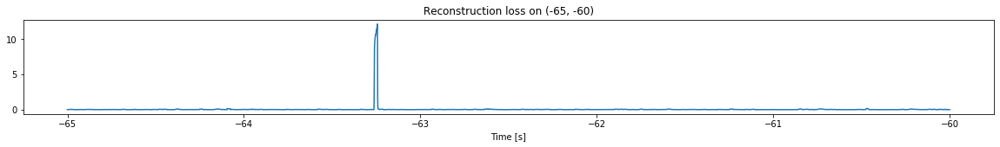

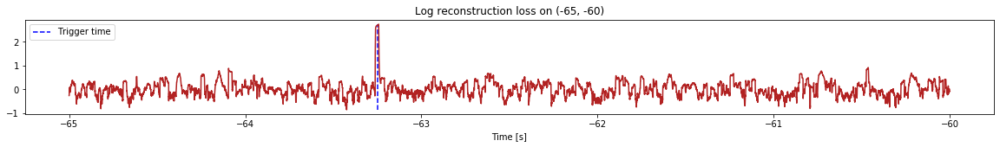

Triggered at:  -63.250298
<--------
Entering sections:  (-60, -55)
-------->
Training for section:  (-65, -60)


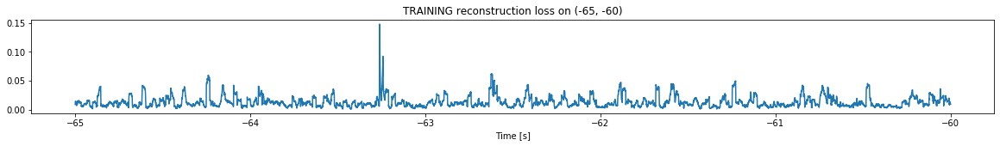

Finished training, median of the log(loss) is:  -1.96151383482787
Triggering for section:  (-60, -55)
Using this median for triggering: -1.6579354385959513


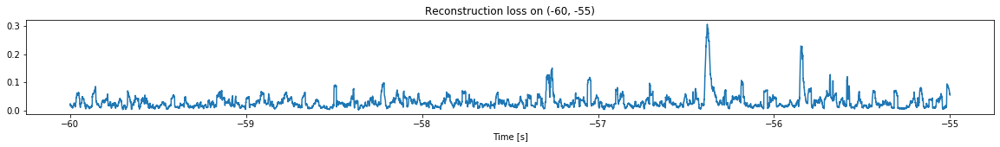

<--------
Entering sections:  (-55, -50)
-------->
Training for section:  (-60, -55)


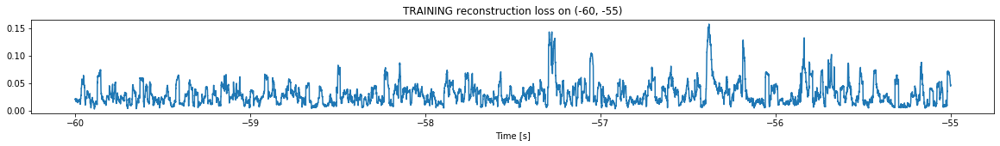

Finished training, median of the log(loss) is:  -1.5968708254871533
Triggering for section:  (-55, -50)
Using this median for triggering: -1.96151383482787


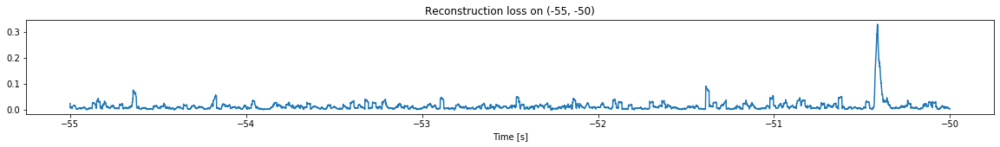

<--------
Entering sections:  (-50, -45)
-------->
Training for section:  (-55, -50)


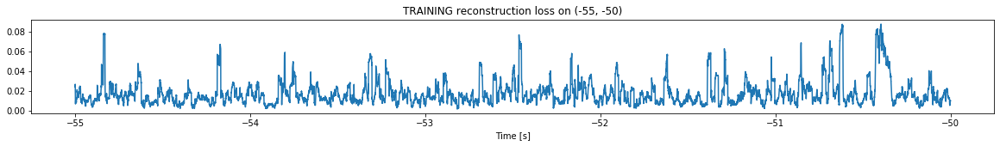

Finished training, median of the log(loss) is:  -1.8272191770435473
Triggering for section:  (-50, -45)
Using this median for triggering: -1.5968708254871533


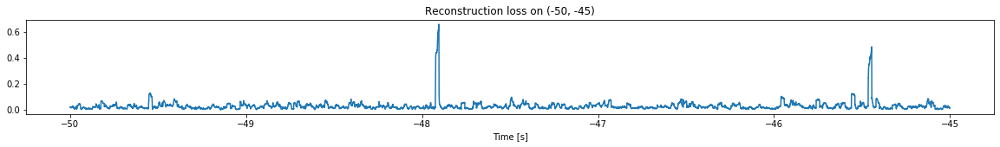

<--------
Entering sections:  (-45, -40)
-------->
Training for section:  (-50, -45)


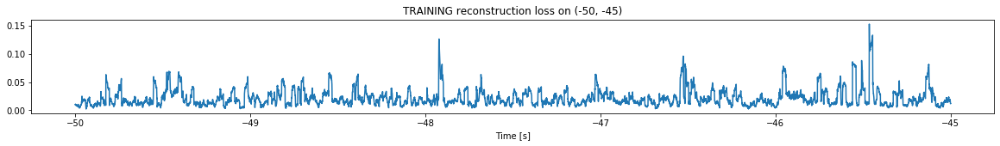

Finished training, median of the log(loss) is:  -1.7489297241688964
Triggering for section:  (-45, -40)
Using this median for triggering: -1.8272191770435473


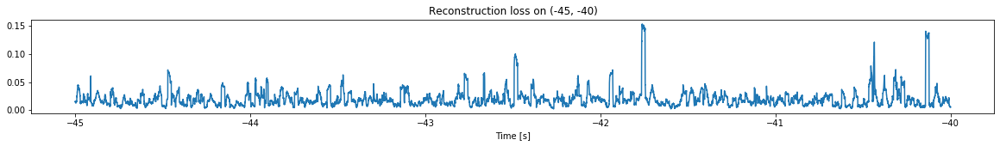

<--------
Entering sections:  (-40, -35)
-------->
Training for section:  (-45, -40)


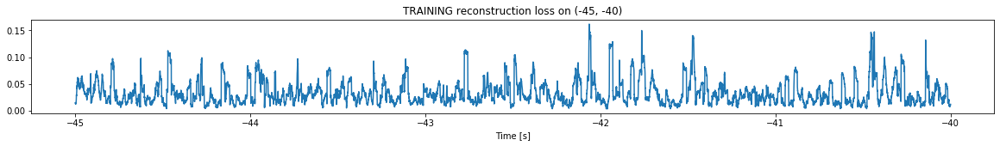

Finished training, median of the log(loss) is:  -1.558639278813255
Triggering for section:  (-40, -35)
Using this median for triggering: -1.7489297241688964


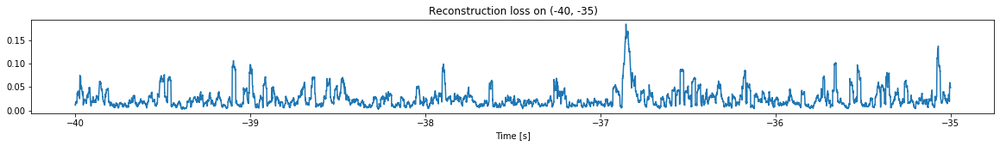

<--------
Entering sections:  (-35, -30)
-------->
Training for section:  (-40, -35)


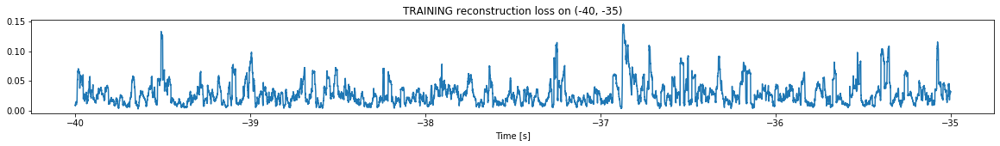

Finished training, median of the log(loss) is:  -1.6170443434189146
Triggering for section:  (-35, -30)
Using this median for triggering: -1.558639278813255


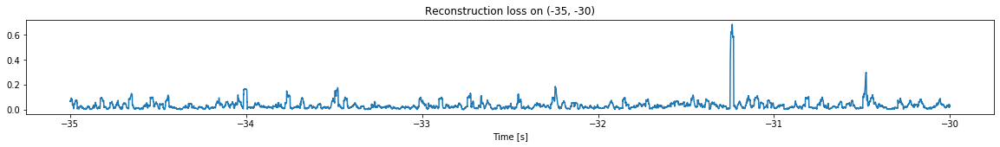

<--------
Entering sections:  (-30, -25)
-------->
Training for section:  (-35, -30)


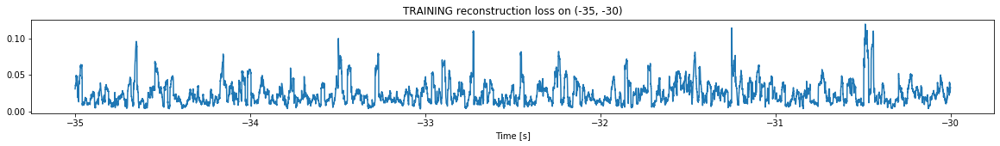

Finished training, median of the log(loss) is:  -1.6917179181122832
Triggering for section:  (-30, -25)
Using this median for triggering: -1.6170443434189146


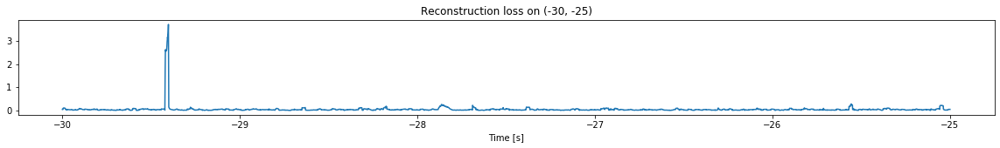

<--------
Entering sections:  (-25, -20)
-------->
Training for section:  (-30, -25)


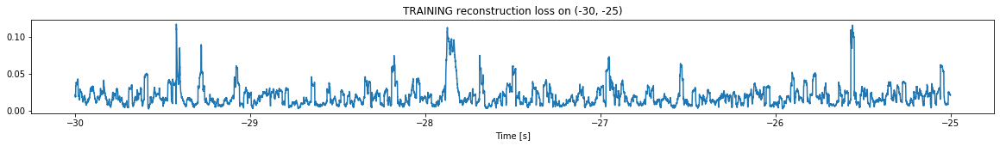

Finished training, median of the log(loss) is:  -1.7876045072526114
Triggering for section:  (-25, -20)
Using this median for triggering: -1.6917179181122832


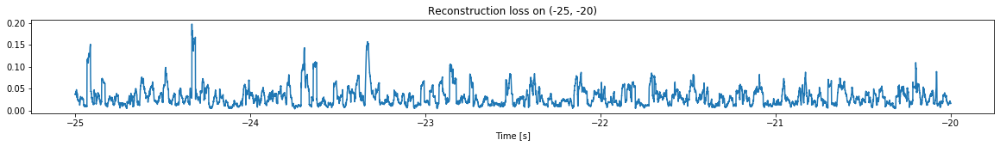

<--------
Entering sections:  (-20, -15)
-------->
Training for section:  (-25, -20)


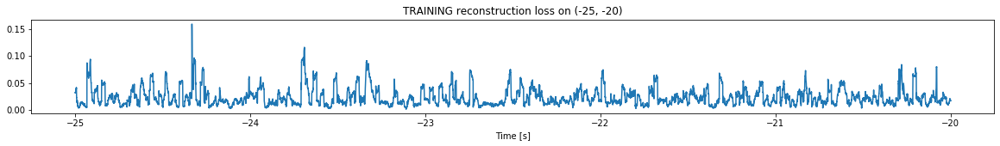

Finished training, median of the log(loss) is:  -1.7059830588572387
Triggering for section:  (-20, -15)
Using this median for triggering: -1.7876045072526114


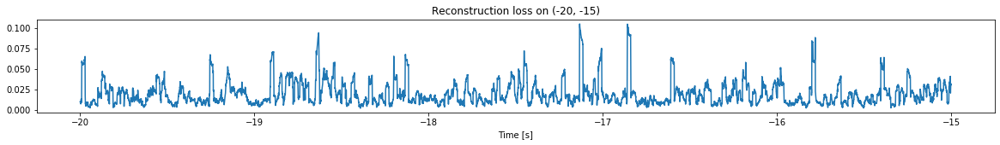

<--------
Entering sections:  (-15, -10)
-------->
Training for section:  (-20, -15)


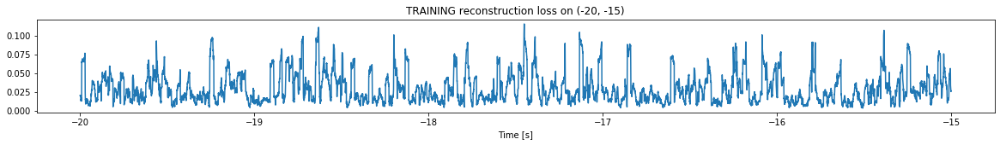

Finished training, median of the log(loss) is:  -1.6079005942282407
Triggering for section:  (-15, -10)
Using this median for triggering: -1.7059830588572387


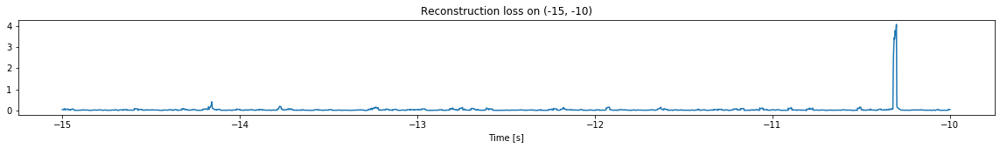

<--------
Entering sections:  (-10, -5)
-------->
Training for section:  (-15, -10)


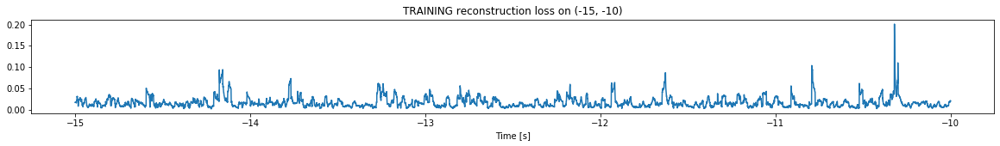

Finished training, median of the log(loss) is:  -1.8672046654685244
Triggering for section:  (-10, -5)
Using this median for triggering: -1.6079005942282407


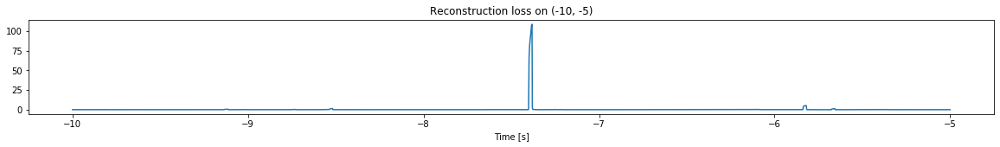

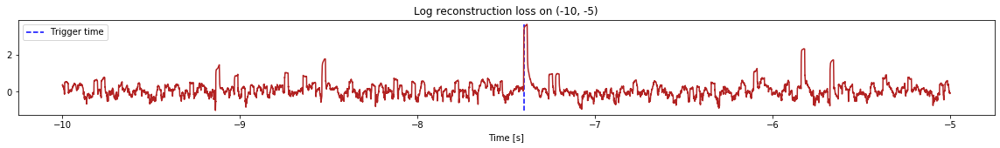

Triggered at:  -7.4009
<--------
Entering sections:  (-5, 0)
-------->
Training for section:  (-10, -5)


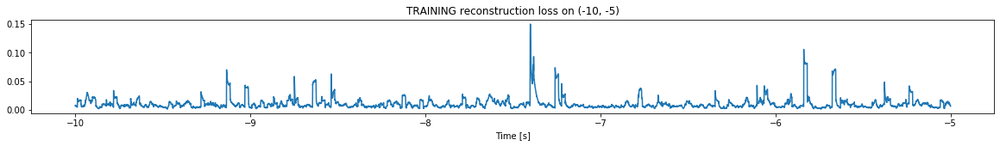

Finished training, median of the log(loss) is:  -2.104507551798248
Triggering for section:  (-5, 0)
Using this median for triggering: -1.8672046654685244


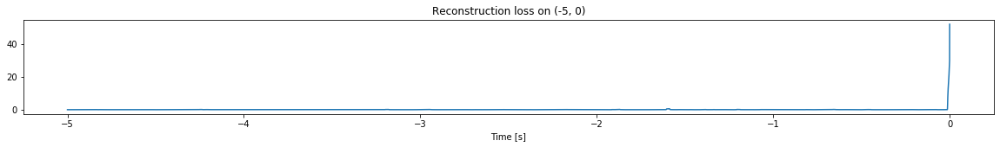

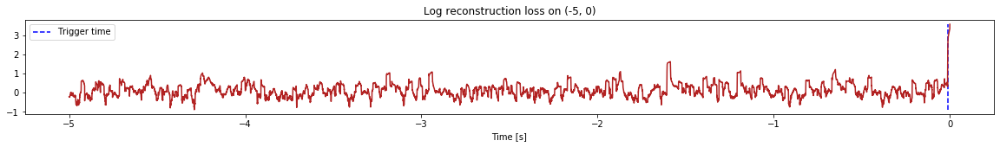

Triggered at:  -0.0109
<--------
Finished simulation, all the triggered times are:  [-63.250298, -7.4009, -0.0109]


In [18]:
simulation("./data/Ramp30/", 5, (-120,0))

## 3. Start training when reached 9/10 of previous current. 10 second section

Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
All data's shape:  (897500, 12)
Flushing input history
Number of sections: 9
Entering sections:  (-90, -80)
-------->
Entering sections:  (-80, -70)
-------->
Training for section:  (None, -80)


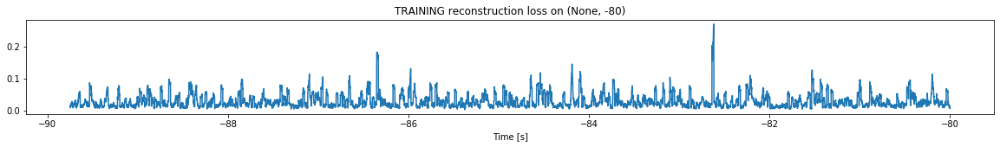

Finished training, median of the log(loss) is:  -1.6484499998435482
<--------
Entering sections:  (-70, -60)
-------->
Training for section:  (-80, -70)


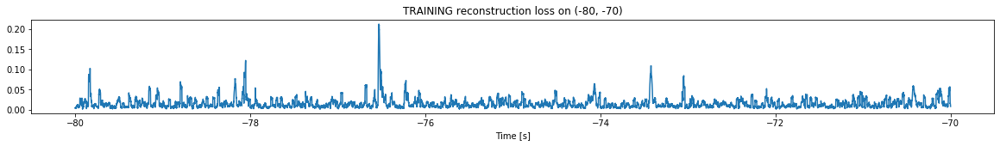

Finished training, median of the log(loss) is:  -1.9027465874999199
Triggering for section:  (-70, -60)
Using this median for triggering: -1.6484499998435482


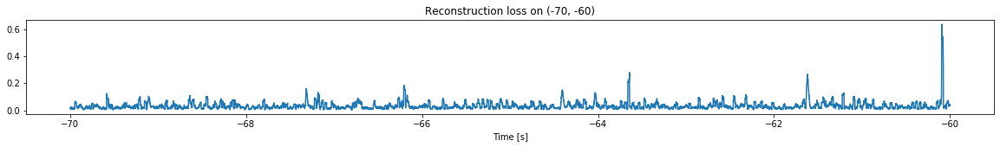

<--------
Entering sections:  (-60, -50)
-------->
Training for section:  (-70, -60)


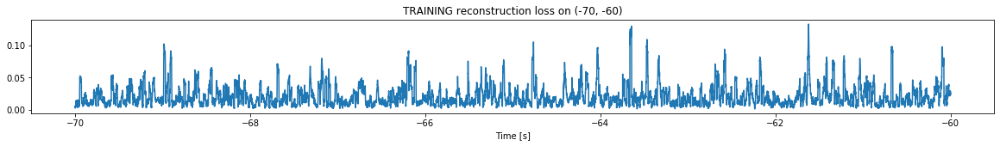

Finished training, median of the log(loss) is:  -1.77328929394075
Triggering for section:  (-60, -50)
Using this median for triggering: -1.9027465874999199


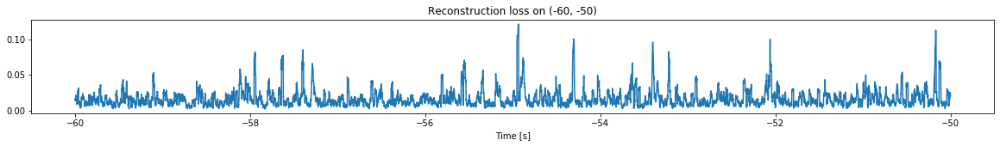

<--------
Entering sections:  (-50, -40)
-------->
Training for section:  (-60, -50)


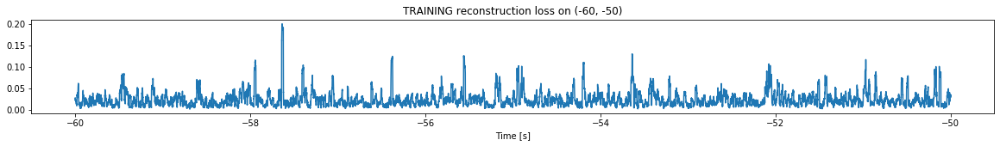

Finished training, median of the log(loss) is:  -1.7135823716401757
Triggering for section:  (-50, -40)
Using this median for triggering: -1.77328929394075


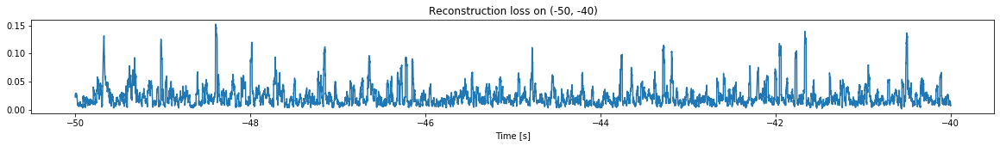

<--------
Entering sections:  (-40, -30)
-------->
Training for section:  (-50, -40)


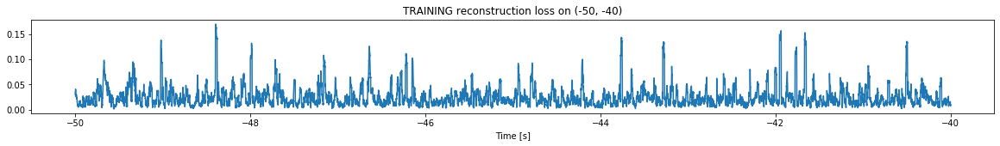

Finished training, median of the log(loss) is:  -1.6993964181913768
Triggering for section:  (-40, -30)
Using this median for triggering: -1.7135823716401757


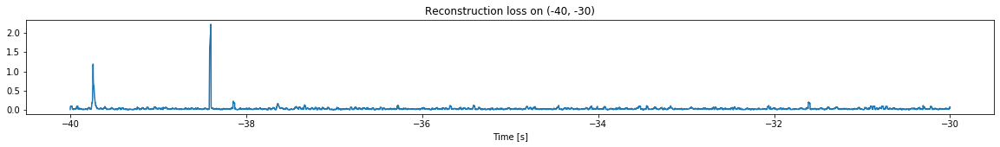

<--------
Entering sections:  (-30, -20)
-------->
Training for section:  (-40, -30)


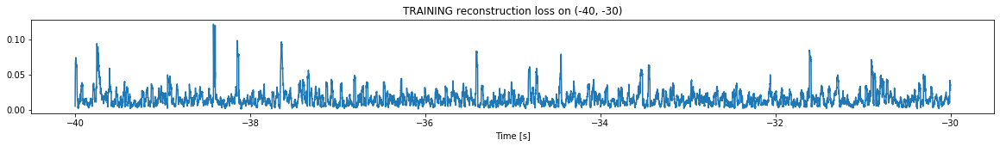

Finished training, median of the log(loss) is:  -1.877949626854642
Triggering for section:  (-30, -20)
Using this median for triggering: -1.6993964181913768


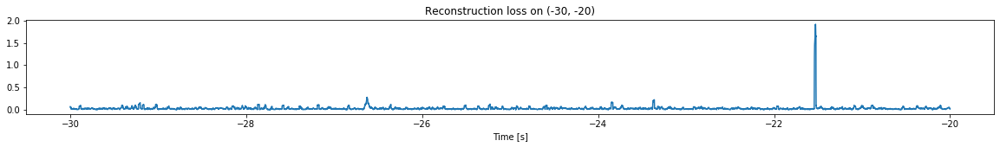

<--------
Entering sections:  (-20, -10)
-------->
Training for section:  (-30, -20)


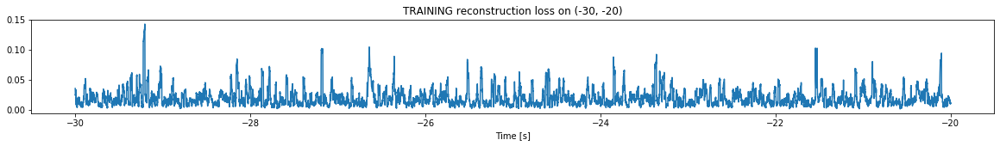

Finished training, median of the log(loss) is:  -1.7868355072360909
Triggering for section:  (-20, -10)
Using this median for triggering: -1.877949626854642


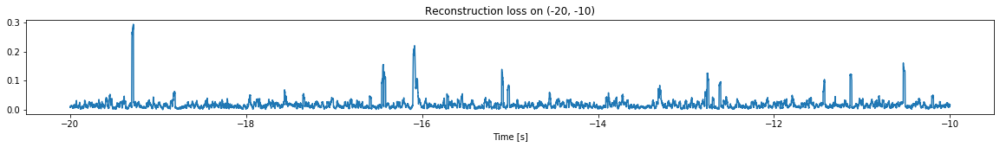

<--------
Entering sections:  (-10, 0)
-------->
Training for section:  (-20, -10)


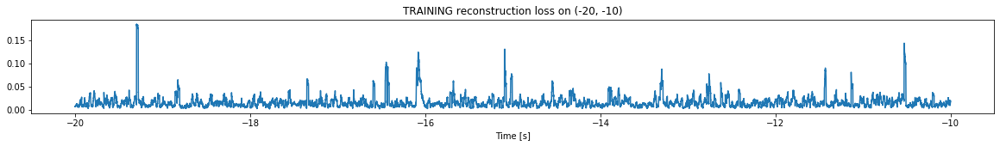

Finished training, median of the log(loss) is:  -1.8803231151610085
Triggering for section:  (-10, 0)
Using this median for triggering: -1.7868355072360909


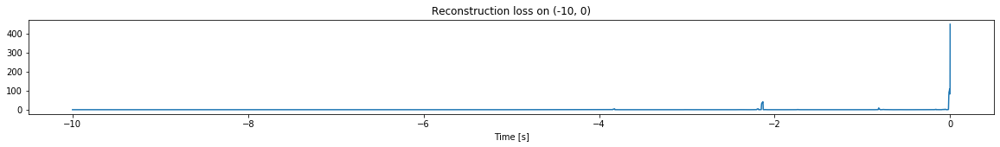

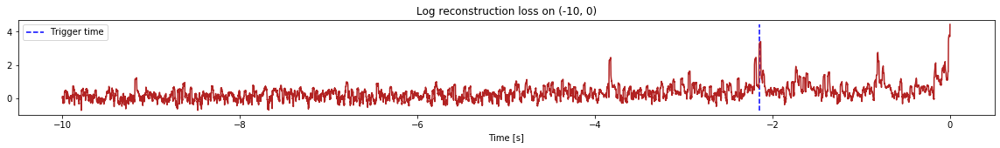

Triggered at:  -2.1512
<--------
Finished simulation, all the triggered times are:  [-2.1512]


In [3]:
simulation("./data/Ramp4/", 10, (-90,0))

Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
All data's shape:  (897500, 12)
Flushing input history
Number of sections: 9
Entering sections:  (-90, -80)
-------->
Entering sections:  (-80, -70)
-------->
Training for section:  (None, -80)


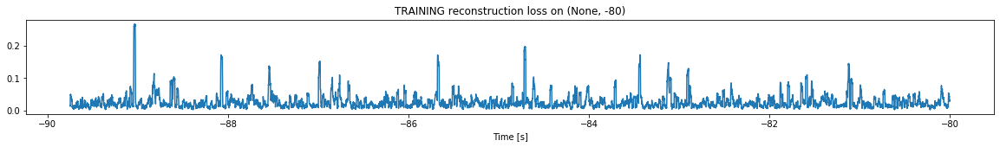

Finished training, median of the log(loss) is:  -1.6865356989198312
<--------
Entering sections:  (-70, -60)
-------->
Training for section:  (-80, -70)


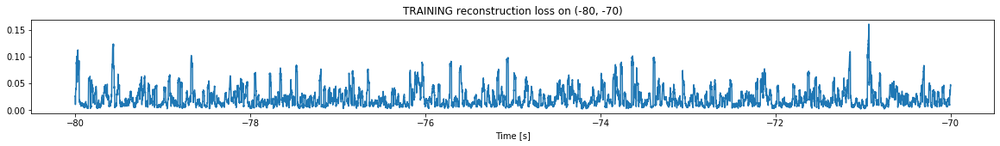

Finished training, median of the log(loss) is:  -1.7494053721887584
Triggering for section:  (-70, -60)
Using this median for triggering: -1.6865356989198312


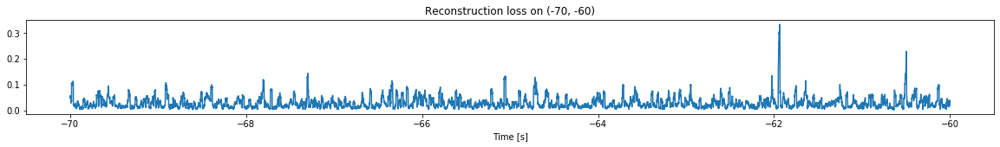

<--------
Entering sections:  (-60, -50)
-------->
Training for section:  (-70, -60)


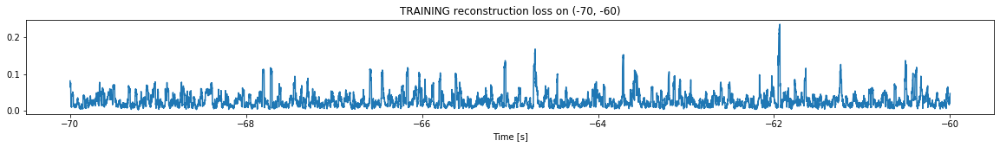

Finished training, median of the log(loss) is:  -1.6475531452243732
Triggering for section:  (-60, -50)
Using this median for triggering: -1.7494053721887584


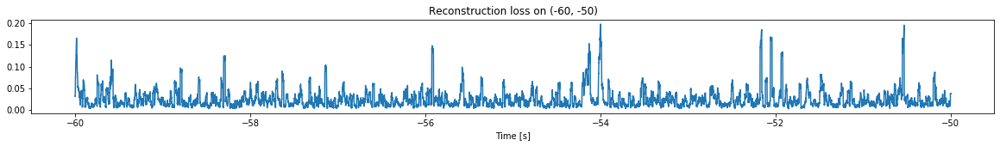

<--------
Entering sections:  (-50, -40)
-------->
Training for section:  (-60, -50)


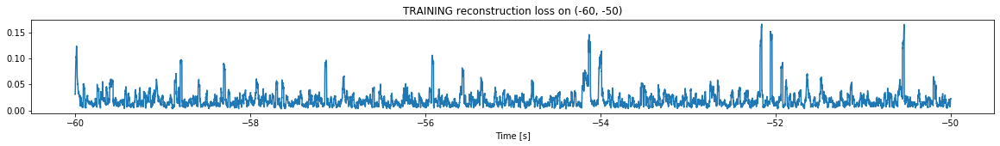

Finished training, median of the log(loss) is:  -1.7953509103164862
Triggering for section:  (-50, -40)
Using this median for triggering: -1.6475531452243732


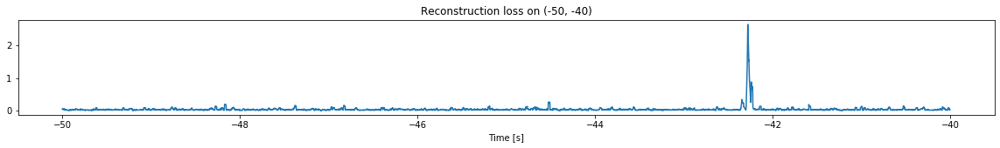

<--------
Entering sections:  (-40, -30)
-------->
Training for section:  (-50, -40)


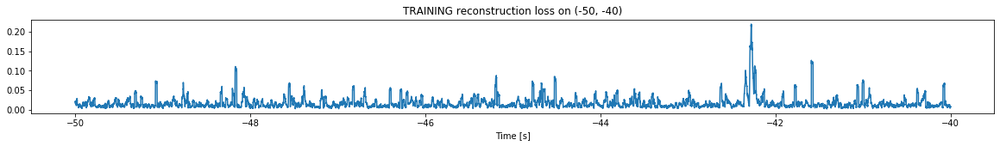

Finished training, median of the log(loss) is:  -1.897050516257205
Triggering for section:  (-40, -30)
Using this median for triggering: -1.7953509103164862


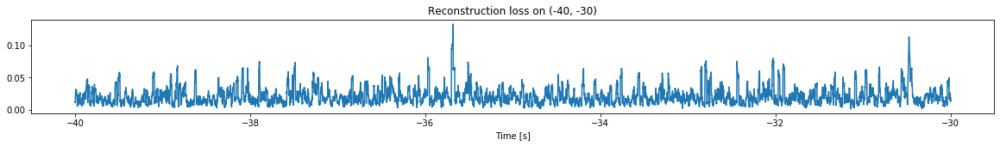

<--------
Entering sections:  (-30, -20)
-------->
Training for section:  (-40, -30)


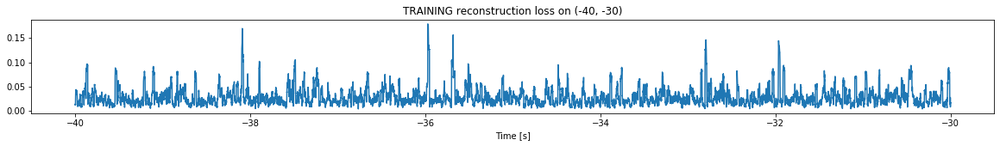

Finished training, median of the log(loss) is:  -1.6255280247531214
Triggering for section:  (-30, -20)
Using this median for triggering: -1.897050516257205


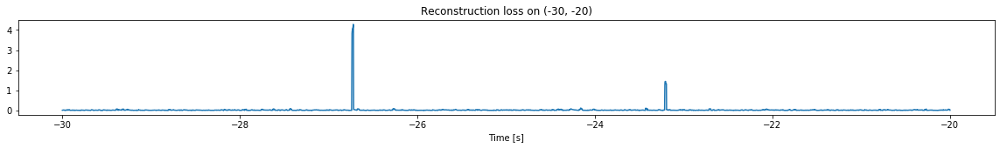

<--------
Entering sections:  (-20, -10)
-------->
Training for section:  (-30, -20)


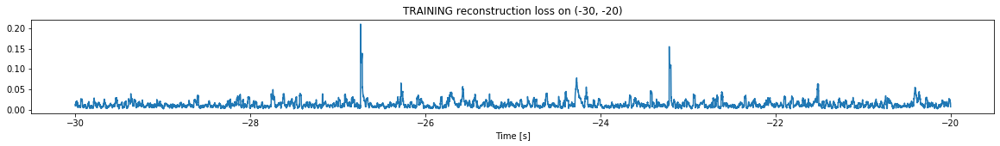

Finished training, median of the log(loss) is:  -1.95691141419401
Triggering for section:  (-20, -10)
Using this median for triggering: -1.6255280247531214


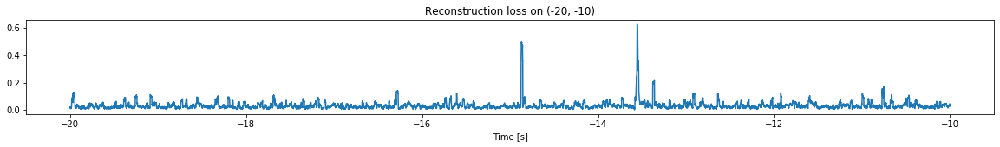

<--------
Entering sections:  (-10, 0)
-------->
Training for section:  (-20, -10)


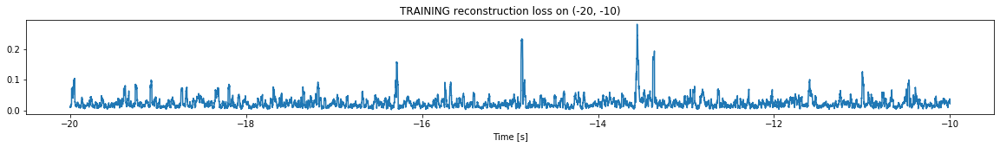

Finished training, median of the log(loss) is:  -1.6954653367347725
Triggering for section:  (-10, 0)
Using this median for triggering: -1.95691141419401


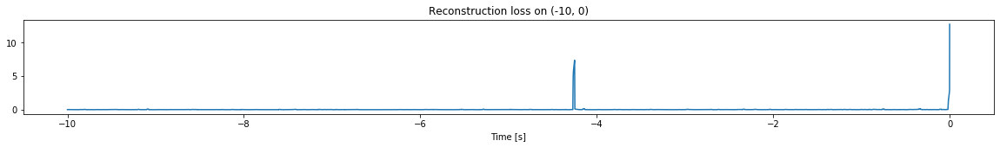

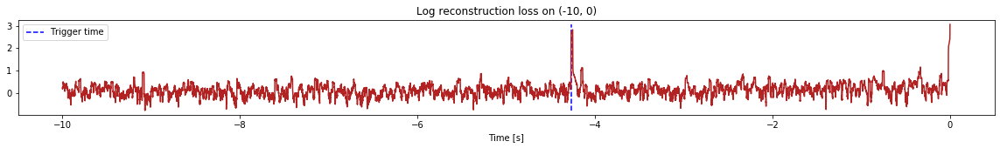

Triggered at:  -4.2655997
<--------
Finished simulation, all the triggered times are:  [-4.2655997]


In [4]:
simulation("./data/Ramp5/", 10, (-90,0))

Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
All data's shape:  (997500, 12)
Flushing input history
Number of sections: 10
Entering sections:  (-100, -90)
-------->
Entering sections:  (-90, -80)
-------->
Training for section:  (None, -90)


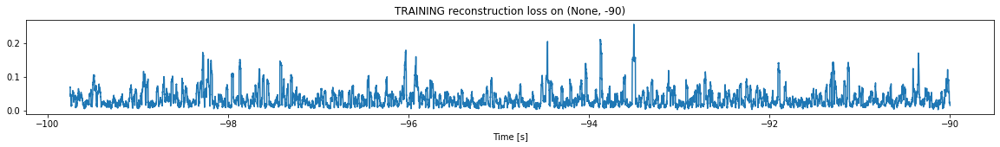

Finished training, median of the log(loss) is:  -1.5385824461595854
<--------
Entering sections:  (-80, -70)
-------->
Training for section:  (-90, -80)


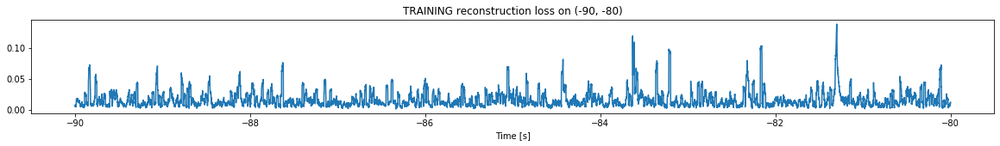

Finished training, median of the log(loss) is:  -1.875729441929081
Triggering for section:  (-80, -70)
Using this median for triggering: -1.5385824461595854


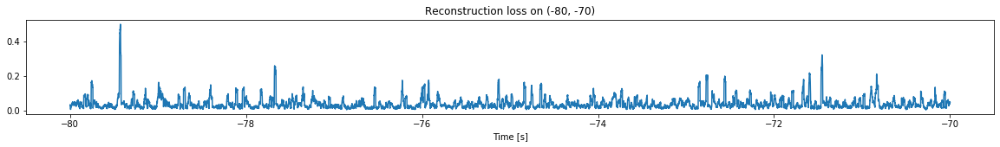

<--------
Entering sections:  (-70, -60)
-------->
Training for section:  (-80, -70)


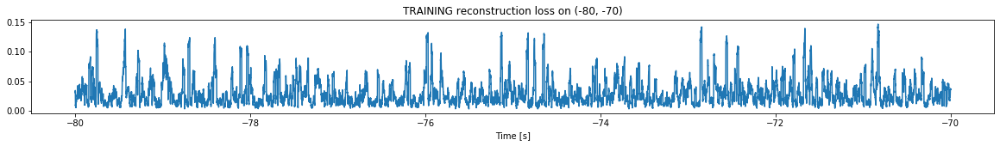

Finished training, median of the log(loss) is:  -1.6315345437684687
Triggering for section:  (-70, -60)
Using this median for triggering: -1.875729441929081


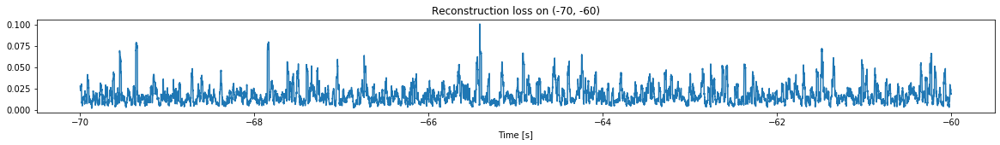

<--------
Entering sections:  (-60, -50)
-------->
Training for section:  (-70, -60)


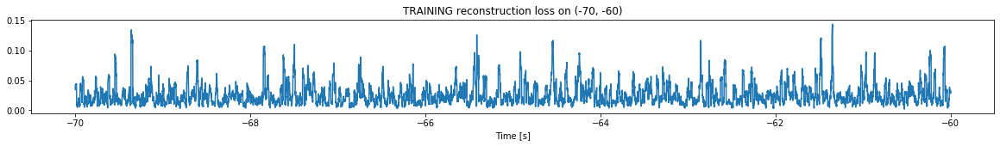

Finished training, median of the log(loss) is:  -1.6722297683185319
Triggering for section:  (-60, -50)
Using this median for triggering: -1.6315345437684687


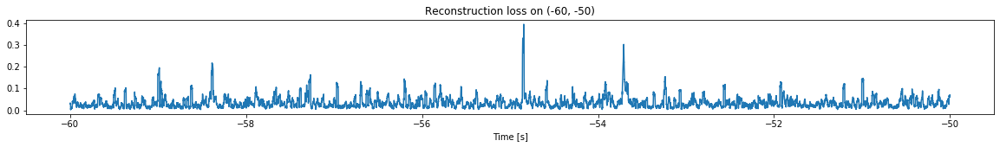

<--------
Entering sections:  (-50, -40)
-------->
Training for section:  (-60, -50)


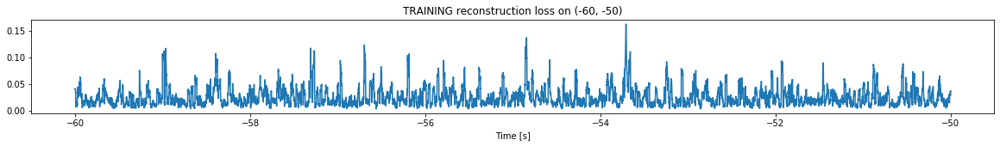

Finished training, median of the log(loss) is:  -1.6867690658690604
Triggering for section:  (-50, -40)
Using this median for triggering: -1.6722297683185319


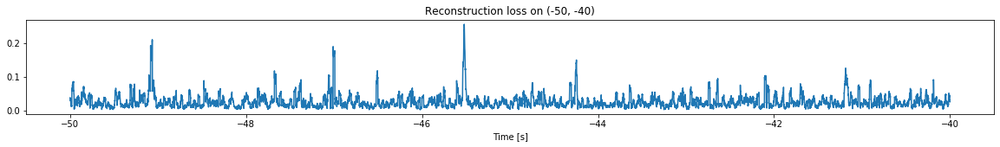

<--------
Entering sections:  (-40, -30)
-------->
Training for section:  (-50, -40)


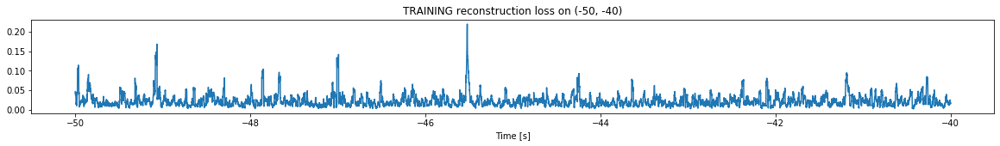

Finished training, median of the log(loss) is:  -1.704168359379022
Triggering for section:  (-40, -30)
Using this median for triggering: -1.6867690658690604


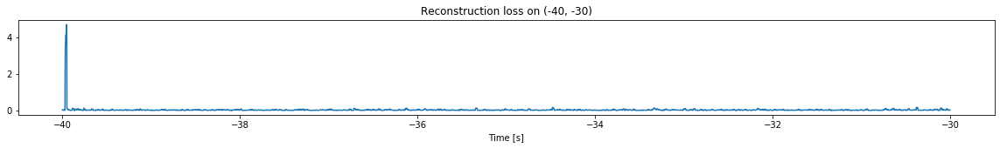

<--------
Entering sections:  (-30, -20)
-------->
Training for section:  (-40, -30)


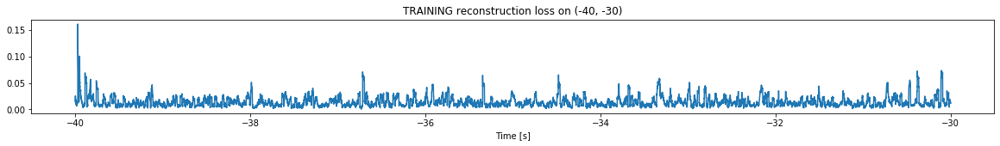

Finished training, median of the log(loss) is:  -1.9363386632326707
Triggering for section:  (-30, -20)
Using this median for triggering: -1.704168359379022


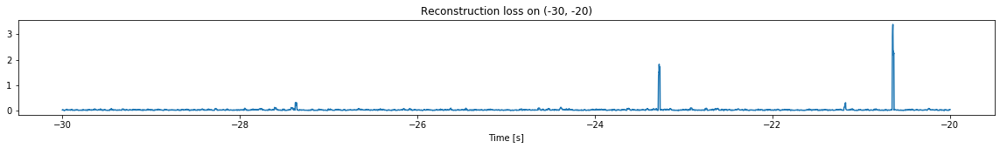

<--------
Entering sections:  (-20, -10)
-------->
Training for section:  (-30, -20)


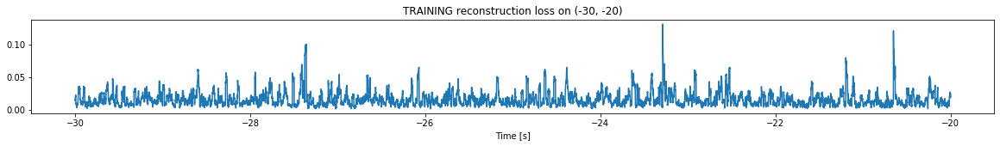

Finished training, median of the log(loss) is:  -1.8553379316431822
Triggering for section:  (-20, -10)
Using this median for triggering: -1.9363386632326707


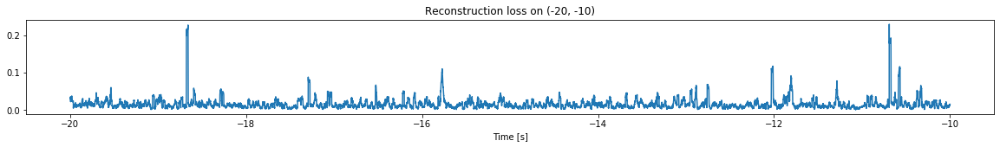

<--------
Entering sections:  (-10, 0)
-------->
Training for section:  (-20, -10)


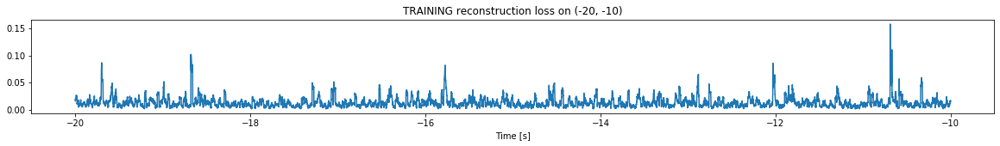

Finished training, median of the log(loss) is:  -1.9556359428462207
Triggering for section:  (-10, 0)
Using this median for triggering: -1.8553379316431822


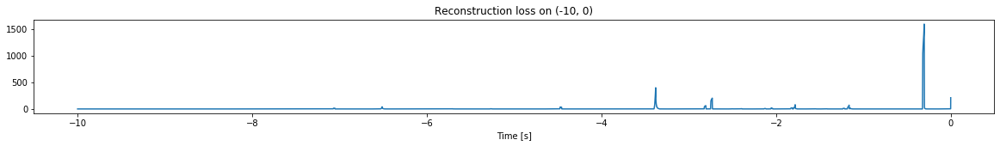

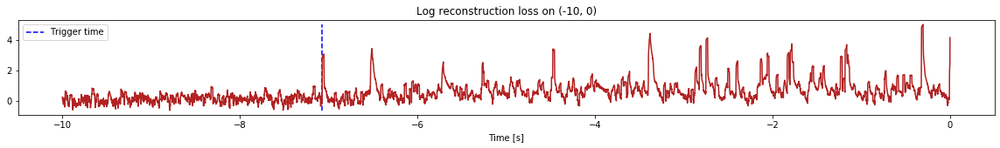

Triggered at:  -7.0716
<--------
Finished simulation, all the triggered times are:  [-7.0716]


In [5]:
simulation("./data/Ramp12d/", 10, (-100,0))

Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
All data's shape:  (2997500, 12)
Flushing input history
Number of sections: 30
Entering sections:  (-300, -290)
-------->
Entering sections:  (-290, -280)
-------->
Training for section:  (None, -290)


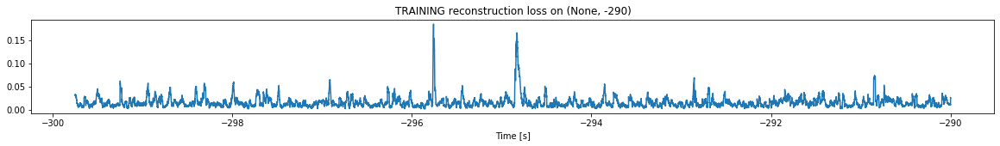

Finished training, median of the log(loss) is:  -1.8733951235447406
<--------
Entering sections:  (-280, -270)
-------->
Training for section:  (-290, -280)


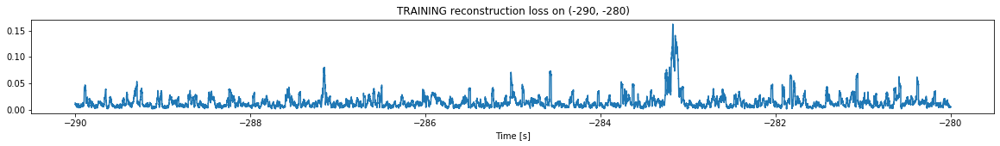

Finished training, median of the log(loss) is:  -1.9524168978310856
Triggering for section:  (-280, -270)
Using this median for triggering: -1.8733951235447406


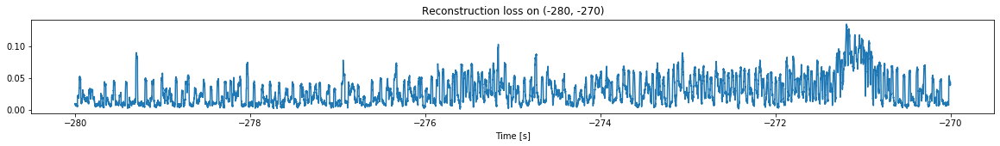

<--------
Entering sections:  (-270, -260)
-------->
Training for section:  (-280, -270)


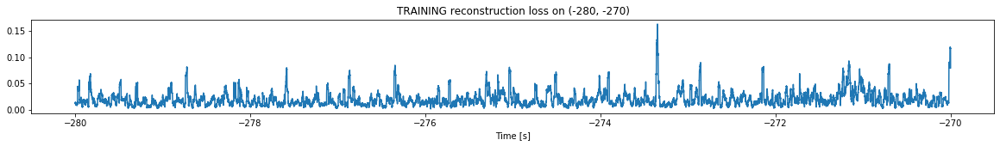

Finished training, median of the log(loss) is:  -1.7879676063001833
Triggering for section:  (-270, -260)
Using this median for triggering: -1.9524168978310856


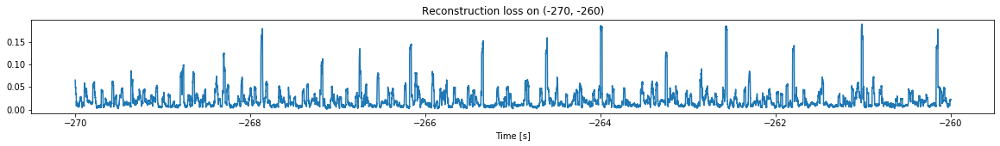

<--------
Entering sections:  (-260, -250)
-------->
Training for section:  (-270, -260)


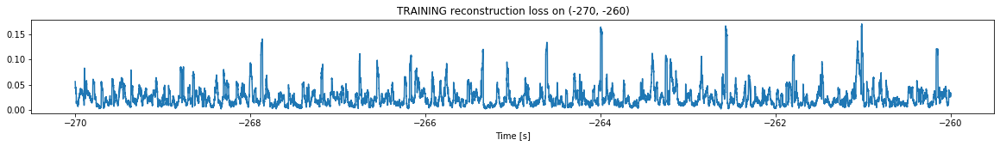

Finished training, median of the log(loss) is:  -1.6989240285488636
Triggering for section:  (-260, -250)
Using this median for triggering: -1.7879676063001833


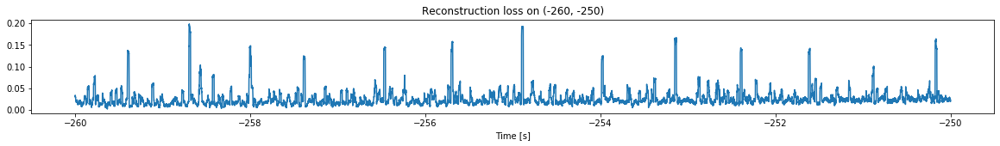

<--------
Entering sections:  (-250, -240)
-------->
Training for section:  (-260, -250)


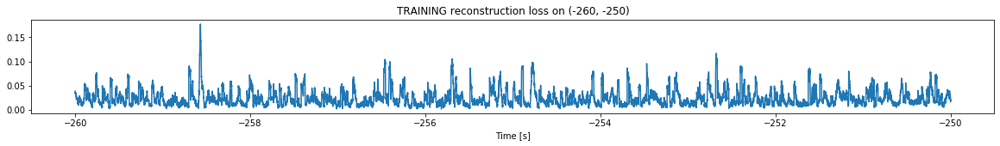

Finished training, median of the log(loss) is:  -1.694825129857786
Triggering for section:  (-250, -240)
Using this median for triggering: -1.6989240285488636


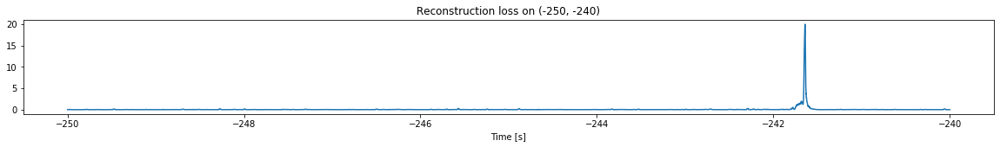

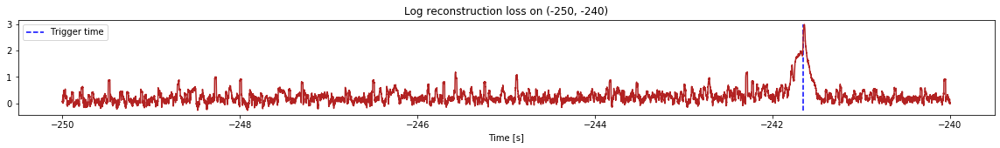

Triggered at:  -241.65187
<--------
Entering sections:  (-240, -230)
-------->
Training for section:  (-250, -240)


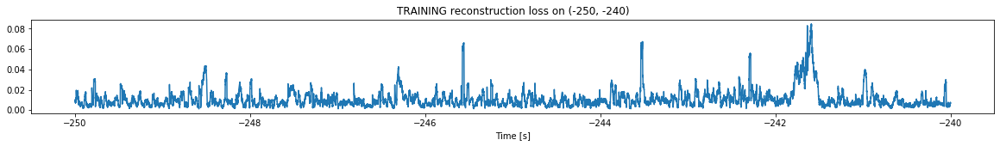

Finished training, median of the log(loss) is:  -2.0673147217393666
Triggering for section:  (-240, -230)
Using this median for triggering: -1.694825129857786


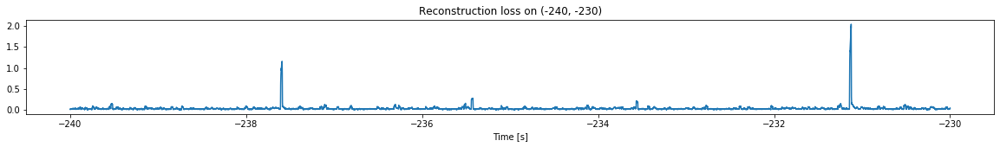

<--------
Entering sections:  (-230, -220)
-------->
Training for section:  (-240, -230)


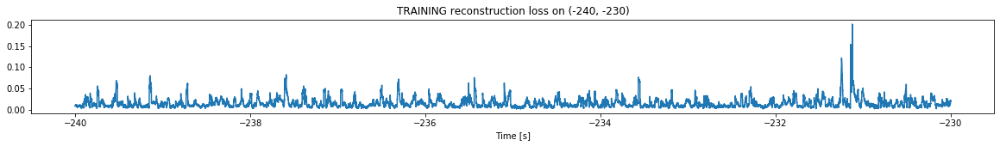

Finished training, median of the log(loss) is:  -1.9265327602169724
Triggering for section:  (-230, -220)
Using this median for triggering: -2.0673147217393666


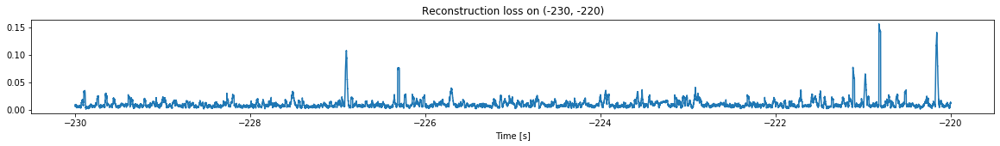

<--------
Entering sections:  (-220, -210)
-------->
Training for section:  (-230, -220)


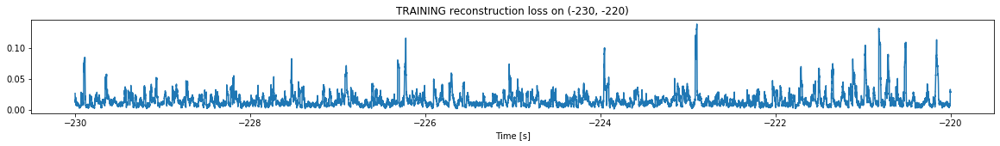

Finished training, median of the log(loss) is:  -1.9291174930999617
Triggering for section:  (-220, -210)
Using this median for triggering: -1.9265327602169724


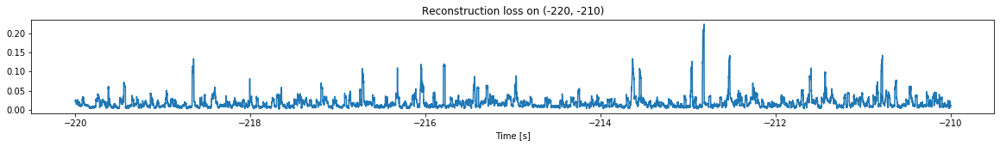

<--------
Entering sections:  (-210, -200)
-------->
Training for section:  (-220, -210)


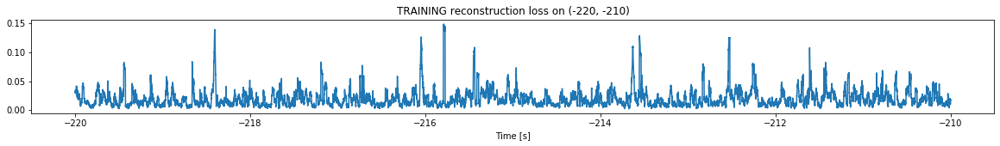

Finished training, median of the log(loss) is:  -1.7938586561585097
Triggering for section:  (-210, -200)
Using this median for triggering: -1.9291174930999617


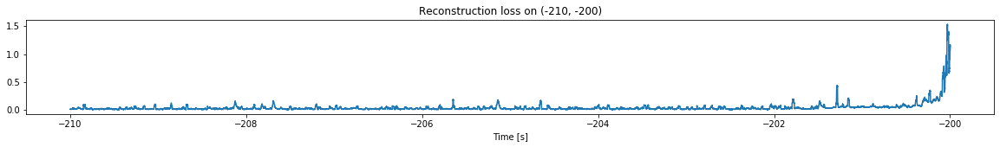

<--------
Entering sections:  (-200, -190)
-------->
Training for section:  (-210, -200)


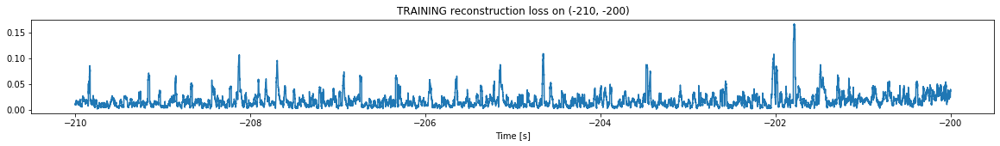

Finished training, median of the log(loss) is:  -1.830926543008471
Triggering for section:  (-200, -190)
Using this median for triggering: -1.7938586561585097


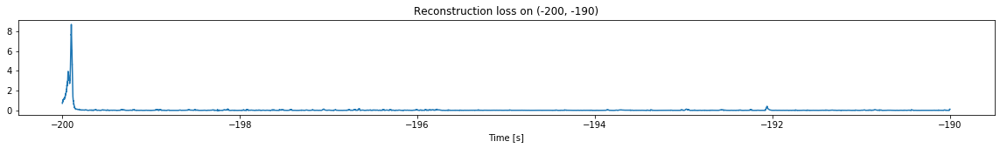

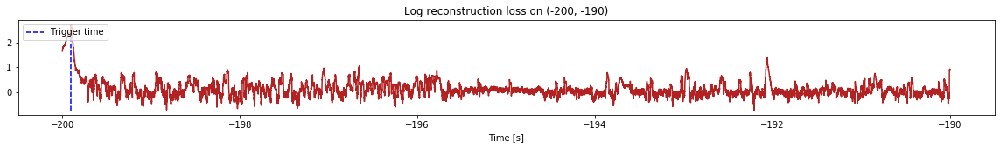

Triggered at:  -199.90079
<--------
Entering sections:  (-190, -180)
-------->
Training for section:  (-200, -190)


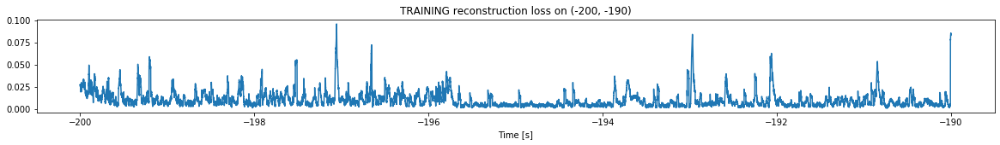

Finished training, median of the log(loss) is:  -2.126973247377103
Triggering for section:  (-190, -180)
Using this median for triggering: -1.830926543008471


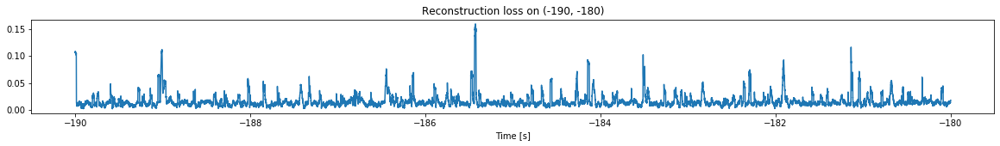

<--------
Entering sections:  (-180, -170)
-------->
Training for section:  (-190, -180)


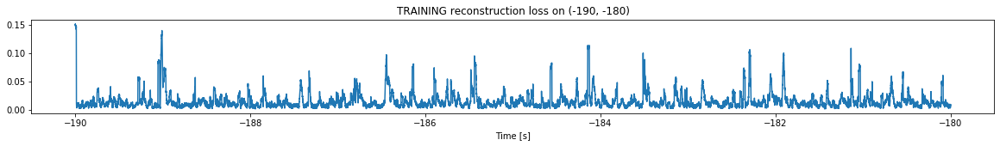

Finished training, median of the log(loss) is:  -1.9559658595312193
Triggering for section:  (-180, -170)
Using this median for triggering: -2.126973247377103


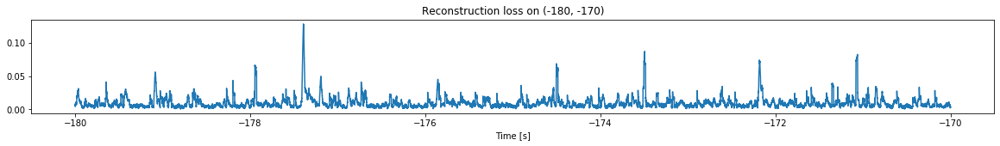

<--------
Entering sections:  (-170, -160)
-------->
Training for section:  (-180, -170)


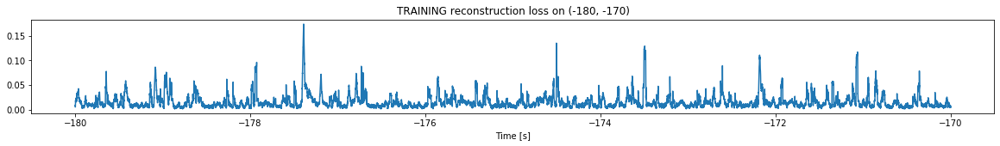

Finished training, median of the log(loss) is:  -1.9222735713578314
Triggering for section:  (-170, -160)
Using this median for triggering: -1.9559658595312193


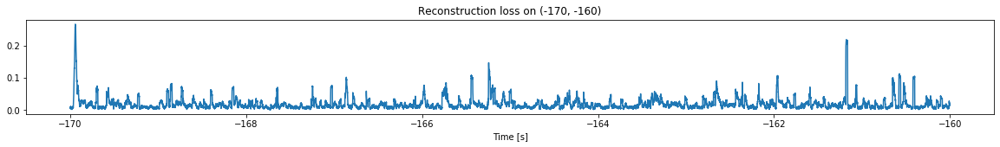

<--------
Entering sections:  (-160, -150)
-------->
Training for section:  (-170, -160)


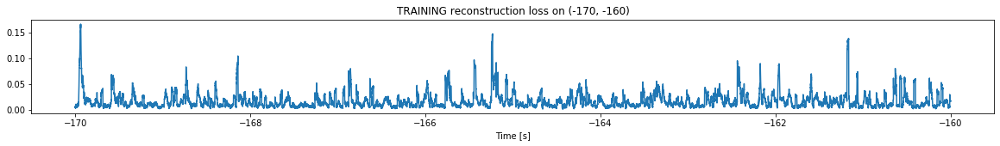

Finished training, median of the log(loss) is:  -1.90201190509315
Triggering for section:  (-160, -150)
Using this median for triggering: -1.9222735713578314


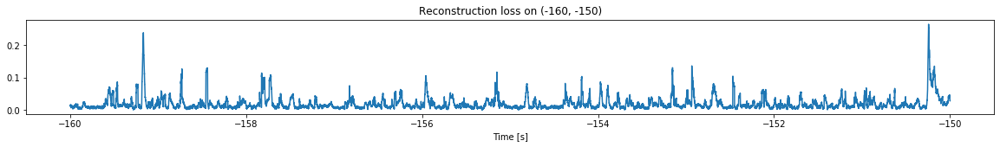

<--------
Entering sections:  (-150, -140)
-------->
Training for section:  (-160, -150)


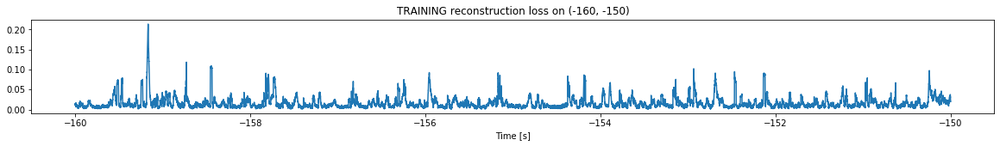

Finished training, median of the log(loss) is:  -1.9271282892113502
Triggering for section:  (-150, -140)
Using this median for triggering: -1.90201190509315


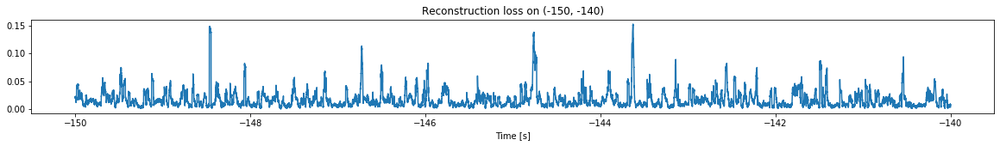

<--------
Entering sections:  (-140, -130)
-------->
Training for section:  (-150, -140)


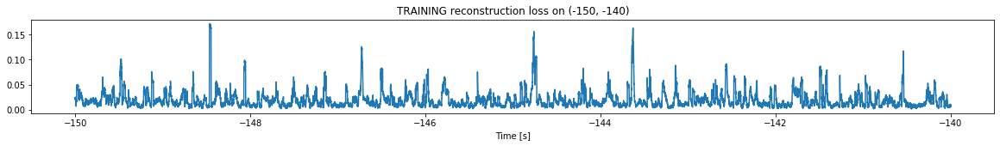

Finished training, median of the log(loss) is:  -1.8463601241767829
Triggering for section:  (-140, -130)
Using this median for triggering: -1.9271282892113502


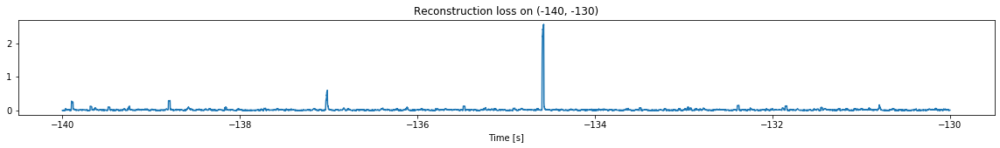

<--------
Entering sections:  (-130, -120)
-------->
Training for section:  (-140, -130)


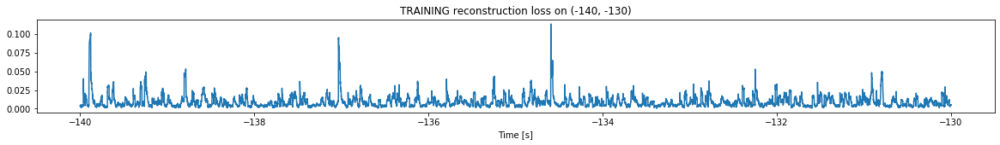

Finished training, median of the log(loss) is:  -2.140354057157192
Triggering for section:  (-130, -120)
Using this median for triggering: -1.8463601241767829


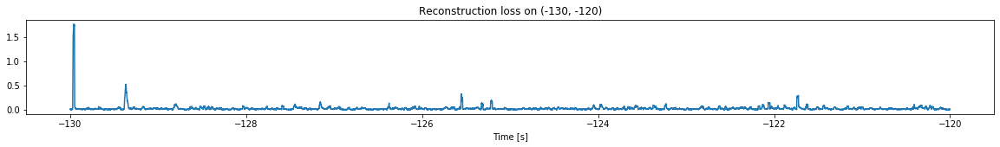

<--------
Entering sections:  (-120, -110)
-------->
Training for section:  (-130, -120)


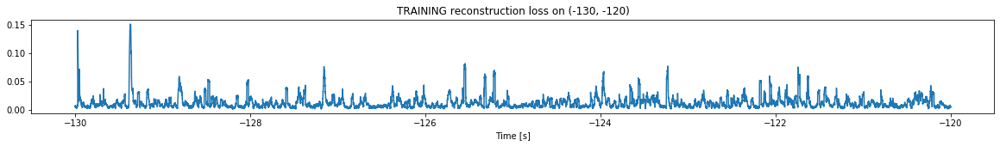

Finished training, median of the log(loss) is:  -2.0383055898917677
Triggering for section:  (-120, -110)
Using this median for triggering: -2.140354057157192


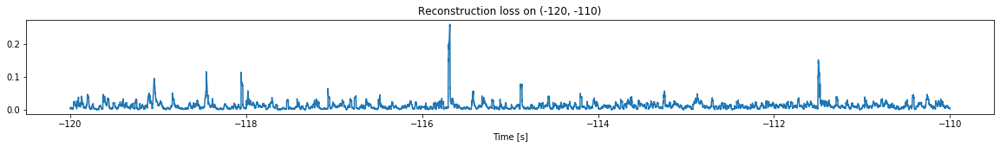

<--------
Entering sections:  (-110, -100)
-------->
Training for section:  (-120, -110)


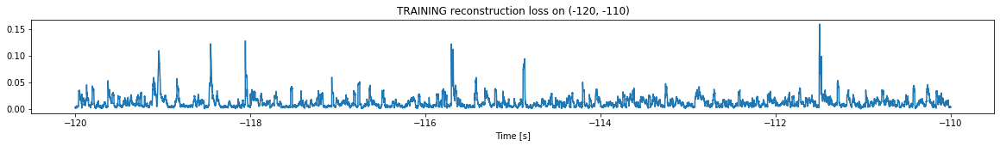

Finished training, median of the log(loss) is:  -2.008648016738557
Triggering for section:  (-110, -100)
Using this median for triggering: -2.0383055898917677


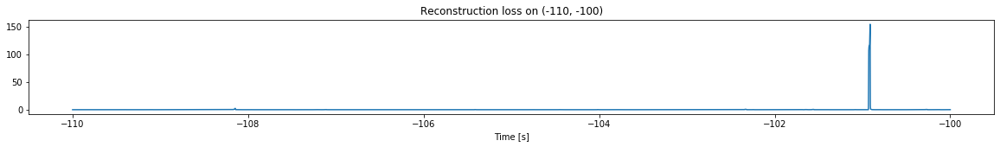

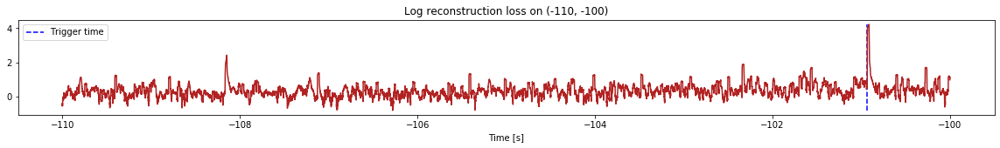

Triggered at:  -100.93169
<--------
Entering sections:  (-100, -90)
-------->
Training for section:  (-110, -100)


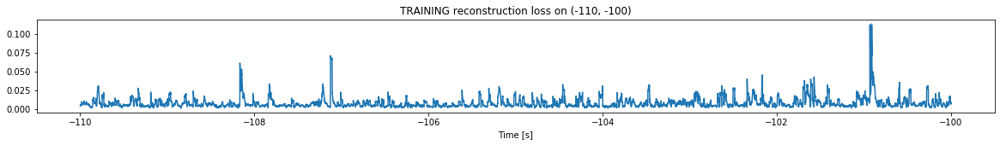

Finished training, median of the log(loss) is:  -2.2549602289820454
Triggering for section:  (-100, -90)
Using this median for triggering: -2.008648016738557


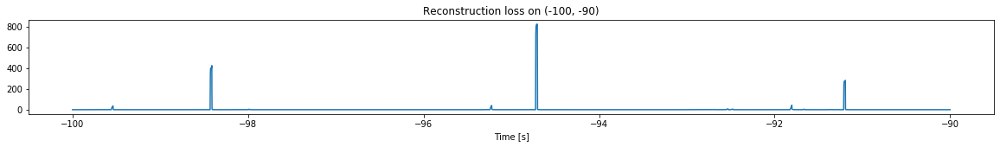

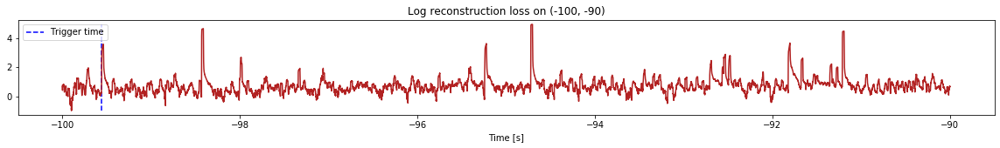

Triggered at:  -99.555984
<--------
Entering sections:  (-90, -80)
-------->
Training for section:  (-100, -90)


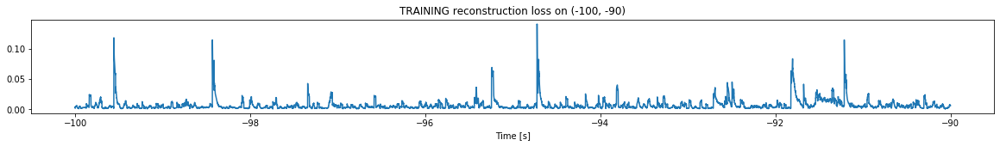

Finished training, median of the log(loss) is:  -2.3361371653112917
Triggering for section:  (-90, -80)
Using this median for triggering: -2.2549602289820454


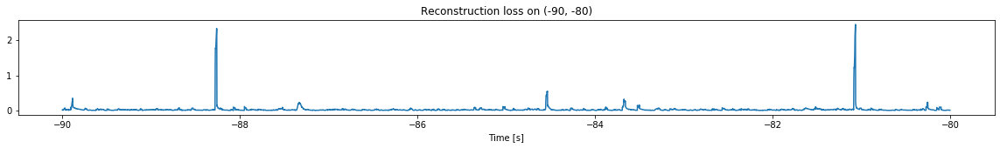

<--------
Entering sections:  (-80, -70)
-------->
Training for section:  (-90, -80)


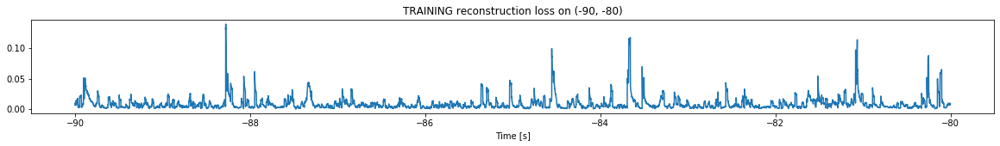

Finished training, median of the log(loss) is:  -2.2105353509781827
Triggering for section:  (-80, -70)
Using this median for triggering: -2.3361371653112917


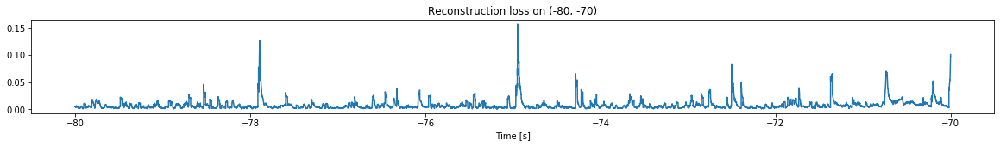

<--------
Entering sections:  (-70, -60)
-------->
Training for section:  (-80, -70)


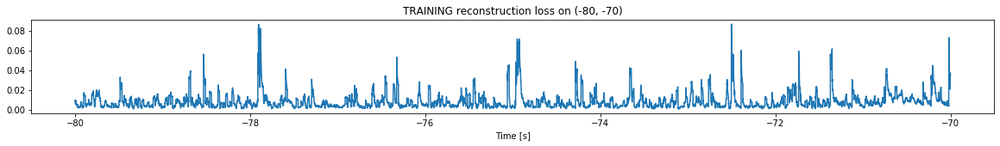

Finished training, median of the log(loss) is:  -2.2129104627662994
Triggering for section:  (-70, -60)
Using this median for triggering: -2.2105353509781827


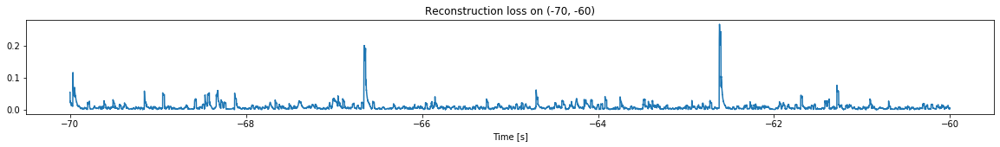

<--------
Entering sections:  (-60, -50)
-------->
Training for section:  (-70, -60)


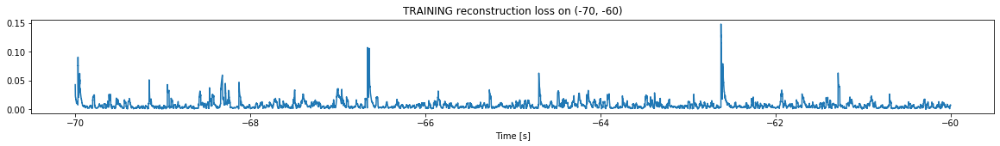

Finished training, median of the log(loss) is:  -2.262654807248203
Triggering for section:  (-60, -50)
Using this median for triggering: -2.2129104627662994


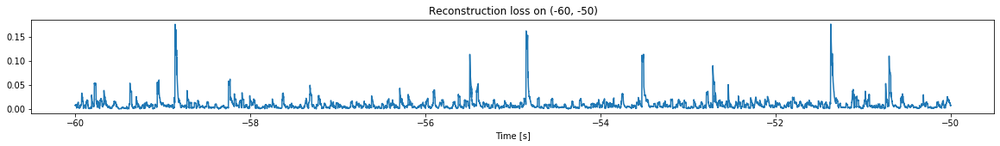

<--------
Entering sections:  (-50, -40)
-------->
Training for section:  (-60, -50)


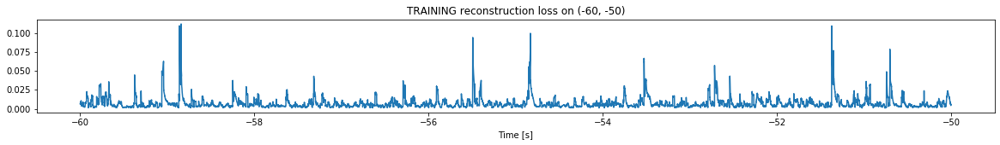

Finished training, median of the log(loss) is:  -2.281576968393159
Triggering for section:  (-50, -40)
Using this median for triggering: -2.262654807248203


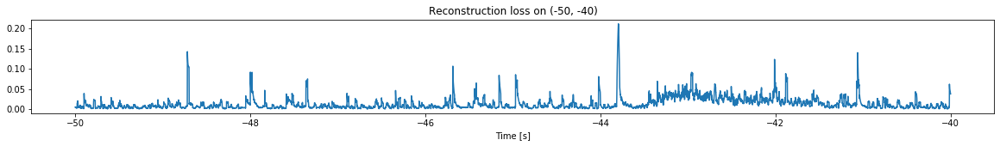

<--------
Entering sections:  (-40, -30)
-------->
Training for section:  (-50, -40)


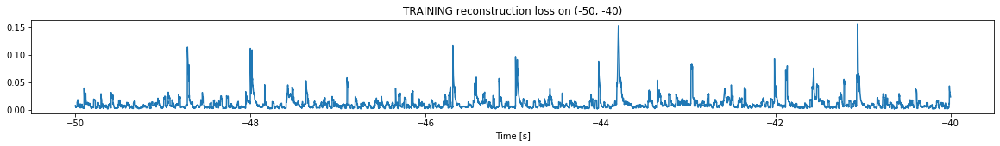

Finished training, median of the log(loss) is:  -2.1290281369103
Triggering for section:  (-40, -30)
Using this median for triggering: -2.281576968393159


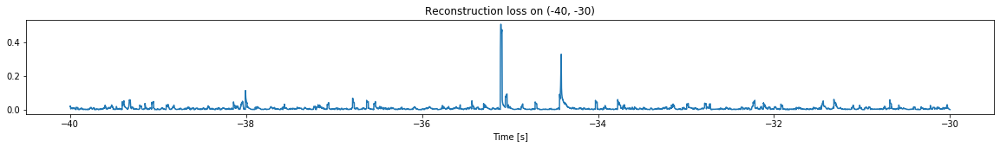

<--------
Entering sections:  (-30, -20)
-------->
Training for section:  (-40, -30)


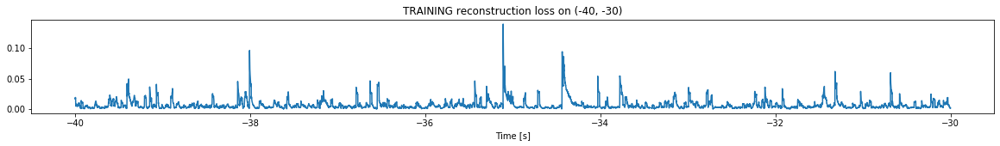

Finished training, median of the log(loss) is:  -2.3204738288882476
Triggering for section:  (-30, -20)
Using this median for triggering: -2.1290281369103


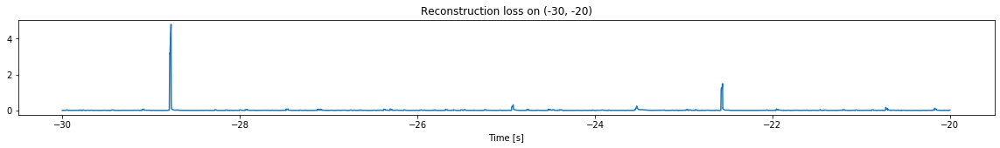

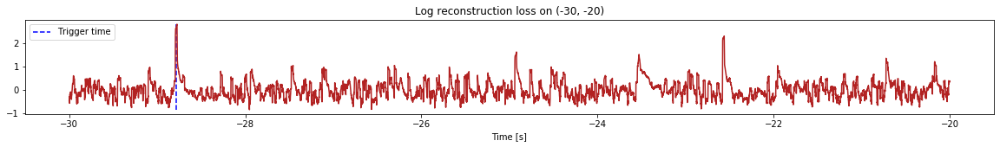

Triggered at:  -28.783289
<--------
Entering sections:  (-20, -10)
-------->
Training for section:  (-30, -20)


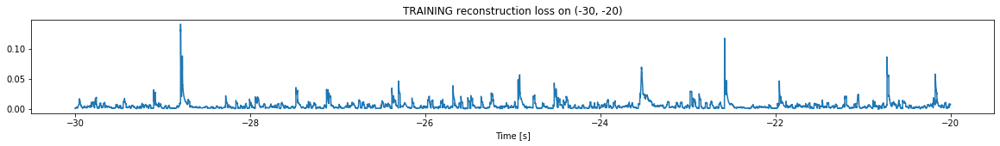

Finished training, median of the log(loss) is:  -2.4073572416780418
Triggering for section:  (-20, -10)
Using this median for triggering: -2.3204738288882476


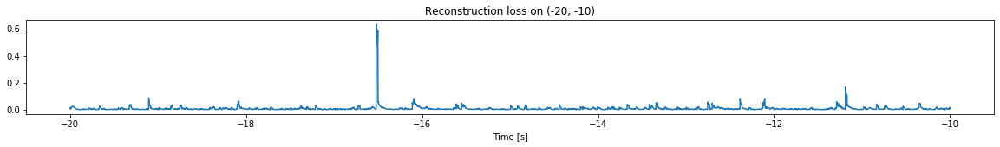

<--------
Entering sections:  (-10, 0)
-------->
Training for section:  (-20, -10)


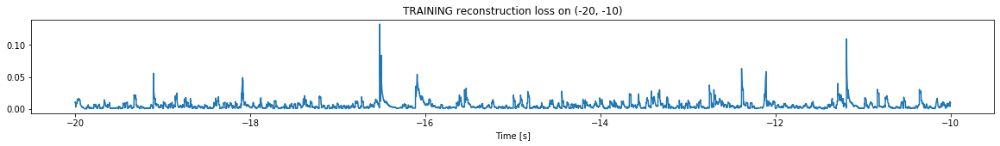

Finished training, median of the log(loss) is:  -2.369380813964807
Triggering for section:  (-10, 0)
Using this median for triggering: -2.4073572416780418


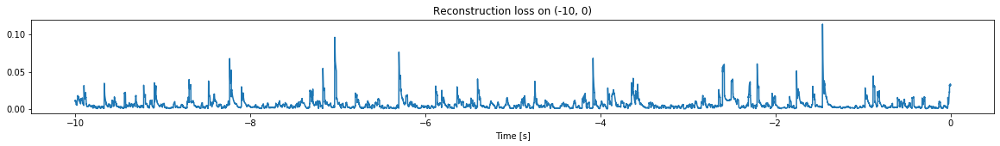

<--------
Finished simulation, all the triggered times are:  [-241.65187, -199.90079, -100.93169, -99.555984, -28.783289]


In [17]:
simulation("./data/Ramp19/", 10, (-300,0))

Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
All data's shape:  (2117500, 12)
Flushing input history
Number of sections: 21
Entering sections:  (-210, -200)
-------->
Entering sections:  (-200, -190)
-------->
Training for section:  (None, -200)


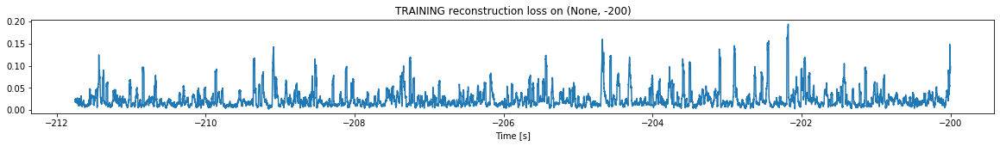

Finished training, median of the log(loss) is:  -1.7316525917022663
<--------
Entering sections:  (-190, -180)
-------->
Training for section:  (-200, -190)


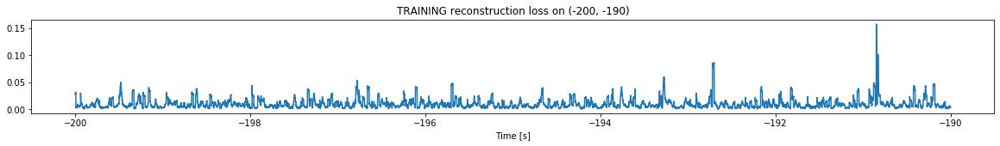

Finished training, median of the log(loss) is:  -2.107228627549631
Triggering for section:  (-190, -180)
Using this median for triggering: -1.7316525917022663


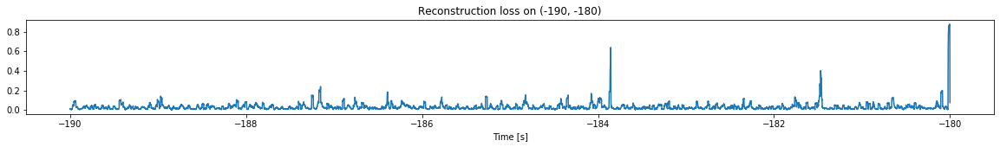

<--------
Entering sections:  (-180, -170)
-------->
Training for section:  (-190, -180)


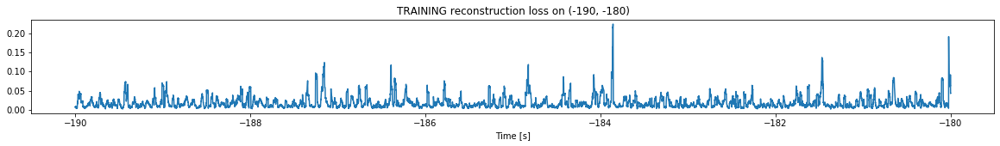

Finished training, median of the log(loss) is:  -1.8605080870310147
Triggering for section:  (-180, -170)
Using this median for triggering: -2.107228627549631


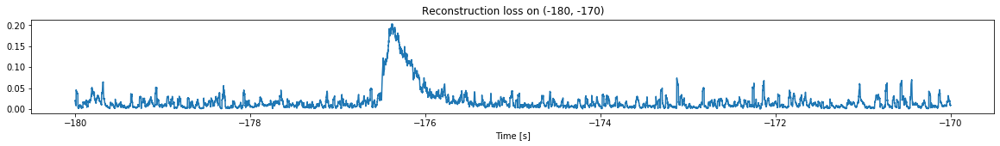

<--------
Entering sections:  (-170, -160)
-------->
Training for section:  (-180, -170)


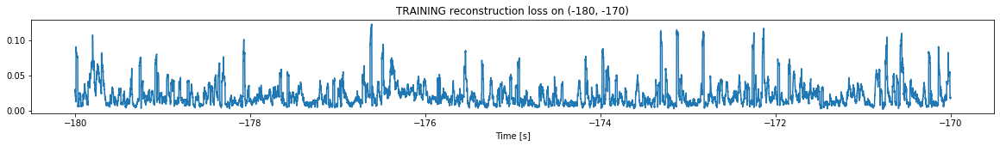

Finished training, median of the log(loss) is:  -1.744738833323645
Triggering for section:  (-170, -160)
Using this median for triggering: -1.8605080870310147


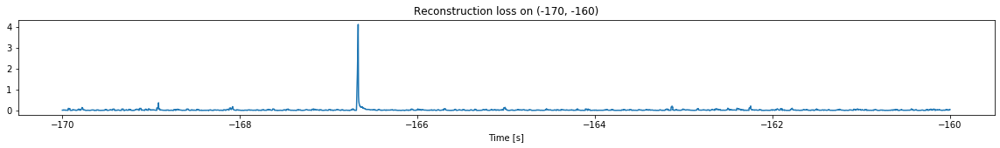

<--------
Entering sections:  (-160, -150)
-------->
Training for section:  (-170, -160)


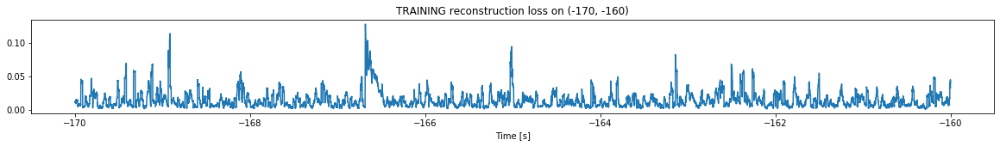

Finished training, median of the log(loss) is:  -1.951466361866805
Triggering for section:  (-160, -150)
Using this median for triggering: -1.744738833323645


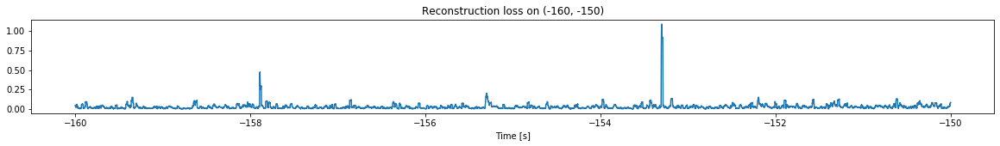

<--------
Entering sections:  (-150, -140)
-------->
Training for section:  (-160, -150)


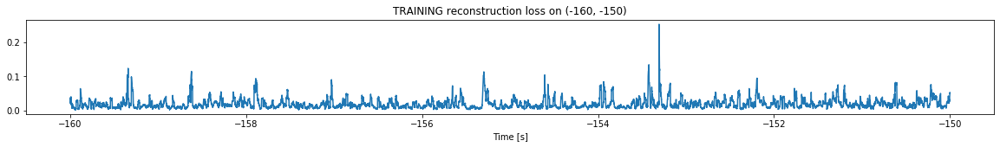

Finished training, median of the log(loss) is:  -1.8109942173059714
Triggering for section:  (-150, -140)
Using this median for triggering: -1.951466361866805


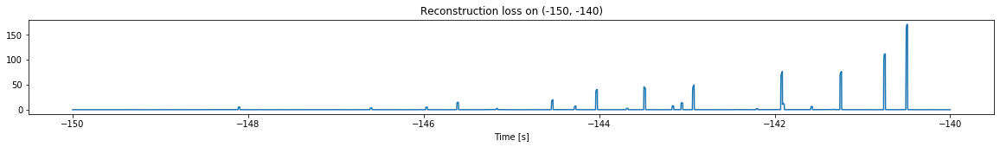

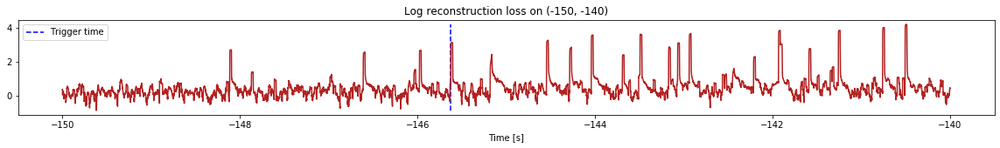

Triggered at:  -145.62268
<--------
Entering sections:  (-140, -130)
-------->
Training for section:  (-150, -140)


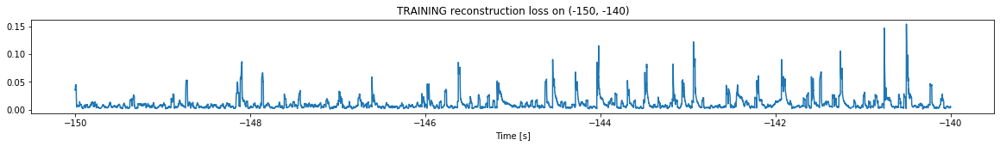

Finished training, median of the log(loss) is:  -2.161521064477519
Triggering for section:  (-140, -130)
Using this median for triggering: -1.8109942173059714


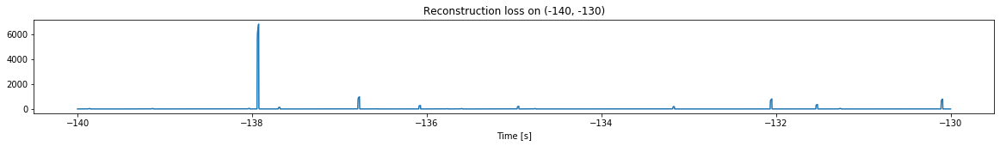

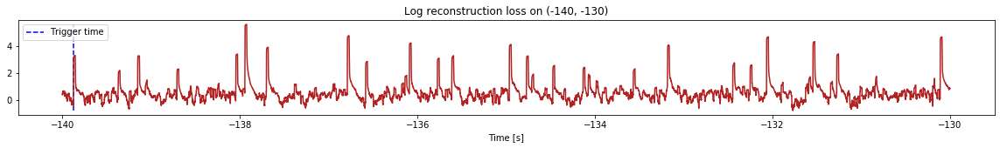

Triggered at:  -139.87419
<--------
Entering sections:  (-130, -120)
-------->
Training for section:  (-140, -130)


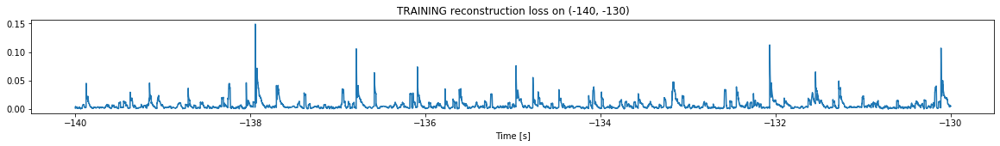

Finished training, median of the log(loss) is:  -2.3509767099999133
Triggering for section:  (-130, -120)
Using this median for triggering: -2.161521064477519


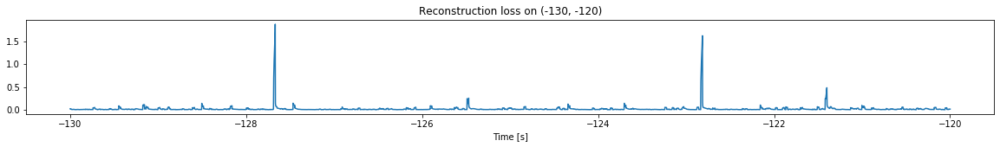

<--------
Entering sections:  (-120, -110)
-------->
Training for section:  (-130, -120)


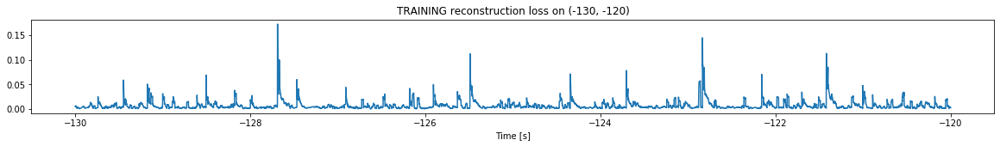

Finished training, median of the log(loss) is:  -2.3142794855000077
Triggering for section:  (-120, -110)
Using this median for triggering: -2.3509767099999133


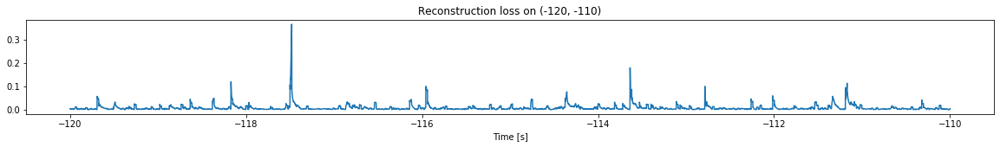

<--------
Entering sections:  (-110, -100)
-------->
Training for section:  (-120, -110)


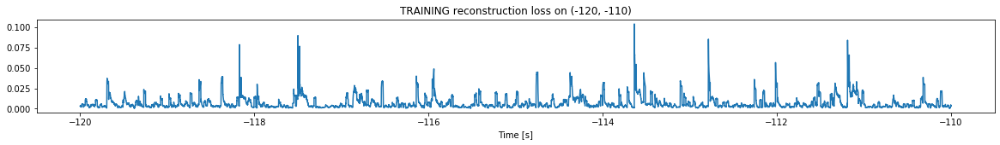

Finished training, median of the log(loss) is:  -2.363445537987526
Triggering for section:  (-110, -100)
Using this median for triggering: -2.3142794855000077


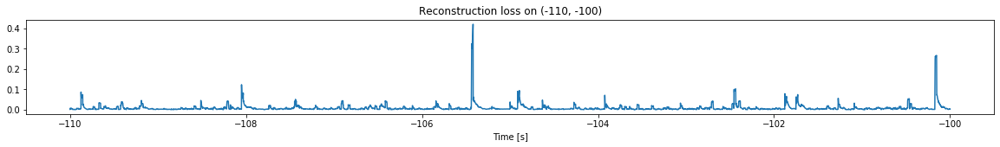

<--------
Entering sections:  (-100, -90)
-------->
Training for section:  (-110, -100)


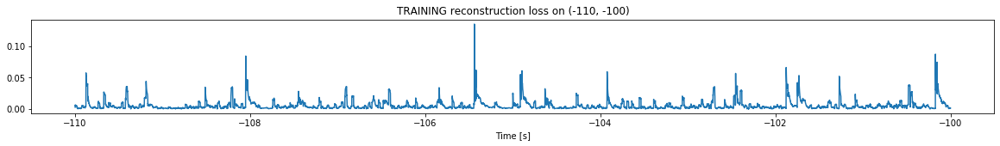

Finished training, median of the log(loss) is:  -2.41142883181658
Triggering for section:  (-100, -90)
Using this median for triggering: -2.363445537987526


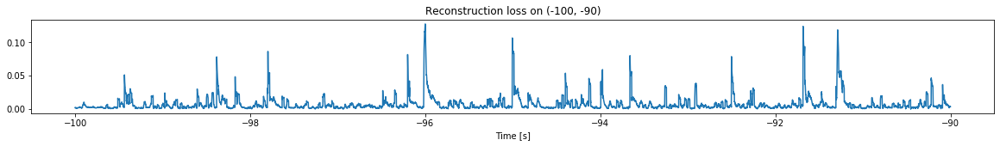

<--------
Entering sections:  (-90, -80)
-------->
Training for section:  (-100, -90)


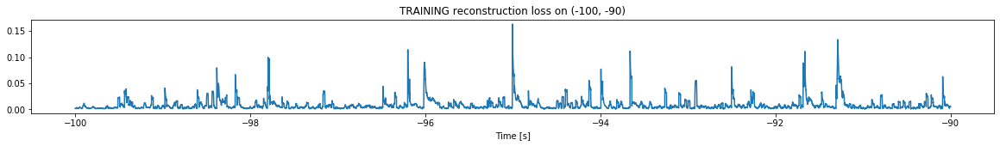

Finished training, median of the log(loss) is:  -2.2843242767306084
Triggering for section:  (-90, -80)
Using this median for triggering: -2.41142883181658


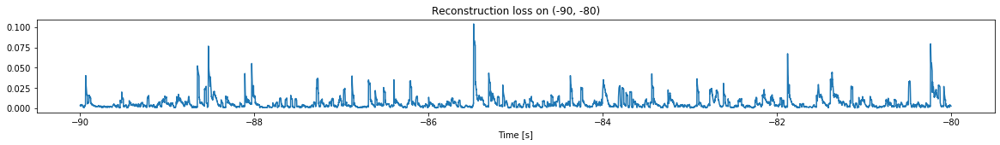

<--------
Entering sections:  (-80, -70)
-------->
Training for section:  (-90, -80)


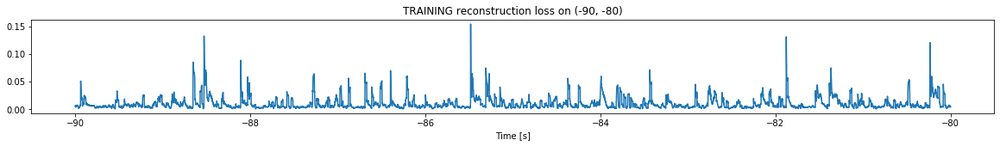

Finished training, median of the log(loss) is:  -2.1537880893435775
Triggering for section:  (-80, -70)
Using this median for triggering: -2.2843242767306084


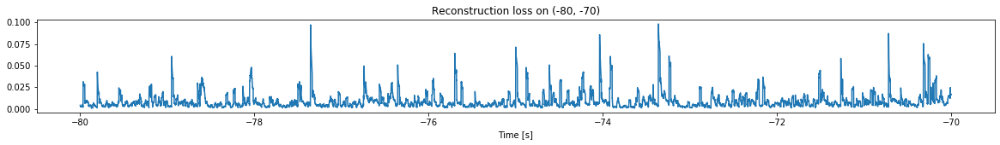

<--------
Entering sections:  (-70, -60)
-------->
Training for section:  (-80, -70)


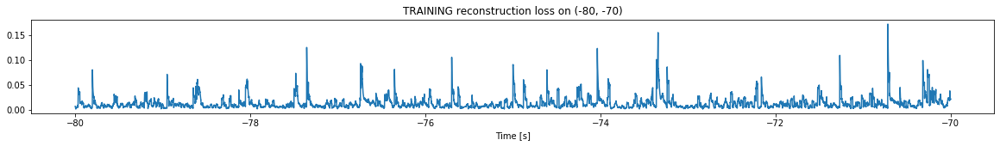

Finished training, median of the log(loss) is:  -2.0176962675676595
Triggering for section:  (-70, -60)
Using this median for triggering: -2.1537880893435775


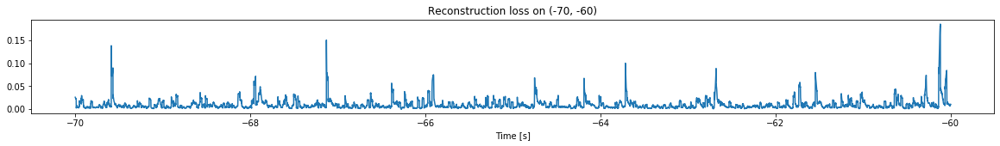

<--------
Entering sections:  (-60, -50)
-------->
Training for section:  (-70, -60)


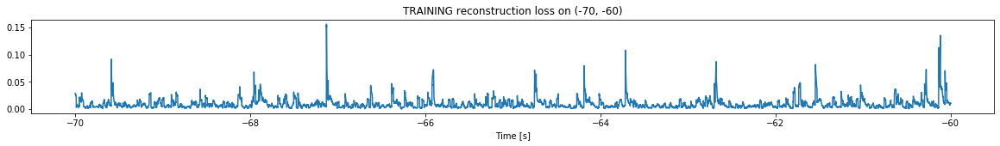

Finished training, median of the log(loss) is:  -2.1370307112912723
Triggering for section:  (-60, -50)
Using this median for triggering: -2.0176962675676595


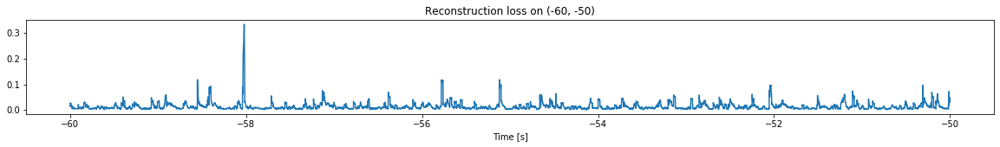

<--------
Entering sections:  (-50, -40)
-------->
Training for section:  (-60, -50)


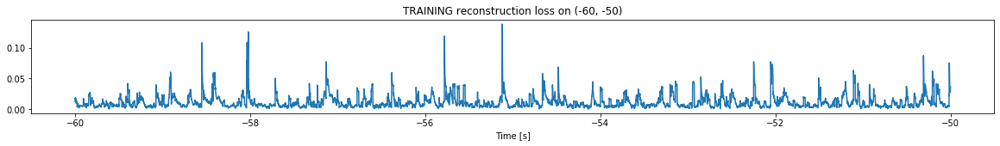

Finished training, median of the log(loss) is:  -2.0584915874527248
Triggering for section:  (-50, -40)
Using this median for triggering: -2.1370307112912723


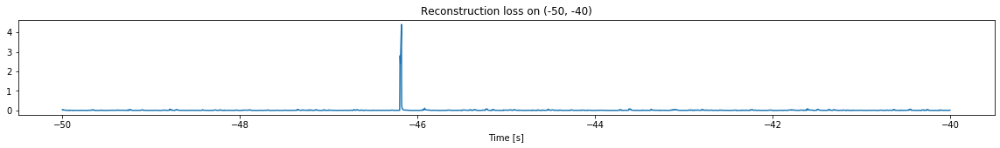

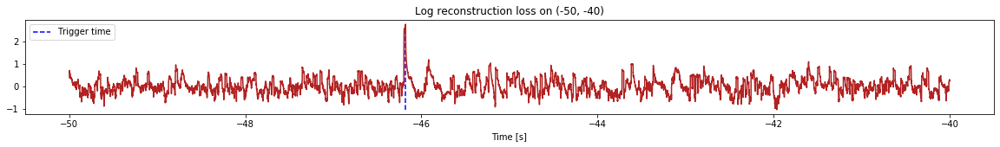

Triggered at:  -46.18379
<--------
Entering sections:  (-40, -30)
-------->
Training for section:  (-50, -40)


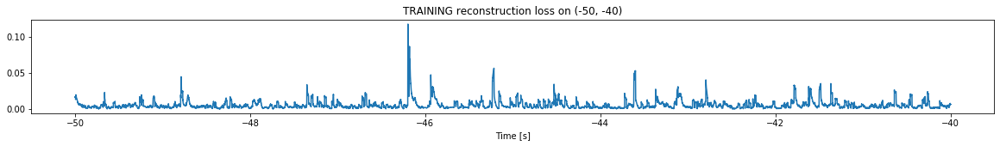

Finished training, median of the log(loss) is:  -2.3550694400470213
Triggering for section:  (-40, -30)
Using this median for triggering: -2.0584915874527248


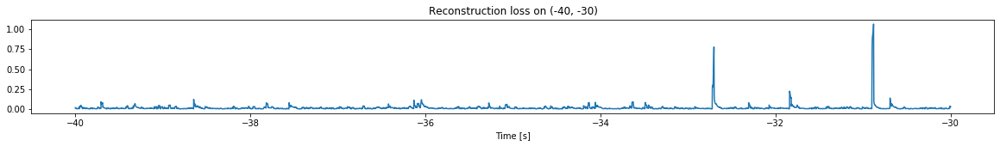

<--------
Entering sections:  (-30, -20)
-------->
Training for section:  (-40, -30)


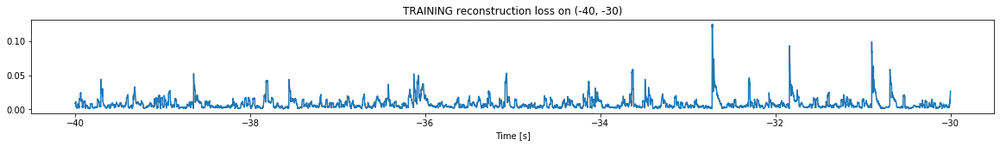

Finished training, median of the log(loss) is:  -2.246293846393341
Triggering for section:  (-30, -20)
Using this median for triggering: -2.3550694400470213


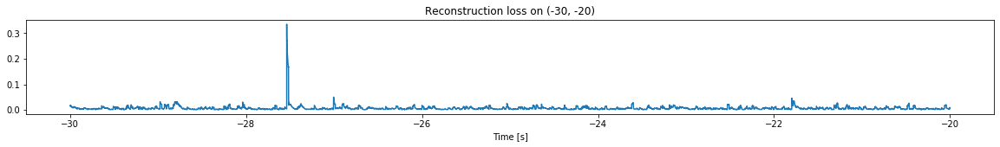

<--------
Entering sections:  (-20, -10)
-------->
Training for section:  (-30, -20)


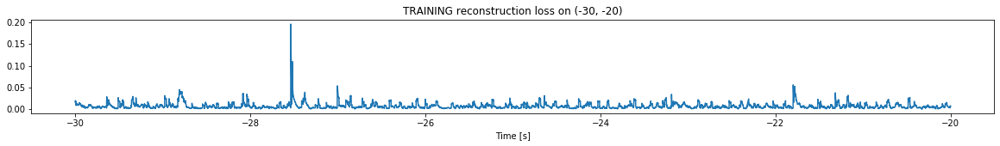

Finished training, median of the log(loss) is:  -2.2628682347971925
Triggering for section:  (-20, -10)
Using this median for triggering: -2.246293846393341


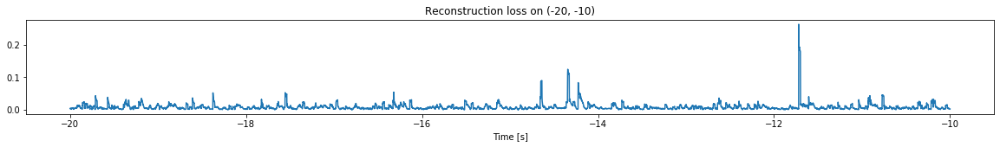

<--------
Entering sections:  (-10, 0)
-------->
Training for section:  (-20, -10)


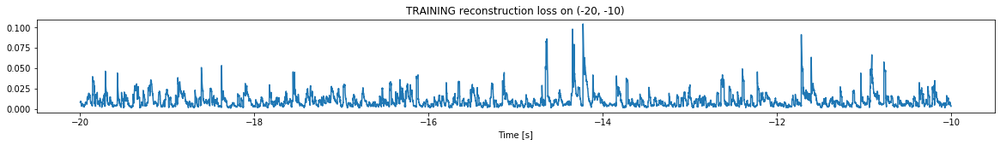

Finished training, median of the log(loss) is:  -2.1149863037974113
Triggering for section:  (-10, 0)
Using this median for triggering: -2.2628682347971925


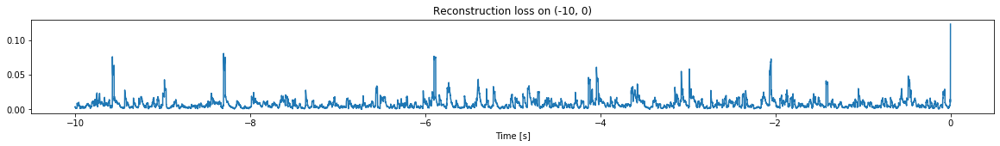

<--------
Finished simulation, all the triggered times are:  [-145.62268, -139.87419, -46.18379]


In [6]:
simulation("./data/Ramp20/", 10, (-212,0))

Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
All data's shape:  (1197500, 12)
Flushing input history
Number of sections: 12
Entering sections:  (-120, -110)
-------->
Entering sections:  (-110, -100)
-------->
Training for section:  (None, -110)


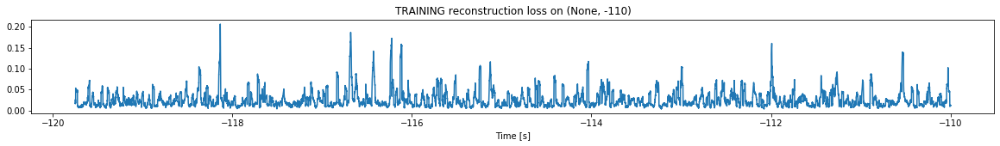

Finished training, median of the log(loss) is:  -1.7024814665795267
<--------
Entering sections:  (-100, -90)
-------->
Training for section:  (-110, -100)


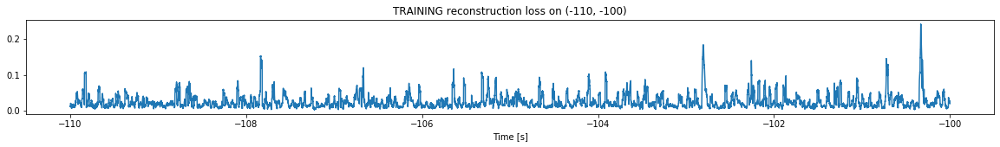

Finished training, median of the log(loss) is:  -1.6865635698625314
Triggering for section:  (-100, -90)
Using this median for triggering: -1.7024814665795267


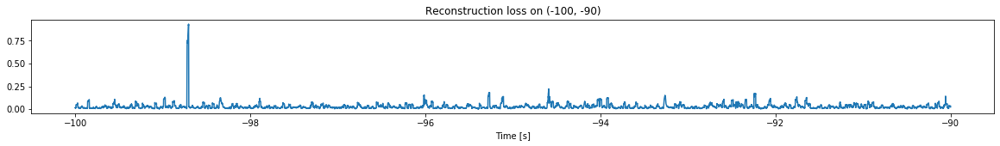

<--------
Entering sections:  (-90, -80)
-------->
Training for section:  (-100, -90)


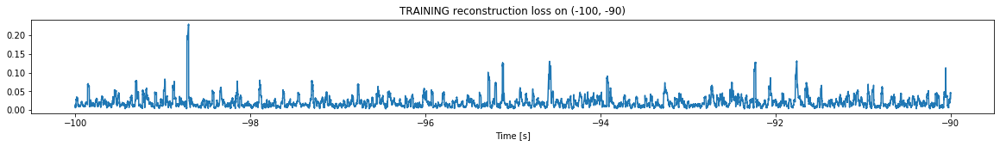

Finished training, median of the log(loss) is:  -1.7655787513644552
Triggering for section:  (-90, -80)
Using this median for triggering: -1.6865635698625314


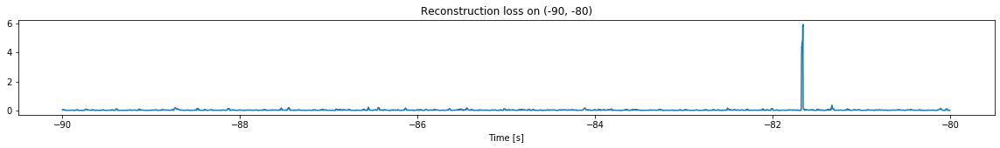

<--------
Entering sections:  (-80, -70)
-------->
Training for section:  (-90, -80)


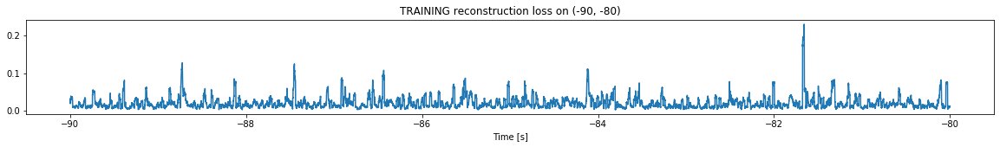

Finished training, median of the log(loss) is:  -1.8050983172229245
Triggering for section:  (-80, -70)
Using this median for triggering: -1.7655787513644552


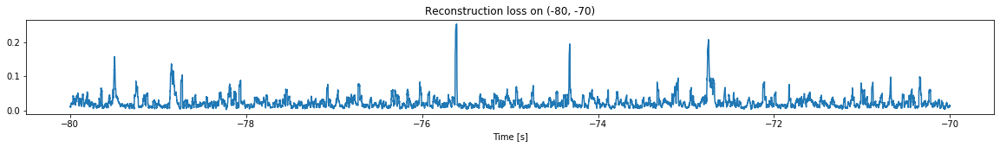

<--------
Entering sections:  (-70, -60)
-------->
Training for section:  (-80, -70)


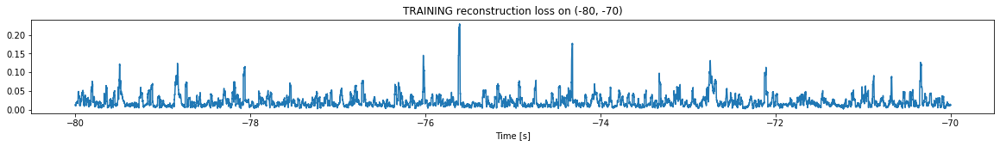

Finished training, median of the log(loss) is:  -1.7488751781959215
Triggering for section:  (-70, -60)
Using this median for triggering: -1.8050983172229245


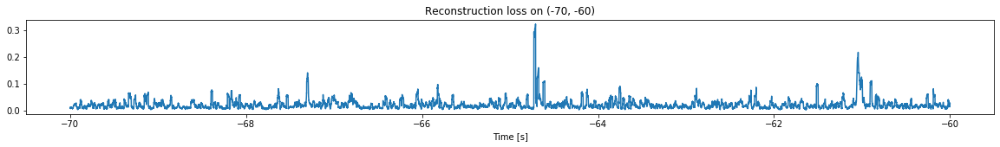

<--------
Entering sections:  (-60, -50)
-------->
Training for section:  (-70, -60)


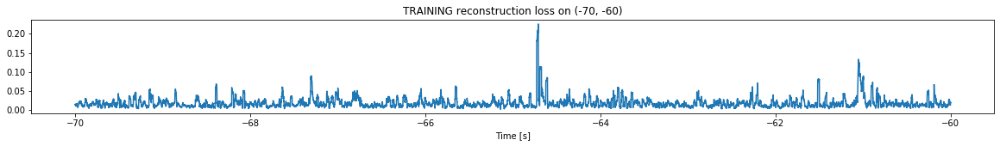

Finished training, median of the log(loss) is:  -1.8372963287269073
Triggering for section:  (-60, -50)
Using this median for triggering: -1.7488751781959215


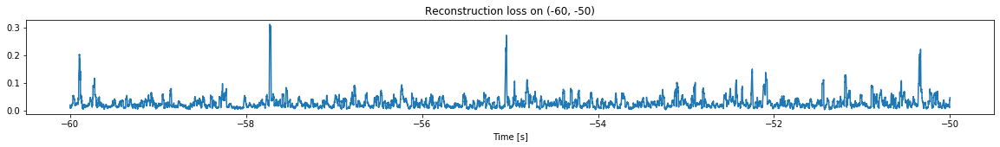

<--------
Entering sections:  (-50, -40)
-------->
Training for section:  (-60, -50)


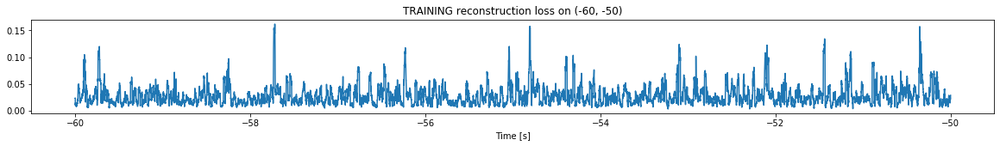

Finished training, median of the log(loss) is:  -1.623411912480199
Triggering for section:  (-50, -40)
Using this median for triggering: -1.8372963287269073


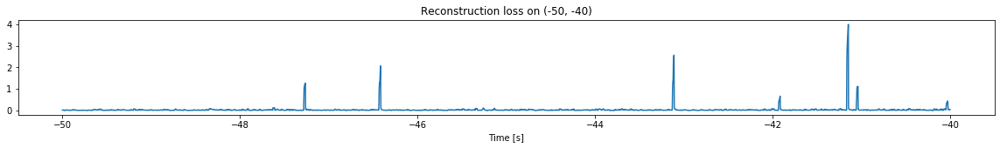

<--------
Entering sections:  (-40, -30)
-------->
Training for section:  (-50, -40)


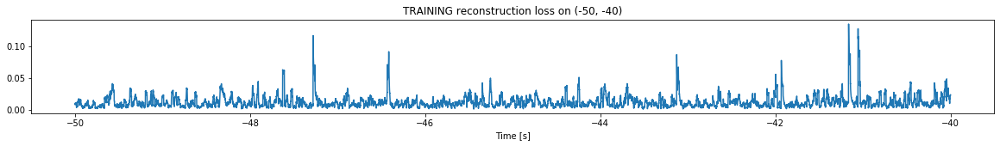

Finished training, median of the log(loss) is:  -1.98439310391217
Triggering for section:  (-40, -30)
Using this median for triggering: -1.623411912480199


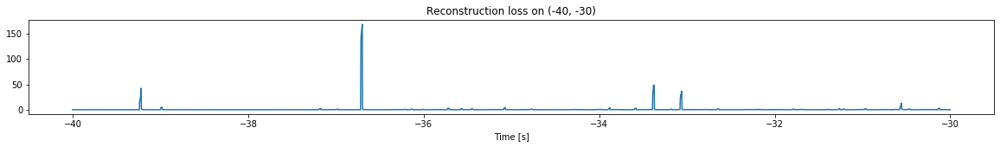

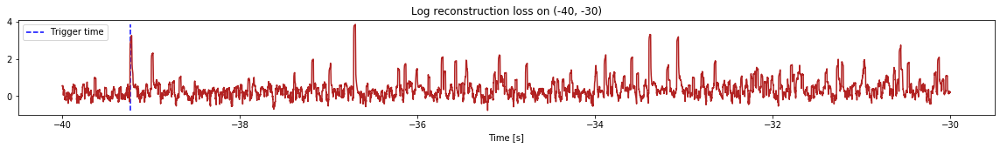

Triggered at:  -39.237
<--------
Entering sections:  (-30, -20)
-------->
Training for section:  (-40, -30)


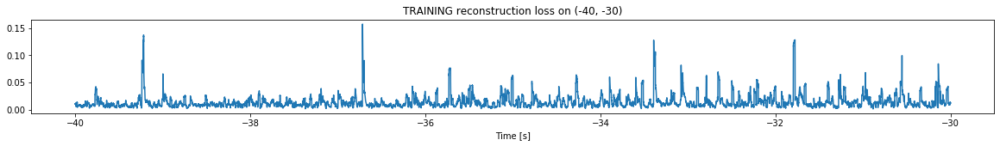

Finished training, median of the log(loss) is:  -1.9789788518858216
Triggering for section:  (-30, -20)
Using this median for triggering: -1.98439310391217


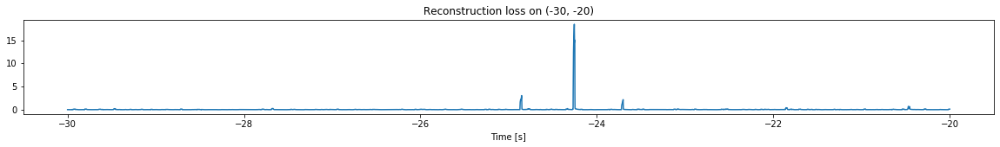

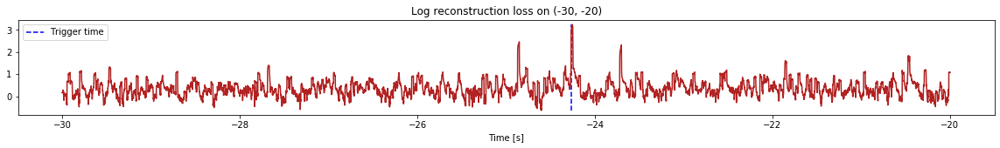

Triggered at:  -24.2682
<--------
Entering sections:  (-20, -10)
-------->
Training for section:  (-30, -20)


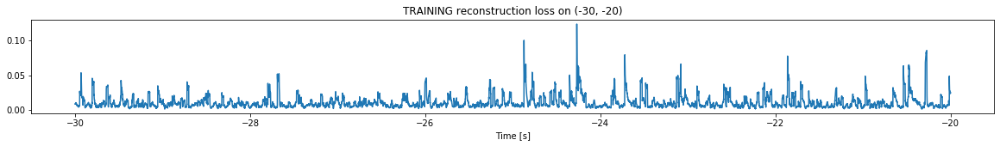

Finished training, median of the log(loss) is:  -2.10835828525465
Triggering for section:  (-20, -10)
Using this median for triggering: -1.9789788518858216


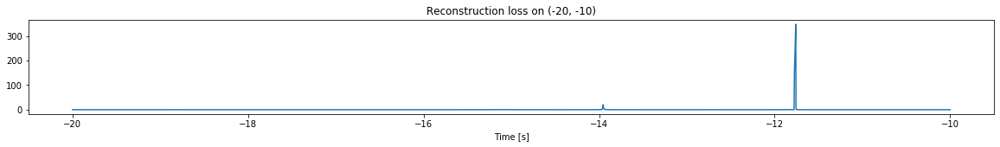

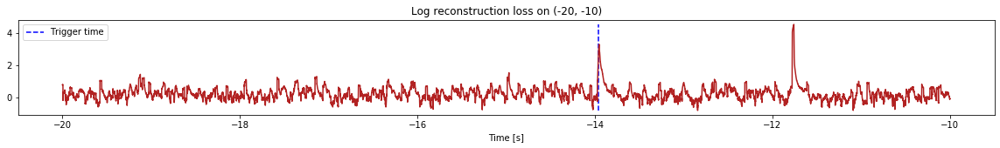

Triggered at:  -13.960799
<--------
Entering sections:  (-10, 0)
-------->
Training for section:  (-20, -10)


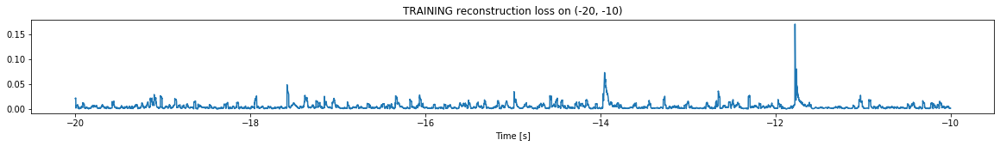

Finished training, median of the log(loss) is:  -2.4291677454800897
Triggering for section:  (-10, 0)
Using this median for triggering: -2.10835828525465


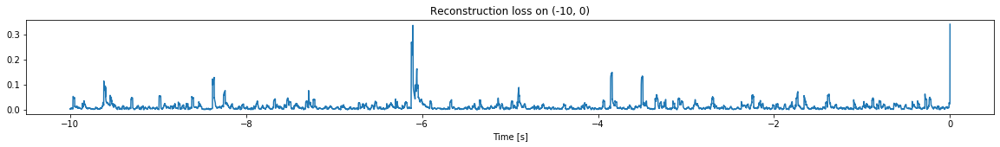

<--------
Finished simulation, all the triggered times are:  [-39.237, -24.2682, -13.960799]


In [7]:
simulation("./data/Ramp21/", 10, (-120,0))

Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
All data's shape:  (797500, 12)
Flushing input history
Number of sections: 8
Entering sections:  (-80, -70)
-------->
Entering sections:  (-70, -60)
-------->
Training for section:  (None, -70)


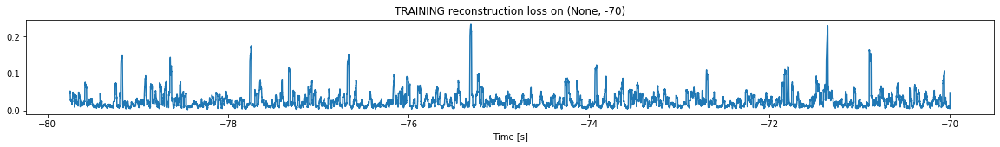

Finished training, median of the log(loss) is:  -1.6705229606674177
<--------
Entering sections:  (-60, -50)
-------->
Training for section:  (-70, -60)


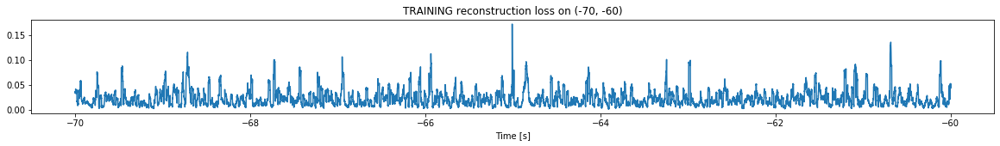

Finished training, median of the log(loss) is:  -1.706729818678999
Triggering for section:  (-60, -50)
Using this median for triggering: -1.6705229606674177


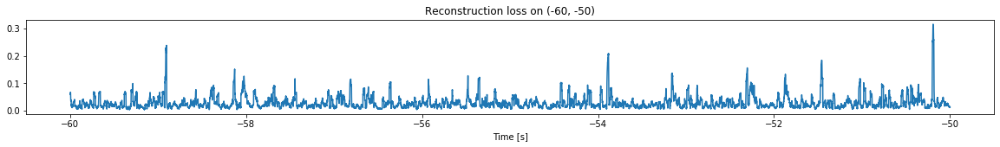

<--------
Entering sections:  (-50, -40)
-------->
Training for section:  (-60, -50)


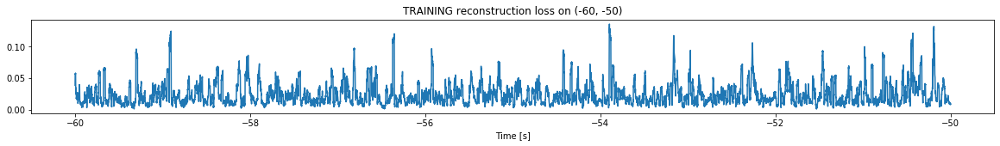

Finished training, median of the log(loss) is:  -1.6972371080286397
Triggering for section:  (-50, -40)
Using this median for triggering: -1.706729818678999


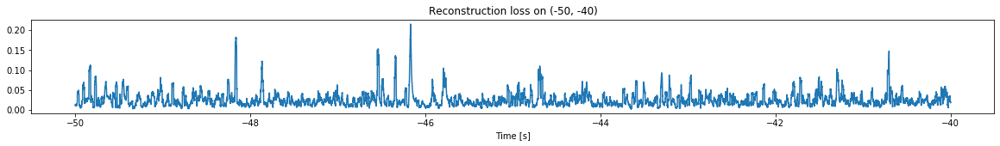

<--------
Entering sections:  (-40, -30)
-------->
Training for section:  (-50, -40)


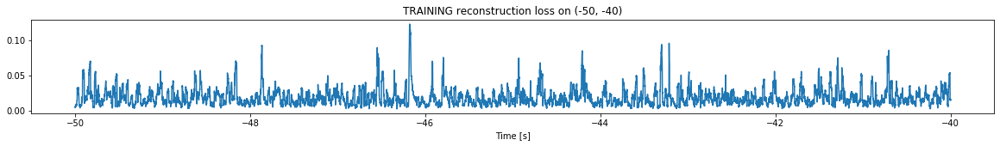

Finished training, median of the log(loss) is:  -1.793676070251244
Triggering for section:  (-40, -30)
Using this median for triggering: -1.6972371080286397


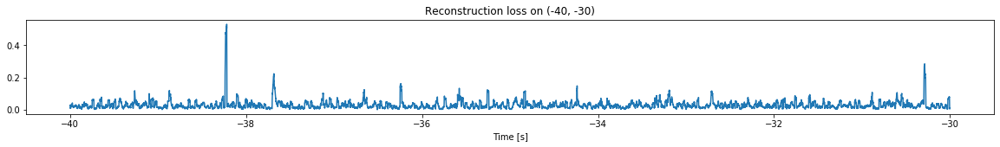

<--------
Entering sections:  (-30, -20)
-------->
Training for section:  (-40, -30)


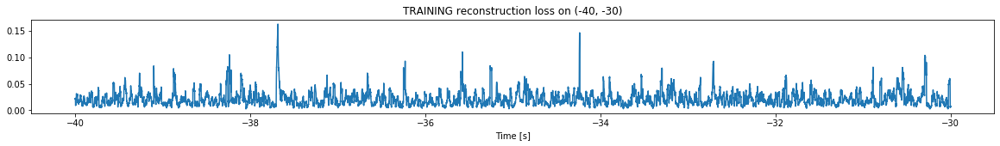

Finished training, median of the log(loss) is:  -1.7262331399682256
Triggering for section:  (-30, -20)
Using this median for triggering: -1.793676070251244


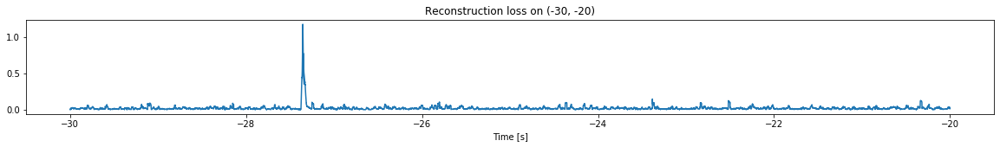

<--------
Entering sections:  (-20, -10)
-------->
Training for section:  (-30, -20)


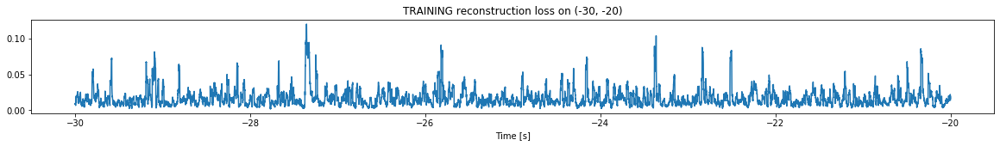

Finished training, median of the log(loss) is:  -1.860575712579335
Triggering for section:  (-20, -10)
Using this median for triggering: -1.7262331399682256


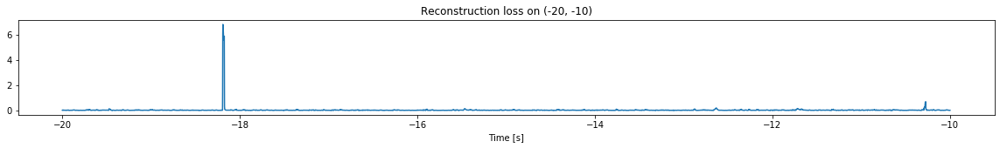

<--------
Entering sections:  (-10, 0)
-------->
Training for section:  (-20, -10)


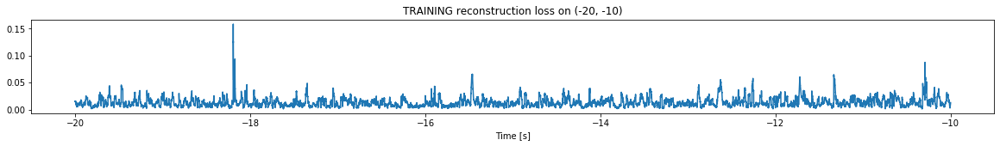

Finished training, median of the log(loss) is:  -1.930644326839972
Triggering for section:  (-10, 0)
Using this median for triggering: -1.860575712579335


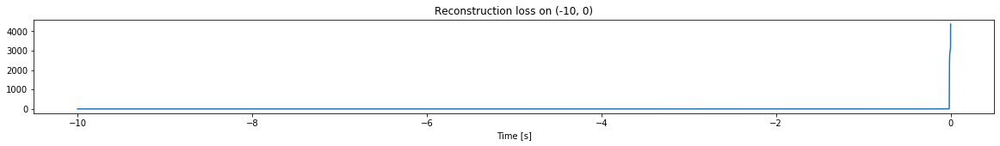

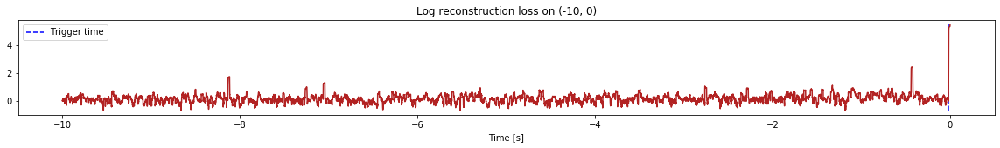

Triggered at:  -0.0157
<--------
Finished simulation, all the triggered times are:  [-0.0157]


In [8]:
simulation("./data/Ramp22/", 10, (-80,0))

Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
All data's shape:  (497500, 12)
Flushing input history
Number of sections: 5
Entering sections:  (-50, -40)
-------->
Entering sections:  (-40, -30)
-------->
Training for section:  (None, -40)


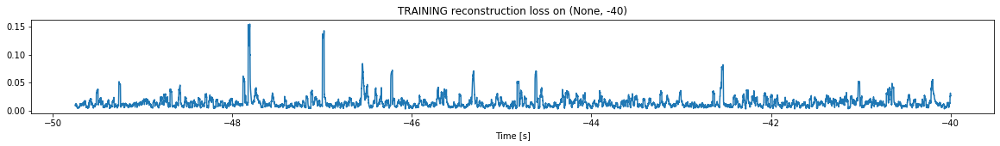

Finished training, median of the log(loss) is:  -1.941728043155124
<--------
Entering sections:  (-30, -20)
-------->
Training for section:  (-40, -30)


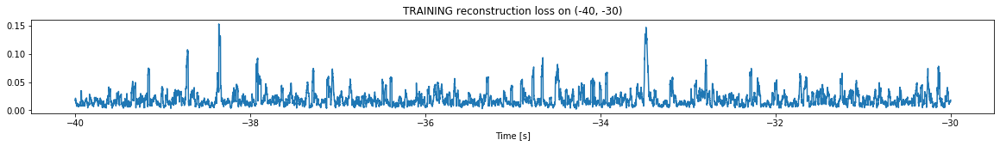

Finished training, median of the log(loss) is:  -1.7887420286997247
Triggering for section:  (-30, -20)
Using this median for triggering: -1.941728043155124


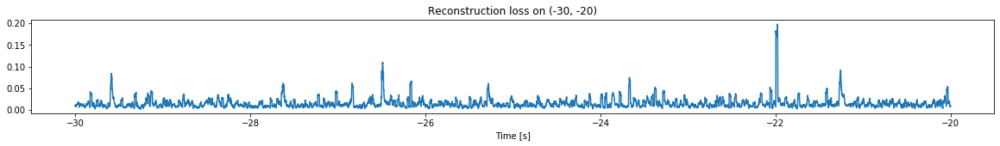

<--------
Entering sections:  (-20, -10)
-------->
Training for section:  (-30, -20)


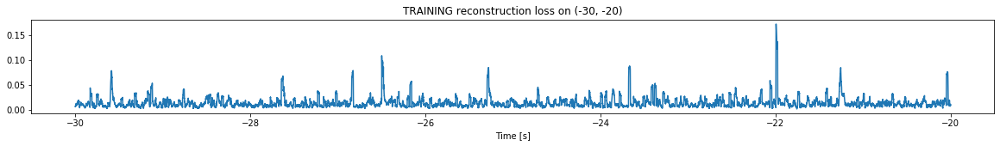

Finished training, median of the log(loss) is:  -1.967306581132976
Triggering for section:  (-20, -10)
Using this median for triggering: -1.7887420286997247


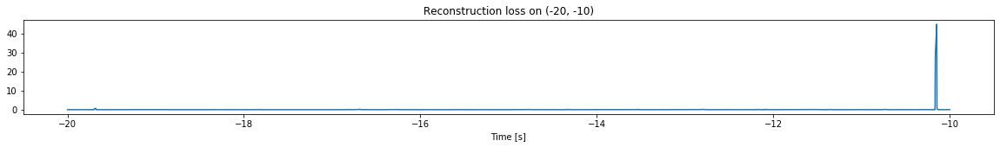

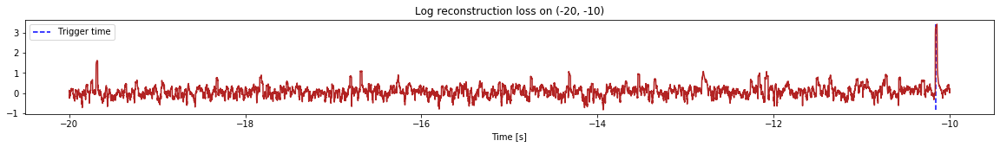

Triggered at:  -10.1647
<--------
Entering sections:  (-10, 0)
-------->
Training for section:  (-20, -10)


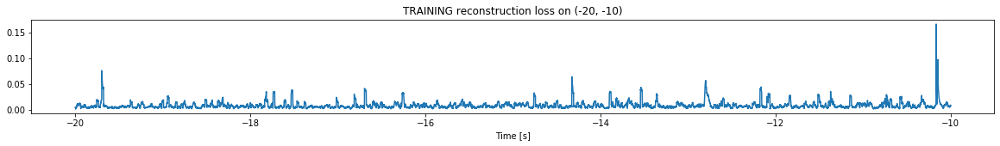

Finished training, median of the log(loss) is:  -2.1956132980083156
Triggering for section:  (-10, 0)
Using this median for triggering: -1.967306581132976


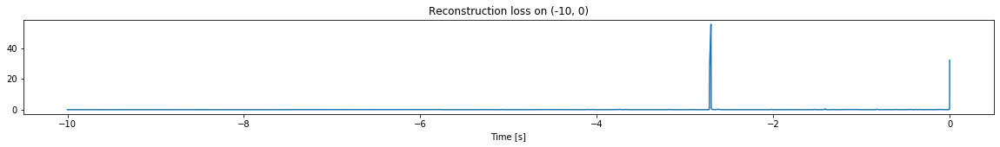

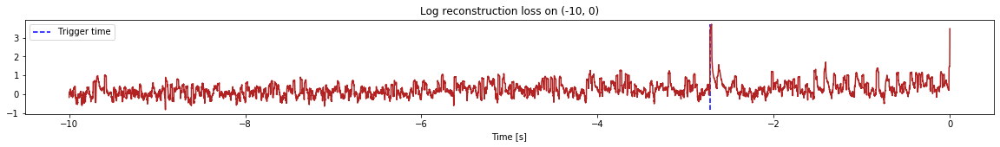

Triggered at:  -2.7240999
<--------
Finished simulation, all the triggered times are:  [-10.1647, -2.7240999]


In [16]:
simulation("./data/Ramp23/", 10, (-50,0))

Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
All data's shape:  (1097500, 12)
Flushing input history
Number of sections: 11
Entering sections:  (-110, -100)
-------->
Entering sections:  (-100, -90)
-------->
Training for section:  (None, -100)


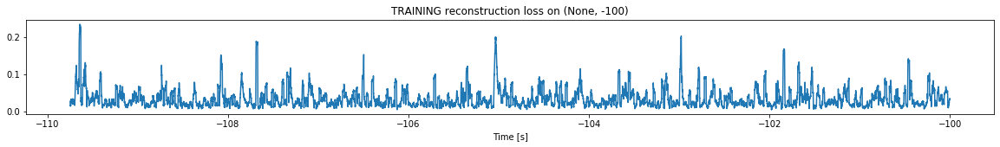

Finished training, median of the log(loss) is:  -1.5802284502437214
<--------
Entering sections:  (-90, -80)
-------->
Training for section:  (-100, -90)


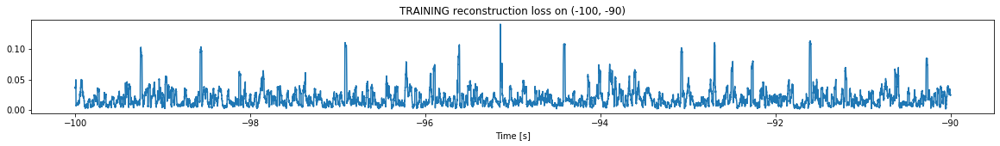

Finished training, median of the log(loss) is:  -1.794164811195201
Triggering for section:  (-90, -80)
Using this median for triggering: -1.5802284502437214


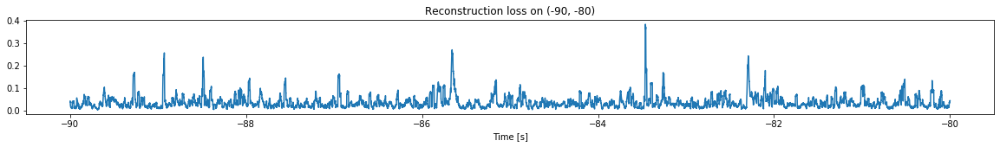

<--------
Entering sections:  (-80, -70)
-------->
Training for section:  (-90, -80)


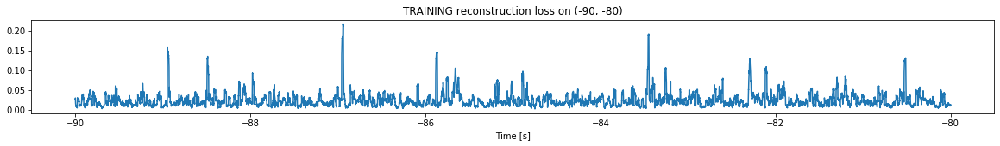

Finished training, median of the log(loss) is:  -1.6937276242682713
Triggering for section:  (-80, -70)
Using this median for triggering: -1.794164811195201


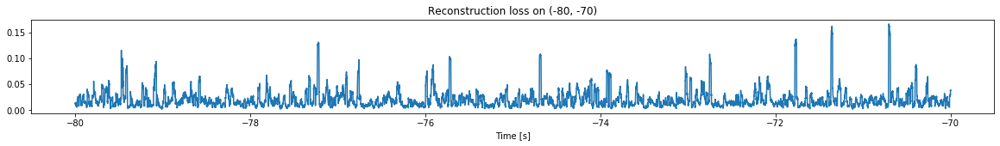

<--------
Entering sections:  (-70, -60)
-------->
Training for section:  (-80, -70)


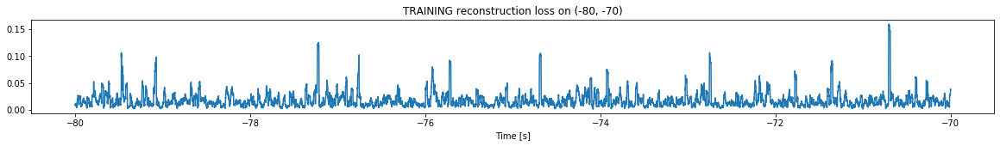

Finished training, median of the log(loss) is:  -1.8311594759785303
Triggering for section:  (-70, -60)
Using this median for triggering: -1.6937276242682713


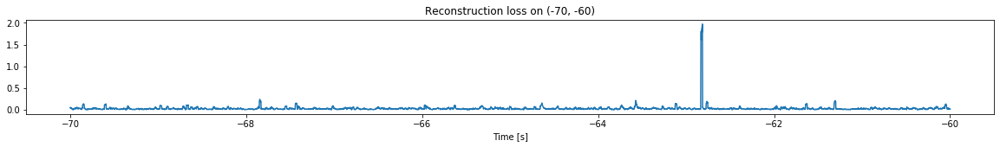

<--------
Entering sections:  (-60, -50)
-------->
Training for section:  (-70, -60)


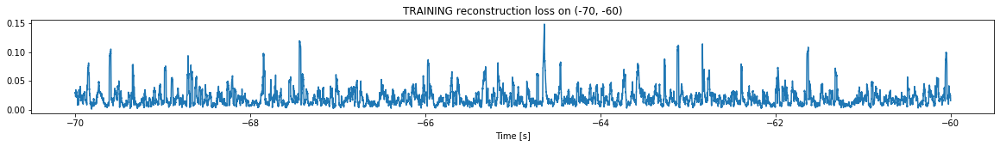

Finished training, median of the log(loss) is:  -1.7646390804536944
Triggering for section:  (-60, -50)
Using this median for triggering: -1.8311594759785303


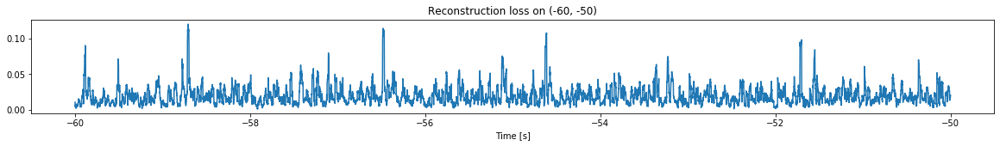

<--------
Entering sections:  (-50, -40)
-------->
Training for section:  (-60, -50)


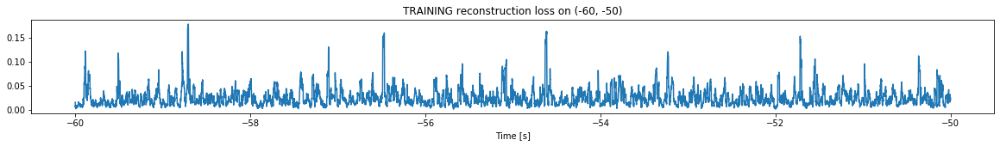

Finished training, median of the log(loss) is:  -1.667221405753958
Triggering for section:  (-50, -40)
Using this median for triggering: -1.7646390804536944


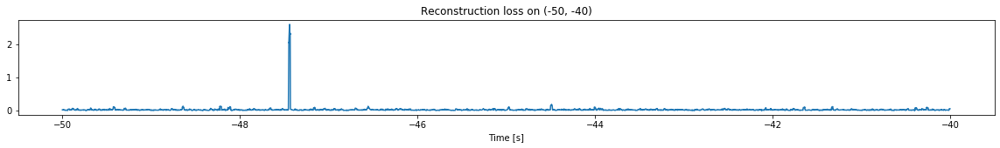

<--------
Entering sections:  (-40, -30)
-------->
Training for section:  (-50, -40)


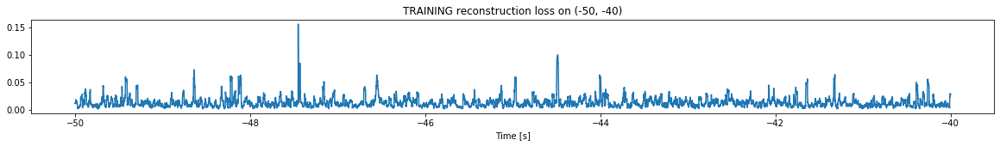

Finished training, median of the log(loss) is:  -1.9541973484037616
Triggering for section:  (-40, -30)
Using this median for triggering: -1.667221405753958


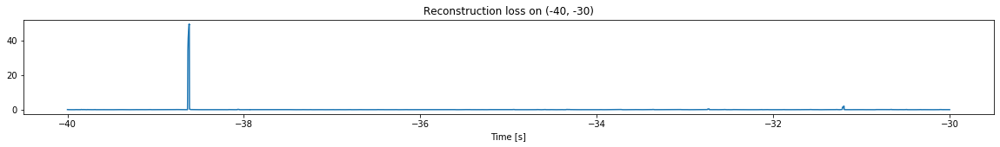

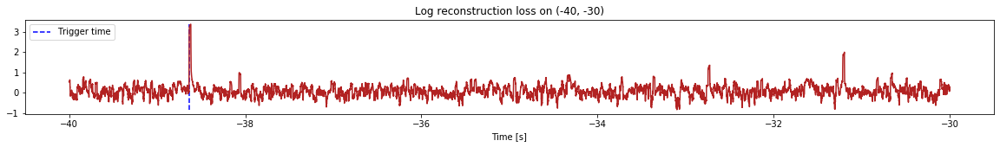

Triggered at:  -38.6373
<--------
Entering sections:  (-30, -20)
-------->
Training for section:  (-40, -30)


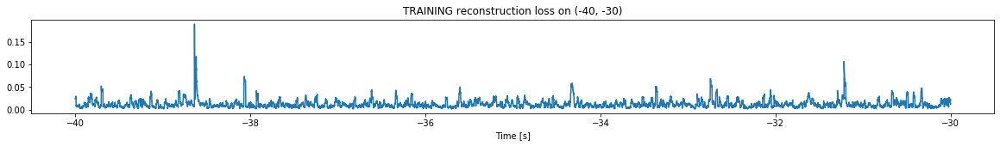

Finished training, median of the log(loss) is:  -1.980521366810729
Triggering for section:  (-30, -20)
Using this median for triggering: -1.9541973484037616


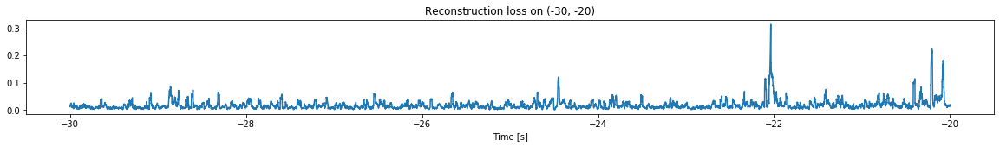

<--------
Entering sections:  (-20, -10)
-------->
Training for section:  (-30, -20)


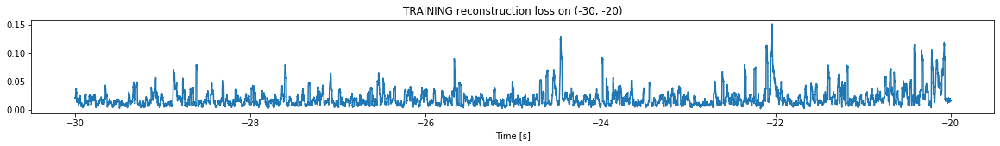

Finished training, median of the log(loss) is:  -1.8053302605923582
Triggering for section:  (-20, -10)
Using this median for triggering: -1.980521366810729


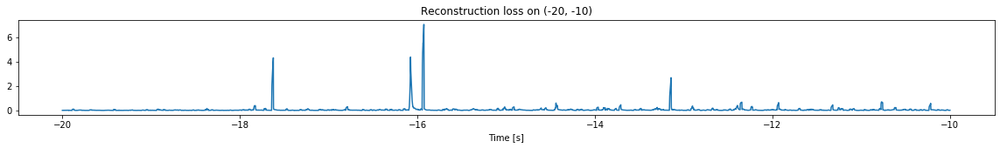

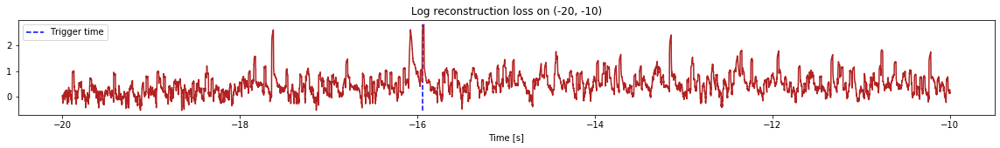

Triggered at:  -15.9386
<--------
Entering sections:  (-10, 0)
-------->
Training for section:  (-20, -10)


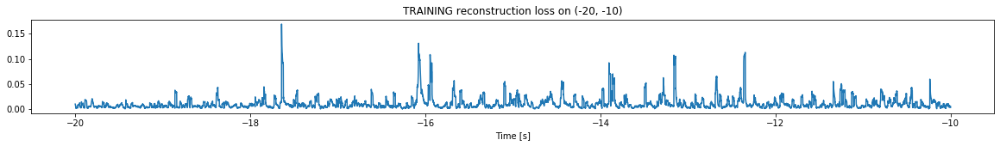

Finished training, median of the log(loss) is:  -2.0817309485691866
Triggering for section:  (-10, 0)
Using this median for triggering: -1.8053302605923582


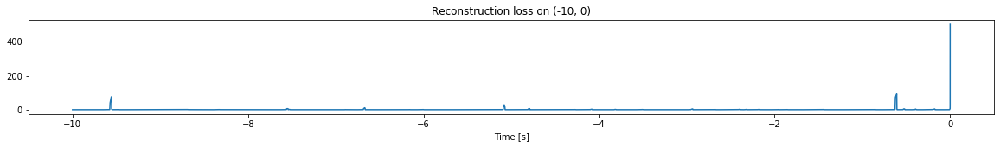

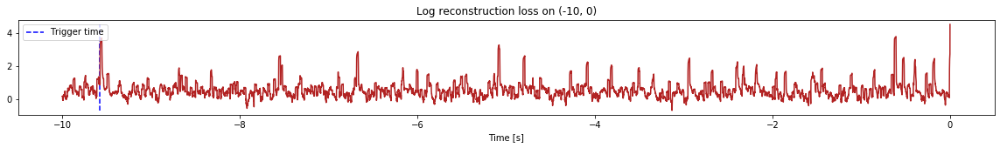

Triggered at:  -9.574699
<--------
Finished simulation, all the triggered times are:  [-38.6373, -15.9386, -9.574699]


In [9]:
simulation("./data/Ramp24/", 10, (-110,0))

Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
All data's shape:  (997500, 12)
Flushing input history
Number of sections: 10
Entering sections:  (-100, -90)
-------->
Entering sections:  (-90, -80)
-------->
Training for section:  (None, -90)


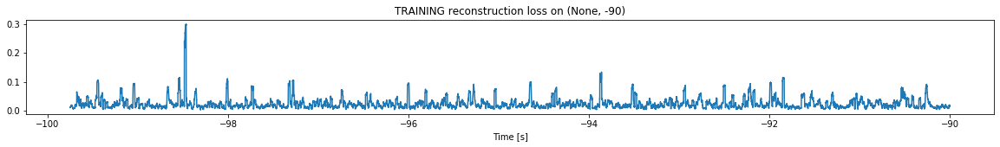

Finished training, median of the log(loss) is:  -1.7272936953944191
<--------
Entering sections:  (-80, -70)
-------->
Training for section:  (-90, -80)


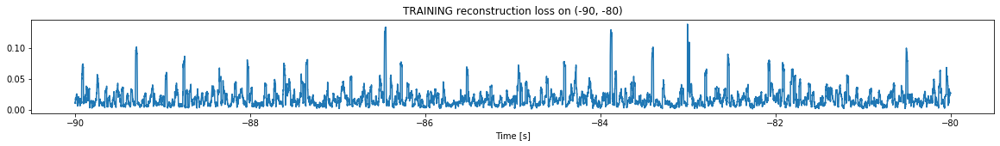

Finished training, median of the log(loss) is:  -1.8191034507406112
Triggering for section:  (-80, -70)
Using this median for triggering: -1.7272936953944191


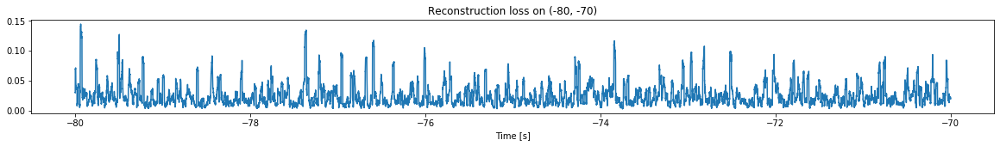

<--------
Entering sections:  (-70, -60)
-------->
Training for section:  (-80, -70)


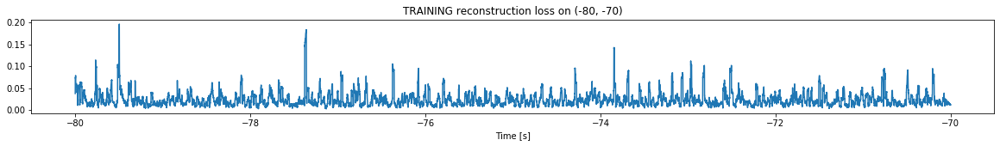

Finished training, median of the log(loss) is:  -1.701987434745508
Triggering for section:  (-70, -60)
Using this median for triggering: -1.8191034507406112


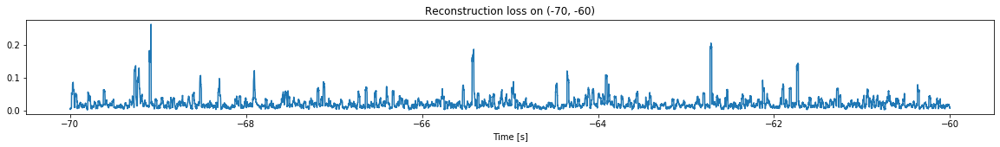

<--------
Entering sections:  (-60, -50)
-------->
Training for section:  (-70, -60)


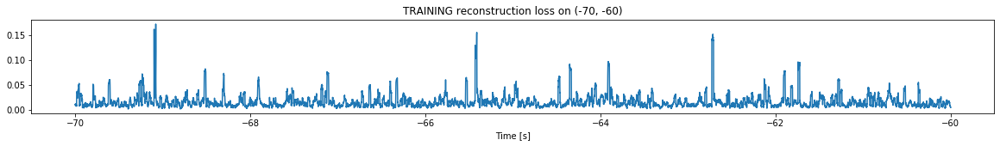

Finished training, median of the log(loss) is:  -1.8894662284496857
Triggering for section:  (-60, -50)
Using this median for triggering: -1.701987434745508


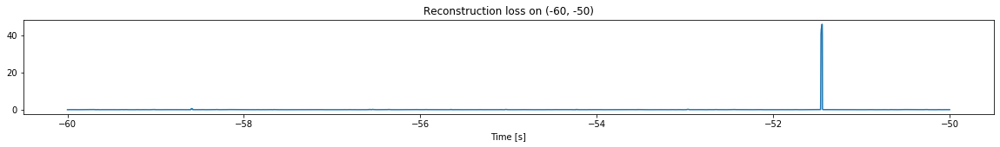

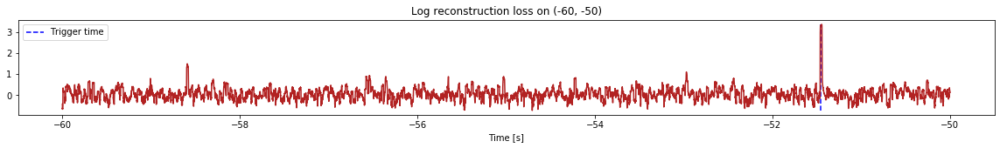

Triggered at:  -51.461998
<--------
Entering sections:  (-50, -40)
-------->
Training for section:  (-60, -50)


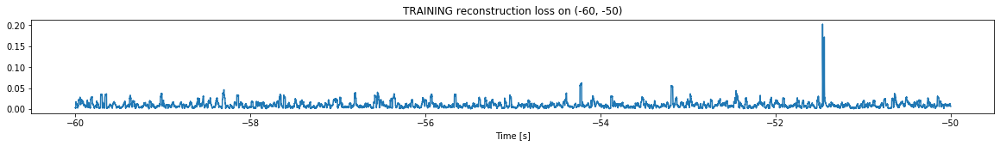

Finished training, median of the log(loss) is:  -2.0375619467578607
Triggering for section:  (-50, -40)
Using this median for triggering: -1.8894662284496857


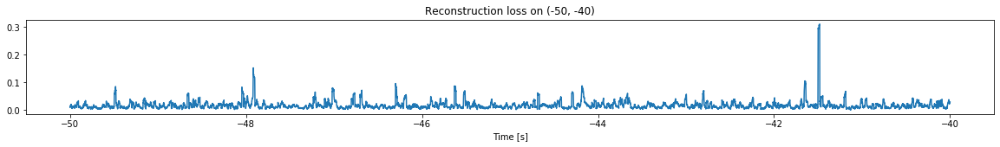

<--------
Entering sections:  (-40, -30)
-------->
Training for section:  (-50, -40)


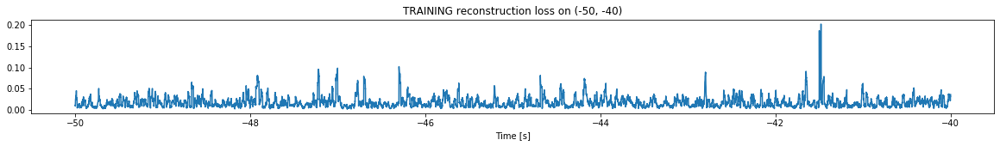

Finished training, median of the log(loss) is:  -1.8374600255863225
Triggering for section:  (-40, -30)
Using this median for triggering: -2.0375619467578607


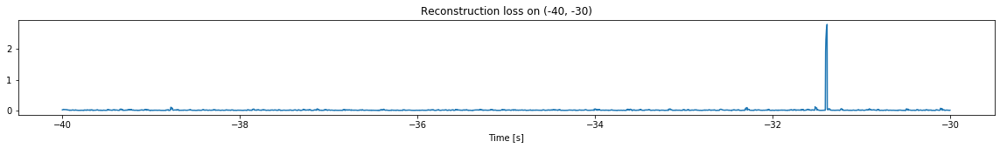

<--------
Entering sections:  (-30, -20)
-------->
Training for section:  (-40, -30)


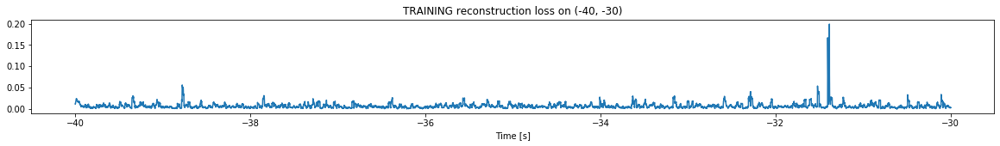

Finished training, median of the log(loss) is:  -2.2074618819029777
Triggering for section:  (-30, -20)
Using this median for triggering: -1.8374600255863225


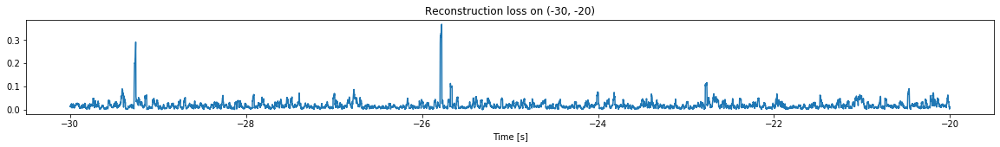

<--------
Entering sections:  (-20, -10)
-------->
Training for section:  (-30, -20)


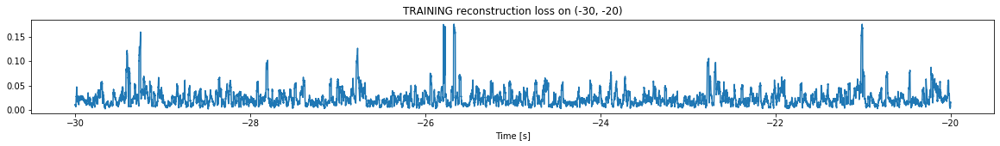

Finished training, median of the log(loss) is:  -1.6902177763182893
Triggering for section:  (-20, -10)
Using this median for triggering: -2.2074618819029777


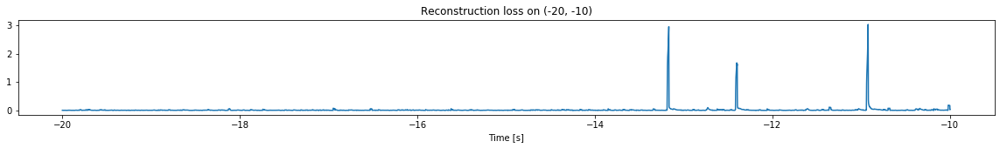

<--------
Entering sections:  (-10, 0)
-------->
Training for section:  (-20, -10)


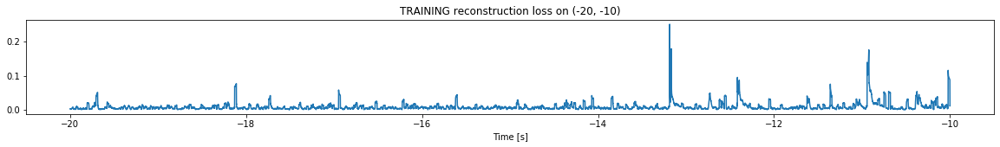

Finished training, median of the log(loss) is:  -2.2068714315522815
Triggering for section:  (-10, 0)
Using this median for triggering: -1.6902177763182893


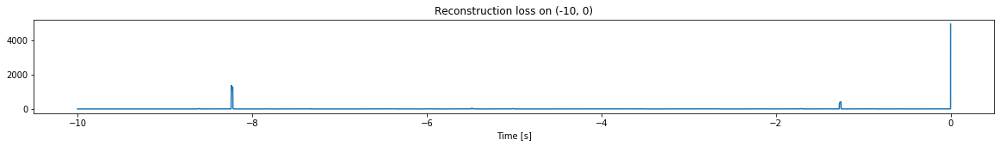

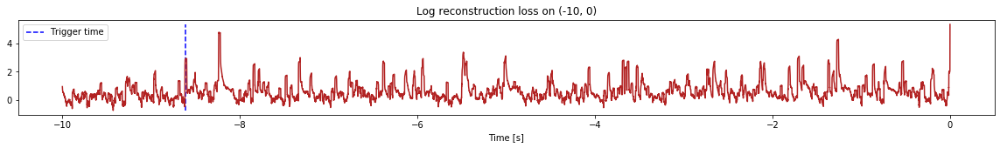

Triggered at:  -8.6178
<--------
Finished simulation, all the triggered times are:  [-51.461998, -8.6178]


In [10]:
simulation("./data/Ramp25/", 10, (-100,0))

Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
All data's shape:  (1097500, 12)
Flushing input history
Number of sections: 11
Entering sections:  (-110, -100)
-------->
Entering sections:  (-100, -90)
-------->
Training for section:  (None, -100)


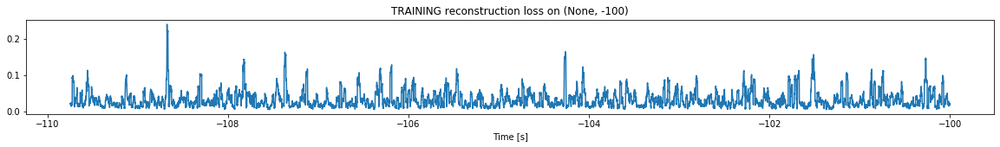

Finished training, median of the log(loss) is:  -1.567585942447095
<--------
Entering sections:  (-90, -80)
-------->
Training for section:  (-100, -90)


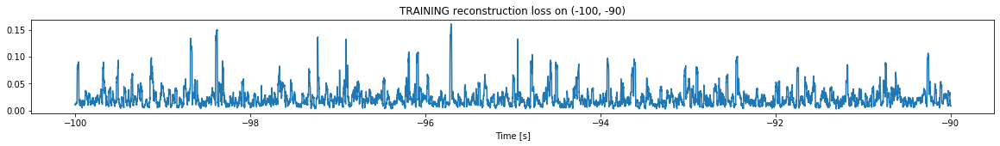

Finished training, median of the log(loss) is:  -1.7179924103745665
Triggering for section:  (-90, -80)
Using this median for triggering: -1.567585942447095


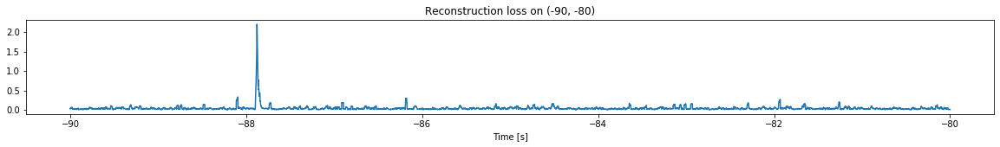

<--------
Entering sections:  (-80, -70)
-------->
Training for section:  (-90, -80)


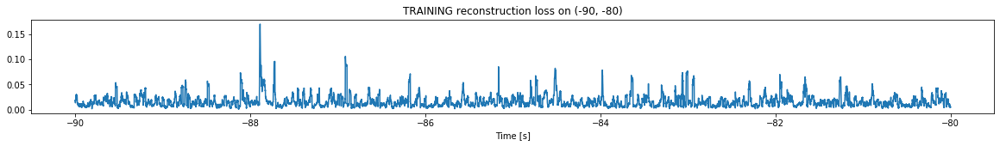

Finished training, median of the log(loss) is:  -1.8674758725547687
Triggering for section:  (-80, -70)
Using this median for triggering: -1.7179924103745665


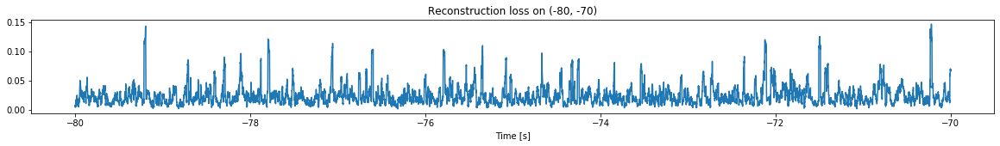

<--------
Entering sections:  (-70, -60)
-------->
Training for section:  (-80, -70)


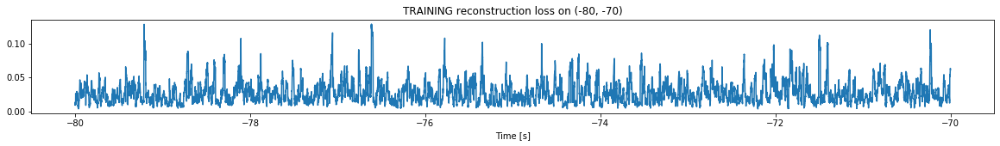

Finished training, median of the log(loss) is:  -1.6127586222380161
Triggering for section:  (-70, -60)
Using this median for triggering: -1.8674758725547687


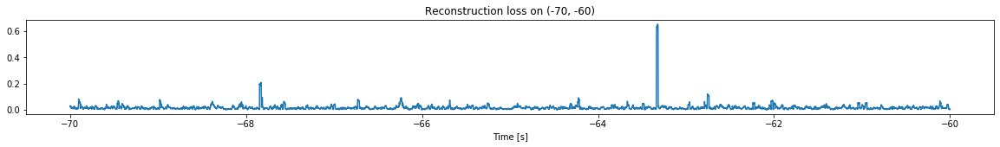

<--------
Entering sections:  (-60, -50)
-------->
Training for section:  (-70, -60)


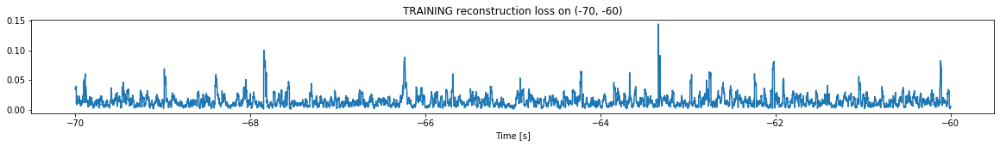

Finished training, median of the log(loss) is:  -1.895571222013483
Triggering for section:  (-60, -50)
Using this median for triggering: -1.6127586222380161


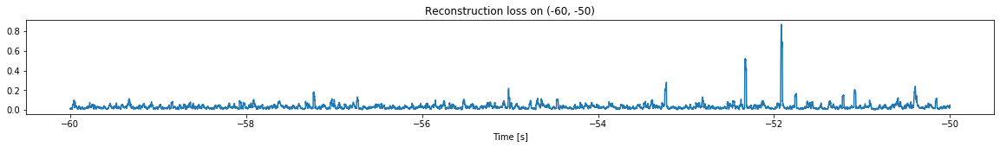

<--------
Entering sections:  (-50, -40)
-------->
Training for section:  (-60, -50)


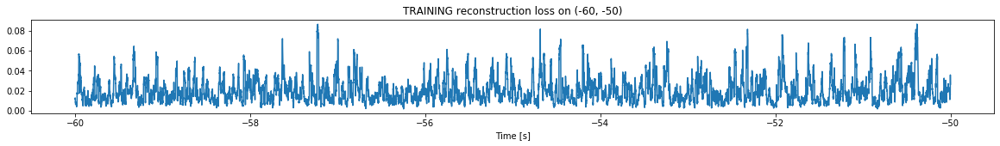

Finished training, median of the log(loss) is:  -1.7532261779317695
Triggering for section:  (-50, -40)
Using this median for triggering: -1.895571222013483


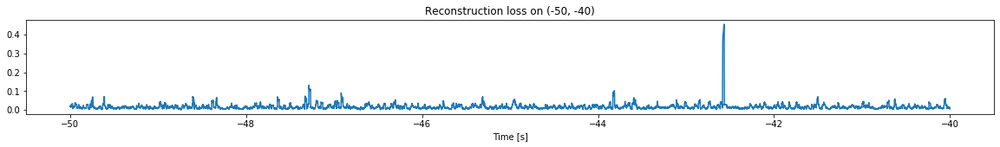

<--------
Entering sections:  (-40, -30)
-------->
Training for section:  (-50, -40)


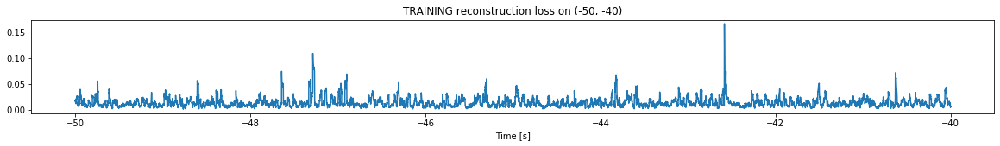

Finished training, median of the log(loss) is:  -1.926410340694359
Triggering for section:  (-40, -30)
Using this median for triggering: -1.7532261779317695


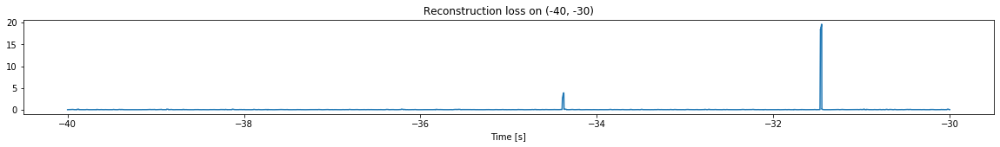

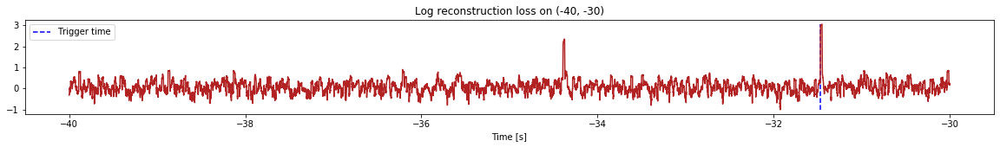

Triggered at:  -31.469398
<--------
Entering sections:  (-30, -20)
-------->
Training for section:  (-40, -30)


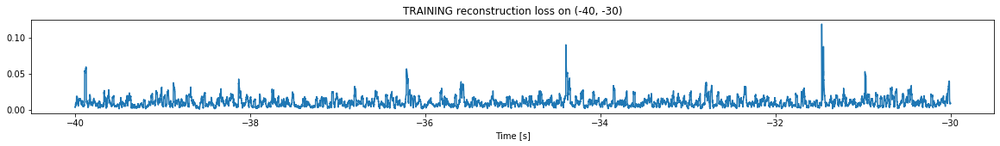

Finished training, median of the log(loss) is:  -2.0328501370937566
Triggering for section:  (-30, -20)
Using this median for triggering: -1.926410340694359


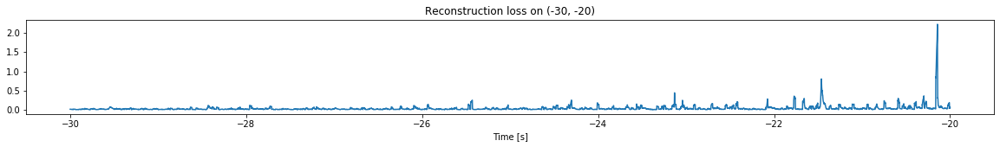

<--------
Entering sections:  (-20, -10)
-------->
Training for section:  (-30, -20)


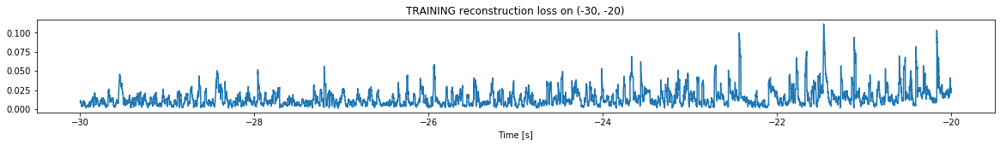

Finished training, median of the log(loss) is:  -1.92886599638411
Triggering for section:  (-20, -10)
Using this median for triggering: -2.0328501370937566


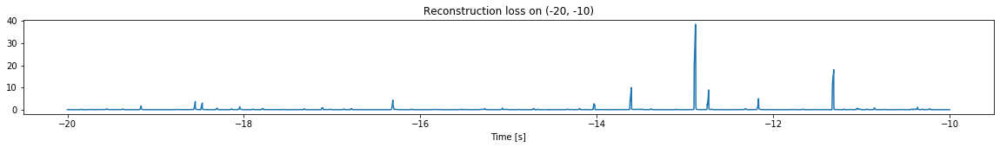

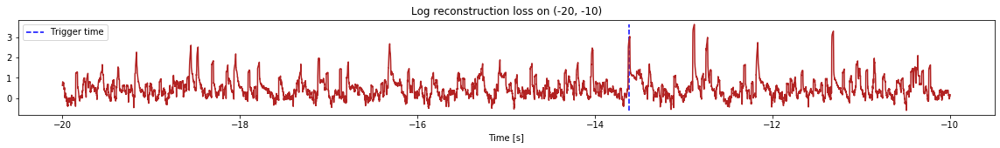

Triggered at:  -13.620299
<--------
Entering sections:  (-10, 0)
-------->
Training for section:  (-20, -10)


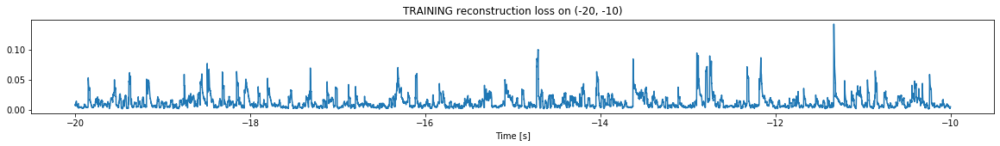

Finished training, median of the log(loss) is:  -2.067468399195647
Triggering for section:  (-10, 0)
Using this median for triggering: -1.92886599638411


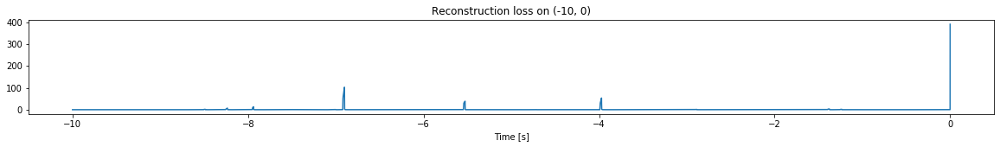

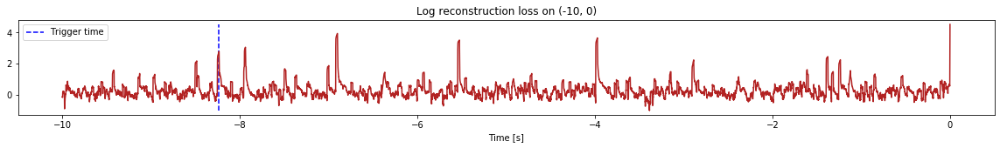

Triggered at:  -8.2407
<--------
Finished simulation, all the triggered times are:  [-31.469398, -13.620299, -8.2407]


In [11]:
simulation("./data/Ramp26/", 10, (-110,0))

Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
All data's shape:  (697500, 12)
Flushing input history
Number of sections: 7
Entering sections:  (-70, -60)
-------->
Entering sections:  (-60, -50)
-------->
Training for section:  (None, -60)


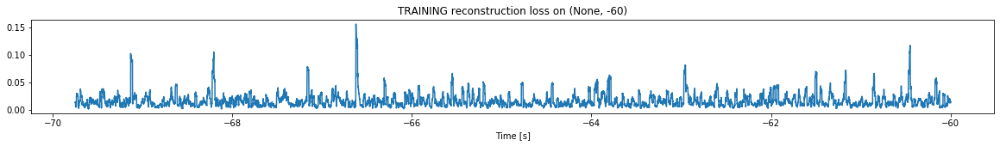

Finished training, median of the log(loss) is:  -1.8468811022842317
<--------
Entering sections:  (-50, -40)
-------->
Training for section:  (-60, -50)


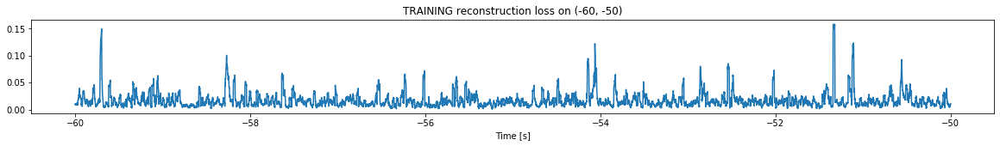

Finished training, median of the log(loss) is:  -1.863889295105864
Triggering for section:  (-50, -40)
Using this median for triggering: -1.8468811022842317


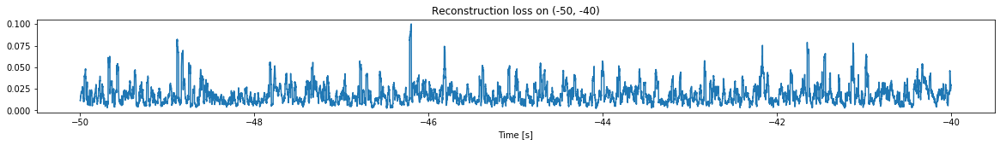

<--------
Entering sections:  (-40, -30)
-------->
Training for section:  (-50, -40)


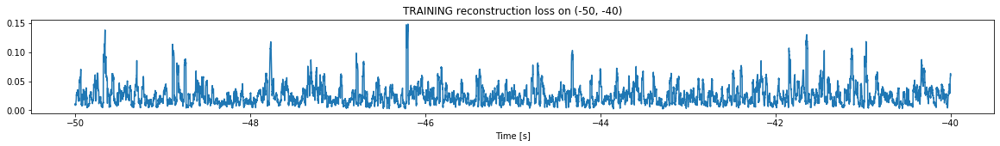

Finished training, median of the log(loss) is:  -1.657845232881461
Triggering for section:  (-40, -30)
Using this median for triggering: -1.863889295105864


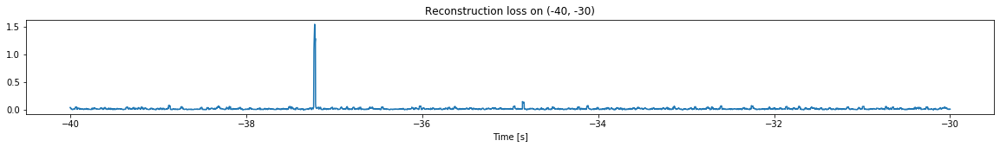

<--------
Entering sections:  (-30, -20)
-------->
Training for section:  (-40, -30)


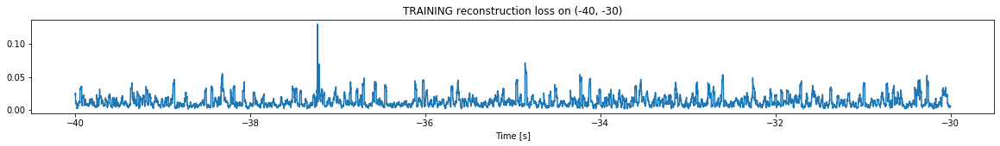

Finished training, median of the log(loss) is:  -1.976953114087314
Triggering for section:  (-30, -20)
Using this median for triggering: -1.657845232881461


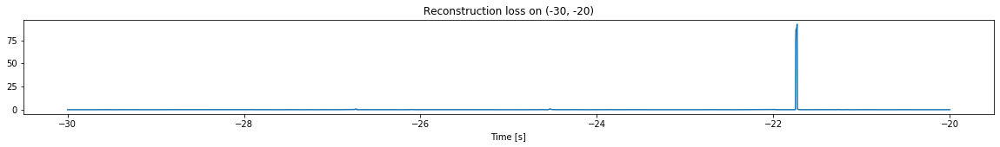

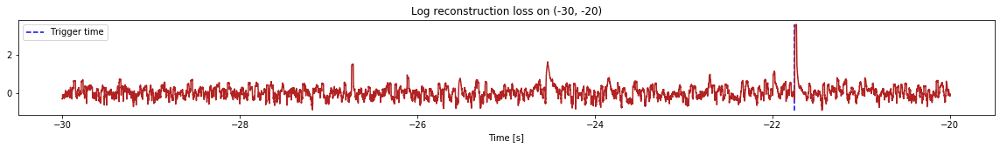

Triggered at:  -21.7487
<--------
Entering sections:  (-20, -10)
-------->
Training for section:  (-30, -20)


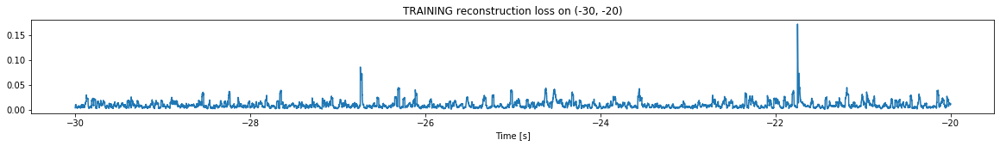

Finished training, median of the log(loss) is:  -2.1165813187835747
Triggering for section:  (-20, -10)
Using this median for triggering: -1.976953114087314


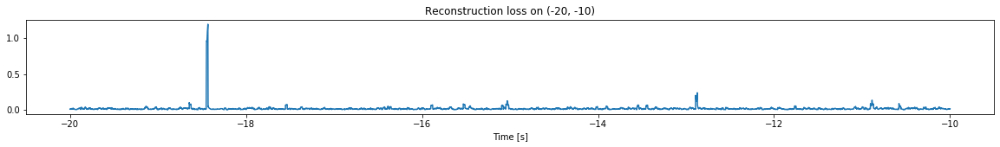

<--------
Entering sections:  (-10, 0)
-------->
Training for section:  (-20, -10)


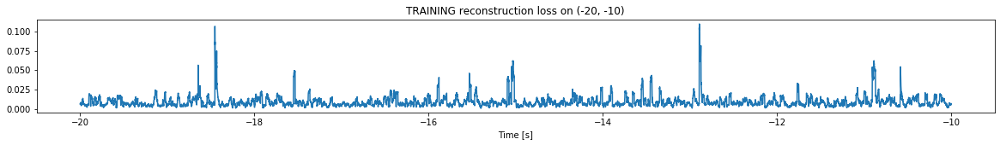

Finished training, median of the log(loss) is:  -2.1318351216017772
Triggering for section:  (-10, 0)
Using this median for triggering: -2.1165813187835747


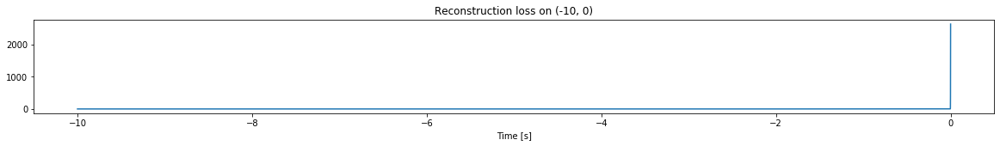

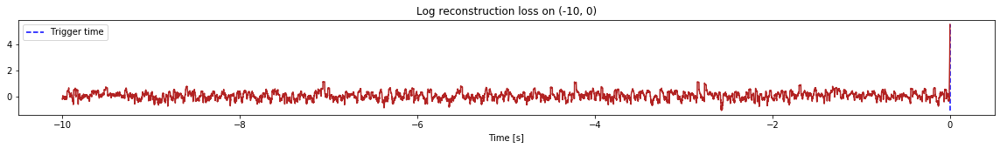

Triggered at:  -0.0030999999
<--------
Finished simulation, all the triggered times are:  [-21.7487, -0.0030999999]


In [12]:
simulation("./data/Ramp27/", 10, (-70,0))

Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
All data's shape:  (597500, 12)
Flushing input history
Number of sections: 6
Entering sections:  (-60, -50)
-------->
Entering sections:  (-50, -40)
-------->
Training for section:  (None, -50)


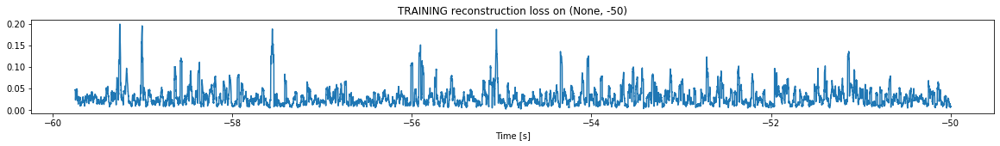

Finished training, median of the log(loss) is:  -1.6002424370752415
<--------
Entering sections:  (-40, -30)
-------->
Training for section:  (-50, -40)


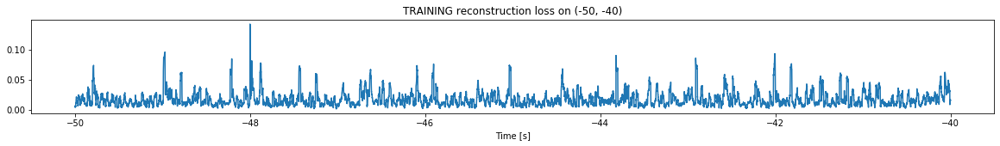

Finished training, median of the log(loss) is:  -1.8437685061819824
Triggering for section:  (-40, -30)
Using this median for triggering: -1.6002424370752415


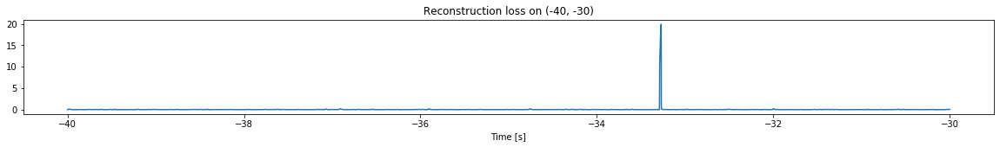

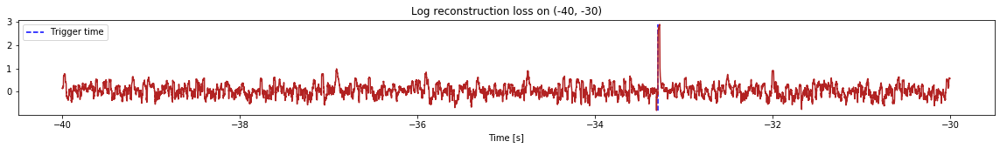

Triggered at:  -33.2859
<--------
Entering sections:  (-30, -20)
-------->
Training for section:  (-40, -30)


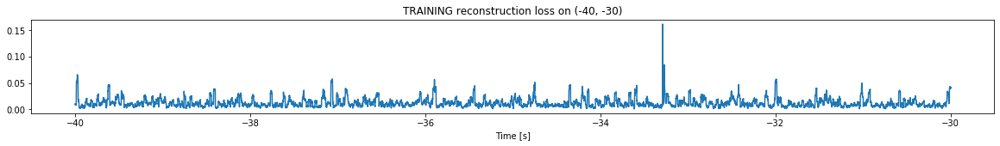

Finished training, median of the log(loss) is:  -1.9844076378330489
Triggering for section:  (-30, -20)
Using this median for triggering: -1.8437685061819824


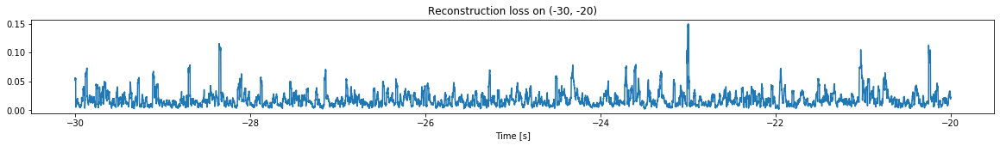

<--------
Entering sections:  (-20, -10)
-------->
Training for section:  (-30, -20)


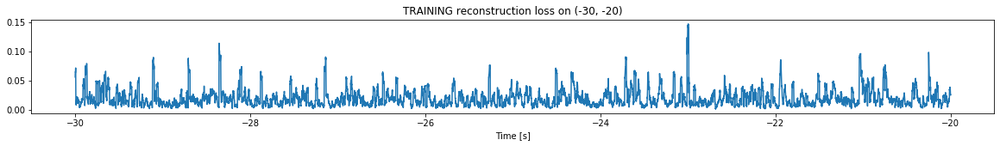

Finished training, median of the log(loss) is:  -1.7742674228177346
Triggering for section:  (-20, -10)
Using this median for triggering: -1.9844076378330489


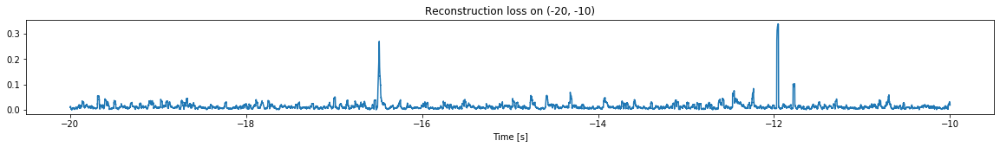

<--------
Entering sections:  (-10, 0)
-------->
Training for section:  (-20, -10)


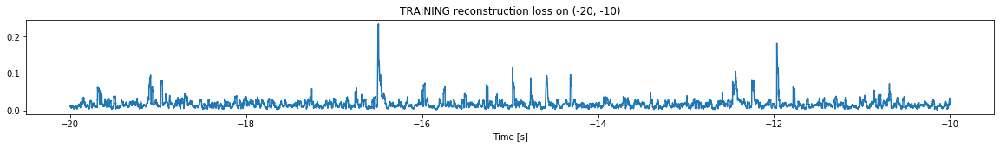

Finished training, median of the log(loss) is:  -1.8251057550798806
Triggering for section:  (-10, 0)
Using this median for triggering: -1.7742674228177346


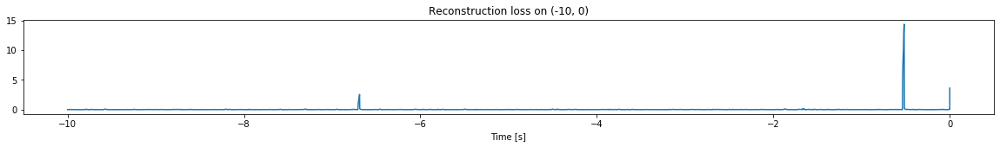

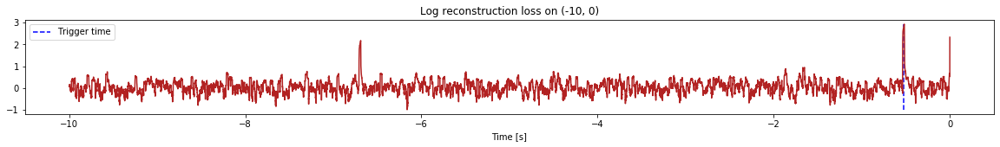

Triggered at:  -0.5293
<--------
Finished simulation, all the triggered times are:  [-33.2859, -0.5293]


In [13]:
simulation("./data/Ramp28/", 10, (-60,0))

Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
All data's shape:  (997500, 12)
Flushing input history
Number of sections: 10
Entering sections:  (-100, -90)
-------->
Entering sections:  (-90, -80)
-------->
Training for section:  (None, -90)


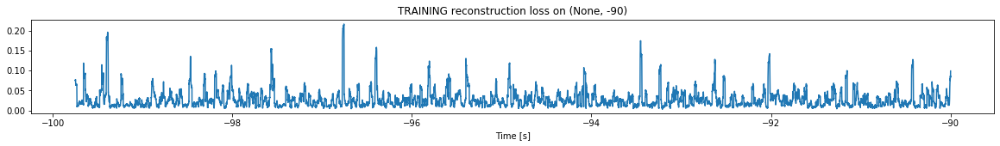

Finished training, median of the log(loss) is:  -1.6624504171758714
<--------
Entering sections:  (-80, -70)
-------->
Training for section:  (-90, -80)


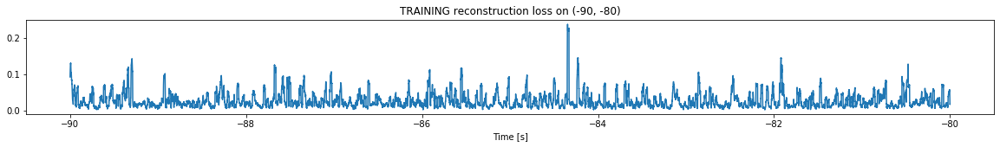

Finished training, median of the log(loss) is:  -1.6632631766763084
Triggering for section:  (-80, -70)
Using this median for triggering: -1.6624504171758714


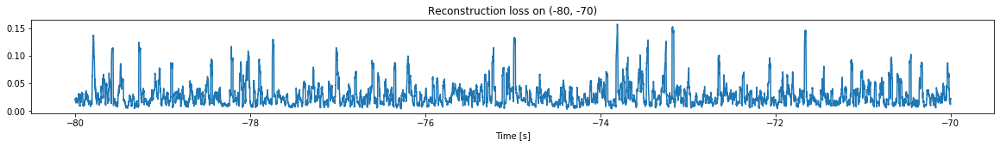

<--------
Entering sections:  (-70, -60)
-------->
Training for section:  (-80, -70)


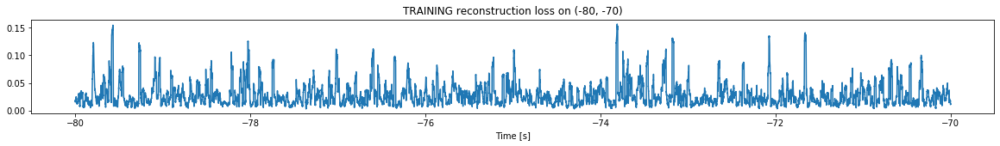

Finished training, median of the log(loss) is:  -1.6399634577075166
Triggering for section:  (-70, -60)
Using this median for triggering: -1.6632631766763084


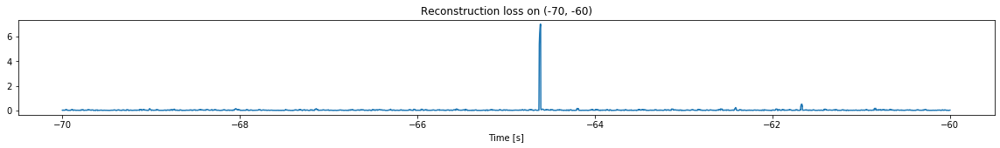

<--------
Entering sections:  (-60, -50)
-------->
Training for section:  (-70, -60)


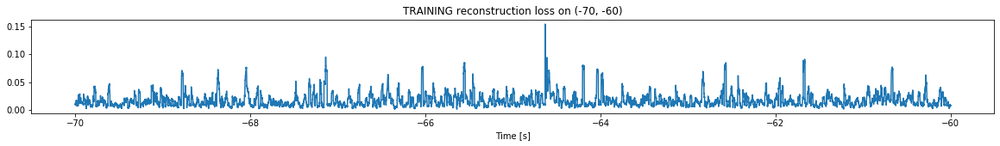

Finished training, median of the log(loss) is:  -1.8481484550899405
Triggering for section:  (-60, -50)
Using this median for triggering: -1.6399634577075166


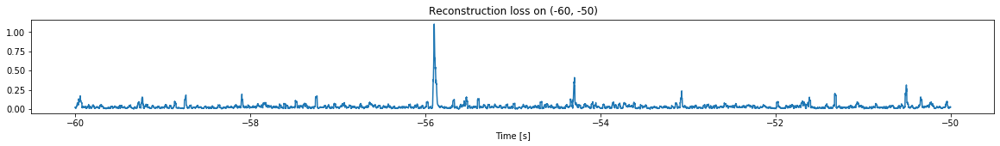

<--------
Entering sections:  (-50, -40)
-------->
Training for section:  (-60, -50)


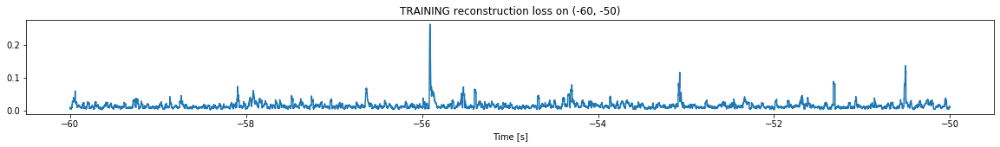

Finished training, median of the log(loss) is:  -1.9145021963199864
Triggering for section:  (-50, -40)
Using this median for triggering: -1.8481484550899405


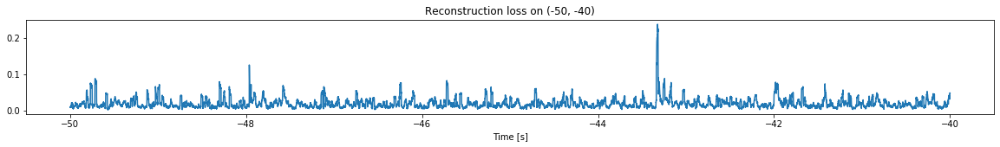

<--------
Entering sections:  (-40, -30)
-------->
Training for section:  (-50, -40)


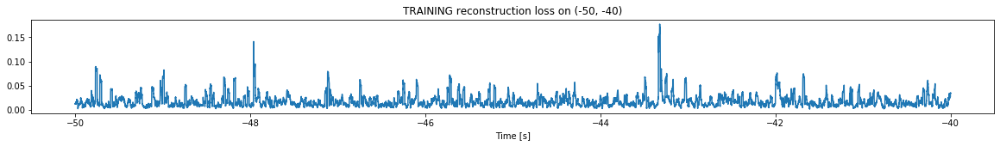

Finished training, median of the log(loss) is:  -1.8303868773524572
Triggering for section:  (-40, -30)
Using this median for triggering: -1.9145021963199864


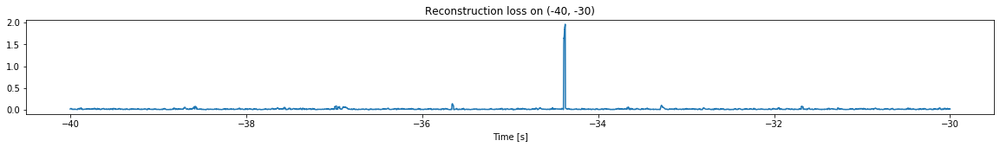

<--------
Entering sections:  (-30, -20)
-------->
Training for section:  (-40, -30)


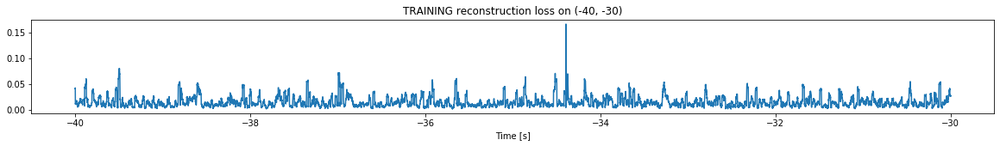

Finished training, median of the log(loss) is:  -1.8993144221229274
Triggering for section:  (-30, -20)
Using this median for triggering: -1.8303868773524572


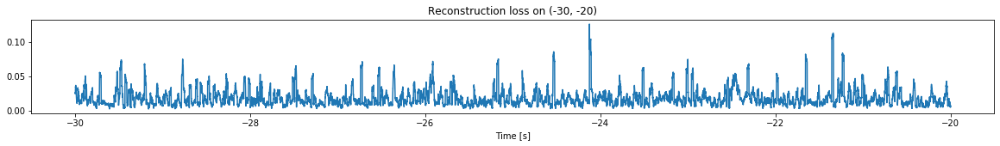

<--------
Entering sections:  (-20, -10)
-------->
Training for section:  (-30, -20)


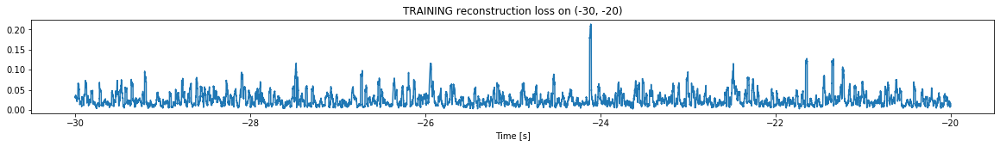

Finished training, median of the log(loss) is:  -1.6785844331349202
Triggering for section:  (-20, -10)
Using this median for triggering: -1.8993144221229274


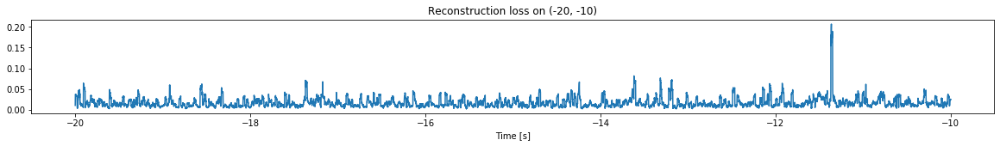

<--------
Entering sections:  (-10, 0)
-------->
Training for section:  (-20, -10)


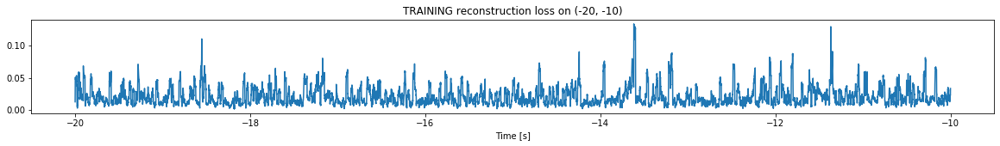

Finished training, median of the log(loss) is:  -1.771262619171016
Triggering for section:  (-10, 0)
Using this median for triggering: -1.6785844331349202


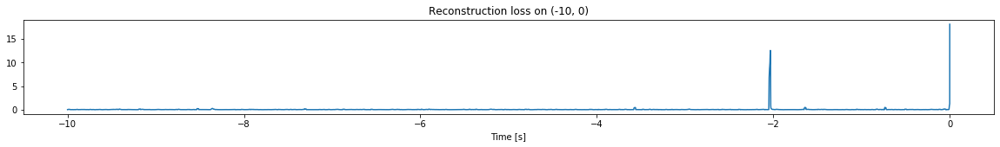

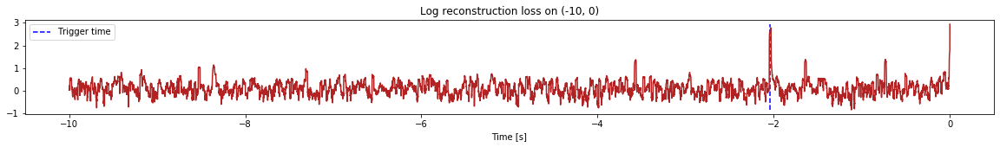

Triggered at:  -2.0377998
<--------
Finished simulation, all the triggered times are:  [-2.0377998]


In [14]:
simulation("./data/Ramp29/", 10, (-100,0))

Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
All data's shape:  (1197500, 12)
Flushing input history
Number of sections: 12
Entering sections:  (-120, -110)
-------->
Entering sections:  (-110, -100)
-------->
Training for section:  (None, -110)


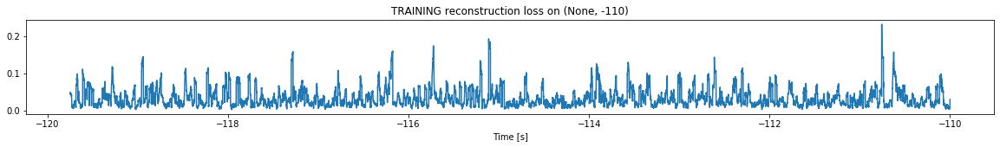

Finished training, median of the log(loss) is:  -1.5557529411593969
<--------
Entering sections:  (-100, -90)
-------->
Training for section:  (-110, -100)


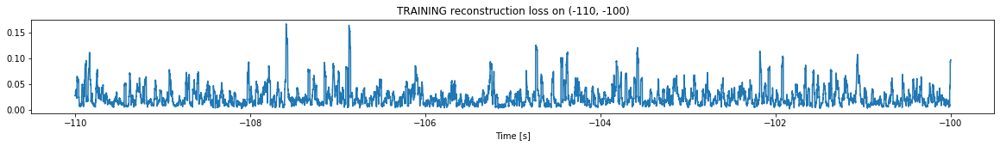

Finished training, median of the log(loss) is:  -1.7001314525049613
Triggering for section:  (-100, -90)
Using this median for triggering: -1.5557529411593969


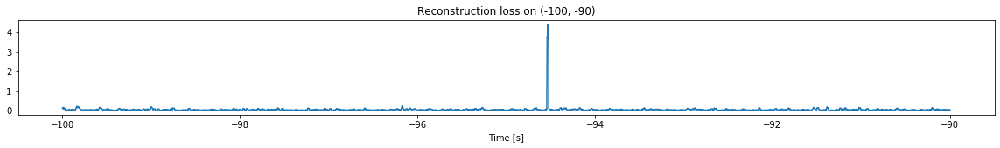

<--------
Entering sections:  (-90, -80)
-------->
Training for section:  (-100, -90)


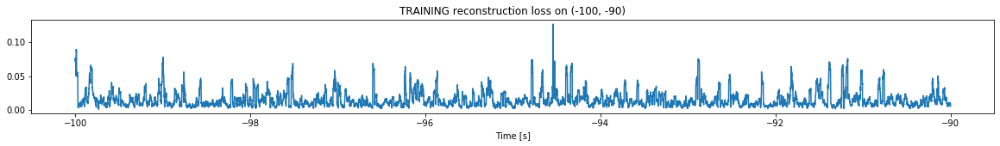

Finished training, median of the log(loss) is:  -1.918366611924684
Triggering for section:  (-90, -80)
Using this median for triggering: -1.7001314525049613


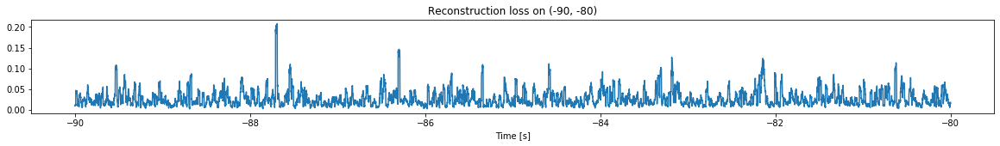

<--------
Entering sections:  (-80, -70)
-------->
Training for section:  (-90, -80)


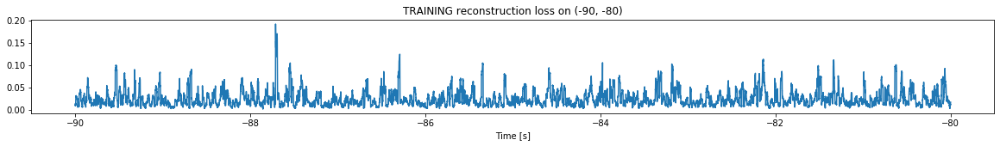

Finished training, median of the log(loss) is:  -1.6781652016170994
Triggering for section:  (-80, -70)
Using this median for triggering: -1.918366611924684


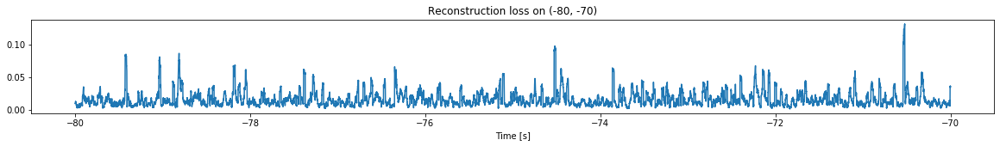

<--------
Entering sections:  (-70, -60)
-------->
Training for section:  (-80, -70)


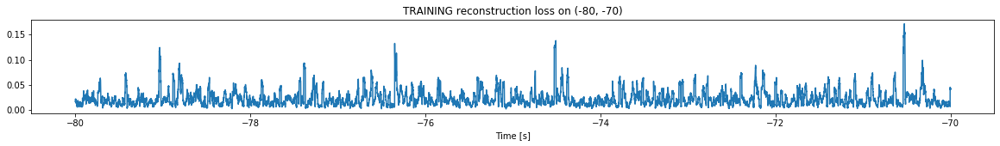

Finished training, median of the log(loss) is:  -1.7196632697362026
Triggering for section:  (-70, -60)
Using this median for triggering: -1.6781652016170994


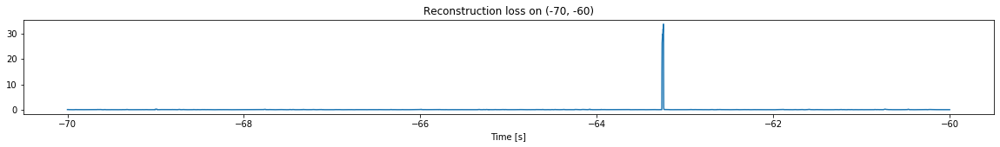

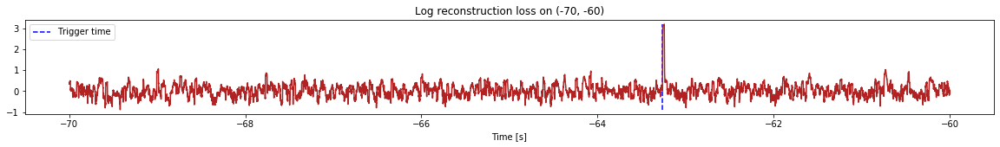

Triggered at:  -63.2613
<--------
Entering sections:  (-60, -50)
-------->
Training for section:  (-70, -60)


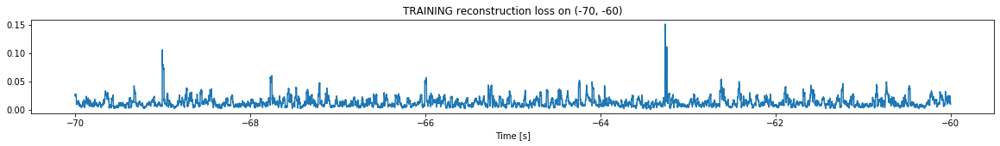

Finished training, median of the log(loss) is:  -1.9788810766171956
Triggering for section:  (-60, -50)
Using this median for triggering: -1.7196632697362026


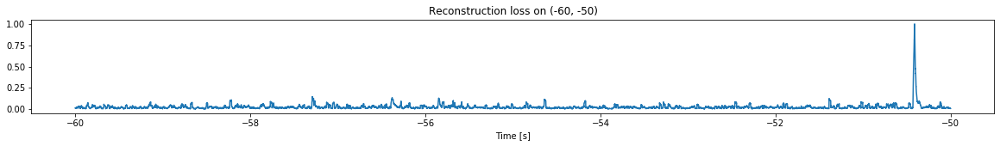

<--------
Entering sections:  (-50, -40)
-------->
Training for section:  (-60, -50)


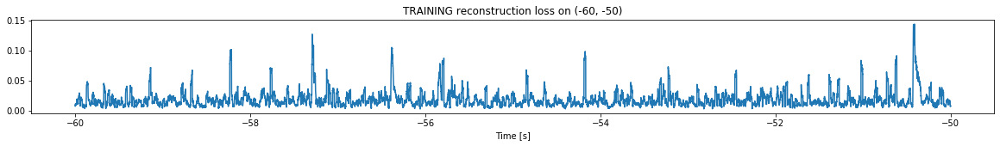

Finished training, median of the log(loss) is:  -1.824977623000871
Triggering for section:  (-50, -40)
Using this median for triggering: -1.9788810766171956


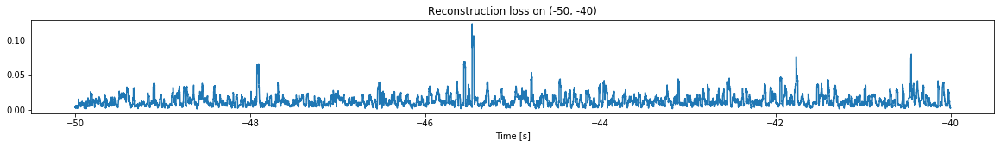

<--------
Entering sections:  (-40, -30)
-------->
Training for section:  (-50, -40)


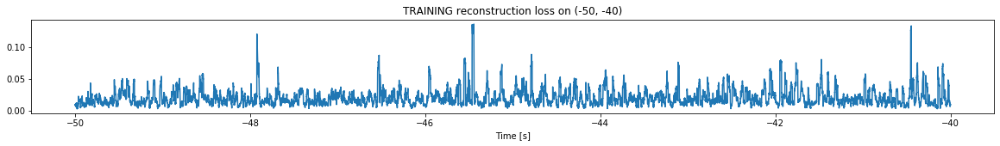

Finished training, median of the log(loss) is:  -1.7637638675706486
Triggering for section:  (-40, -30)
Using this median for triggering: -1.824977623000871


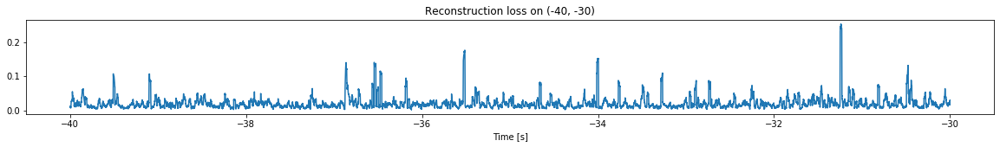

<--------
Entering sections:  (-30, -20)
-------->
Training for section:  (-40, -30)


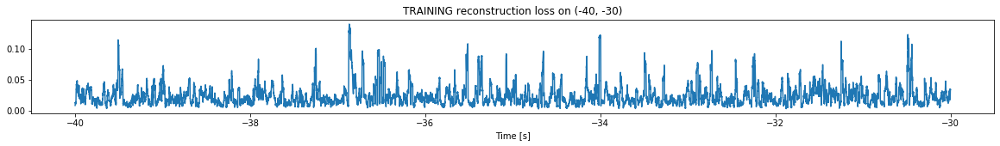

Finished training, median of the log(loss) is:  -1.7156762084620754
Triggering for section:  (-30, -20)
Using this median for triggering: -1.7637638675706486


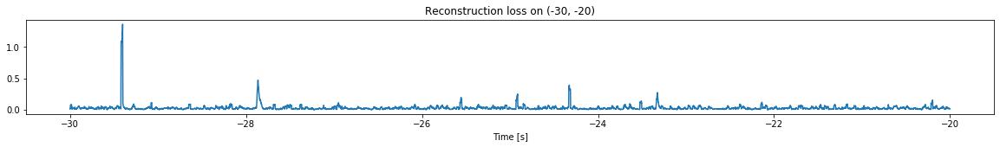

<--------
Entering sections:  (-20, -10)
-------->
Training for section:  (-30, -20)


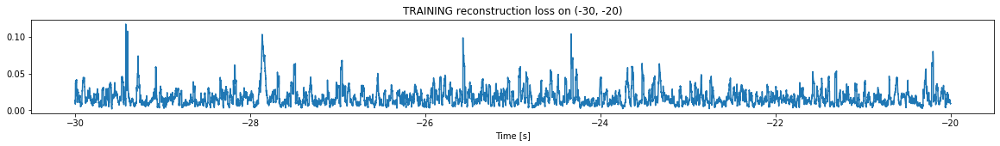

Finished training, median of the log(loss) is:  -1.8216909371154006
Triggering for section:  (-20, -10)
Using this median for triggering: -1.7156762084620754


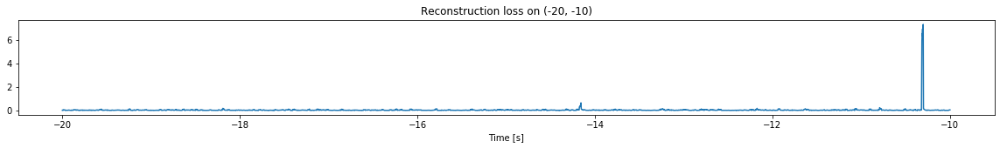

<--------
Entering sections:  (-10, 0)
-------->
Training for section:  (-20, -10)


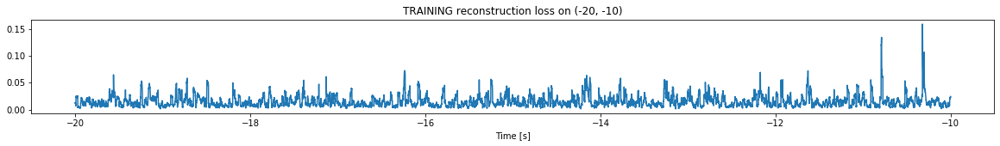

Finished training, median of the log(loss) is:  -1.8957586527354346
Triggering for section:  (-10, 0)
Using this median for triggering: -1.8216909371154006


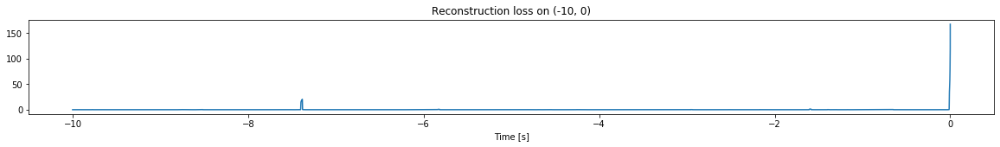

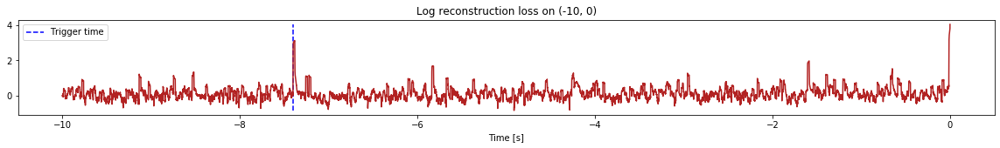

Triggered at:  -7.4000998
<--------
Finished simulation, all the triggered times are:  [-63.2613, -7.4000998]


In [15]:
simulation("./data/Ramp30/", 10, (-120,0))